<a href="https://colab.research.google.com/github/fabriziobasso/kaggle/blob/main/S3E26_Models_v1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **S3E26 Cirrosys - KAGGLE Competition**
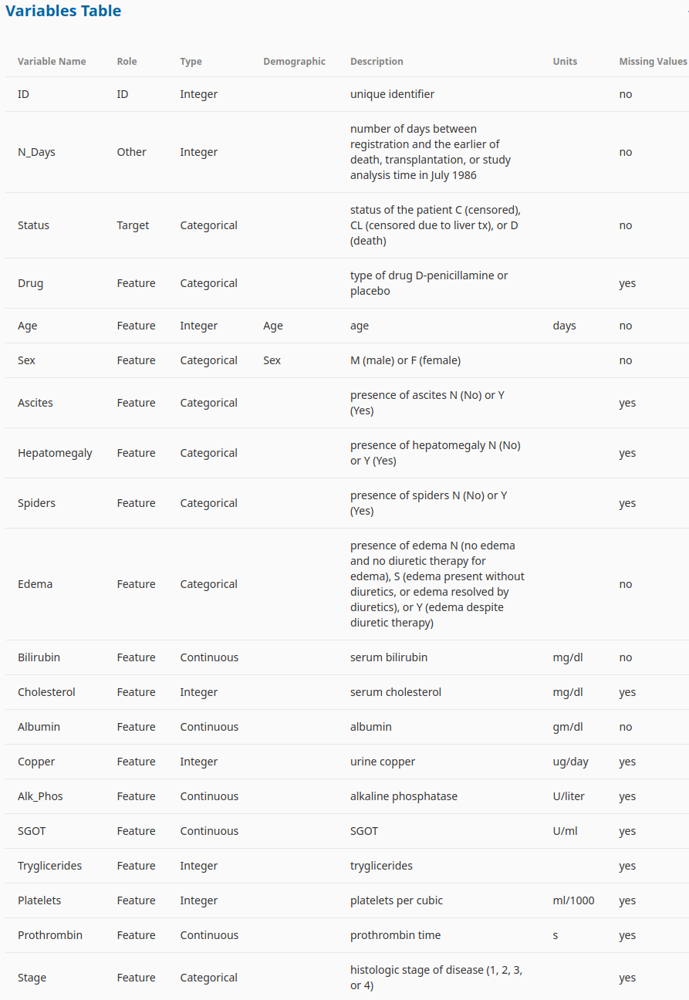
Evaluation
Submissions are evaluated using the multi-class logarithmic loss. Each id in the test set had a single true class label, Status. For each id, you must submit a set of predicted probabilities for each of the three possible outcomes, e.g., Status_C, Status_CL, and Status_D.

The metric is calculated


where
 is the number of rows in the test set,
 is the number of outcomes (i.e., 3),  
 is the natural logarithm,
 is 1 if row
 has the ground truth label
 and 0 otherwise, and
 is the predicted probability that observation
 belongs to class
.

The submitted probabilities for a given row are not required to sum to one because they are rescaled prior to being scored (each row is divided by the row sum). In order to avoid the extremes of the log function, predicted probabilities are replaced with
.

#### **Files:**
* train.csv - the training dataset; Hardness is the continuous target
* test.csv - the test dataset; your objective is to predict the value of Hardness
* sample_submission.csv - a sample submission file in the correct format
* Mineral_Dataset_Supplementary_Info.csv - Original Dataset

## 1.0 Workbook Set-up and Libraries:

#### 1.0 Libraries

In [1]:
%%capture
!pip install tensorflow-addons
#!pip install shap
#!pip install eli5
#!pip install tf-nightly
#!pip install -U scikit-learn==1.2.0
!pip install catboost
#!pip install haversine
#!pip install pytorch-forecasting
!pip install umap-learn
#!pip install reverse_geocoder
#!pip install --upgrade protobuf
!pip install colorama
!pip install imbalanced-learn
!pip install optuna
!pip install optuna-integration
#!pip install pygam
!pip install keras-tuner --upgrade
#!pip install pycaret
#!pip install lightning==2.0.1
!pip install keras-nlp
#!pip install MiniSom

In [2]:
#importing modules

import warnings
warnings.filterwarnings('ignore')
import time
t = time.time()

print('Importing started...')

# basic moduele
import os
import numpy as np
import pandas as pd
import re
#from scipy import stats
from random import randint
import random
import math
import os
import gc
import pickle
from glob import glob
from IPython import display as ipd
from tqdm import tqdm
from datetime import datetime
from joblib import dump, load
import sklearn as sk
from imblearn.over_sampling import SMOTE, RandomOverSampler
from functools import partial
import itertools
import joblib
from itertools import combinations
import IPython
import statsmodels.api as sm
import IPython.display

# visualization moduels
import matplotlib.pyplot as plt
import matplotlib as mpl
import matplotlib.gridspec as gridspec
import matplotlib.patches as mpatches
from matplotlib_venn import venn2_unweighted
import seaborn as sns
import missingno as msno
import imblearn
import scipy.stats as stats
from scipy.special import boxcox, boxcox1p


# Palette Setup
colors = ['#FB5B68','#FFEB48','#2676A1','#FFBDB0',]
colormap_0 = mpl.colors.LinearSegmentedColormap.from_list("",colors)
palette_1 = sns.color_palette("coolwarm", as_cmap=True)
palette_2 = sns.color_palette("YlOrBr", as_cmap=True)
palette_3 = sns.light_palette("red", as_cmap=True)
palette_4 = sns.color_palette("viridis", as_cmap=True)
palette_5 = sns.color_palette("rocket", as_cmap=True)
palette_6 = sns.color_palette("GnBu", as_cmap=True)
palette_7 = sns.color_palette("tab20c", as_cmap=False)
palette_8 = sns.color_palette("Set2", as_cmap=False)

palette_custom = ['#fbb4ae','#b3cde3','#ccebc5','#decbe4','#fed9a6','#ffffcc','#e5d8bd','#fddaec','#f2f2f2']
palette_9 = sns.color_palette(palette_custom, as_cmap=False)

sns.set_style("whitegrid",{"grid.linestyle":"--", 'grid.linewidth':0.2, 'grid.alpha':0.5})
#sns.set_theme(style="ticks", context="notebook")
sns.despine(left=True, bottom=True, top=False, right=False)

mpl.rcParams['axes.spines.left'] = True
mpl.rcParams['axes.spines.right'] = False
mpl.rcParams['axes.spines.top'] = False
mpl.rcParams['axes.spines.bottom'] = True

# Style Import
from colorama import Style, Fore
red = Style.BRIGHT + Fore.RED
blu = Style.BRIGHT + Fore.BLUE
mgt = Style.BRIGHT + Fore.MAGENTA
gld = Style.BRIGHT + Fore.YELLOW
res = Style.RESET_ALL

# preprocessing modules
from sklearn.model_selection import (train_test_split,
                                     KFold,
                                     StratifiedKFold,
                                     cross_val_score,
                                     GroupKFold,
                                     GridSearchCV,
                                     RepeatedStratifiedKFold,
                                     cross_validate)

from sklearn.preprocessing import (LabelEncoder,
                                   StandardScaler,
                                   MinMaxScaler,
                                   OrdinalEncoder,
                                   RobustScaler,
                                   PowerTransformer,
                                   OneHotEncoder,
                                   LabelEncoder,
                                   OrdinalEncoder,
                                   QuantileTransformer,
                                   PolynomialFeatures)

from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer
from sklearn.calibration import CalibratedClassifierCV

from sklearn.feature_selection import SelectFromModel
from sklearn.preprocessing import FunctionTransformer
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer

# metrics
from sklearn.metrics import (mean_squared_error,
                             r2_score,
                             mean_absolute_error,
                             mean_absolute_percentage_error,
                             classification_report,
                             confusion_matrix,
                             ConfusionMatrixDisplay,
                             multilabel_confusion_matrix,
                             accuracy_score,
                             roc_auc_score,
                             auc,
                             roc_curve,
                             log_loss)


# modeling algos
from sklearn.linear_model import (LogisticRegression,
                                  Lasso,
                                  ridge_regression,
                                  LinearRegression,
                                  Ridge,
                                  RidgeCV,
                                  ElasticNet,
                                  BayesianRidge,
                                  TweedieRegressor,
                                  ARDRegression,
                                  PoissonRegressor,
                                  GammaRegressor)

from sklearn.neighbors import KNeighborsRegressor

from sklearn.tree import DecisionTreeRegressor
from sklearn.isotonic import IsotonicRegression

from sklearn.ensemble import (AdaBoostRegressor,
                              RandomForestRegressor,
                              RandomForestClassifier,
                              VotingRegressor,
                              VotingClassifier,
                              GradientBoostingRegressor,
                              StackingRegressor,
                              HistGradientBoostingClassifier,
                              ExtraTreesClassifier)

from sklearn.base import BaseEstimator, TransformerMixin

# Other Models
#from pygam import LogisticGAM, s, te
import xgboost as xgb
from xgboost import XGBRegressor, XGBClassifier
import lightgbm as lgb
from lightgbm import (LGBMRegressor,
                      LGBMClassifier,
                      early_stopping,
                      record_evaluation,
                      log_evaluation)

import catboost as cat
#from catboost import CatBoost, CatBoostRegressor
from catboost import CatBoostClassifier

#from catboost.utils import get_roc_curve

# check installed version
#import pycaret
warnings.filterwarnings("ignore")
#from minisom import MiniSom

from sklearn.base import clone ## sklearn base models for stacked ensemble model
from sklearn.calibration import CalibratedClassifierCV, CalibrationDisplay

#Interpretiability of the model
#import shap
#import eli5
#from eli5.sklearn import PermutationImportance


## miss
from sklearn.pipeline import (make_pipeline,
                              Pipeline)


import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
import tensorflow.keras.backend as K
import tensorflow_addons as tfa
from keras.utils import FeatureSpace
import keras_nlp

# Import libraries for Hypertuning
import kerastuner as kt
from kerastuner.tuners import RandomSearch, GridSearch, BayesianOptimization
# Model Tuning tools:
import optuna
from optuna.integration import TFKerasPruningCallback
from optuna.trial import TrialState
from optuna.visualization import plot_intermediate_values
from optuna.visualization import plot_optimization_history
from optuna.visualization import plot_param_importances
from optuna.visualization import plot_contour
%matplotlib inline
SEED = 1984
N_SPLITS = 10

print('Done, All the required modules are imported. Time elapsed: {} sec'.format(time.time()-t))

Importing started...
Using TensorFlow backend
Done, All the required modules are imported. Time elapsed: 11.347645282745361 sec


<Figure size 640x480 with 0 Axes>

In [3]:
# Check Versions:
print("CHECK VERSIONS:")
print(f"sns: {sns.__version__}")
print(f"mpl: {mpl.__version__}")
print(f"tensorflow: {tf.__version__}")
print(f"pandas: {pd.__version__}")
print(f"numpy: {np.__version__}")
print(f"scikit-learn: {sk.__version__}")
print(f"statsmodels: {sm.__version__}")
print(f"missingno: {msno.__version__}")
#print(f"TF-addon: {tfa.__version__}")
print(f"Inbalance_Learning: {imblearn.__version__}")
print(f"XGBoost: {xgb.__version__}")
#print(f"CatBoost: {cat.__version__}")
#print(f"PyCaret: {pycaret.__version__}")

CHECK VERSIONS:
sns: 0.12.2
mpl: 3.7.1
tensorflow: 2.15.0
pandas: 1.5.3
numpy: 1.23.5
scikit-learn: 1.2.2
statsmodels: 0.14.0
missingno: 0.5.2
Inbalance_Learning: 0.10.1
XGBoost: 2.0.2


### **1.1 Utility Functions**

#### Graph Functions:

In [4]:
def summary(df):
    print(f'data shape: {df.shape}')
    summ = pd.DataFrame(df.dtypes, columns=['data type'])
    summ['#missing'] = df.isnull().sum().values
    summ['%missing'] = df.isnull().sum().values / len(df)* 100
    summ['#unique'] = df.nunique().values
    desc = pd.DataFrame(df.describe(include='all').transpose())
    summ['min'] = desc['min'].values
    summ['max'] = desc['max'].values
    summ['median'] = desc['50%'].values
    return summ


def scatter_plot_high_corr_pair(data_set=None, target=None, variable_pairs=None):
    num_pairs = len(variable_pairs)

    num_rows = (num_pairs + 2) // 3
    num_cols = min(num_pairs, 3)

    fig = plt.figure(figsize=(15, 5 * num_rows))
    spec = gridspec.GridSpec(num_rows, num_cols, width_ratios=[1]*num_cols, height_ratios=[1]*num_rows)

    for i, pair in enumerate(variable_pairs):
        x_var, y_var = pair
        row_index = i // 3
        col_index = i % 3

        ax = plt.subplot(spec[row_index, col_index])

        sns.scatterplot(x=x_var, y=y_var, hue=target, data=data_set, palette='viridis', ax=ax, s=10)
        sns.regplot(x=x_var, y=y_var, data=data_set, scatter=False, color='#FA7F6F', ax=ax)

        ax.set_title(f'{x_var} vs {y_var}')
        ax.set_xlabel(x_var)
        ax.set_ylabel(y_var)

    plt.tight_layout()
    plt.show()

def scatter_corr_plot(data_set=None, variables=None, target=None):
    if data_set is None or variables is None or target is None:
        raise ValueError("Please provide data_set and variables.")

    target = target

    full_features = data_set.columns.tolist()
    num_var = [column for column in data_set.columns if data_set[column].nunique() > 10]
    cat_var = [column for column in data_set.columns if data_set[column].nunique() < 10]


    num_rows = len(num_var)
    num_cols = 3

    total_plots = num_rows*num_cols
    plt.figure(figsize=(14,num_rows*2.5))

    for idx, col in enumerate(num_var):
        plt.subplot(num_rows, num_cols, idx % total_plots + 1)
        sns.scatterplot(x=col, y=target, data=data_set, color='#82B0D2',s=10)

        sns.regplot(x=col, y=target, data=data_set, scatter=False, color='#FA7F6F')

        corr_coef = data_set[target].corr(data_set[col])
        plt.text(0.95, 0.95, f"Corr: {corr_coef:.2f}", transform=plt.gca().transAxes, ha='right', va='top')
        mean_value = data_set[col].mean()

        plt.axvline(x=mean_value, color='black', linestyle='--', linewidth=1, label='Mean Value')
        plt.title(f"{col} : {target}")

    plt.tight_layout()
    plt.show()

def correlation_plot(data_train=None, data_test=None, variables=None):
    if data_train is None or data_test is None or variables is None:
        raise ValueError("Please provide data_train, data_test and variables.")
    corr_matrix_train = data_train[variables].corr()
    corr_matrix_test = data_test[variables].corr()

    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 10), gridspec_kw={'width_ratios': [0.80, 1.0]})
    sns.heatmap(corr_matrix_train, annot=True, cmap=palette_1, fmt='.2f', linewidths=1, square=True, annot_kws={"size": 9}, ax=axes[0], cbar = False)
    axes[0].set_title('Train Set', fontsize=15)

    sns.heatmap(corr_matrix_test, annot=True, cmap=palette_1, fmt='.2f', linewidths=1, square=True, annot_kws={"size": 9}, ax=axes[1], yticklabels=False, cbar = True, cbar_kws={"shrink": .50})
    axes[1].set_title('Test Set', fontsize=15)

    plt.suptitle('Correlation Matrices of Train and Test Sets', fontsize=25, weight = 'bold',y=0.9)
    for ax in axes:
        ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha='right')
    plt.subplots_adjust(top=1)
    plt.tight_layout()
    plt.show()

def scatter_plot_high_corr_pair(data_set=None, target=None, variable_pairs=None):
    num_pairs = len(variable_pairs)

    num_rows = (num_pairs + 2) // 3
    num_cols = min(num_pairs, 3)

    fig = plt.figure(figsize=(10, 3.5 * num_rows))
    spec = gridspec.GridSpec(num_rows, num_cols, width_ratios=[1]*num_cols, height_ratios=[1]*num_rows)

    for i, pair in enumerate(variable_pairs):
        x_var, y_var = pair
        row_index = i // 3
        col_index = i % 3

        ax = plt.subplot(spec[row_index, col_index])

        sns.scatterplot(x=x_var, y=y_var, hue=target, data=data_set, palette="viridis", ax=ax, s=10)
        sns.regplot(x=x_var, y=y_var, data=data_set, scatter=False, color='#FA7F6F', ax=ax)

        ax.set_title(f'{x_var} vs {y_var}', fontsize=10)
        ax.set_xlabel(x_var, fontsize=7)
        ax.set_ylabel(y_var, fontsize=7)

    plt.tight_layout()
    plt.show()

def plot_boxplot_and_hist(data, variable):
   #figure composed of two matplotlib.Axes objects (ax_box and ax_hist)
   f, (ax_box, ax_hist) = plt.subplots( 2, 1, sharex =False, gridspec_kw ={"height_ratios": (0.50, 0.85)}, figsize=(8,4))
   # assigning a graph to each ax
   sns.boxplot( x = data[variable], ax = ax_box)
   sns.histplot( data = data, x = variable, ax = ax_hist, bins=40)
   # Remove x axis name for the boxplot
   ax_box.set( xlabel ='')
   ax_box.set_title(variable)
   plt.tight_layout()


def diagnostic_plots( df, variable):
  plt.figure( figsize =(8,3))
  plt.subplot( 1, 2, 1)
  df[variable].hist( bins = 30)
  plt.title( f" Histogram of {variable}")
  plt.subplot( 1, 2, 2)
  stats.probplot( df[ variable], dist ="norm", plot = plt)
  plt.title( f" Q-Q plot of {variable}")
  plt.show()
  plt.tight_layout()

#### Data Analysis Functions

In [5]:
def adversarial_validation(data_train, data_test, target='Hardness',is_train_test="True"):

    adv_train = data_train.drop(target, axis = 1)
    adv_test = data_test.copy()
    if is_train_test==False:
      adv_test = adv_test.drop(target, axis = 1)

    adv_train['is_test'] = 0
    adv_test['is_test'] = 1
    adv = pd.concat([adv_train, adv_test], ignore_index = True)
    adv_shuffled = adv.sample(frac = 1)

    adv_X = adv_shuffled.drop('is_test', axis = 1)
    adv_y = adv_shuffled['is_test']

    skf = StratifiedKFold(n_splits = 5, random_state = 42, shuffle = True)

    val_scores = []
    predictions = np.zeros(len(adv))

    for fold, (train_idx, val_idx) in enumerate(skf.split(adv_X, adv_y)):
        adv_lr = XGBClassifier(random_state = 42)
        adv_lr.fit(adv_X.iloc[train_idx], adv_y.iloc[train_idx])

        val_preds = adv_lr.predict_proba(adv_X.iloc[val_idx])[:,1]
        predictions[val_idx] = val_preds
        val_score = roc_auc_score(adv_y.iloc[val_idx], val_preds)
        val_scores.append(val_score)

    fpr, tpr, _ = roc_curve(adv['is_test'], predictions)

    plt.figure(figsize = (6, 6))
    sns.lineplot(x=[0, 1], y=[0, 1], linestyle="--", label="Indistinguishable Datasets")
    sns.lineplot(x=fpr, y=tpr, label="Adversarial Validation Classifier")
    plt.title(f'Train-Test Validation = {np.mean(val_scores):.5f}', weight = 'bold', size = 17)
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.show()

def search_high_corr_pairs(data_set = None, variables =None, threshold = 0.7):
    corr_matrix=data_set[variables].corr()
    high_corr_pairs=[]

    for i in range(len(corr_matrix.columns)):
        for j in range(i+1,len(corr_matrix.columns)):
            if abs(corr_matrix.iloc[i,j]) > threshold:
                print(f'\033[91m{corr_matrix.columns[i]}\033[0m and \033[91m{corr_matrix.columns[j]}\033[0m are highly linearly correlated, indicating the possibility of collinearity.')
                high_corr_pairs.append((corr_matrix.columns[i],corr_matrix.columns[j]))
    return high_corr_pairs


def transform_features(train,test):
  train_ = train.copy()
  test_ = test.copy()

  feat_log_transf = ["allelectrons_Total","density_Total","allelectrons_Average","atomicweight_Average",
                     "ionenergy_Average","zaratio_Average","density_Average"]

  feat_power_transf = ["val_e_Average","R_vdw_element_Average","el_neg_chi_Average"]

  log_transformer = FunctionTransformer(lambda x: np.log(x+1.0))
  power_transformer = FunctionTransformer(lambda x: np.power(x,2.0))

  for feat in feat_log_transf:
    train_[feat] = log_transformer.transform(train_[feat])
    test_[feat] = log_transformer.transform(test_[feat])

  for feat in feat_power_transf:
    train_[feat] = power_transformer.transform(train_[feat])
    test_[feat] = power_transformer.transform(test_[feat])

  return train_, test_


def replace_zeros(train,test):
  train_ = train.copy()
  test_ = test.copy()

  train_.replace({0:np.nan},inplace=True)
  test_.replace({0:np.nan},inplace=True)

  train_["nan_marker"] = train_.isna().any(axis=1).astype("int")
  test_["nan_marker"] = test_.isna().any(axis=1).astype("int")

  total = pd.concat([train_, test_], ignore_index=True)
  total.drop("Hardness",axis=1,inplace=True)

  total_col = list(total.columns)

  imputer = IterativeImputer(estimator=BayesianRidge(), max_iter=50, random_state = 0)
  imputer.fit(total[total_col])
  train_[total_col] = imputer.transform(train_[total_col])
  test_[total_col] = imputer.transform(test_[total_col])

  return train_, test_

def clip_values(train,test):
  train_ = train.copy()
  test_ = test.copy()

  train_["allelectrons_Total"] = train_["allelectrons_Total"].clip(lower=1.9, upper=None, axis=None, inplace=False)
  test_["allelectrons_Total"] = test_["allelectrons_Total"].clip(lower=1.9, upper=None, axis=None, inplace=False)

  train_["allelectrons_Average"] = train_["allelectrons_Average"].clip(lower=1.7, upper=None, axis=None, inplace=False)
  test_["allelectrons_Average"] = test_["allelectrons_Average"].clip(lower=1.7, upper=None, axis=None, inplace=False)

  train_["val_e_Average"] = train_["val_e_Average"].clip(lower=2.0, upper=None, axis=None, inplace=False)
  test_["val_e_Average"] = test_["val_e_Average"].clip(lower=2.0, upper=None, axis=None, inplace=False)

  train_["atomicweight_Average"] = train_["atomicweight_Average"].clip(lower=2.0, upper=None, axis=None, inplace=False)
  test_["atomicweight_Average"] = test_["atomicweight_Average"].clip(lower=2.0, upper=None, axis=None, inplace=False)

  train_["density_Total"] = train_["density_Total"].clip(lower=0.01, upper=None, axis=None, inplace=False)
  test_["density_Total"] = test_["density_Total"].clip(lower=0.01, upper=None, axis=None, inplace=False)

  train_["el_neg_chi_Average"] = train_["el_neg_chi_Average"].clip(lower=1.0, upper=None, axis=None, inplace=False)
  test_["el_neg_chi_Average"] = test_["el_neg_chi_Average"].clip(lower=1.0, upper=None, axis=None, inplace=False)

  train_["R_vdw_element_Average"] = train_["R_vdw_element_Average"].clip(lower=1.2, upper=None, axis=None, inplace=False)
  test_["R_vdw_element_Average"] = test_["R_vdw_element_Average"].clip(lower=1.2, upper=None, axis=None, inplace=False)

  train_["R_cov_element_Average"] = train_["R_cov_element_Average"].clip(lower=0.2,upper=2.0,axis=None,inplace=False)
  test_["R_cov_element_Average"] = test_["R_cov_element_Average"].clip(lower=0.2,upper=2.0,axis=None,inplace=False)

  train_["zaratio_Average"] = train_["zaratio_Average"].clip(lower=0.3,upper=0.60, axis=None, inplace=False)
  test_["zaratio_Average"] = test_["zaratio_Average"].clip(lower=0.3,upper=0.60, axis=None, inplace=False)

  train_["density_Average"] = train_["density_Average"].clip(lower=0.01,upper=None, axis=None, inplace=False)
  test_["density_Average"] = test_["density_Average"].clip(lower=0.01,upper=None, axis=None, inplace=False)

  train_["ionenergy_Average"] = train_["ionenergy_Average"].clip(lower=2.1,upper=None, axis=None, inplace=False)
  test_["ionenergy_Average"] = test_["ionenergy_Average"].clip(lower=2.1,upper=None, axis=None, inplace=False)


  return train_, test_

def prepare_dataset(train,test):
  train_ = train.copy()
  test_ = test.copy()

  train_,test_ = transform_features(train_,test_)
  train_,test_ = replace_zeros(train_,test_)
  train_,test_ = clip_values(train_,test_)

  return train_, test_


def plot_training_session(history):
  # Plot training and validation loss scores
  # against the number of epochs.
  plt.figure(figsize=(8, 6))
  plt.plot(history.history['loss'], label='Train')
  plt.plot(history.history['val_loss'], label='Validation')
  plt.grid(linestyle='--')
  plt.ylabel('val_loss')
  plt.xlabel('Epoch')
  plt.title('Train-Validation Scores', pad=13)
  plt.legend(loc='upper right');
  plt.show()

In [6]:
def make_dataframe(arr, cols):
    """
    This function builts the dataframe.

    Parameters
    ----------
    `arr`: array of 2 dimension
    `cols`: column names

    Returns a dataframe.
    """
    df = pd.DataFrame(data=arr, columns=cols)
    return df

def plot_heatmap(matrix, title, labels):
    """
    This function plots the heatmap.

    Parameters
    ----------
    `matrix`: 2D array
    `title`: title
    `labels`: integer encoded target values

    Returns none.
    """
    sns.heatmap(data=matrix, annot=True, fmt='.2f', linewidths=0.1,
                xticklabels=labels, yticklabels=labels)
    plt.xlabel(xlabel='Predicted Class')
    plt.ylabel(ylabel='Actual Class')
    plt.title(label=title, fontsize=10)

def plot_confusion_matrix(y_true, y_pred, labels):
    """
    This function plots:
        1. Confusion matrix
        2. Precision matrix
        3. Recall matrix

    Parameters
    ----------
    `y_true`: ground truth (or actual) values
    `y_pred`: predicted values
    `labels`: integer encoded target values

    Returns none.
    """
    cmat = confusion_matrix(y_true=y_true, y_pred=y_pred, labels=labels)
    pmat = cmat / cmat.sum(axis=0)
    print("Column sum of precision matrix: {}".format(pmat.sum(axis=0)))
    rmat = ((cmat.T) / (cmat.sum(axis=1).T)).T
    print("Row sum of recall matrix:       {}".format(rmat.sum(axis=1)))

    plt.figure(figsize=(15, 3))
    plt.subplot(131)
    plot_heatmap(matrix=cmat, title='Confusion Matrix', labels=labels)
    plt.subplot(132)
    plot_heatmap(matrix=pmat, title='Precision Matrix', labels=labels)
    plt.subplot(133)
    plot_heatmap(matrix=rmat, title='Recall Matrix', labels=labels)
    plt.show()

#### NN Functions

**ResNet**

In [7]:
class dense_residual_block(tf.keras.layers.Layer):
    def __init__(self, units, dropout_rate=0.25, activation="relu", kr=0, attention=False, name="drb"):   #tf.keras.regularizers.L2(l2=0.01)
        super(dense_residual_block, self).__init__()
        self.units = units

        self.linear_dense = tf.keras.layers.Dense(units, name=f"lin_dense_0_{name}")
        self.project = tf.keras.layers.Dense(units, name=f"lin_dense_prj_{name}")

        self.batchnorm_0 = tf.keras.layers.BatchNormalization(name=f"bn_0_{name}")
        self.batchnorm_1 = tf.keras.layers.BatchNormalization(name=f"bn_1_{name}")
        self.batchnorm_prj = tf.keras.layers.BatchNormalization(name=f"bn_prj_{name}")
        self.dropout = tf.keras.layers.Dropout(dropout_rate,name=f"do_0_{name}")
        self.layer_norm = tf.keras.layers.BatchNormalization(name=f"bn_2_{name}") #LayerNormalization()
        self.add_layer = tf.keras.layers.Add(name=f"add_0_{name}")

        self.attention=attention
        self.attention_layer = tf.keras.layers.Attention(name=f"attention_{name}")

        if activation=="gelu":
          self.activation_0 = tf.keras.activations.gelu
          self.activation_1 = tf.keras.activations.gelu
          self.dense_0 = tf.keras.layers.Dense(units, kernel_initializer="he_normal", kernel_regularizer = tf.keras.regularizers.L2(l2=kr), name=f"dense_0_{name}")
        if activation=="relu":
          self.activation_0 = tf.keras.activations.relu
          self.activation_1 = tf.keras.activations.relu
          self.dense_0 = tf.keras.layers.Dense(units, kernel_initializer="he_normal", kernel_regularizer = tf.keras.regularizers.L2(l2=kr), name=f"dense_0_{name}")
        if activation=="elu":
          self.activation_0 = tf.keras.activations.elu
          self.activation_1 = tf.keras.activations.elu
          self.dense_0 = tf.keras.layers.Dense(units, kernel_initializer="he_normal", kernel_regularizer = tf.keras.regularizers.L2(l2=kr), name=f"dense_0_{name}")
        if activation=="swish":
          self.activation_0 = tf.keras.activations.swish
          self.activation_1 = tf.keras.activations.swish
          self.dense_0 = tf.keras.layers.Dense(units, kernel_initializer="he_normal", kernel_regularizer = tf.keras.regularizers.L2(l2=kr), name=f"dense_0_{name}")
        if activation=="selu":
          self.activation_0 = tf.keras.activations.selu
          self.activation_1 = tf.keras.activations.selu
          self.dense_0 = tf.keras.layers.Dense(units, kernel_initializer="lecun_normal", kernel_regularizer = tf.keras.regularizers.L2(l2=kr), name=f"dense_0_{name}")
        if activation=="leaky_relu":
          self.activation_0 = tf.keras.layers.LeakyReLU()
          self.activation_1 = tf.keras.layers.LeakyReLU()
          self.dense_0 = tf.keras.layers.Dense(units, kernel_initializer="he_normal", kernel_regularizer = tf.keras.regularizers.L2(l2=kr), name=f"dense_0_{name}")
        if activation=="prelu":
          self.activation_0 = tf.keras.layers.PReLU()
          self.activation_1 = tf.keras.layers.PReLU()
          self.dense_0 = tf.keras.layers.Dense(units, kernel_initializer="he_normal", kernel_regularizer = tf.keras.regularizers.L2(l2=kr), name=f"dense_0_{name}")

    def call(self, inputs):

        if self.attention==True:
          attention = self.attention_layer([inputs, inputs])
        else:
          attention = inputs

        x = self.dense_0(attention)
        x = self.batchnorm_0(x)
        x = self.activation_0(x)
        x = self.dropout(x)

        x = self.linear_dense(x)
        x = self.batchnorm_1(x)

        if attention.shape[-1] != self.units:
            inputs = self.project(attention)
            inputs = self.batchnorm_prj(inputs)

        return self.add_layer([x, inputs])


def create_mlp(hidden_units, dropout_rate, activation, normalization_layer, name=None):
    mlp_layers = []
    if activation=="relu":
        activation_0 = tf.keras.activations.relu
    if activation=="prelu":
        activation_0 = tf.keras.layers.PReLU()
    if activation=="elu":
        activation_0 = tf.keras.activations.elu
    if activation=="swish":
        activation_0 = tf.keras.activations.swish
    if activation=="selu":
        activation_0 = tf.keras.activations.selu
    if activation=="leaky_relu":
        activation_0 = tf.keras.layers.LeakyReLU()
    if activation=="gelu":
        activation_0 = tf.keras.activations.gelu

    for units in hidden_units:
        mlp_layers.append(normalization_layer()),
        if activation == "selu":
          mlp_layers.append(layers.Dense(units, activation=activation_0, kernel_initializer="lecun_normal"))
          mlp_layers.append(layers.AlphaDropout(dropout_rate))
        else:
          mlp_layers.append(layers.Dense(units, activation=activation_0))
          mlp_layers.append(layers.Dropout(dropout_rate))

    return keras.Sequential(mlp_layers, name=name)

### **1.2 Connect Drives**

In [8]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

/bin/bash: line 1: nvidia-smi: command not found


Connect to Google Drive:

In [62]:
%%capture
# Connect to Colab:
from google.colab import drive
drive.mount('/content/drive')

In [63]:
folder_data = "/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis"
models_folders = "/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis"
folders_nn = "/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/neural_networks/"
folders_trees = "/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/"

list_directories = [folder_data,models_folders,folders_nn,folders_trees]

for path in list_directories:
  try:
      os.mkdir(path)
  except OSError as error:
      print(f"{path} already exists")

os.chdir(folder_data)

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/neural_networks/ already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/ already exists


## **6.0 Models:**

In [11]:
X_train = pd.read_csv("new_train.csv", index_col=0)
X_test = pd.read_csv("new_test.csv", index_col=0)

X_train["weights"] = X_train["Status"]
X_test["weights"] = 1.0

strat_feature = X_train["Status"]

X_train.drop(columns=["id","Status"],inplace=True)
X_test.drop(columns=["id","Status"],inplace=True)

num_var = X_train.select_dtypes("float").columns
cat_var = X_train.select_dtypes("int").columns

X_train[num_var]=X_train[num_var].astype("float32")
X_train[cat_var]=X_train[cat_var].astype("int32")

X_test[num_var]=X_test[num_var].astype("float32")
X_test[cat_var]=X_test[cat_var].astype("int32")

X_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8181 entries, 0 to 311
Data columns (total 41 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Drug                            8181 non-null   int32  
 1   Sex                             8181 non-null   int32  
 2   Ascites                         8181 non-null   int32  
 3   Hepatomegaly                    8181 non-null   int32  
 4   Spiders                         8181 non-null   int32  
 5   Edema                           8181 non-null   int32  
 6   Bilirubin                       8181 non-null   float32
 7   Cholesterol                     8181 non-null   float32
 8   Albumin                         8181 non-null   float32
 9   Copper                          8181 non-null   float32
 10  Alk_Phos                        8181 non-null   float32
 11  SGOT                            8181 non-null   float32
 12  Tryglicerides                   818

In [12]:
X_train[["Status_C","Status_CL","Status_D"]].sum()

Status_C     5112
Status_CL     293
Status_D     2776
dtype: int64

In [13]:
weight_for_C = (1 / 5112) * (8181.0 / 3.0)
weight_for_CL = (1 / 293) * (8181.0 / 3.0)
weight_for_D = (1 / 2776) * (8181.0 / 3.0)

class_weight = {"C": weight_for_C, "CL": weight_for_CL, "D": weight_for_D}
X_train["weights"] = X_train["weights"].replace(class_weight)
X_train["weights"] = X_train["weights"].astype("float32")
X_test["weights"] = X_test["weights"].astype("float32")

weight_for_C,weight_for_CL,weight_for_D

(0.5334507042253521, 9.30716723549488, 0.9823487031700288)

In [14]:
summary(X_train).style.background_gradient(cmap='Reds')

data shape: (8181, 41)


,data type,#missing,%missing,#unique,min,max,median
Drug,int32,0,0.000000,2,0.000000,1.000000,1.000000
Sex,int32,0,0.000000,2,0.000000,1.000000,0.000000
Ascites,int32,0,0.000000,2,0.000000,1.000000,0.000000
Hepatomegaly,int32,0,0.000000,2,0.000000,1.000000,1.000000
Spiders,int32,0,0.000000,2,0.000000,1.000000,0.000000
Edema,int32,0,0.000000,3,0.000000,2.000000,0.000000
Bilirubin,float32,0,0.000000,111,-1.203973,3.332205,0.095310
Cholesterol,float32,0,0.000000,226,4.787492,7.481556,5.700444
Albumin,float32,0,0.000000,160,0.009950,1.932063,0.826912
Copper,float32,0,0.000000,171,1.386294,6.376727,4.143135


In [15]:
summary(X_test).style.background_gradient(cmap='Reds')

data shape: (5271, 41)


,data type,#missing,%missing,#unique,min,max,median
Drug,int32,0,0.000000,2,0.000000,1.000000,1.000000
Sex,int32,0,0.000000,2,0.000000,1.000000,0.000000
Ascites,int32,0,0.000000,2,0.000000,1.000000,0.000000
Hepatomegaly,int32,0,0.000000,2,0.000000,1.000000,1.000000
Spiders,int32,0,0.000000,2,0.000000,1.000000,0.000000
Edema,int32,0,0.000000,3,0.000000,2.000000,0.000000
Bilirubin,float32,0,0.000000,108,-1.203973,3.332205,0.095310
Cholesterol,float32,0,0.000000,222,4.787492,7.481556,5.700444
Albumin,float32,0,0.000000,154,0.009950,1.932063,0.833733
Copper,float32,0,0.000000,164,1.386294,6.376727,4.174387


In [16]:
def dataframe_to_dataset(dataframe, shuffle=False, batch_size=32):
    dataframe = dataframe.copy()
    labels = dataframe[["Status_C","Status_CL","Status_D"]]
    dataframe = dataframe.drop(columns=["Status_C","Status_CL","Status_D"])
    weights = dataframe.pop("weights")
    ds = tf.data.Dataset.from_tensor_slices((dict(dataframe), labels, weights))
    if shuffle:
      ds = ds.shuffle(buffer_size=len(dataframe))
    ds = ds.batch(batch_size)
    ds = ds.prefetch(batch_size)
    return ds

In [17]:
train_ds = dataframe_to_dataset(X_train,batch_size=32)
test_ds = dataframe_to_dataset(X_test,batch_size=32)

In [18]:
train_ds_with_no_labels = train_ds.map(lambda x, *_ : x)

def example_feature_space(dataset, feature_space, feature_names):
    feature_space.adapt(dataset)
    for x in dataset.take(1):
        inputs = {feature_name: x[feature_name] for feature_name in feature_names}
        preprocessed_x = feature_space(inputs)
        print(f"Input: {[{k:v.numpy()} for k, v in inputs.items()]}")
        print(f"Preprocessed output: {[{k:v.numpy()} for k, v in preprocessed_x.items()]}")

In [19]:
num_var = list(num_var)
cat_var = list(cat_var)
cat_var.remove('Status_C')
cat_var.remove('Status_CL')
cat_var.remove('Status_D')

In [20]:
cat_var,num_var

(['Drug',
  'Sex',
  'Ascites',
  'Hepatomegaly',
  'Spiders',
  'Edema',
  'Stage',
  'count_disease',
  'Age_binned',
  'N_Days_binned',
  'Prothrombin_binned',
  'Bilirubin_binned',
  'Albumin_binned',
  'Cholesterol_binned',
  'Copper_binned',
  'Alk_Phos_binned',
  'SGOT_binned',
  'Tryglicerides_binned',
  'Platelets_binned',
  'bill_proh_binned',
  'all_tests',
  'all_tests_aged',
  'all_tests_aged_days',
  'all_tests_aged_days_ills',
  'all_tests_aged_days_ills_alt',
  'all_tests_aged_days_ills_stage'],
 ['Bilirubin',
  'Cholesterol',
  'Albumin',
  'Copper',
  'Alk_Phos',
  'SGOT',
  'Tryglicerides',
  'Platelets',
  'Prothrombin',
  'Bil_Prot',
  'min_class_feat_RF'])

In [21]:
feature_space_dict = FeatureSpace(
                                  features={**{a:FeatureSpace.integer_categorical(num_oov_indices=0, output_mode="one_hot") for a in cat_var},**{a:FeatureSpace.float_normalized() for a in num_var}},
                                  # Specify feature cross with a custom crossing dim.
                                  crosses=[FeatureSpace.cross(feature_names=("count_disease","bill_proh_binned"), crossing_dim=10, output_mode="one_hot")],
                                  output_mode="dict"
                                  )

feature_space_conc = FeatureSpace(
                                  features={**{a:FeatureSpace.integer_categorical(num_oov_indices=0, output_mode="one_hot") for a in cat_var},**{a:FeatureSpace.float_normalized() for a in num_var}},
                                  # Specify feature cross with a custom crossing dim.
                                  crosses=[FeatureSpace.cross(feature_names=("count_disease","bill_proh_binned"), crossing_dim=10, output_mode="one_hot")],
                                  output_mode="concat"
                                  )

In [22]:
%%time
train_ds_with_no_labels = train_ds.map(lambda x, *_: x)
feature_space_dict.adapt(train_ds_with_no_labels)
feature_space_conc.adapt(train_ds_with_no_labels)

CPU times: user 1min 6s, sys: 4.28 s, total: 1min 11s
Wall time: 50.6 s


In [23]:
for x, y, w in train_ds.take(1):
    preprocessed_x = feature_space_conc(x)
    print("preprocessed_x.shape:", preprocessed_x.shape)
    print("preprocessed_x.dtype:", preprocessed_x.dtype)
    print("preprocessed_y.shape:", y.shape)
    print("preprocessed_w.shape:", w.shape)

preprocessed_x.shape: (32, 120)
preprocessed_x.dtype: <dtype: 'float32'>
preprocessed_y.shape: (32, 3)
preprocessed_w.shape: (32,)


In [24]:
preprocessed_train_ds_dict = train_ds.map(lambda x, y, w: (feature_space_dict(x), y), num_parallel_calls=tf.data.AUTOTUNE).prefetch(tf.data.AUTOTUNE)
preprocessed_test_ds_dict = test_ds.map(lambda x, y, w: (feature_space_dict(x), y), num_parallel_calls=tf.data.AUTOTUNE).prefetch(tf.data.AUTOTUNE)

preprocessed_train_ds_conc = train_ds.map(lambda x, y, w: (feature_space_conc(x), y), num_parallel_calls=tf.data.AUTOTUNE).prefetch(tf.data.AUTOTUNE)
preprocessed_test_ds_conc = test_ds.map(lambda x, y, w: (feature_space_conc(x), y), num_parallel_calls=tf.data.AUTOTUNE).prefetch(tf.data.AUTOTUNE)

In [25]:
for x, y in preprocessed_train_ds_conc.take(1):
    print("preprocessed_x.shape:", x.shape)
    print("y.dtype:", y.shape)

preprocessed_x.shape: (32, 120)
y.dtype: (32, 3)


In [26]:
encoded_features_dict = feature_space_dict.get_encoded_features()
print(encoded_features_dict)

{'Age_binned': <KerasTensor: shape=(None, 8) dtype=float32 (created by layer 'category_encoding')>, 'Albumin': <KerasTensor: shape=(None, 1) dtype=float32 (created by layer 'float_normalized_3_preprocessor')>, 'Albumin_binned': <KerasTensor: shape=(None, 3) dtype=float32 (created by layer 'category_encoding_1')>, 'Alk_Phos': <KerasTensor: shape=(None, 1) dtype=float32 (created by layer 'float_normalized_5_preprocessor')>, 'Alk_Phos_binned': <KerasTensor: shape=(None, 2) dtype=float32 (created by layer 'category_encoding_2')>, 'Ascites': <KerasTensor: shape=(None, 2) dtype=float32 (created by layer 'category_encoding_3')>, 'Bil_Prot': <KerasTensor: shape=(None, 1) dtype=float32 (created by layer 'float_normalized_10_preprocessor')>, 'Bilirubin': <KerasTensor: shape=(None, 1) dtype=float32 (created by layer 'float_normalized_1_preprocessor')>, 'Bilirubin_binned': <KerasTensor: shape=(None, 3) dtype=float32 (created by layer 'category_encoding_4')>, 'Cholesterol': <KerasTensor: shape=(Non

### 6.1 Baseline:

In [ ]:
def create_baseline_model(fs,name="baseline_model",learning_rate = 0.001,
                          activation="relu",gn_noise=0.0,dropout=0.5,hidden_layers=3,
                          units_0=256,units_1=256,):

  encoded_features_conc = fs.get_encoded_features()

  x = tf.keras.layers.Dense(units_0, activation=activation, name="dense_in")(encoded_features_conc)
  x = tf.keras.layers.BatchNormalization(name="bn_in")(x)
  x = tf.keras.layers.Dropout(dropout,name="do_in")(x)

  x = tf.keras.layers.GaussianNoise(stddev=gn_noise, name="gsn")(x)

  for lr in range(hidden_layers):
    x = tf.keras.layers.Dense(units_1, activation=activation, name=f"dense_{lr}")(x)
    x = tf.keras.layers.BatchNormalization(name=f"bn_{lr}")(x)
    x = tf.keras.layers.Dropout(dropout,name=f"do_{lr}")(x)

  output = tf.keras.layers.Dense(3, activation="softmax",name="output_final")(x)

  model = tf.keras.Model(inputs=encoded_features_conc, outputs=output, name=name)

  model.compile(
          optimizer=keras.optimizers.Adam(learning_rate=learning_rate),
          loss=tf.keras.losses.CategoricalCrossentropy(name="cat_ce"),
          metrics=[keras.metrics.AUC(curve="PR")],
          weighted_metrics=[])

  return model

In [ ]:
model = create_baseline_model(feature_space_conc)
model.summary()

Model: "baseline_model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 120)]             0         
                                                                 
 dense_in (Dense)            (None, 256)               30976     
                                                                 
 bn_in (BatchNormalization)  (None, 256)               1024      
                                                                 
 do_in (Dropout)             (None, 256)               0         
                                                                 
 gsn (GaussianNoise)         (None, 256)               0         
                                                                 
 dense_0 (Dense)             (None, 256)               65792     
                                                                 
 bn_0 (BatchNormalization)   (None, 256)            

#### 6.1.1 KerasTuner

In [ ]:
X_trn, X_val = train_test_split(X_train, random_state=2023, test_size=0.3)

feature_space = FeatureSpace(
                            features={**{a:FeatureSpace.integer_categorical(num_oov_indices=0, output_mode="one_hot") for a in cat_var},**{a:FeatureSpace.float_normalized() for a in num_var}},
                            # Specify feature cross with a custom crossing dim.
                            crosses=[FeatureSpace.cross(feature_names=("count_disease","bill_proh_binned"), crossing_dim=10, output_mode="one_hot")],
                            output_mode="concat"
                            )

train_dataset = dataframe_to_dataset(X_trn, batch_size=32, shuffle=True)
valid_dataset = dataframe_to_dataset(X_val, batch_size=32, shuffle=False)

train_ds_with_no_labels = train_dataset.map(lambda x, *_: x)
feature_space.adapt(train_ds_with_no_labels)

preprocessed_train_ds = train_dataset.map(lambda x, y, w: (feature_space(x), y, w), num_parallel_calls=tf.data.AUTOTUNE).prefetch(tf.data.AUTOTUNE)
preprocessed_valid_ds = valid_dataset.map(lambda x, y, w: (feature_space(x), y, w), num_parallel_calls=tf.data.AUTOTUNE).prefetch(tf.data.AUTOTUNE)

In [ ]:
# Define the hyperparameter search space: EXPERIMENT 1
hp = kt.HyperParameters()
hp.Choice('gn_noise', values=[0.01, 0.025])
hp.Choice('dropout', values=[0.33, 0.50])
hp.Choice('units_0', values=[256, 512])
hp.Choice('hidden_layers', values=[2, 3, 4])
hp.Choice('units_1', values=[64, 128, 256])
hp.Choice('activation', values=['swish', 'gelu', 'relu']);

In [ ]:
# TRAIN MODEL
# Define Preprocessing steps:
def create_turner_model(hp):

  encoded_features_conc = feature_space.get_encoded_features()

  x = tf.keras.layers.Dense(hp.get('units_0'), activation=hp.get('activation'), name="dense_in")(encoded_features_conc)
  x = tf.keras.layers.BatchNormalization(name="bn_in")(x)
  x = tf.keras.layers.Dropout(hp.get('dropout'),name="do_in")(x)

  x = tf.keras.layers.GaussianNoise(stddev=hp.get('gn_noise'), name="gsn")(x)

  for lr in range(hp.get('hidden_layers')):
    x = tf.keras.layers.Dense(hp.get('units_1'), activation=hp.get('activation'), name=f"dense_{lr}")(x)
    x = tf.keras.layers.BatchNormalization(name=f"bn_{lr}")(x)
    x = tf.keras.layers.Dropout(hp.get('dropout'),name=f"do_{lr}")(x)


  output = tf.keras.layers.Dense(3, activation="softmax",name="output_final")(x)

  model = tf.keras.Model(inputs=encoded_features_conc, outputs=output, name="model_tuner")

  model.compile(
          optimizer=keras.optimizers.Adam(learning_rate=0.001),
          loss=tf.keras.losses.CategoricalCrossentropy(name="cat_ce"),
          metrics=[keras.metrics.AUC(curve="PR",name="AUC_PR")],
          weighted_metrics=[])

  return model

In [ ]:
# Create a tuner and search for the best hyperparameters
tuner = BayesianOptimization(create_turner_model,
                             objective="val_loss",
                             hyperparameters=hp, max_trials=40, overwrite=True)

stop_early = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10)
reduce_ = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=0.00001)

tuner.search(preprocessed_train_ds, validation_data=preprocessed_valid_ds, epochs=51,callbacks=[stop_early,reduce_])

Trial 40 Complete [00h 01m 19s]
val_loss: 0.7690542340278625

Best val_loss So Far: 0.748670756816864
Total elapsed time: 00h 52m 09s


In [ ]:
tuner.get_best_hyperparameters()[0].values

{'gn_noise': 0.0,
 'dropout': 0.5,
 'units_0': 256,
 'hidden_layers': 3,
 'units_1': 256,
 'activation': 'swish'}

#### 6.1.2 Fit Baseline Models:

In [ ]:
model = create_baseline_model(feature_space,
                              name="test_model",
                              learning_rate = 0.001,
                              activation="swish",
                              gn_noise=0.0,
                              dropout=0.5,
                              hidden_layers=3,
                              units_0=256,
                              units_1=256)

1/1 [==============================] - 0s 219ms/step
(32,) (32, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


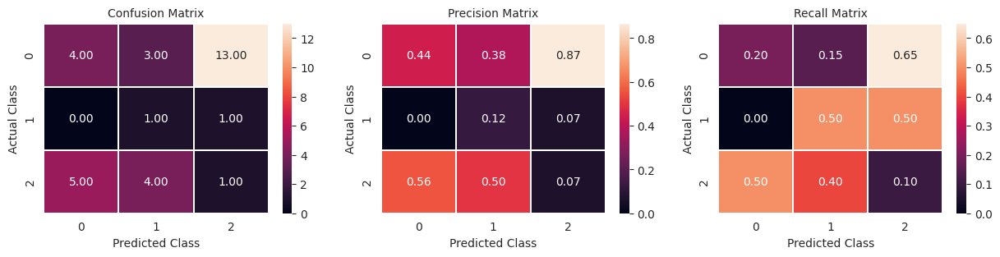


               precision    recall  f1-score   support

           0       0.44      0.20      0.28        20
           1       0.12      0.50      0.20         2
           2       0.07      0.10      0.08        10

    accuracy                           0.19        32
   macro avg       0.21      0.27      0.19        32
weighted avg       0.31      0.19      0.21        32



In [ ]:
for x,y,z in preprocessed_train_ds.take(1):
  eval = model.predict(x)

eval = eval.argmax(axis=1)
#eval = tf.expand_dims(tf.math.argmax(eval,-1),axis=-1)
target = tf.expand_dims(tf.math.argmax(y,axis=1),axis=-1)
print(eval.shape,target.shape)
plot_confusion_matrix(target, eval, labels=[0,1,2])

print("\n",classification_report(y_true=target, y_pred=eval))

**Experiment Run Function**

In [ ]:
X_train.columns

Index(['Drug', 'Sex', 'Ascites', 'Hepatomegaly', 'Spiders', 'Edema',
       'Bilirubin', 'Cholesterol', 'Albumin', 'Copper', 'Alk_Phos', 'SGOT',
       'Tryglicerides', 'Platelets', 'Prothrombin', 'Stage', 'count_disease',
       'Status_C', 'Status_CL', 'Status_D', 'Age_binned', 'N_Days_binned',
       'Prothrombin_binned', 'Bilirubin_binned', 'Albumin_binned',
       'Cholesterol_binned', 'Copper_binned', 'Alk_Phos_binned', 'SGOT_binned',
       'Tryglicerides_binned', 'Platelets_binned', 'Bil_Prot',
       'bill_proh_binned', 'all_tests', 'all_tests_aged',
       'all_tests_aged_days', 'all_tests_aged_days_ills',
       'all_tests_aged_days_ills_alt', 'all_tests_aged_days_ills_stage',
       'min_class_feat_RF', 'weights'],
      dtype='object')

In [ ]:
def run_experiment(train, test_data_file, input_format="concat", experiment_name="model_baseline", splits=5, num_epochs=200, batch_size=32, n_repeats=8, rs=42):

  skf = RepeatedStratifiedKFold(n_splits=splits, n_repeats=n_repeats, random_state=rs)
  test_results_df_C = pd.DataFrame(index=test_data_file.index, columns=list(range(splits*n_repeats)))
  test_results_df_CL = pd.DataFrame(index=test_data_file.index, columns=list(range(splits*n_repeats)))
  test_results_df_D = pd.DataFrame(index=test_data_file.index, columns=list(range(splits*n_repeats)))

  test_results_df = pd.DataFrame(index=test_data_file.index, columns=["Status_C","Status_CL","Status_D"])

  all_logloss = []


  for i, (train_index, valid_index) in enumerate(skf.split(X_train,strat_feature)):

    print(f"\nRunning CV {i}\n")
    # Prepare the Dataset:
    train_data_file = train.iloc[train_index,:]
    val_data_file = train.iloc[valid_index,:]

    train_dataset = dataframe_to_dataset(train_data_file, batch_size=batch_size, shuffle=True)
    valid_dataset = dataframe_to_dataset(val_data_file, batch_size=batch_size, shuffle=False)
    test_dataset = dataframe_to_dataset(test_data_file, batch_size=batch_size, shuffle=False)


    feature_space = FeatureSpace(
                                features={**{a:FeatureSpace.integer_categorical(num_oov_indices=1, output_mode="one_hot") for a in cat_var},**{a:FeatureSpace.float_normalized() for a in num_var}},
                                # Specify feature cross with a custom crossing dim.
                                crosses=[FeatureSpace.cross(feature_names=("count_disease","bill_proh_binned"), crossing_dim=10, output_mode="one_hot")],
                                output_mode=input_format
                                )

    train_ds_with_no_labels = train_dataset.map(lambda x, *_: x)
    print("Adapting Features Space....")
    feature_space.adapt(train_ds_with_no_labels)

    preprocessed_train_ds = train_dataset.map(lambda x, y, w: (feature_space(x), y, w), num_parallel_calls=tf.data.AUTOTUNE).prefetch(tf.data.AUTOTUNE)
    preprocessed_valid_ds = valid_dataset.map(lambda x, y, w: (feature_space(x), y, w), num_parallel_calls=tf.data.AUTOTUNE).prefetch(tf.data.AUTOTUNE)
    preprocessed_test_ds = test_dataset.map(lambda x, y, w: (feature_space(x), y, w), num_parallel_calls=tf.data.AUTOTUNE).prefetch(tf.data.AUTOTUNE)

    # Callbacks:
    early_stopping = tf.keras.callbacks.EarlyStopping(monitor="val_loss", patience=15, restore_best_weights=True, start_from_epoch=5)
    reduce_on_plat = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, min_lr=0.00001)
    checkpoint_filepath = folders_nn + 'checkpoint/'
    Checkpoint = tf.keras.callbacks.ModelCheckpoint(filepath=checkpoint_filepath,
                                                    save_weights_only=True,
                                                    monitor="val_loss",
                                                    mode='min',
                                                    restore_best_weights=True)

    # Generate Model
    model = create_baseline_model(feature_space,
                                  name=experiment_name,
                                  learning_rate = 0.0005,
                                  activation="swish",
                                  gn_noise=0.0,
                                  dropout=0.5,
                                  hidden_layers=3,
                                  units_0=256,
                                  units_1=256)

    print("Start training the model...")
    history = model.fit(preprocessed_train_ds, epochs=num_epochs, callbacks=[early_stopping,Checkpoint,reduce_on_plat],validation_data=preprocessed_valid_ds)
    print("Model training finished")

    model.load_weights(checkpoint_filepath)
    log_loss, AUC_pr = model.evaluate(preprocessed_valid_ds, verbose=0)

    plot_training_session(history)

    y_hat = model.predict(preprocessed_test_ds)


    eval = model.predict(preprocessed_valid_ds)

    eval = eval.argmax(axis=1)
    y_validation = val_data_file[['Status_C', 'Status_CL', 'Status_D']].values
    #eval = tf.expand_dims(tf.math.argmax(eval,-1),axis=-1)
    target = tf.expand_dims(tf.math.argmax(y_validation,axis=1),axis=-1)
    print(eval.shape,target.shape)
    plot_confusion_matrix(target, eval, labels=[0,1,2])

    print("\n",classification_report(y_true=target, y_pred=eval))
    print(f"y_hat shape:{y_hat.shape}")

    test_results_df_C.iloc[:,i] = y_hat[:,0]
    test_results_df_CL.iloc[:,i] = y_hat[:,1]
    test_results_df_D.iloc[:,i] = y_hat[:,2]

    model.save(f'{folders_nn+experiment_name}/CV_{i}')
    feature_space.save(f"{folders_nn+experiment_name}/CV_{i}/myfeaturespace_{experiment_name}.keras")


    print(f"Test log_loss: {round(log_loss, 2)}%")
    all_logloss.append(round(log_loss, 3))

  test_results_df_C["Mean"] = test_results_df_C.mean(axis=1)
  test_results_df_CL["Mean"] = test_results_df_CL.mean(axis=1)
  test_results_df_D["Mean"] = test_results_df_D.mean(axis=1)

  test_results_df.loc[:,"C"] = test_results_df_C["Mean"].values
  test_results_df.loc[:,"CL"] = test_results_df_CL["Mean"].values
  test_results_df.loc[:,"D"] = test_results_df_D["Mean"].values

  print(f"All Valuation AUC_pr: {AUC_pr}")
  print(f"All Valuation lOGlOSS: {all_logloss}")

  return test_results_df_C,test_results_df_CL,test_results_df_D, test_results_df


Running CV 0

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 58s 23ms/step - loss: 1.4488 - auc_15: 0.5219 - val_loss: 1.0101 - val_auc_15: 0.5952 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 5s 22ms/step - loss: 1.1995 - auc_15: 0.6058 - val_loss: 0.8240 - val_auc_15: 0.7805 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 4s 20ms/step - loss: 1.1033 - auc_15: 0.6376 - val_loss: 0.8078 - val_auc_15: 0.7677 - lr: 5.0000e-04
Epoch 4/200
205/205 [==============================] - 4s 20ms/step - loss: 1.0372 - auc_15: 0.6540 - val_loss: 0.7790 - val_auc_15: 0.7531 - lr: 5.0000e-04
Epoch 5/200
205/205 [==============================] - 3s 14ms/step - loss: 0.9673 - auc_15: 0.6675 - val_loss: 0.7798 - val_auc_15: 0.7461 - lr: 5.0000e-04
Epoch 6/200
205/205 [==============================] - 3s 16ms/step - loss: 0.9180 - auc_15: 0.6874 - val_loss: 0.7652 - val_auc_15: 0.7708 - l

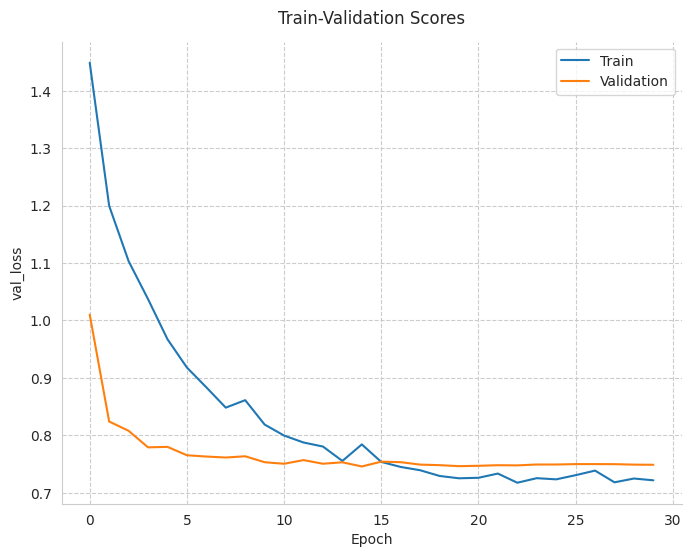

52/52 [==============================] - 1s 4ms/step
(1637,) (1637, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


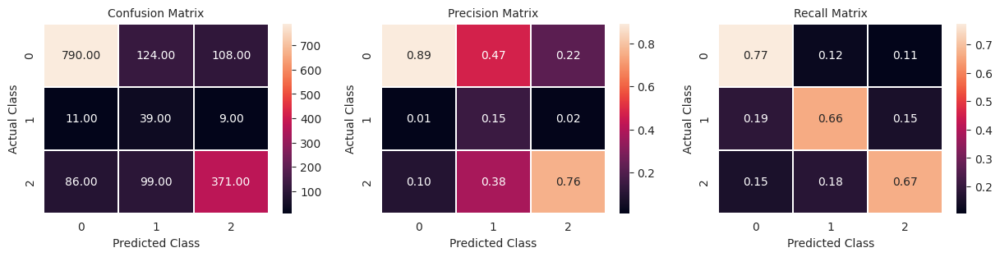


               precision    recall  f1-score   support

           0       0.89      0.77      0.83      1022
           1       0.15      0.66      0.24        59
           2       0.76      0.67      0.71       556

    accuracy                           0.73      1637
   macro avg       0.60      0.70      0.59      1637
weighted avg       0.82      0.73      0.77      1637

y_hat shape:(5271, 3)
Test log_loss: 0.75%

Running CV 1

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 6s 18ms/step - loss: 1.4137 - auc_16: 0.5489 - val_loss: 1.0549 - val_auc_16: 0.4085 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 5s 22ms/step - loss: 1.1275 - auc_16: 0.6316 - val_loss: 0.8777 - val_auc_16: 0.6783 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 3s 13ms/step - loss: 1.0717 - auc_16: 0.6583 - val_loss: 0.8590 - val_auc_16: 0.7341 - lr: 5.0000e-04
Epoch 4/200
205/205 [===========

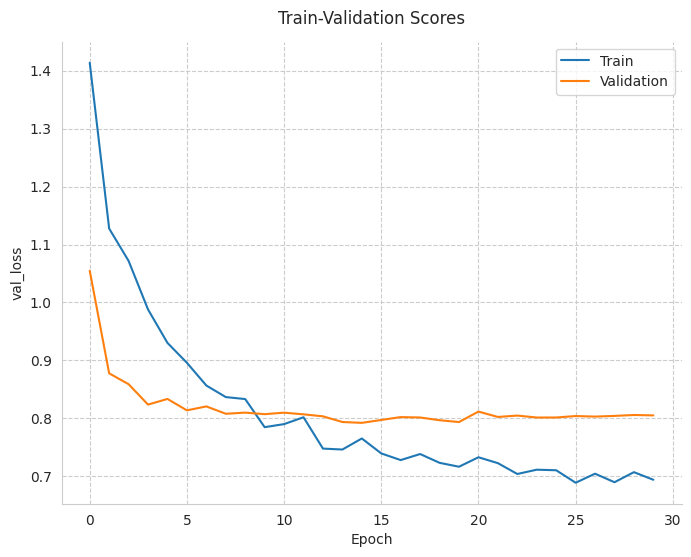

52/52 [==============================] - 1s 4ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


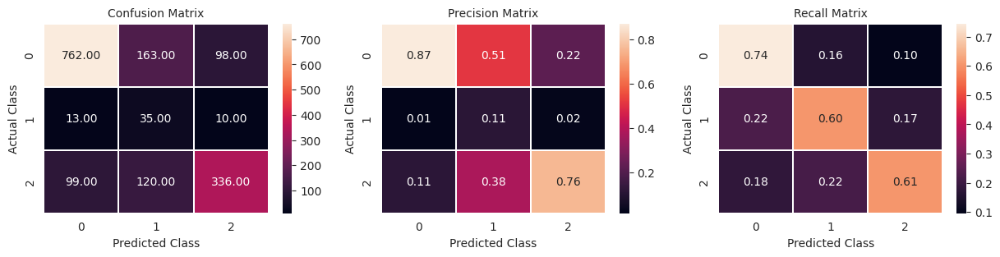


               precision    recall  f1-score   support

           0       0.87      0.74      0.80      1023
           1       0.11      0.60      0.19        58
           2       0.76      0.61      0.67       555

    accuracy                           0.69      1636
   macro avg       0.58      0.65      0.55      1636
weighted avg       0.81      0.69      0.74      1636

y_hat shape:(5271, 3)
Test log_loss: 0.79%

Running CV 2

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 8s 18ms/step - loss: 1.4060 - auc_17: 0.5587 - val_loss: 0.8555 - val_auc_17: 0.6325 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 4s 17ms/step - loss: 1.2058 - auc_17: 0.6313 - val_loss: 0.8122 - val_auc_17: 0.7038 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 4s 20ms/step - loss: 1.0996 - auc_17: 0.6387 - val_loss: 0.7779 - val_auc_17: 0.6853 - lr: 5.0000e-04
Epoch 4/200
205/205 [===========

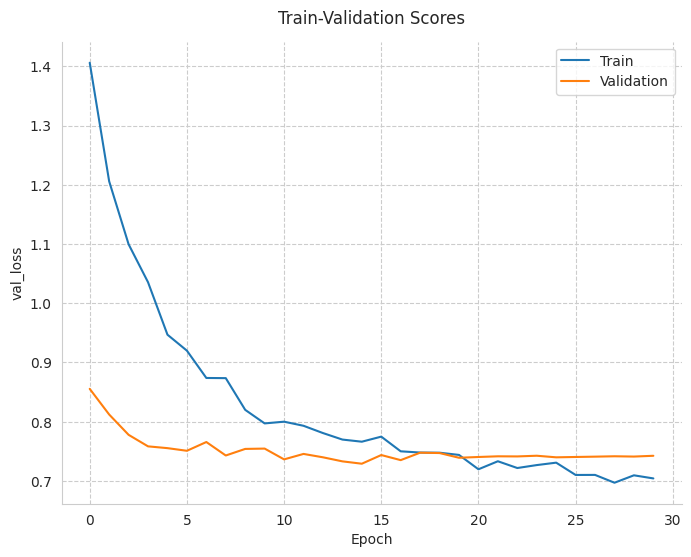

52/52 [==============================] - 1s 4ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


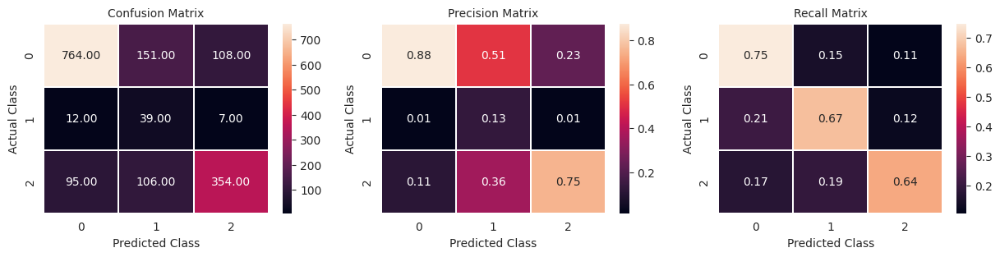


               precision    recall  f1-score   support

           0       0.88      0.75      0.81      1023
           1       0.13      0.67      0.22        58
           2       0.75      0.64      0.69       555

    accuracy                           0.71      1636
   macro avg       0.59      0.69      0.57      1636
weighted avg       0.81      0.71      0.75      1636

y_hat shape:(5271, 3)
Test log_loss: 0.73%

Running CV 3

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 7s 24ms/step - loss: 1.5055 - auc_18: 0.5094 - val_loss: 0.8545 - val_auc_18: 0.7415 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 3s 14ms/step - loss: 1.1486 - auc_18: 0.6124 - val_loss: 0.8208 - val_auc_18: 0.7626 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 3s 13ms/step - loss: 1.0885 - auc_18: 0.6421 - val_loss: 0.8211 - val_auc_18: 0.7437 - lr: 5.0000e-04
Epoch 4/200
205/205 [===========

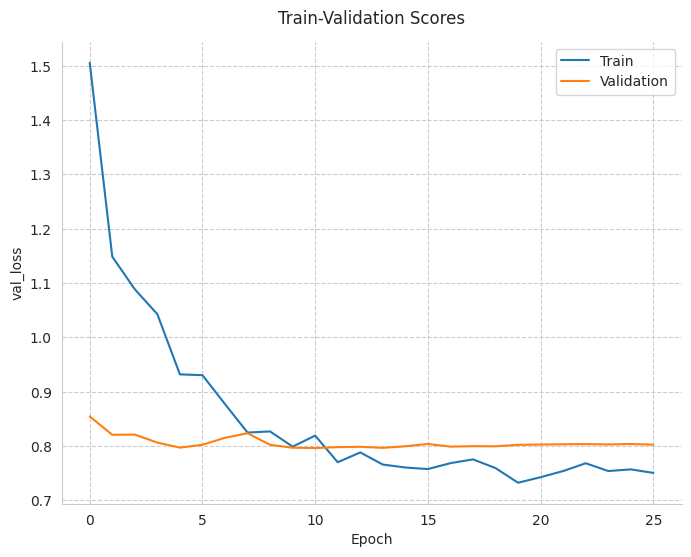

52/52 [==============================] - 1s 6ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


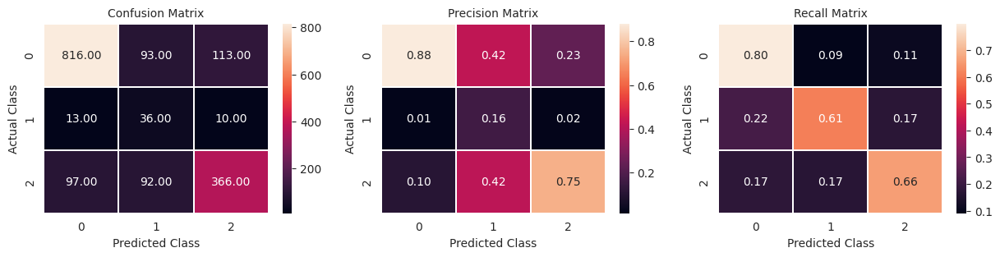


               precision    recall  f1-score   support

           0       0.88      0.80      0.84      1022
           1       0.16      0.61      0.26        59
           2       0.75      0.66      0.70       555

    accuracy                           0.74      1636
   macro avg       0.60      0.69      0.60      1636
weighted avg       0.81      0.74      0.77      1636

y_hat shape:(5271, 3)
Test log_loss: 0.8%

Running CV 4

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 8s 24ms/step - loss: 1.4421 - auc_19: 0.5084 - val_loss: 0.8891 - val_auc_19: 0.7098 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 3s 15ms/step - loss: 1.1776 - auc_19: 0.6065 - val_loss: 0.7466 - val_auc_19: 0.7838 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 3s 14ms/step - loss: 1.1151 - auc_19: 0.6251 - val_loss: 0.7253 - val_auc_19: 0.7810 - lr: 5.0000e-04
Epoch 4/200
205/205 [============

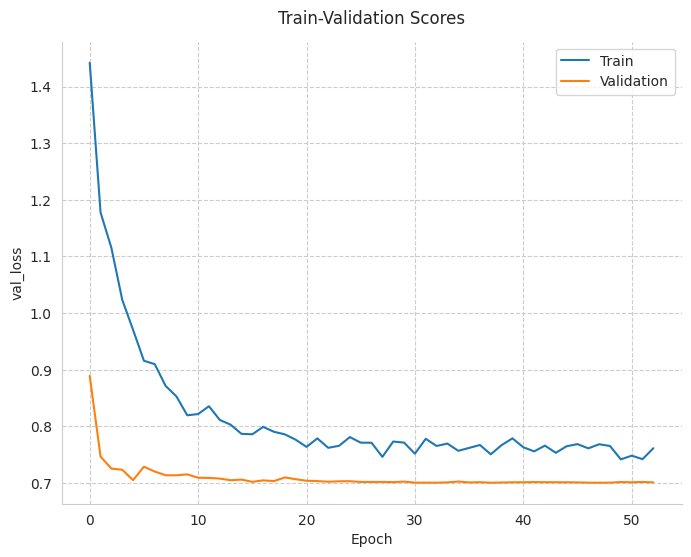

52/52 [==============================] - 1s 6ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


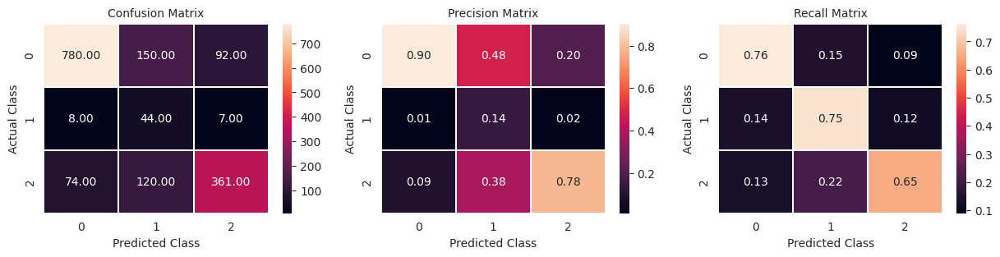


               precision    recall  f1-score   support

           0       0.90      0.76      0.83      1022
           1       0.14      0.75      0.24        59
           2       0.78      0.65      0.71       555

    accuracy                           0.72      1636
   macro avg       0.61      0.72      0.59      1636
weighted avg       0.84      0.72      0.77      1636

y_hat shape:(5271, 3)
Test log_loss: 0.7%

Running CV 5

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 7s 18ms/step - loss: 1.4970 - auc_20: 0.5166 - val_loss: 0.9459 - val_auc_20: 0.6947 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 3s 15ms/step - loss: 1.2327 - auc_20: 0.5959 - val_loss: 0.7578 - val_auc_20: 0.7357 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 5s 23ms/step - loss: 1.1194 - auc_20: 0.6272 - val_loss: 0.7156 - val_auc_20: 0.7783 - lr: 5.0000e-04
Epoch 4/200
205/205 [============

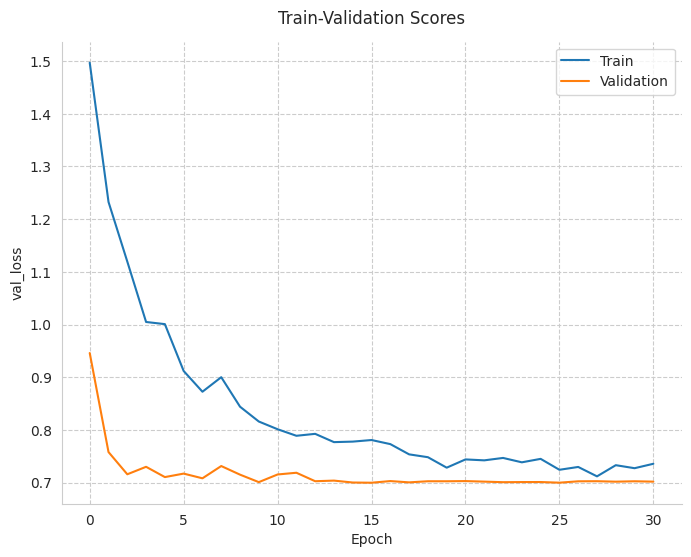

52/52 [==============================] - 1s 4ms/step
(1637,) (1637, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


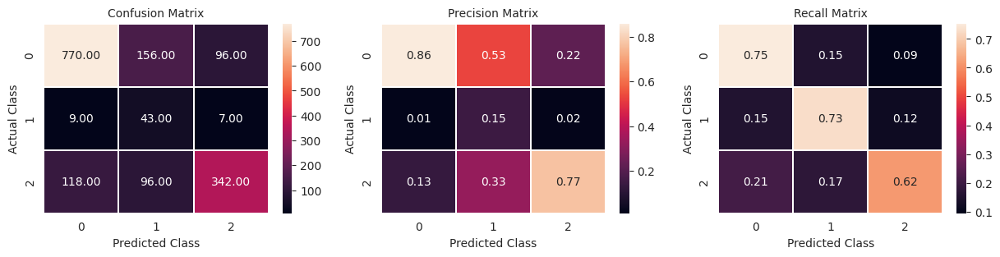


               precision    recall  f1-score   support

           0       0.86      0.75      0.80      1022
           1       0.15      0.73      0.24        59
           2       0.77      0.62      0.68       556

    accuracy                           0.71      1637
   macro avg       0.59      0.70      0.58      1637
weighted avg       0.80      0.71      0.74      1637

y_hat shape:(5271, 3)
Test log_loss: 0.7%

Running CV 6

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 6s 17ms/step - loss: 1.4492 - auc_21: 0.5366 - val_loss: 0.9500 - val_auc_21: 0.5483 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 5s 22ms/step - loss: 1.2154 - auc_21: 0.6083 - val_loss: 0.8333 - val_auc_21: 0.6809 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 5s 22ms/step - loss: 1.0805 - auc_21: 0.6320 - val_loss: 0.7984 - val_auc_21: 0.7929 - lr: 5.0000e-04
Epoch 4/200
205/205 [============

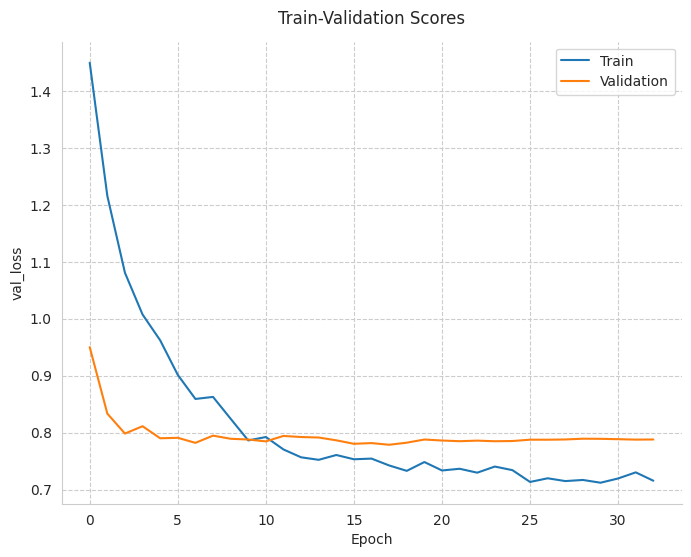

52/52 [==============================] - 1s 7ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


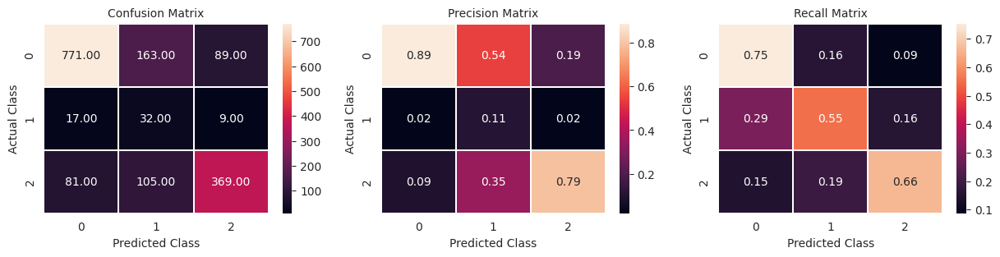


               precision    recall  f1-score   support

           0       0.89      0.75      0.82      1023
           1       0.11      0.55      0.18        58
           2       0.79      0.66      0.72       555

    accuracy                           0.72      1636
   macro avg       0.59      0.66      0.57      1636
weighted avg       0.83      0.72      0.76      1636

y_hat shape:(5271, 3)
Test log_loss: 0.78%

Running CV 7

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 6s 17ms/step - loss: 1.4868 - auc_22: 0.5408 - val_loss: 0.8685 - val_auc_22: 0.7154 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 4s 19ms/step - loss: 1.1320 - auc_22: 0.6362 - val_loss: 0.8022 - val_auc_22: 0.7658 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 5s 25ms/step - loss: 1.0831 - auc_22: 0.6315 - val_loss: 0.8016 - val_auc_22: 0.7701 - lr: 5.0000e-04
Epoch 4/200
205/205 [===========

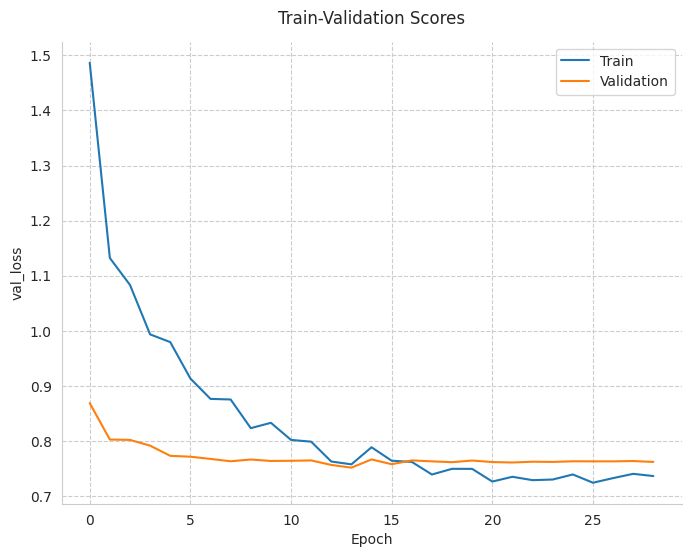

52/52 [==============================] - 1s 5ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


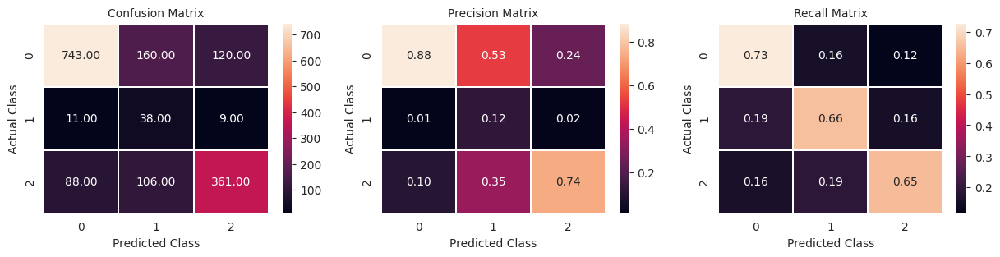


               precision    recall  f1-score   support

           0       0.88      0.73      0.80      1023
           1       0.12      0.66      0.21        58
           2       0.74      0.65      0.69       555

    accuracy                           0.70      1636
   macro avg       0.58      0.68      0.57      1636
weighted avg       0.81      0.70      0.74      1636

y_hat shape:(5271, 3)
Test log_loss: 0.75%

Running CV 8

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 6s 17ms/step - loss: 1.4341 - auc_23: 0.5555 - val_loss: 0.8779 - val_auc_23: 0.7332 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 5s 22ms/step - loss: 1.1453 - auc_23: 0.6143 - val_loss: 0.8536 - val_auc_23: 0.7602 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 5s 23ms/step - loss: 1.0950 - auc_23: 0.6399 - val_loss: 0.8201 - val_auc_23: 0.7827 - lr: 5.0000e-04
Epoch 4/200
205/205 [===========

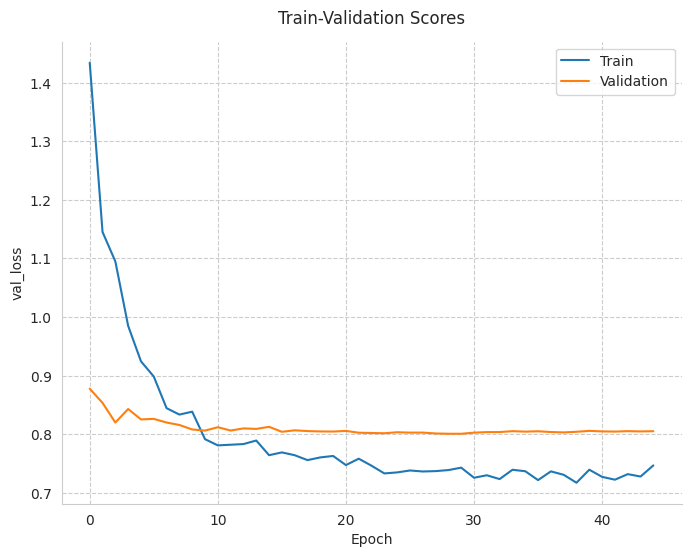

52/52 [==============================] - 1s 5ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


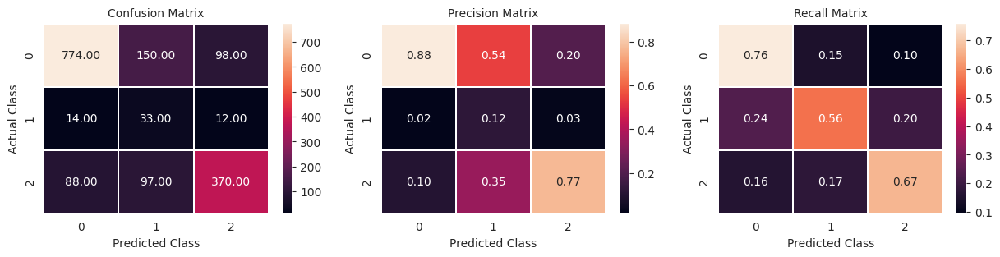


               precision    recall  f1-score   support

           0       0.88      0.76      0.82      1022
           1       0.12      0.56      0.19        59
           2       0.77      0.67      0.71       555

    accuracy                           0.72      1636
   macro avg       0.59      0.66      0.58      1636
weighted avg       0.82      0.72      0.76      1636

y_hat shape:(5271, 3)
Test log_loss: 0.8%

Running CV 9

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 7s 23ms/step - loss: 1.5554 - auc_24: 0.5120 - val_loss: 0.9373 - val_auc_24: 0.6427 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 4s 18ms/step - loss: 1.2443 - auc_24: 0.5895 - val_loss: 0.8067 - val_auc_24: 0.7926 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 4s 19ms/step - loss: 1.1611 - auc_24: 0.6420 - val_loss: 0.7726 - val_auc_24: 0.7883 - lr: 5.0000e-04
Epoch 4/200
205/205 [============

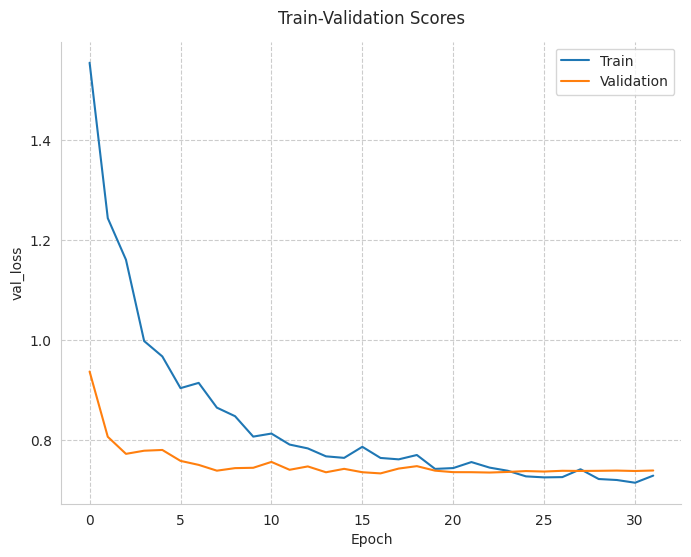

52/52 [==============================] - 1s 5ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


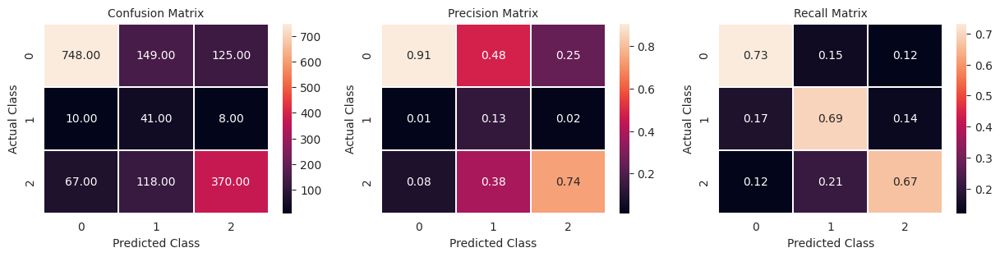


               precision    recall  f1-score   support

           0       0.91      0.73      0.81      1022
           1       0.13      0.69      0.22        59
           2       0.74      0.67      0.70       555

    accuracy                           0.71      1636
   macro avg       0.59      0.70      0.58      1636
weighted avg       0.82      0.71      0.75      1636

y_hat shape:(5271, 3)
Test log_loss: 0.73%

Running CV 10

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 7s 18ms/step - loss: 1.5845 - auc_25: 0.5194 - val_loss: 1.1063 - val_auc_25: 0.3590 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 3s 16ms/step - loss: 1.1927 - auc_25: 0.6185 - val_loss: 0.8624 - val_auc_25: 0.6418 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 5s 22ms/step - loss: 1.0746 - auc_25: 0.6373 - val_loss: 0.8087 - val_auc_25: 0.7194 - lr: 5.0000e-04
Epoch 4/200
205/205 [==========

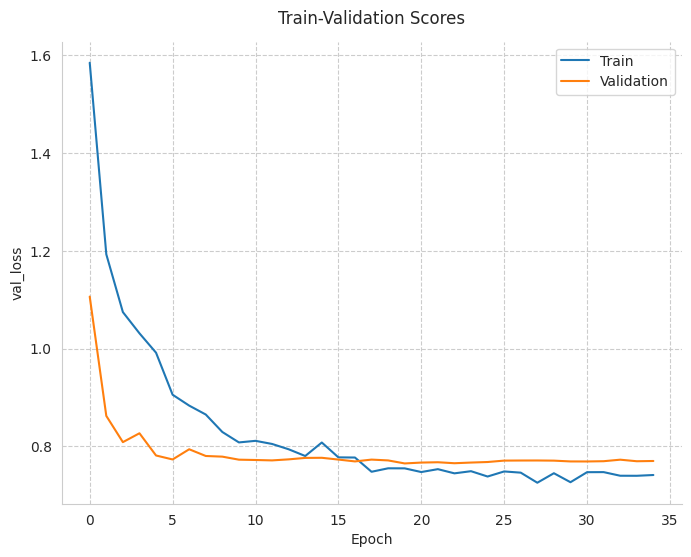

52/52 [==============================] - 1s 4ms/step
(1637,) (1637, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


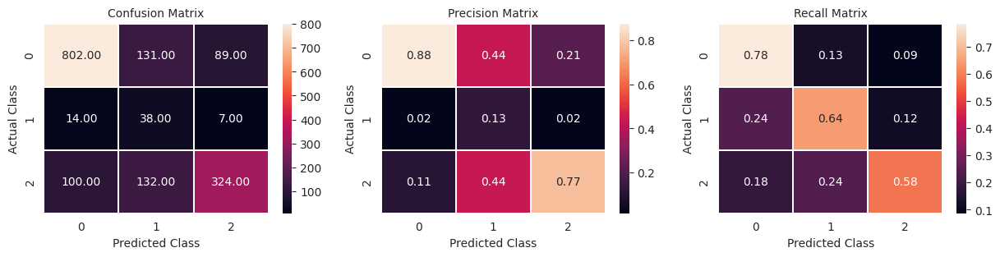


               precision    recall  f1-score   support

           0       0.88      0.78      0.83      1022
           1       0.13      0.64      0.21        59
           2       0.77      0.58      0.66       556

    accuracy                           0.71      1637
   macro avg       0.59      0.67      0.57      1637
weighted avg       0.81      0.71      0.75      1637

y_hat shape:(5271, 3)
Test log_loss: 0.77%

Running CV 11

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 11s 28ms/step - loss: 1.4552 - auc_26: 0.5226 - val_loss: 0.9265 - val_auc_26: 0.5991 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 3s 16ms/step - loss: 1.2100 - auc_26: 0.6153 - val_loss: 0.8041 - val_auc_26: 0.7560 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 4s 17ms/step - loss: 1.1344 - auc_26: 0.6333 - val_loss: 0.7570 - val_auc_26: 0.7394 - lr: 5.0000e-04
Epoch 4/200
205/205 [=========

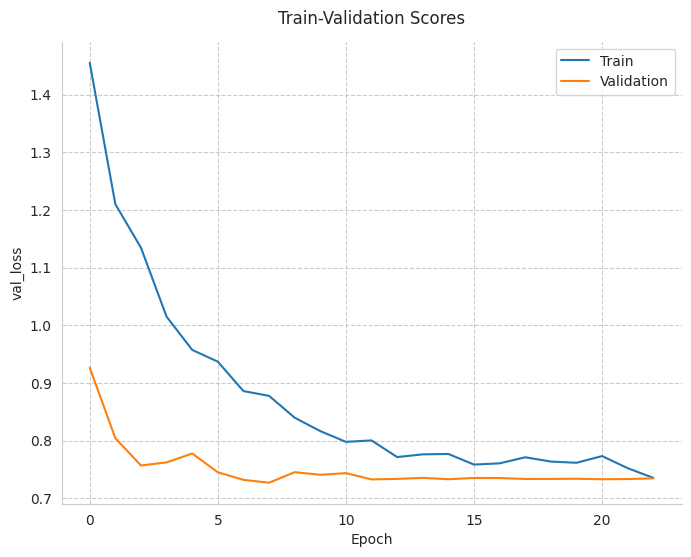

52/52 [==============================] - 1s 4ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


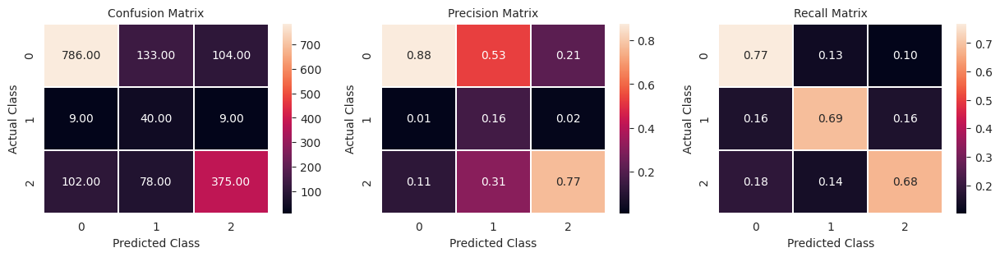


               precision    recall  f1-score   support

           0       0.88      0.77      0.82      1023
           1       0.16      0.69      0.26        58
           2       0.77      0.68      0.72       555

    accuracy                           0.73      1636
   macro avg       0.60      0.71      0.60      1636
weighted avg       0.81      0.73      0.77      1636

y_hat shape:(5271, 3)
Test log_loss: 0.73%

Running CV 12

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 6s 18ms/step - loss: 1.5119 - auc_27: 0.5221 - val_loss: 0.8746 - val_auc_27: 0.6078 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 4s 19ms/step - loss: 1.2898 - auc_27: 0.5781 - val_loss: 0.7903 - val_auc_27: 0.7136 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 5s 24ms/step - loss: 1.1337 - auc_27: 0.6152 - val_loss: 0.7635 - val_auc_27: 0.7393 - lr: 5.0000e-04
Epoch 4/200
205/205 [==========

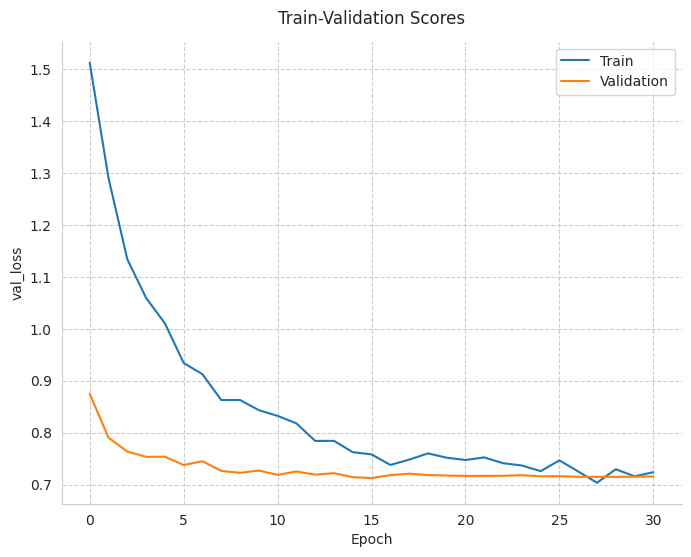

52/52 [==============================] - 1s 6ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


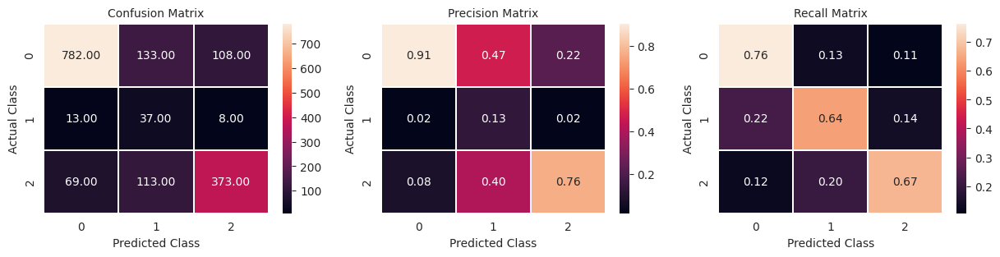


               precision    recall  f1-score   support

           0       0.91      0.76      0.83      1023
           1       0.13      0.64      0.22        58
           2       0.76      0.67      0.71       555

    accuracy                           0.73      1636
   macro avg       0.60      0.69      0.59      1636
weighted avg       0.83      0.73      0.77      1636

y_hat shape:(5271, 3)
Test log_loss: 0.71%

Running CV 13

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 8s 21ms/step - loss: 1.4959 - auc_28: 0.5299 - val_loss: 0.8425 - val_auc_28: 0.7279 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 3s 15ms/step - loss: 1.1852 - auc_28: 0.5983 - val_loss: 0.7683 - val_auc_28: 0.7593 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 4s 17ms/step - loss: 1.1103 - auc_28: 0.6348 - val_loss: 0.7487 - val_auc_28: 0.7821 - lr: 5.0000e-04
Epoch 4/200
205/205 [==========

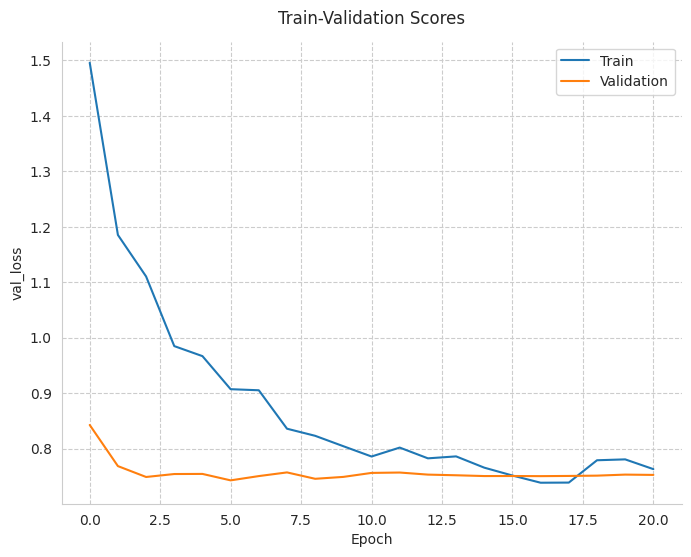

52/52 [==============================] - 1s 5ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


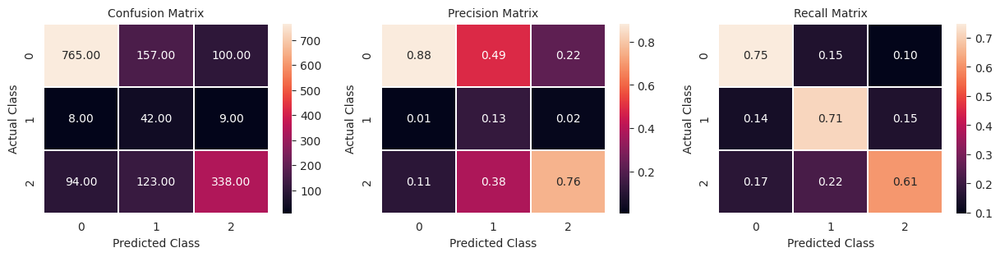


               precision    recall  f1-score   support

           0       0.88      0.75      0.81      1022
           1       0.13      0.71      0.22        59
           2       0.76      0.61      0.67       555

    accuracy                           0.70      1636
   macro avg       0.59      0.69      0.57      1636
weighted avg       0.81      0.70      0.74      1636

y_hat shape:(5271, 3)
Test log_loss: 0.74%

Running CV 14

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 7s 20ms/step - loss: 1.3861 - auc_29: 0.5471 - val_loss: 0.9585 - val_auc_29: 0.5318 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 3s 16ms/step - loss: 1.2041 - auc_29: 0.6063 - val_loss: 0.8540 - val_auc_29: 0.7956 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 5s 23ms/step - loss: 1.0541 - auc_29: 0.6496 - val_loss: 0.8588 - val_auc_29: 0.7232 - lr: 5.0000e-04
Epoch 4/200
205/205 [==========

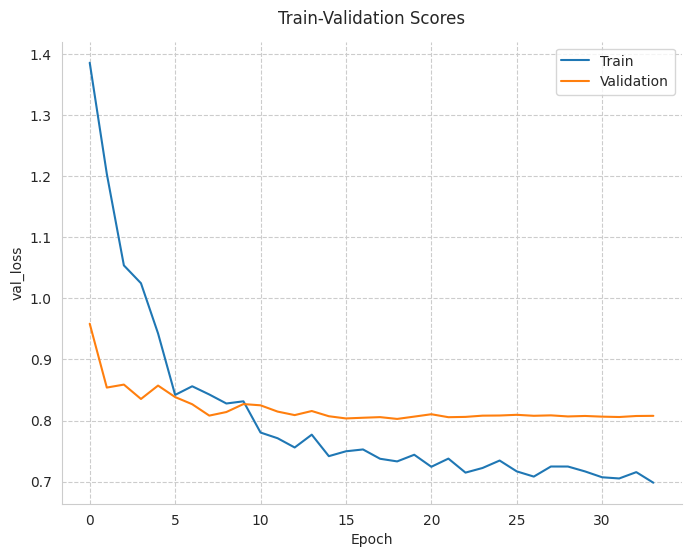

52/52 [==============================] - 1s 5ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


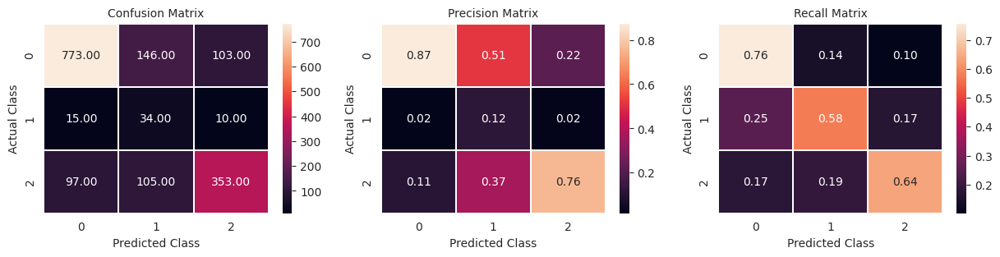


               precision    recall  f1-score   support

           0       0.87      0.76      0.81      1022
           1       0.12      0.58      0.20        59
           2       0.76      0.64      0.69       555

    accuracy                           0.71      1636
   macro avg       0.58      0.66      0.57      1636
weighted avg       0.81      0.71      0.75      1636

y_hat shape:(5271, 3)
Test log_loss: 0.8%

Running CV 15

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 7s 19ms/step - loss: 1.4085 - auc_30: 0.5213 - val_loss: 0.9461 - val_auc_30: 0.7650 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 3s 16ms/step - loss: 1.2165 - auc_30: 0.6085 - val_loss: 0.8694 - val_auc_30: 0.7667 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 5s 25ms/step - loss: 1.0474 - auc_30: 0.6475 - val_loss: 0.8623 - val_auc_30: 0.7900 - lr: 5.0000e-04
Epoch 4/200
205/205 [===========

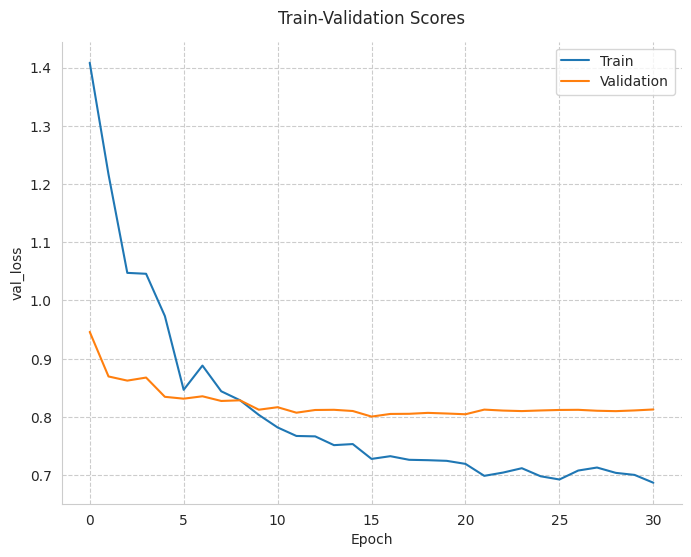

52/52 [==============================] - 1s 7ms/step
(1637,) (1637, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


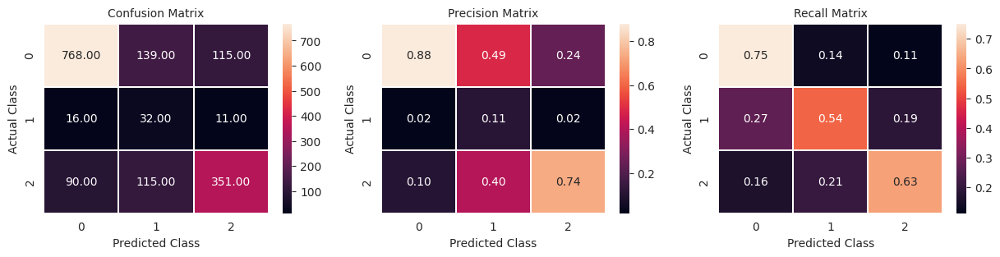


               precision    recall  f1-score   support

           0       0.88      0.75      0.81      1022
           1       0.11      0.54      0.19        59
           2       0.74      0.63      0.68       556

    accuracy                           0.70      1637
   macro avg       0.58      0.64      0.56      1637
weighted avg       0.80      0.70      0.74      1637

y_hat shape:(5271, 3)
Test log_loss: 0.8%

Running CV 16

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 10s 28ms/step - loss: 1.4903 - auc_31: 0.5153 - val_loss: 0.8534 - val_auc_31: 0.7655 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 4s 19ms/step - loss: 1.3115 - auc_31: 0.5932 - val_loss: 0.6941 - val_auc_31: 0.8113 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 3s 17ms/step - loss: 1.1560 - auc_31: 0.6230 - val_loss: 0.6762 - val_auc_31: 0.8053 - lr: 5.0000e-04
Epoch 4/200
205/205 [==========

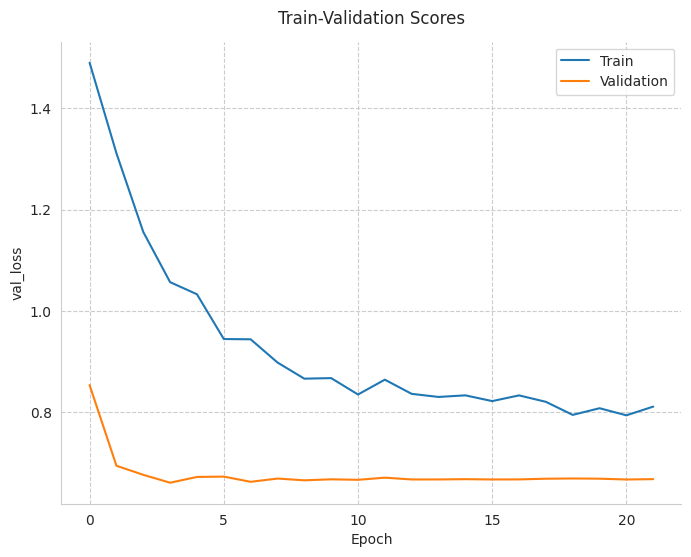

52/52 [==============================] - 1s 7ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


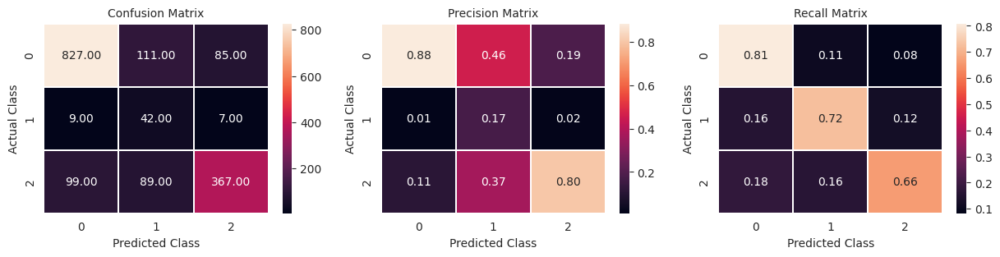


               precision    recall  f1-score   support

           0       0.88      0.81      0.84      1023
           1       0.17      0.72      0.28        58
           2       0.80      0.66      0.72       555

    accuracy                           0.76      1636
   macro avg       0.62      0.73      0.62      1636
weighted avg       0.83      0.76      0.78      1636

y_hat shape:(5271, 3)
Test log_loss: 0.66%

Running CV 17

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 7s 20ms/step - loss: 1.4622 - auc_32: 0.5329 - val_loss: 0.8819 - val_auc_32: 0.6189 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 5s 23ms/step - loss: 1.1956 - auc_32: 0.6026 - val_loss: 0.8299 - val_auc_32: 0.6932 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 4s 19ms/step - loss: 1.1212 - auc_32: 0.6354 - val_loss: 0.8253 - val_auc_32: 0.7269 - lr: 5.0000e-04
Epoch 4/200
205/205 [==========

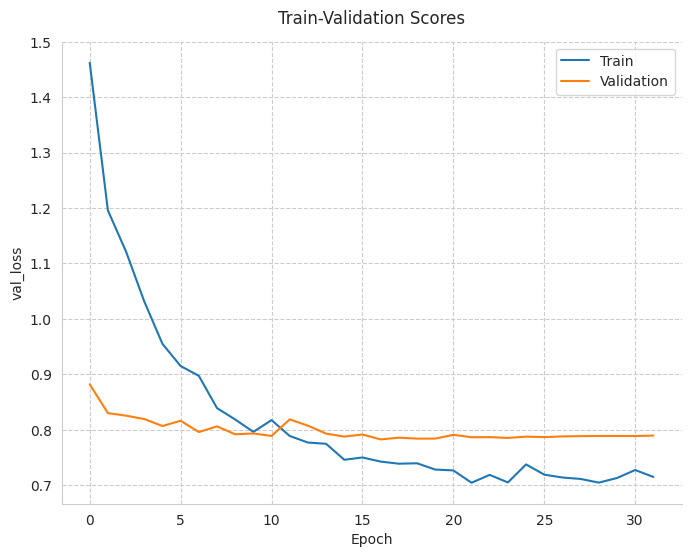

52/52 [==============================] - 1s 5ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


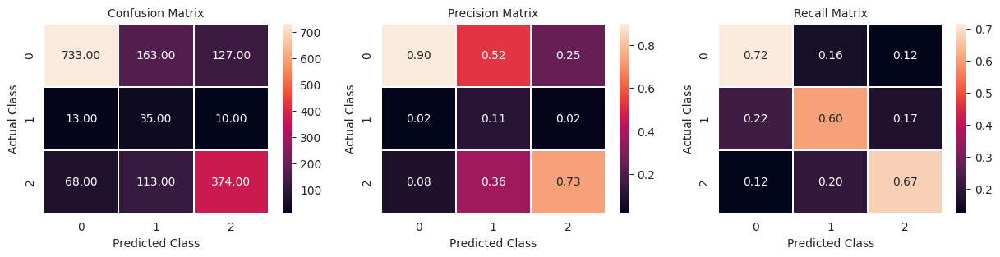


               precision    recall  f1-score   support

           0       0.90      0.72      0.80      1023
           1       0.11      0.60      0.19        58
           2       0.73      0.67      0.70       555

    accuracy                           0.70      1636
   macro avg       0.58      0.66      0.56      1636
weighted avg       0.82      0.70      0.74      1636

y_hat shape:(5271, 3)
Test log_loss: 0.78%

Running CV 18

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 7s 20ms/step - loss: 1.4524 - auc_33: 0.5343 - val_loss: 0.9957 - val_auc_33: 0.3618 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 5s 22ms/step - loss: 1.2430 - auc_33: 0.6022 - val_loss: 0.7623 - val_auc_33: 0.7163 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 5s 22ms/step - loss: 1.1265 - auc_33: 0.6306 - val_loss: 0.7408 - val_auc_33: 0.7730 - lr: 5.0000e-04
Epoch 4/200
205/205 [==========

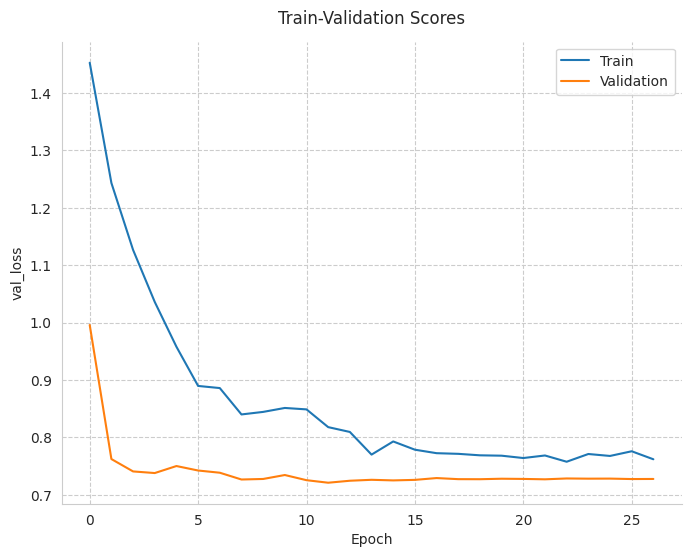

52/52 [==============================] - 1s 6ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


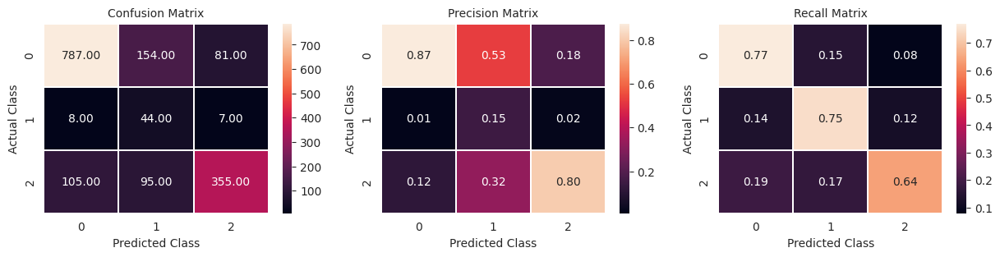


               precision    recall  f1-score   support

           0       0.87      0.77      0.82      1022
           1       0.15      0.75      0.25        59
           2       0.80      0.64      0.71       555

    accuracy                           0.72      1636
   macro avg       0.61      0.72      0.59      1636
weighted avg       0.82      0.72      0.76      1636

y_hat shape:(5271, 3)
Test log_loss: 0.72%

Running CV 19

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 9s 23ms/step - loss: 1.4310 - auc_34: 0.5330 - val_loss: 0.8842 - val_auc_34: 0.4838 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 4s 21ms/step - loss: 1.1984 - auc_34: 0.6028 - val_loss: 0.7807 - val_auc_34: 0.7660 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 6s 28ms/step - loss: 1.1167 - auc_34: 0.6436 - val_loss: 0.7826 - val_auc_34: 0.7557 - lr: 5.0000e-04
Epoch 4/200
205/205 [==========

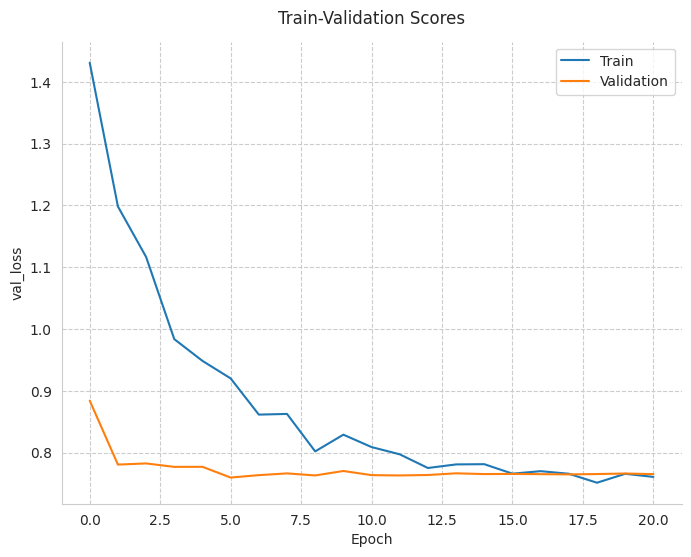

52/52 [==============================] - 1s 6ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


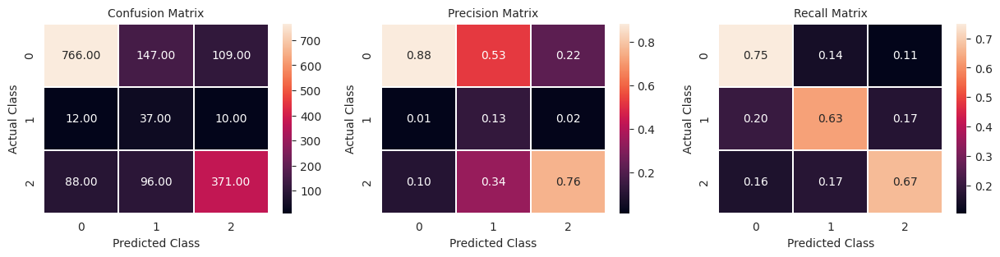


               precision    recall  f1-score   support

           0       0.88      0.75      0.81      1022
           1       0.13      0.63      0.22        59
           2       0.76      0.67      0.71       555

    accuracy                           0.72      1636
   macro avg       0.59      0.68      0.58      1636
weighted avg       0.81      0.72      0.76      1636

y_hat shape:(5271, 3)
Test log_loss: 0.76%

Running CV 20

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 7s 21ms/step - loss: 1.4182 - auc_35: 0.5307 - val_loss: 0.9287 - val_auc_35: 0.6399 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 5s 23ms/step - loss: 1.1923 - auc_35: 0.6016 - val_loss: 0.8512 - val_auc_35: 0.6762 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 6s 27ms/step - loss: 1.0948 - auc_35: 0.6443 - val_loss: 0.8275 - val_auc_35: 0.7232 - lr: 5.0000e-04
Epoch 4/200
205/205 [==========

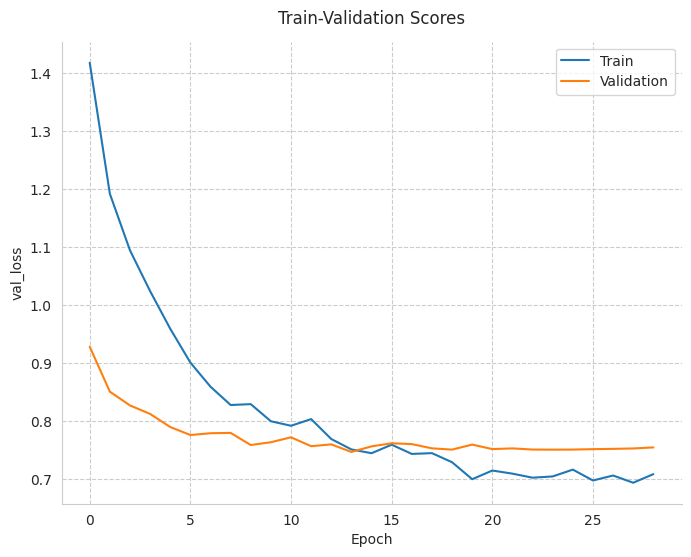

52/52 [==============================] - 1s 6ms/step
(1637,) (1637, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


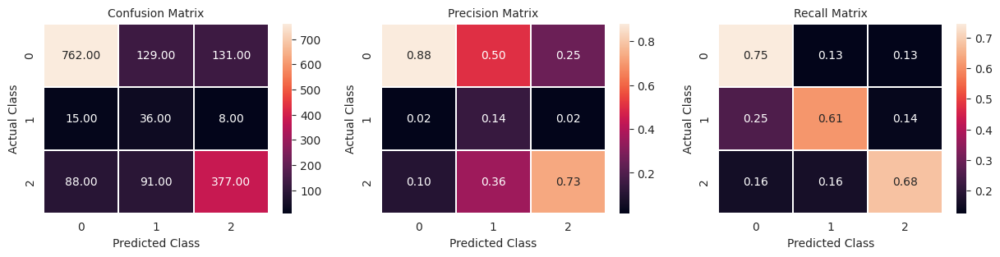


               precision    recall  f1-score   support

           0       0.88      0.75      0.81      1022
           1       0.14      0.61      0.23        59
           2       0.73      0.68      0.70       556

    accuracy                           0.72      1637
   macro avg       0.58      0.68      0.58      1637
weighted avg       0.80      0.72      0.75      1637

y_hat shape:(5271, 3)
Test log_loss: 0.75%

Running CV 21

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 7s 24ms/step - loss: 1.3980 - auc_36: 0.5186 - val_loss: 0.8871 - val_auc_36: 0.7170 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 4s 19ms/step - loss: 1.1496 - auc_36: 0.6127 - val_loss: 0.7590 - val_auc_36: 0.7780 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 5s 23ms/step - loss: 1.1272 - auc_36: 0.6179 - val_loss: 0.7712 - val_auc_36: 0.8071 - lr: 5.0000e-04
Epoch 4/200
205/205 [==========

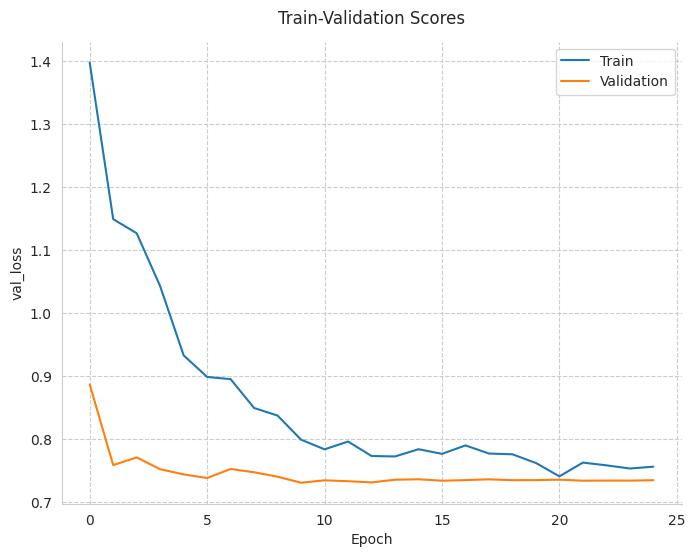

52/52 [==============================] - 1s 7ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


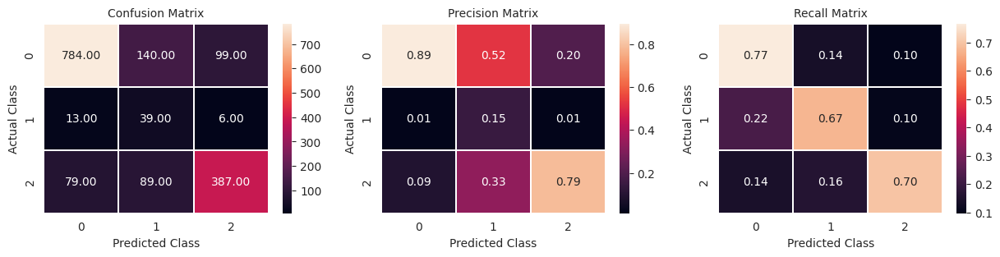


               precision    recall  f1-score   support

           0       0.89      0.77      0.83      1023
           1       0.15      0.67      0.24        58
           2       0.79      0.70      0.74       555

    accuracy                           0.74      1636
   macro avg       0.61      0.71      0.60      1636
weighted avg       0.83      0.74      0.78      1636

y_hat shape:(5271, 3)
Test log_loss: 0.73%

Running CV 22

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 7s 23ms/step - loss: 1.5079 - auc_37: 0.5263 - val_loss: 0.9114 - val_auc_37: 0.6726 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 4s 21ms/step - loss: 1.1563 - auc_37: 0.6149 - val_loss: 0.7758 - val_auc_37: 0.7083 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 4s 21ms/step - loss: 1.0751 - auc_37: 0.6411 - val_loss: 0.7650 - val_auc_37: 0.8126 - lr: 5.0000e-04
Epoch 4/200
205/205 [==========

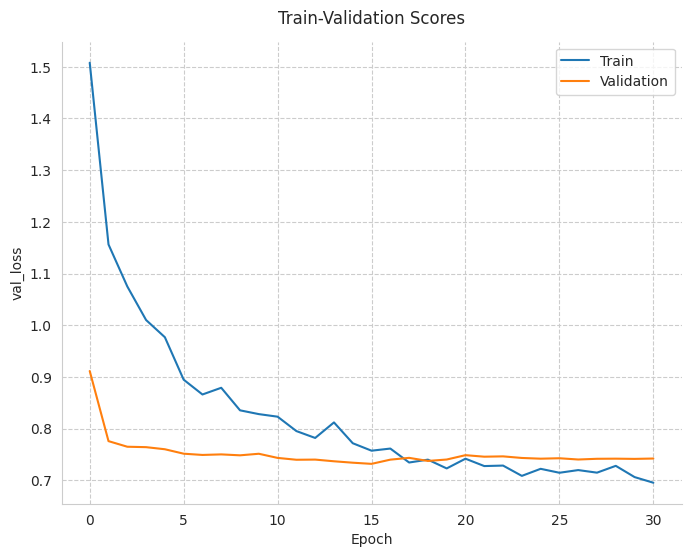

52/52 [==============================] - 1s 6ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


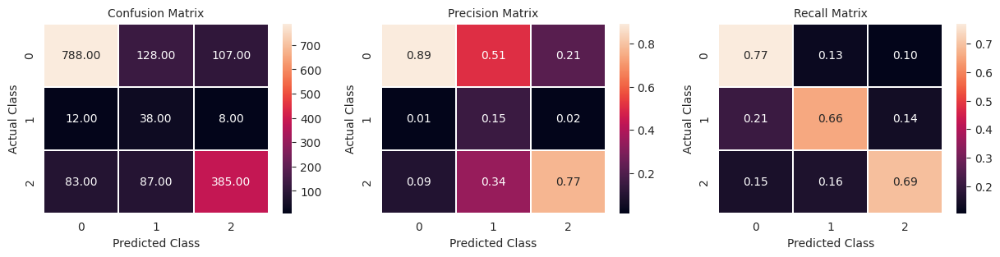


               precision    recall  f1-score   support

           0       0.89      0.77      0.83      1023
           1       0.15      0.66      0.24        58
           2       0.77      0.69      0.73       555

    accuracy                           0.74      1636
   macro avg       0.60      0.71      0.60      1636
weighted avg       0.82      0.74      0.77      1636

y_hat shape:(5271, 3)
Test log_loss: 0.73%

Running CV 23

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 8s 27ms/step - loss: 1.4279 - auc_38: 0.5592 - val_loss: 0.8531 - val_auc_38: 0.7388 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 5s 24ms/step - loss: 1.1794 - auc_38: 0.6084 - val_loss: 0.8159 - val_auc_38: 0.7021 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 5s 24ms/step - loss: 1.0669 - auc_38: 0.6531 - val_loss: 0.8031 - val_auc_38: 0.7816 - lr: 5.0000e-04
Epoch 4/200
205/205 [==========

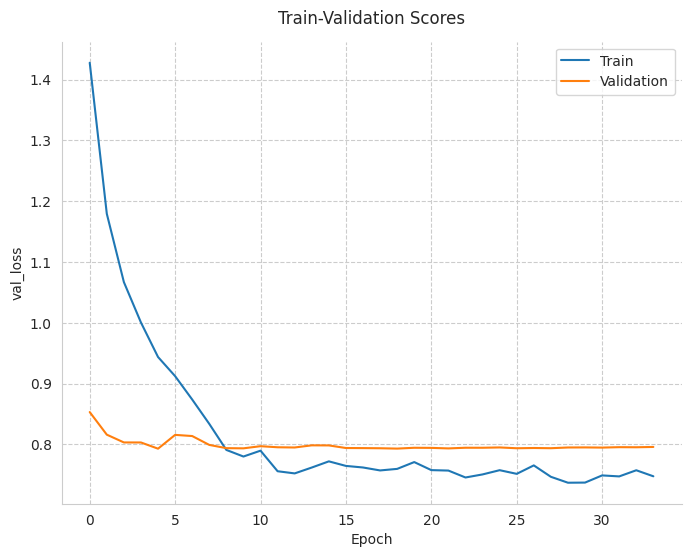

52/52 [==============================] - 1s 7ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


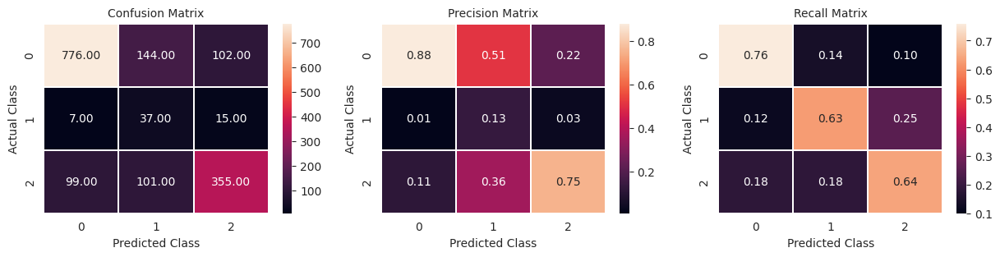


               precision    recall  f1-score   support

           0       0.88      0.76      0.82      1022
           1       0.13      0.63      0.22        59
           2       0.75      0.64      0.69       555

    accuracy                           0.71      1636
   macro avg       0.59      0.68      0.57      1636
weighted avg       0.81      0.71      0.75      1636

y_hat shape:(5271, 3)
Test log_loss: 0.79%

Running CV 24

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 8s 22ms/step - loss: 1.4018 - auc_39: 0.5447 - val_loss: 1.0328 - val_auc_39: 0.6063 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 4s 19ms/step - loss: 1.1861 - auc_39: 0.6053 - val_loss: 0.8362 - val_auc_39: 0.7008 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 5s 25ms/step - loss: 1.0895 - auc_39: 0.6363 - val_loss: 0.7781 - val_auc_39: 0.7644 - lr: 5.0000e-04
Epoch 4/200
205/205 [==========

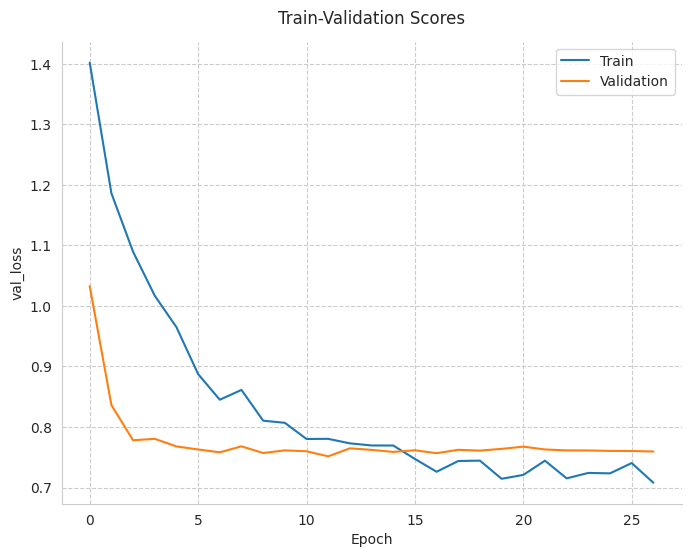

52/52 [==============================] - 1s 5ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


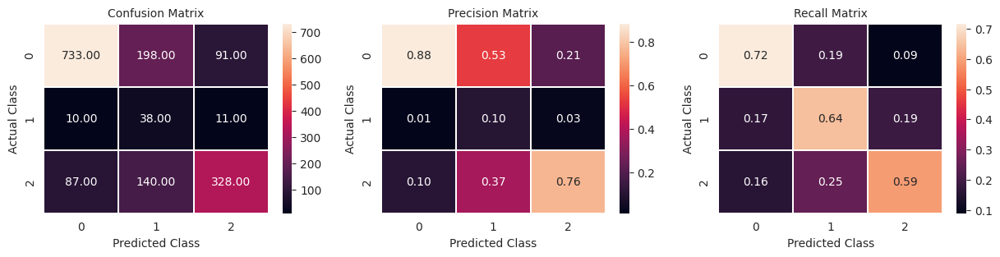


               precision    recall  f1-score   support

           0       0.88      0.72      0.79      1022
           1       0.10      0.64      0.17        59
           2       0.76      0.59      0.67       555

    accuracy                           0.67      1636
   macro avg       0.58      0.65      0.54      1636
weighted avg       0.81      0.67      0.73      1636

y_hat shape:(5271, 3)
Test log_loss: 0.75%

Running CV 25

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 8s 28ms/step - loss: 1.4849 - auc_40: 0.5378 - val_loss: 0.9958 - val_auc_40: 0.5855 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 5s 23ms/step - loss: 1.1702 - auc_40: 0.6153 - val_loss: 0.8371 - val_auc_40: 0.6771 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 5s 26ms/step - loss: 1.0880 - auc_40: 0.6453 - val_loss: 0.8601 - val_auc_40: 0.6128 - lr: 5.0000e-04
Epoch 4/200
205/205 [==========

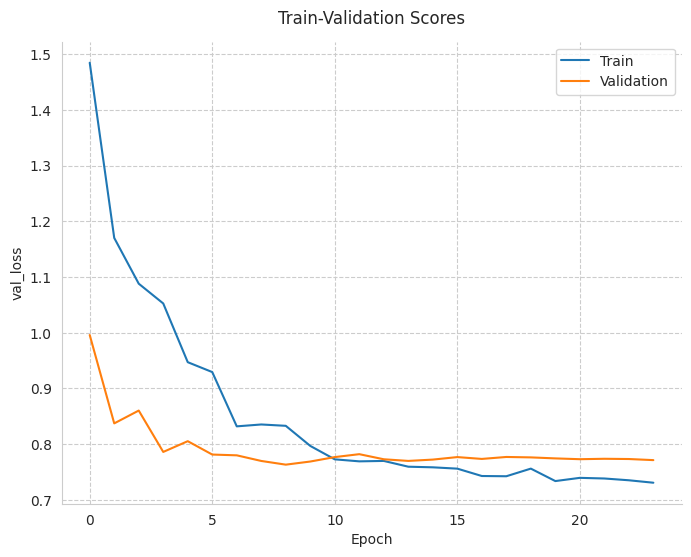

52/52 [==============================] - 1s 6ms/step
(1637,) (1637, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


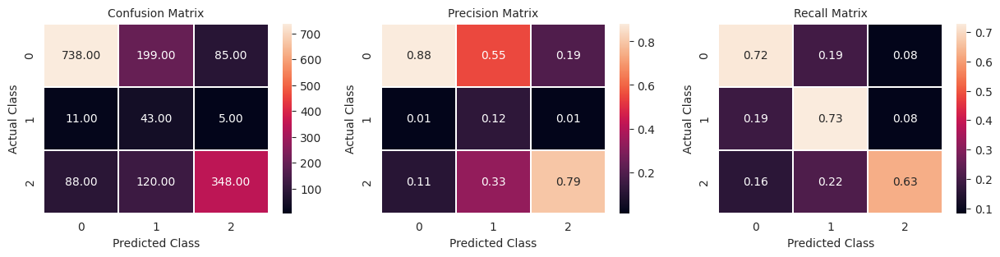


               precision    recall  f1-score   support

           0       0.88      0.72      0.79      1022
           1       0.12      0.73      0.20        59
           2       0.79      0.63      0.70       556

    accuracy                           0.69      1637
   macro avg       0.60      0.69      0.57      1637
weighted avg       0.82      0.69      0.74      1637

y_hat shape:(5271, 3)
Test log_loss: 0.76%

Running CV 26

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 8s 23ms/step - loss: 1.4858 - auc_41: 0.5235 - val_loss: 0.8956 - val_auc_41: 0.7004 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 4s 21ms/step - loss: 1.2093 - auc_41: 0.6157 - val_loss: 0.7979 - val_auc_41: 0.7111 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 6s 27ms/step - loss: 1.1276 - auc_41: 0.6216 - val_loss: 0.8117 - val_auc_41: 0.8021 - lr: 5.0000e-04
Epoch 4/200
205/205 [==========

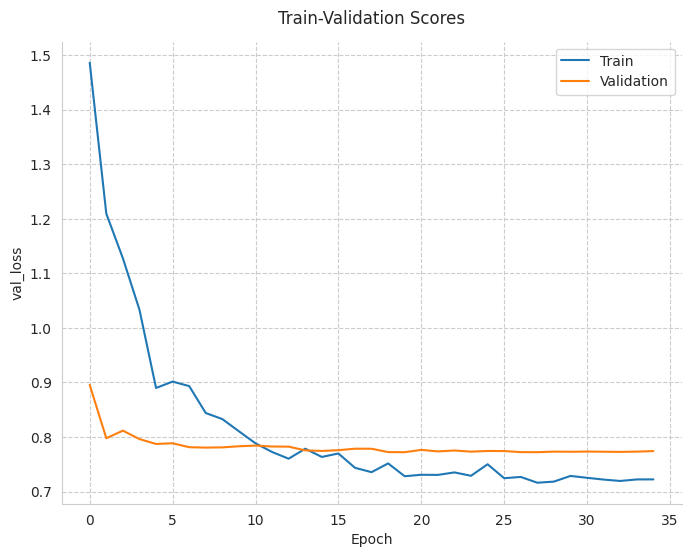

52/52 [==============================] - 1s 6ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


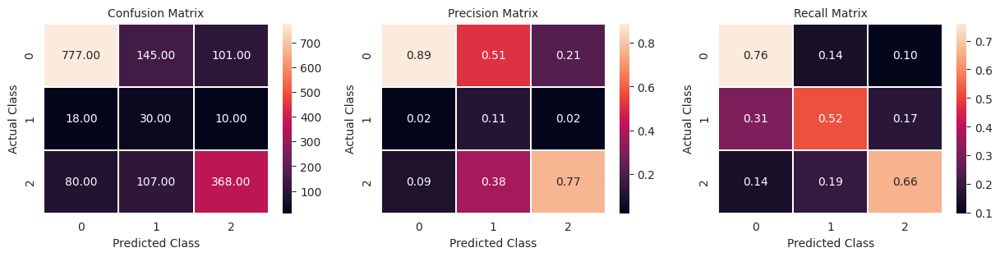


               precision    recall  f1-score   support

           0       0.89      0.76      0.82      1023
           1       0.11      0.52      0.18        58
           2       0.77      0.66      0.71       555

    accuracy                           0.72      1636
   macro avg       0.59      0.65      0.57      1636
weighted avg       0.82      0.72      0.76      1636

y_hat shape:(5271, 3)
Test log_loss: 0.77%

Running CV 27

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 7s 22ms/step - loss: 1.4797 - auc_42: 0.5260 - val_loss: 0.8704 - val_auc_42: 0.6890 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 5s 23ms/step - loss: 1.2405 - auc_42: 0.6083 - val_loss: 0.7372 - val_auc_42: 0.7664 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 4s 20ms/step - loss: 1.1206 - auc_42: 0.6333 - val_loss: 0.7385 - val_auc_42: 0.7487 - lr: 5.0000e-04
Epoch 4/200
205/205 [==========

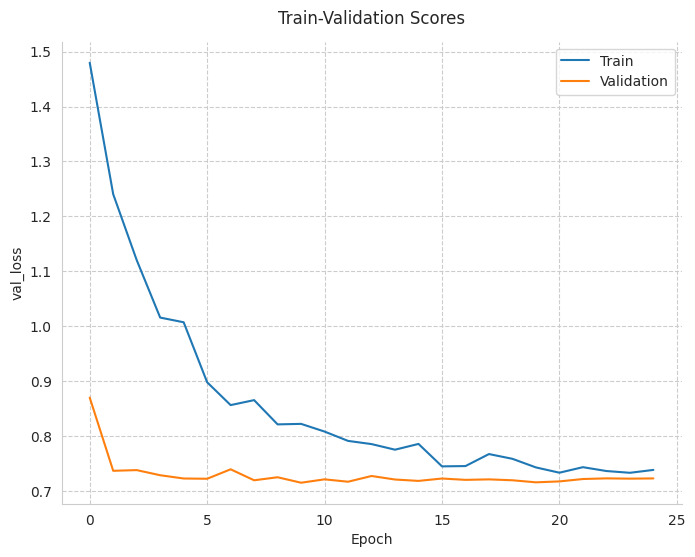

52/52 [==============================] - 1s 7ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


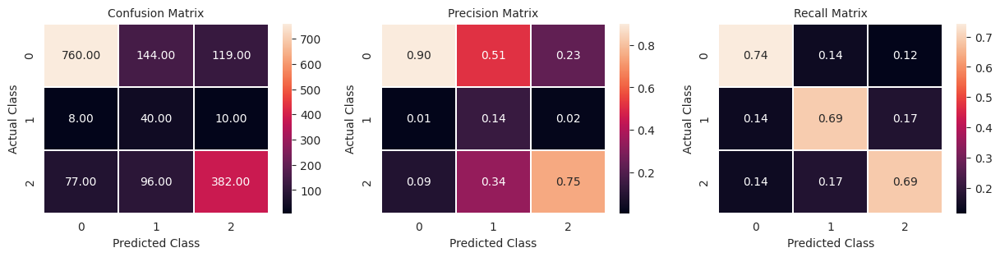


               precision    recall  f1-score   support

           0       0.90      0.74      0.81      1023
           1       0.14      0.69      0.24        58
           2       0.75      0.69      0.72       555

    accuracy                           0.72      1636
   macro avg       0.60      0.71      0.59      1636
weighted avg       0.82      0.72      0.76      1636

y_hat shape:(5271, 3)
Test log_loss: 0.72%

Running CV 28

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 8s 25ms/step - loss: 1.4445 - auc_43: 0.5397 - val_loss: 0.8776 - val_auc_43: 0.7543 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 5s 26ms/step - loss: 1.1987 - auc_43: 0.6148 - val_loss: 0.8266 - val_auc_43: 0.7718 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 5s 22ms/step - loss: 1.1211 - auc_43: 0.6383 - val_loss: 0.8051 - val_auc_43: 0.7489 - lr: 5.0000e-04
Epoch 4/200
205/205 [==========

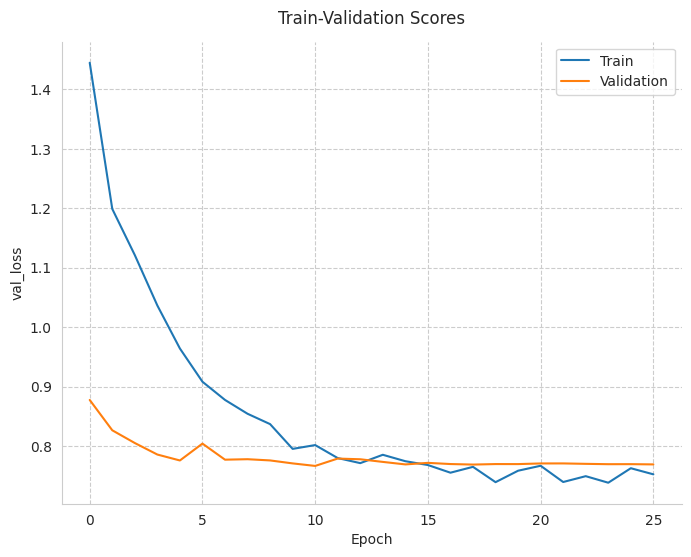

52/52 [==============================] - 1s 7ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


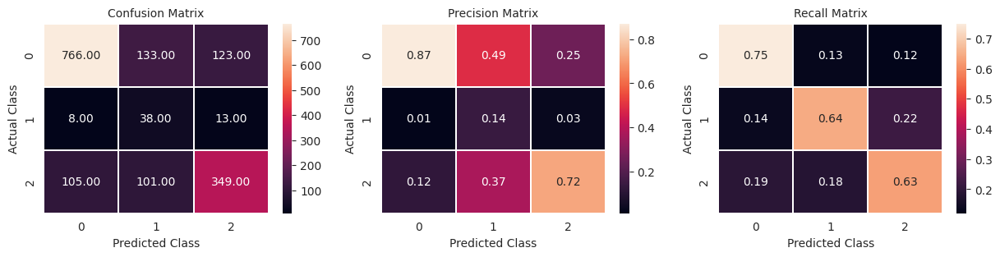


               precision    recall  f1-score   support

           0       0.87      0.75      0.81      1022
           1       0.14      0.64      0.23        59
           2       0.72      0.63      0.67       555

    accuracy                           0.70      1636
   macro avg       0.58      0.67      0.57      1636
weighted avg       0.79      0.70      0.74      1636

y_hat shape:(5271, 3)
Test log_loss: 0.77%

Running CV 29

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 8s 23ms/step - loss: 1.4951 - auc_44: 0.5443 - val_loss: 0.8988 - val_auc_44: 0.6743 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 5s 22ms/step - loss: 1.2479 - auc_44: 0.6036 - val_loss: 0.7974 - val_auc_44: 0.7819 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 5s 22ms/step - loss: 1.1175 - auc_44: 0.6236 - val_loss: 0.8056 - val_auc_44: 0.8332 - lr: 5.0000e-04
Epoch 4/200
205/205 [==========

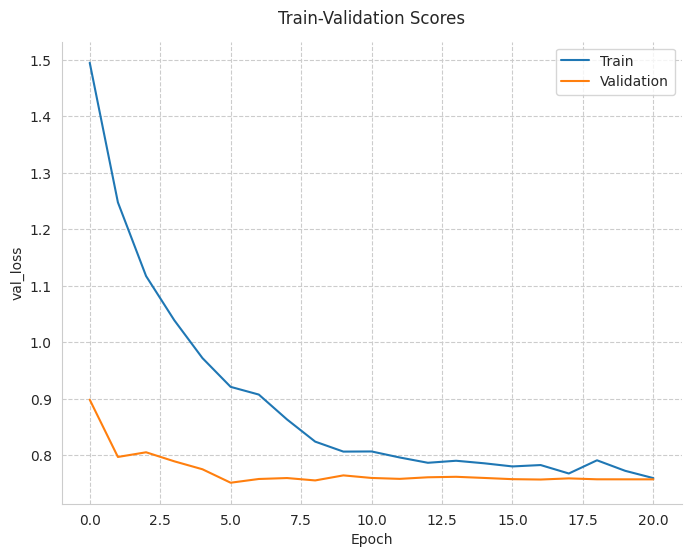

52/52 [==============================] - 1s 7ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


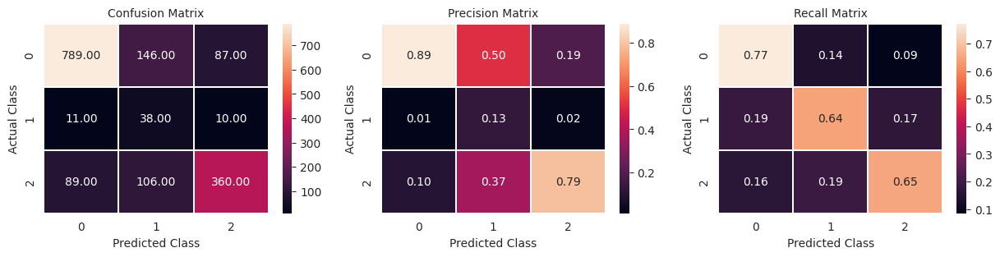


               precision    recall  f1-score   support

           0       0.89      0.77      0.83      1022
           1       0.13      0.64      0.22        59
           2       0.79      0.65      0.71       555

    accuracy                           0.73      1636
   macro avg       0.60      0.69      0.58      1636
weighted avg       0.83      0.73      0.77      1636

y_hat shape:(5271, 3)
Test log_loss: 0.75%

Running CV 30

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 7s 23ms/step - loss: 1.4756 - auc_45: 0.5382 - val_loss: 0.8739 - val_auc_45: 0.6838 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 4s 20ms/step - loss: 1.2822 - auc_45: 0.5916 - val_loss: 0.7475 - val_auc_45: 0.8155 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 5s 25ms/step - loss: 1.1588 - auc_45: 0.6195 - val_loss: 0.6730 - val_auc_45: 0.8105 - lr: 5.0000e-04
Epoch 4/200
205/205 [==========

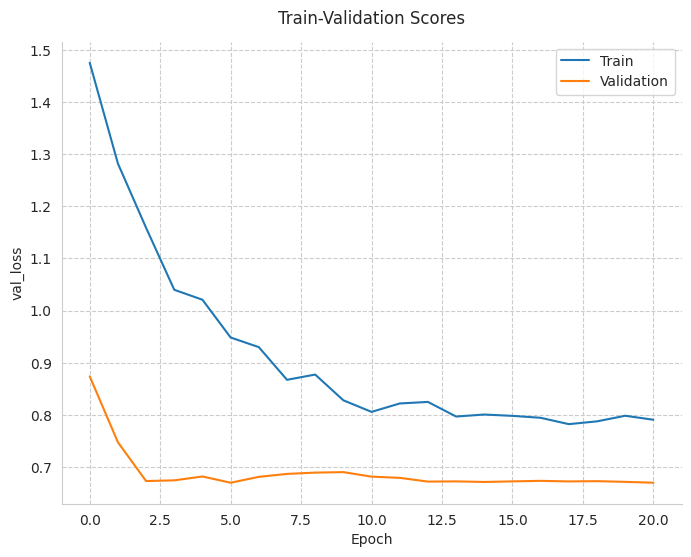

52/52 [==============================] - 1s 7ms/step
(1637,) (1637, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


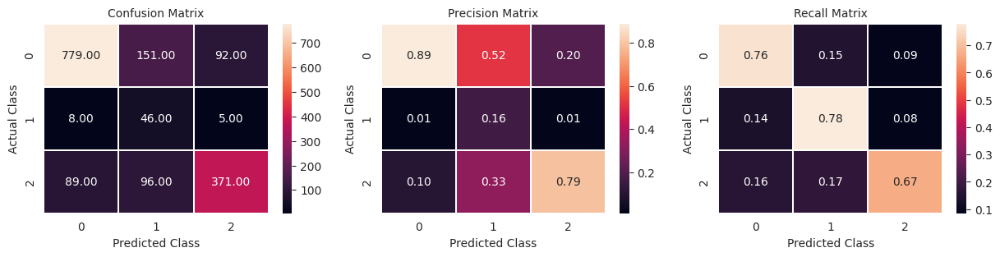


               precision    recall  f1-score   support

           0       0.89      0.76      0.82      1022
           1       0.16      0.78      0.26        59
           2       0.79      0.67      0.72       556

    accuracy                           0.73      1637
   macro avg       0.61      0.74      0.60      1637
weighted avg       0.83      0.73      0.77      1637

y_hat shape:(5271, 3)
Test log_loss: 0.67%

Running CV 31

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 9s 26ms/step - loss: 1.4043 - auc_46: 0.5475 - val_loss: 1.1138 - val_auc_46: 0.4413 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 5s 24ms/step - loss: 1.2186 - auc_46: 0.6039 - val_loss: 0.8965 - val_auc_46: 0.6649 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 4s 21ms/step - loss: 1.1221 - auc_46: 0.6379 - val_loss: 0.8407 - val_auc_46: 0.7412 - lr: 5.0000e-04
Epoch 4/200
205/205 [==========

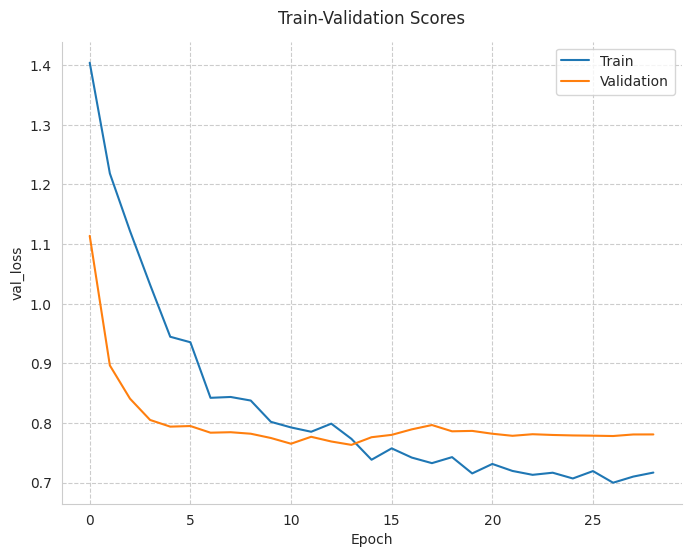

52/52 [==============================] - 1s 7ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


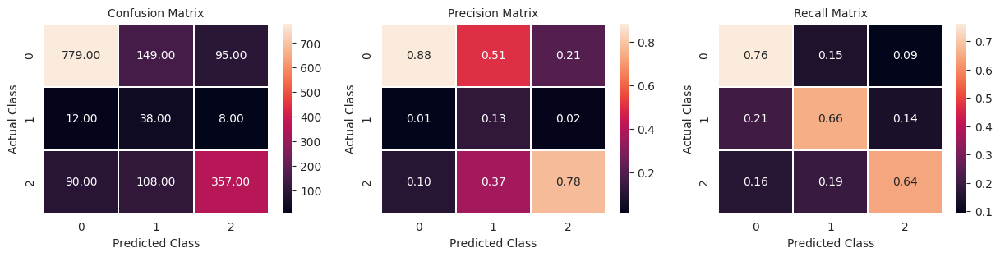


               precision    recall  f1-score   support

           0       0.88      0.76      0.82      1023
           1       0.13      0.66      0.22        58
           2       0.78      0.64      0.70       555

    accuracy                           0.72      1636
   macro avg       0.60      0.69      0.58      1636
weighted avg       0.82      0.72      0.76      1636

y_hat shape:(5271, 3)
Test log_loss: 0.76%

Running CV 32

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 8s 29ms/step - loss: 1.4670 - auc_47: 0.5249 - val_loss: 0.8251 - val_auc_47: 0.7755 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 6s 27ms/step - loss: 1.2248 - auc_47: 0.6121 - val_loss: 0.7494 - val_auc_47: 0.7635 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 5s 23ms/step - loss: 1.0971 - auc_47: 0.6207 - val_loss: 0.7701 - val_auc_47: 0.7527 - lr: 5.0000e-04
Epoch 4/200
205/205 [==========

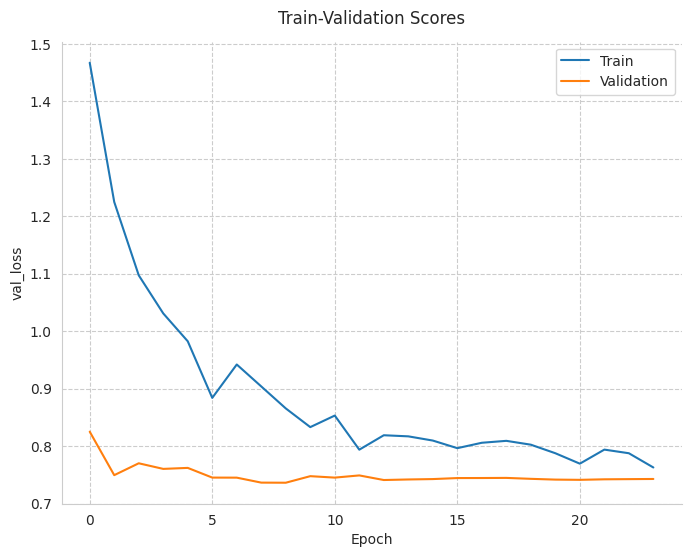

52/52 [==============================] - 1s 6ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


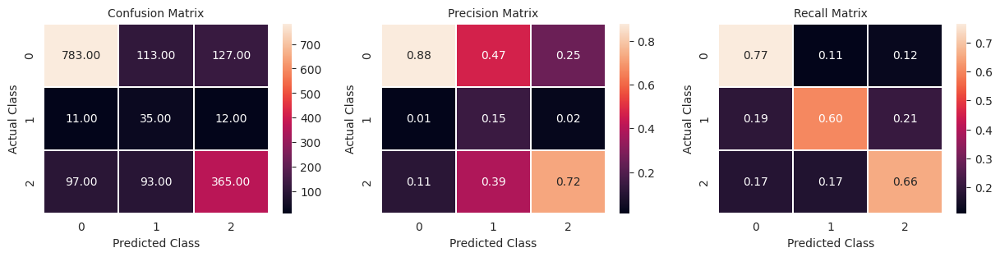


               precision    recall  f1-score   support

           0       0.88      0.77      0.82      1023
           1       0.15      0.60      0.23        58
           2       0.72      0.66      0.69       555

    accuracy                           0.72      1636
   macro avg       0.58      0.68      0.58      1636
weighted avg       0.80      0.72      0.75      1636

y_hat shape:(5271, 3)
Test log_loss: 0.74%

Running CV 33

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 8s 24ms/step - loss: 1.4174 - auc_48: 0.5530 - val_loss: 0.9338 - val_auc_48: 0.4829 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 5s 22ms/step - loss: 1.2100 - auc_48: 0.6172 - val_loss: 0.8491 - val_auc_48: 0.6897 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 6s 27ms/step - loss: 1.0589 - auc_48: 0.6543 - val_loss: 0.8425 - val_auc_48: 0.7028 - lr: 5.0000e-04
Epoch 4/200
205/205 [==========

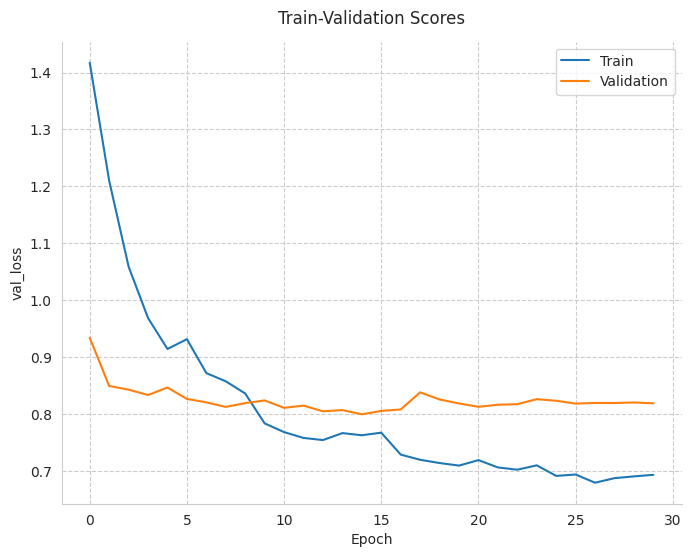

52/52 [==============================] - 1s 7ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


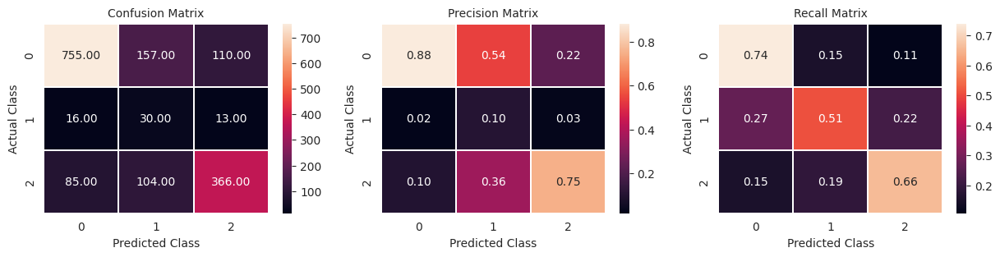


               precision    recall  f1-score   support

           0       0.88      0.74      0.80      1022
           1       0.10      0.51      0.17        59
           2       0.75      0.66      0.70       555

    accuracy                           0.70      1636
   macro avg       0.58      0.64      0.56      1636
weighted avg       0.81      0.70      0.75      1636

y_hat shape:(5271, 3)
Test log_loss: 0.8%

Running CV 34

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 7s 22ms/step - loss: 1.5148 - auc_49: 0.5307 - val_loss: 0.9035 - val_auc_49: 0.6605 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 5s 23ms/step - loss: 1.2689 - auc_49: 0.6096 - val_loss: 0.8293 - val_auc_49: 0.6984 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 5s 24ms/step - loss: 1.1182 - auc_49: 0.6276 - val_loss: 0.8309 - val_auc_49: 0.7576 - lr: 5.0000e-04
Epoch 4/200
205/205 [===========

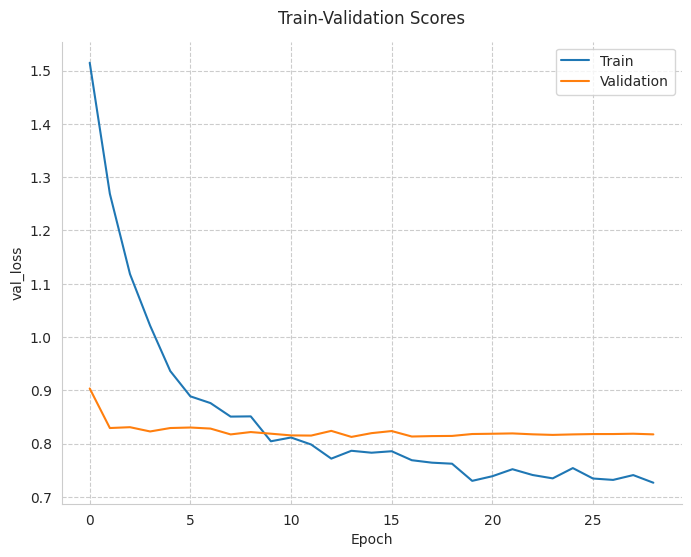

52/52 [==============================] - 1s 6ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


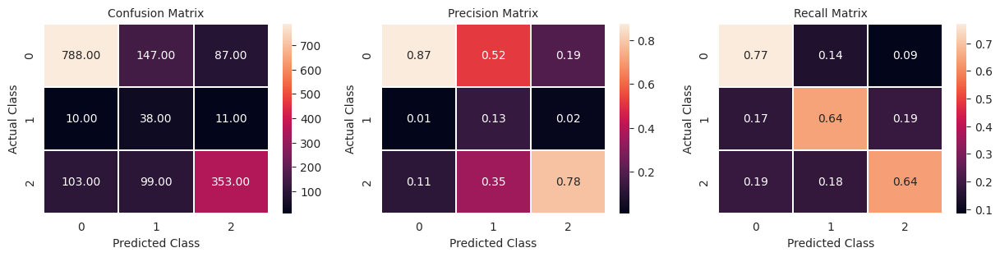


               precision    recall  f1-score   support

           0       0.87      0.77      0.82      1022
           1       0.13      0.64      0.22        59
           2       0.78      0.64      0.70       555

    accuracy                           0.72      1636
   macro avg       0.60      0.68      0.58      1636
weighted avg       0.82      0.72      0.76      1636

y_hat shape:(5271, 3)
Test log_loss: 0.81%

Running CV 35

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 9s 29ms/step - loss: 1.4748 - auc_50: 0.5158 - val_loss: 1.0238 - val_auc_50: 0.4027 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 5s 22ms/step - loss: 1.2222 - auc_50: 0.5892 - val_loss: 0.9181 - val_auc_50: 0.6683 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 5s 26ms/step - loss: 1.0782 - auc_50: 0.6402 - val_loss: 0.8523 - val_auc_50: 0.7617 - lr: 5.0000e-04
Epoch 4/200
205/205 [==========

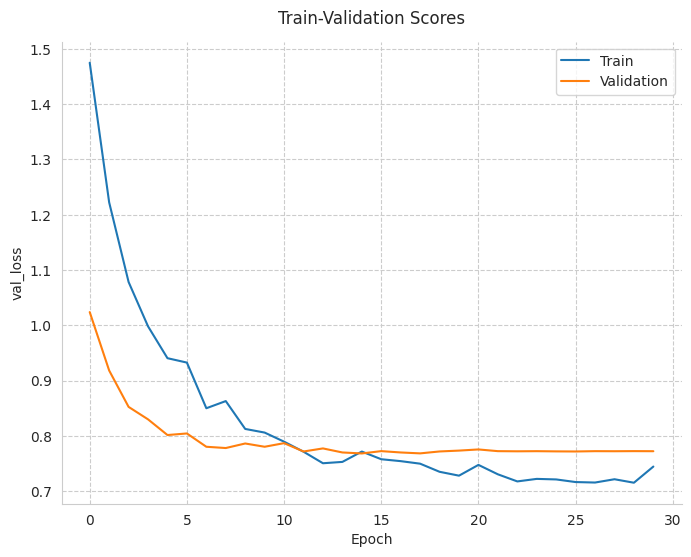

52/52 [==============================] - 1s 6ms/step
(1637,) (1637, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


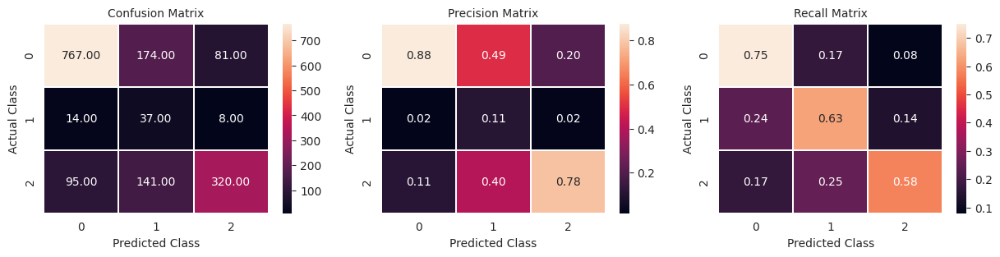


               precision    recall  f1-score   support

           0       0.88      0.75      0.81      1022
           1       0.11      0.63      0.18        59
           2       0.78      0.58      0.66       556

    accuracy                           0.69      1637
   macro avg       0.59      0.65      0.55      1637
weighted avg       0.82      0.69      0.74      1637

y_hat shape:(5271, 3)
Test log_loss: 0.77%

Running CV 36

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 8s 26ms/step - loss: 1.4514 - auc_51: 0.5423 - val_loss: 0.8913 - val_auc_51: 0.5448 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 5s 26ms/step - loss: 1.2340 - auc_51: 0.6010 - val_loss: 0.7327 - val_auc_51: 0.7444 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 5s 26ms/step - loss: 1.0851 - auc_51: 0.6285 - val_loss: 0.7128 - val_auc_51: 0.7561 - lr: 5.0000e-04
Epoch 4/200
205/205 [==========

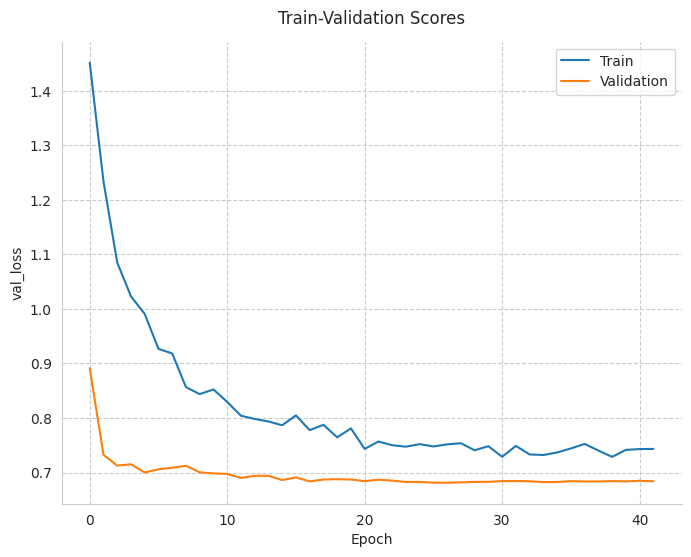

52/52 [==============================] - 1s 6ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


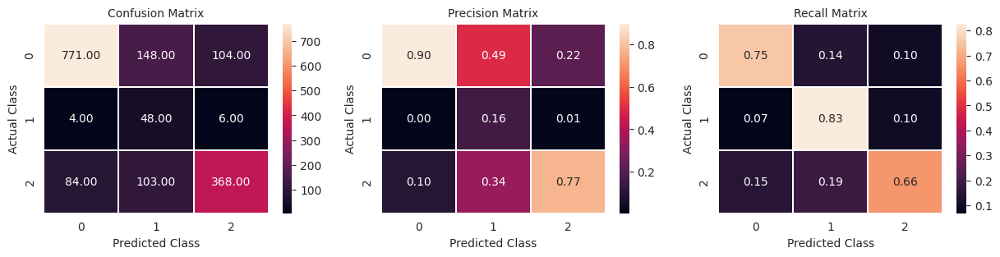


               precision    recall  f1-score   support

           0       0.90      0.75      0.82      1023
           1       0.16      0.83      0.27        58
           2       0.77      0.66      0.71       555

    accuracy                           0.73      1636
   macro avg       0.61      0.75      0.60      1636
weighted avg       0.83      0.73      0.76      1636

y_hat shape:(5271, 3)
Test log_loss: 0.68%

Running CV 37

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 9s 27ms/step - loss: 1.4842 - auc_52: 0.5176 - val_loss: 0.8527 - val_auc_52: 0.8002 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 5s 23ms/step - loss: 1.2294 - auc_52: 0.5989 - val_loss: 0.7852 - val_auc_52: 0.7945 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 5s 23ms/step - loss: 1.0821 - auc_52: 0.6496 - val_loss: 0.8009 - val_auc_52: 0.7975 - lr: 5.0000e-04
Epoch 4/200
205/205 [==========

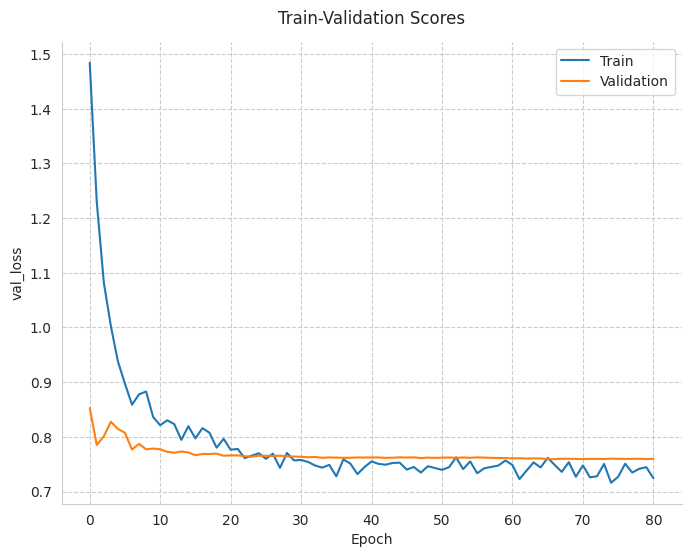

52/52 [==============================] - 1s 7ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


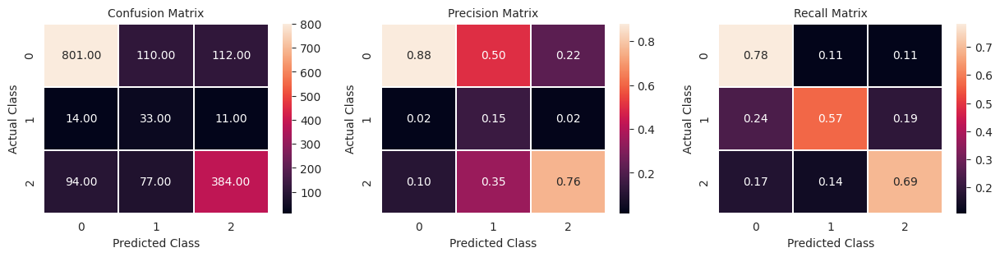


               precision    recall  f1-score   support

           0       0.88      0.78      0.83      1023
           1       0.15      0.57      0.24        58
           2       0.76      0.69      0.72       555

    accuracy                           0.74      1636
   macro avg       0.60      0.68      0.60      1636
weighted avg       0.81      0.74      0.77      1636

y_hat shape:(5271, 3)
Test log_loss: 0.76%

Running CV 38

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 12s 26ms/step - loss: 1.4665 - auc_53: 0.5340 - val_loss: 0.9351 - val_auc_53: 0.6154 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 6s 26ms/step - loss: 1.1897 - auc_53: 0.6254 - val_loss: 0.8094 - val_auc_53: 0.7679 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 5s 23ms/step - loss: 1.0745 - auc_53: 0.6415 - val_loss: 0.8008 - val_auc_53: 0.7592 - lr: 5.0000e-04
Epoch 4/200
205/205 [=========

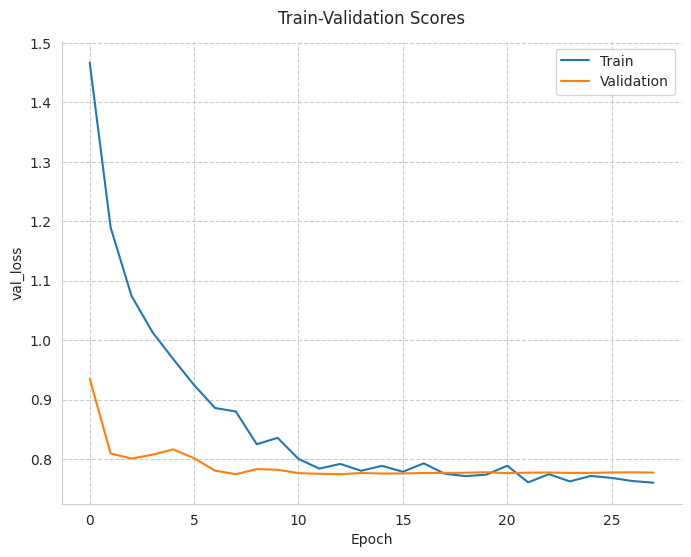

52/52 [==============================] - 1s 6ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


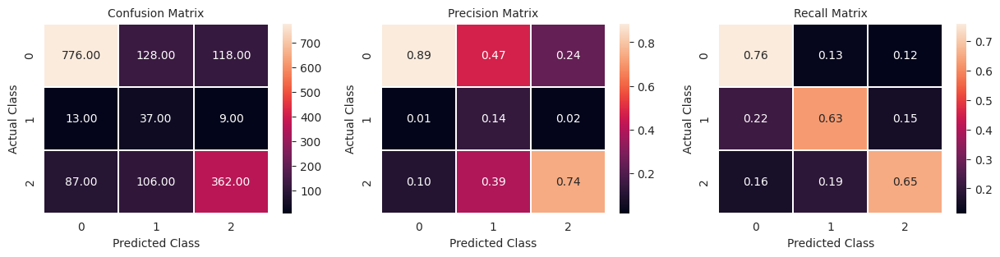


               precision    recall  f1-score   support

           0       0.89      0.76      0.82      1022
           1       0.14      0.63      0.22        59
           2       0.74      0.65      0.69       555

    accuracy                           0.72      1636
   macro avg       0.59      0.68      0.58      1636
weighted avg       0.81      0.72      0.75      1636

y_hat shape:(5271, 3)
Test log_loss: 0.77%

Running CV 39

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 9s 28ms/step - loss: 1.4485 - auc_54: 0.5226 - val_loss: 0.8673 - val_auc_54: 0.6015 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 5s 23ms/step - loss: 1.2259 - auc_54: 0.6051 - val_loss: 0.7740 - val_auc_54: 0.7353 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 5s 26ms/step - loss: 1.1051 - auc_54: 0.6412 - val_loss: 0.7667 - val_auc_54: 0.7424 - lr: 5.0000e-04
Epoch 4/200
205/205 [==========

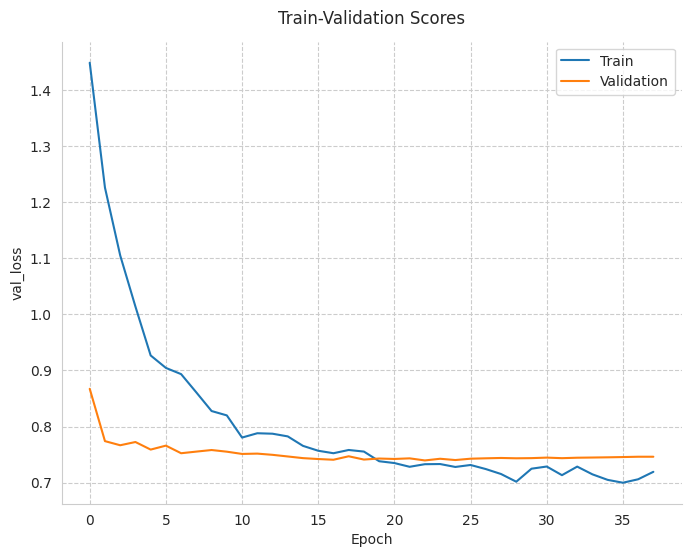

52/52 [==============================] - 1s 6ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


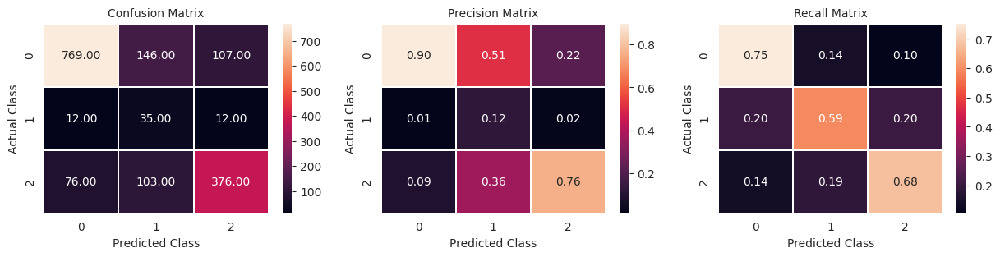


               precision    recall  f1-score   support

           0       0.90      0.75      0.82      1022
           1       0.12      0.59      0.20        59
           2       0.76      0.68      0.72       555

    accuracy                           0.72      1636
   macro avg       0.59      0.67      0.58      1636
weighted avg       0.82      0.72      0.76      1636

y_hat shape:(5271, 3)
Test log_loss: 0.74%
All Valuation AUC_pr: 0.7864471673965454


In [ ]:
test_results_df_C,test_results_df_CL,test_results_df_D, test_results_df = run_experiment(X_train,
                                                                                         X_test,
                                                                                         input_format="concat",
                                                                                         experiment_name="model_baseline_ext_v0",
                                                                                         splits=5, num_epochs=200,
                                                                                         batch_size=32)

In [ ]:
test_results_df

,C,CL,D
0,0.462283,0.189069,0.348649
1,0.559173,0.326514,0.114313
2,0.079560,0.288858,0.631583
3,0.770235,0.163474,0.066291
4,0.399796,0.310902,0.289302
...,...,...,...
5266,0.418146,0.414421,0.167434
5267,0.739137,0.164190,0.096673
5268,0.663485,0.101174,0.235341
5269,0.673930,0.301251,0.024819


In [ ]:
test_results_df.to_csv("Baseline_v0.csv")

### 6.2 Deep&Wide with OverSampling

**Oversample the minority class**

A related approach would be to resample the dataset by oversampling the minority class.

In [27]:
X_train = pd.read_csv("new_train.csv", index_col=0)
X_test = pd.read_csv("new_test.csv", index_col=0)

#X_train["weights"] = X_train["Status"]
#X_test["weights"] = 1.0

strat_feature = X_train["Status"]

X_train.drop(columns=["id","Status","min_class_feat_RF"],inplace=True)
X_test.drop(columns=["id","Status","min_class_feat_RF"],inplace=True)

num_var = X_train.select_dtypes("float").columns
cat_var = X_train.select_dtypes("int").columns

X_train[num_var]=X_train[num_var].astype("float32")
X_train[cat_var]=X_train[cat_var].astype("int32")

X_test[num_var]=X_test[num_var].astype("float32")
X_test[cat_var]=X_test[cat_var].astype("int32")

X_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8181 entries, 0 to 311
Data columns (total 39 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Drug                            8181 non-null   int32  
 1   Sex                             8181 non-null   int32  
 2   Ascites                         8181 non-null   int32  
 3   Hepatomegaly                    8181 non-null   int32  
 4   Spiders                         8181 non-null   int32  
 5   Edema                           8181 non-null   int32  
 6   Bilirubin                       8181 non-null   float32
 7   Cholesterol                     8181 non-null   float32
 8   Albumin                         8181 non-null   float32
 9   Copper                          8181 non-null   float32
 10  Alk_Phos                        8181 non-null   float32
 11  SGOT                            8181 non-null   float32
 12  Tryglicerides                   818

In [28]:
num_var = list(num_var)
cat_var = list(cat_var)
cat_var.remove('Status_C')
cat_var.remove('Status_CL')
cat_var.remove('Status_D')

In [29]:
C_instances = X_train[X_train.Status_C==1]
CL_instances = X_train[X_train.Status_CL==1]
D_instances = X_train[X_train.Status_D==1]

In [30]:
C_instances.shape, CL_instances.shape, D_instances.shape

((5112, 39), (293, 39), (2776, 39))

#### 6.2.0 Functions and Dataset Preparation

**TEST NEW DATASET MANAGER**

In [31]:
def dataframe_to_dataset_class(dataframe, shuffle=False, batch_size=32,buffer_size=6_000):
    dataframe = dataframe.copy()
    labels = dataframe[["Status_C","Status_CL","Status_D"]]
    dataframe = dataframe.drop(columns=["Status_C","Status_CL","Status_D"])
    #weights = dataframe.pop("weights")
    ds = tf.data.Dataset.from_tensor_slices((dict(dataframe), labels))
    if shuffle:
      ds = ds.shuffle(buffer_size=buffer_size).repeat()
    ds = ds.batch(batch_size)
    ds = ds.prefetch(batch_size)
    return ds

def dataframe_to_dataset(dataframe, shuffle=False, batch_size=32):
    dataframe = dataframe.copy()
    labels = dataframe[["Status_C","Status_CL","Status_D"]]
    dataframe = dataframe.drop(columns=["Status_C","Status_CL","Status_D"])
    #weights = dataframe.pop("weights")
    ds = tf.data.Dataset.from_tensor_slices((dict(dataframe), labels))
    if shuffle:
      ds = ds.shuffle(buffer_size=len(dataframe))
    ds = ds.batch(batch_size)
    ds = ds.prefetch(batch_size)
    return ds

In [32]:
train_dataset = dataframe_to_dataset(X_train, batch_size=32, shuffle=True)
test_dataset = dataframe_to_dataset(X_test, batch_size=32, shuffle=False)

C_instances = X_train[X_train.Status_C==1]
CL_instances = X_train[X_train.Status_CL==1]
D_instances = X_train[X_train.Status_D==1]

C_dataset = dataframe_to_dataset_class(C_instances,batch_size=1, shuffle=True)
CL_dataset = dataframe_to_dataset_class(CL_instances,batch_size=1, shuffle=True)
D_dataset = dataframe_to_dataset_class(D_instances,batch_size=1, shuffle=True)


feature_space = FeatureSpace(
                            features={**{a:FeatureSpace.integer_categorical(num_oov_indices=1, output_mode="int") for a in cat_var},**{a:FeatureSpace.float_normalized() for a in num_var}},
                            # Specify feature cross with a custom crossing dim.
                            crosses=[FeatureSpace.cross(feature_names=("count_disease","bill_proh_binned"), crossing_dim=10, output_mode="int"),
                                     FeatureSpace.cross(feature_names=("Drug","Bilirubin_binned"), crossing_dim=5, output_mode="int")],
                            output_mode="dict"
                            )

train_ds_with_no_labels = train_dataset.map(lambda x, *_: x)
print("Adapting Features Space....")
feature_space.adapt(train_ds_with_no_labels)

preprocessed_train_ds = train_dataset.map(lambda x, y: (feature_space(x), y), num_parallel_calls=tf.data.AUTOTUNE).prefetch(tf.data.AUTOTUNE)
#preprocessed_valid_ds = valid_dataset.map(lambda x, y: (feature_space(x), y), num_parallel_calls=tf.data.AUTOTUNE).prefetch(tf.data.AUTOTUNE)
preprocessed_test_ds = test_dataset.map(lambda x, y: (feature_space(x), y), num_parallel_calls=tf.data.AUTOTUNE).prefetch(tf.data.AUTOTUNE)

preprocessed_train_C = C_dataset.map(lambda x, y: (feature_space(x), tf.squeeze(y)), num_parallel_calls=tf.data.AUTOTUNE).prefetch(tf.data.AUTOTUNE)
preprocessed_train_CL = CL_dataset.map(lambda x, y: (feature_space(x), tf.squeeze(y)), num_parallel_calls=tf.data.AUTOTUNE).prefetch(tf.data.AUTOTUNE)
preprocessed_train_D = D_dataset.map(lambda x, y: (feature_space(x), tf.squeeze(y)), num_parallel_calls=tf.data.AUTOTUNE).prefetch(tf.data.AUTOTUNE)

resampled_ds = tf.data.Dataset.sample_from_datasets([preprocessed_train_C, preprocessed_train_CL, preprocessed_train_D], weights=[0.334, 0.333, 0.333])
resampled_ds = resampled_ds.batch(batch_size=32).prefetch(tf.data.AUTOTUNE)

print(".... and Done! And it worked ")

Adapting Features Space....
.... and Done! And it worked 


In [33]:
for features, label in resampled_ds.take(1):
  print(label.numpy().mean(axis=0))
  print(label.numpy().shape)
#  print(features.numpy().shape)

[0.375   0.21875 0.40625]
(32, 3)


In [34]:
for features, label in preprocessed_train_ds.take(1):
  print(label.numpy().mean(axis=0))
  print(label.numpy().shape)
#  print(features.numpy().shape)

[0.625 0.    0.375]
(32, 3)


In [35]:
fs_trial = feature_space.get_encoded_features()
list_categorical_nn=[]
inputs = list(fs_trial.keys())

for key, item in fs_trial.items():
  if item.dtype=="int64":
    list_categorical_nn.append(key)

#print(list_categorical_nn)

Cat_Feat_Entries=dict()
embedding_dims=dict()

for f in list_categorical_nn[:-2]:
  Cat_Feat_Entries[f]=list(range(len(X_train[f].unique())+1))
  embedding_dims[f]=max(int(np.ceil(len(X_train[f].unique())/2)),2)

Cat_Feat_Entries['Drug_X_Bilirubin_binned'] = list(range(6))
Cat_Feat_Entries['count_disease_X_bill_proh_binned'] = list(range(11))

embedding_dims['Drug_X_Bilirubin_binned'] = 3
embedding_dims['count_disease_X_bill_proh_binned'] = 6

In [36]:
def encode_inputs_v0(inputs, edense=4, num_dense_exp=True, list_categorical_nn=list_categorical_nn, Cat_Feat_Entries=Cat_Feat_Entries, embedding_dims_det=None, name="enc"):
    encoded_categorical_feature_list = []
    numerical_feature_list = []

    for feature_name in inputs:
        if feature_name in list_categorical_nn:

          vocabulary = Cat_Feat_Entries[feature_name]

          if embedding_dims_det is not None:
            ed = embedding_dims_det[feature_name]
          else:
            ed = edense

          embedding = layers.Embedding(input_dim=len(vocabulary), output_dim=ed)
          # Convert the index values to embedding representations.
          encoded_categorical_feature = embedding(inputs[feature_name])
          encoded_categorical_feature = tf.keras.layers.Dense(edense, name=f"cat_dense_{feature_name}_{name}")(encoded_categorical_feature)
          encoded_categorical_feature = keras.layers.Reshape((edense,), name=f"cat_reshape_{feature_name}_{name}")(encoded_categorical_feature)
          encoded_categorical_feature_list.append(encoded_categorical_feature)

        else:
          # Use the numerical features as-is.
          numerical_feature = inputs[feature_name] #tf.expand_dims(inputs[feature_name], -1)

          if num_dense_exp:
            numerical_feature = tf.keras.layers.Dense(edense, name=f"num_dense_{feature_name}_{name}")(numerical_feature)

          numerical_feature_list.append(numerical_feature)

    return encoded_categorical_feature_list, numerical_feature_list

In [37]:
def create_DW_model(fs, name="deepwide_model",learning_rate = 0.001,
                    activation="relu",gn_noise=0.01,dropout=0.5,hidden_layers=3,
                    units_0=256,units_1=256, edense_wide=4, edense_deep=6, kr=0, attention=True):

  encoded_features = fs.get_encoded_features()
  # Wide Leg
  cat,num = encode_inputs_v0(encoded_features, edense=edense_wide, embedding_dims_det=embedding_dims, name="enc_wide")
  wide_cat = tf.keras.layers.concatenate(cat, name="wide_cat_concat")
  wide_num = tf.keras.layers.concatenate(num, name="wide_num_concat")
  wide = tf.keras.layers.concatenate([wide_cat,wide_num], name="wide_concat")
  wide = layers.BatchNormalization(name="wide_norm")(wide)
  # Deep Leg
  cat_deep,num_deep = encode_inputs_v0(encoded_features, edense=edense_deep, embedding_dims_det=embedding_dims, name="enc_deep")
  deep_cat = tf.keras.layers.concatenate(cat_deep, name="deep_cat_concat")
  deep_num = tf.keras.layers.concatenate(num_deep, name="deep_num_concat")
  deep = tf.keras.layers.concatenate([deep_cat,deep_num], name="deep_concat")

  deep = tf.keras.layers.GaussianNoise(stddev=gn_noise, name="gsn")(deep)

  for layer_ in range(hidden_layers):

      deep = dense_residual_block(units_0, dropout_rate=dropout, activation=activation, kr=kr, attention=attention, name=f"drb_{layer_}")(deep)

  deep = dense_residual_block(units_1, dropout_rate=dropout, activation=activation, kr=kr, attention=attention, name=f"drb_final")(deep)

  x = tf.keras.layers.concatenate([deep,wide], name = "final_concat")

  output = tf.keras.layers.Dense(3, activation="softmax", name="output_layer")(x)


  model = keras.Model(inputs=encoded_features, outputs=output)

  model.compile(
          optimizer=keras.optimizers.Adam(learning_rate=learning_rate),
          loss=tf.keras.losses.CategoricalCrossentropy(name="cat_ce"),
          metrics=[keras.metrics.AUC(curve="PR", name="auc_pr")]
          )

  return model

In [38]:
model = create_DW_model(feature_space, name="deepwide_model",learning_rate = 0.001,
                        activation="relu",gn_noise=0.01,dropout=0.5,hidden_layers=3,
                        units_0=512,units_1=256, edense_wide=6, edense_deep=8, kr=0, attention=True)
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 1)]                  0         []                            
                                                                                                  
 input_3 (InputLayer)        [(None, 1)]                  0         []                            
                                                                                                  
 input_5 (InputLayer)        [(None, 1)]                  0         []                            
                                                                                                  
 input_6 (InputLayer)        [(None, 1)]                  0         []                            
                                                                                              

In [39]:
keras.utils.plot_model(model, show_shapes=True,rankdir="LR", expand_nested=True)

#### 6.2.1 KerasTuner

In [41]:
X_trn, X_val = train_test_split(X_train, random_state=1978, test_size=0.3, stratify=strat_feature)

train_dataset = dataframe_to_dataset(X_trn, batch_size=32, shuffle=True)
valid_dataset = dataframe_to_dataset(X_val, batch_size=32, shuffle=False)
test_dataset = dataframe_to_dataset(X_test, batch_size=32, shuffle=False)

C_instances = X_trn[X_trn.Status_C==1]
CL_instances = X_trn[X_trn.Status_CL==1]
D_instances = X_trn[X_trn.Status_D==1]

C_dataset = dataframe_to_dataset_class(C_instances,batch_size=1, shuffle=True)
CL_dataset = dataframe_to_dataset_class(CL_instances,batch_size=1, shuffle=True)
D_dataset = dataframe_to_dataset_class(D_instances,batch_size=1, shuffle=True)

feature_space = FeatureSpace(
                            features={**{a:FeatureSpace.integer_categorical(num_oov_indices=1, output_mode="int") for a in cat_var},**{a:FeatureSpace.float_normalized() for a in num_var}},
                            # Specify feature cross with a custom crossing dim.
                            crosses=[FeatureSpace.cross(feature_names=("count_disease","bill_proh_binned"), crossing_dim=10, output_mode="int"),
                                     FeatureSpace.cross(feature_names=("Drug","Bilirubin_binned"), crossing_dim=5, output_mode="int")],
                            output_mode="dict"
                            )

train_ds_with_no_labels = train_dataset.map(lambda x, *_: x)
print("Adapting Features Space....")
feature_space.adapt(train_ds_with_no_labels)

preprocessed_train_ds = train_dataset.map(lambda x, y: (feature_space(x), y), num_parallel_calls=tf.data.AUTOTUNE).prefetch(tf.data.AUTOTUNE)
preprocessed_valid_ds = valid_dataset.map(lambda x, y: (feature_space(x), y), num_parallel_calls=tf.data.AUTOTUNE).prefetch(tf.data.AUTOTUNE)
preprocessed_test_ds = test_dataset.map(lambda x, y: (feature_space(x), y), num_parallel_calls=tf.data.AUTOTUNE).prefetch(tf.data.AUTOTUNE)

preprocessed_train_C = C_dataset.map(lambda x, y: (feature_space(x), tf.squeeze(y)), num_parallel_calls=tf.data.AUTOTUNE).prefetch(tf.data.AUTOTUNE)
preprocessed_train_CL = CL_dataset.map(lambda x, y: (feature_space(x), tf.squeeze(y)), num_parallel_calls=tf.data.AUTOTUNE).prefetch(tf.data.AUTOTUNE)
preprocessed_train_D = D_dataset.map(lambda x, y: (feature_space(x), tf.squeeze(y)), num_parallel_calls=tf.data.AUTOTUNE).prefetch(tf.data.AUTOTUNE)

resampled_ds = tf.data.Dataset.sample_from_datasets([preprocessed_train_C, preprocessed_train_CL, preprocessed_train_D], weights=[0.334, 0.333, 0.333])
resampled_ds = resampled_ds.batch(batch_size=32).prefetch(tf.data.AUTOTUNE)

print(".... and Done! And it worked ")

Adapting Features Space....
.... and Done! And it worked 


In [42]:
for features, label in resampled_ds.take(1):
  print(label.numpy().mean(axis=0))
  print(label.numpy().shape)
#  print(features.numpy().shape)

[0.34375 0.375   0.28125]
(32, 3)


In [43]:
for features, label in preprocessed_train_ds.take(1):
  print(label.numpy().mean(axis=0))
  print(label.numpy().shape)
#  print(features.numpy().shape)

[0.65625 0.03125 0.3125 ]
(32, 3)


**Model HyperParameters**

In [ ]:
# Define the hyperparameter search space: EXPERIMENT 1
hp = kt.HyperParameters()
hp.Choice('gn_noise', values=[0.02, 0.01]) #
hp.Choice('dropout', values=[0.33, 0.50]) #
hp.Choice('units_0', values=[256]) #
hp.Choice('hidden_layers', values=[1, 2, 3]) #
hp.Choice('units_1', values=[128, 256]) #
hp.Choice('edense_wide', values=[4, 6]) #
hp.Choice('edense_deep', values=[6, 8]) #
hp.Choice('attention', values=[True]) #
hp.Choice('activation', values=['swish', 'prelu','relu']);

In [ ]:
2*2*1*3*2*2*2*1*3

288

In [ ]:
neg = 5112
BATCH_SIZE=32

resampled_steps_per_epoch = int(np.ceil(3.0*neg/BATCH_SIZE))
resampled_steps_per_epoch

480

In [ ]:
# TRAIN MODEL
# Define Preprocessing steps:
def create_turner_model(hp):


  model = create_DW_model(feature_space, name="tuner_model",learning_rate = 0.0005,
                        activation=hp.get('activation'),gn_noise=hp.get('gn_noise'),dropout=hp.get('dropout'),hidden_layers=hp.get('hidden_layers'),
                        units_0=hp.get('units_0'),units_1=hp.get('units_1'), edense_wide=hp.get('edense_wide'), edense_deep=hp.get('edense_deep'), kr=0, attention=hp.get('attention'))

  return model

# Create a tuner and search for the best hyperparameters
tuner = BayesianOptimization(create_turner_model,
                             objective="val_loss",
                             hyperparameters=hp, max_trials=30, overwrite=True)

stop_early = tf.keras.callbacks.EarlyStopping(monitor="val_loss", patience=11, restore_best_weights=True, start_from_epoch=5)
reduce_ = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=0.00001)

tuner.search(resampled_ds, validation_data=preprocessed_valid_ds, epochs=51, steps_per_epoch=resampled_steps_per_epoch, callbacks=[stop_early,reduce_])

In [ ]:
fb = {'gn_noise': 0.01,
      'dropout': 0.5,
      'units_0': 256,
      'hidden_layers': 2,
      'units_1': 256,
      'edense_wide': 6,
      'edense_deep': 6,
      'attention': 1,
      'activation': 'relu'} # 0.5869622230529785

sb = {'gn_noise': 0.02,
      'dropout': 0.5,
      'units_0': 256,
      'hidden_layers': 3,
      'units_1': 128,
      'edense_wide': 6,
      'edense_deep': 6,
      'attention': 0,
      'activation': 'prelu'} # 0.5869622230529785

tb = {'gn_noise': 0.01,
      'dropout': 0.33,
      'units_0': 256,
      'hidden_layers': 1,
      'units_1': 256,
      'edense_wide': 4,
      'edense_deep': 8,
      'attention': 1,
      'activation': 'swish'} # 0.5869622230529785

In [ ]:
fb = {'gn_noise': 0.01,
      'dropout': 0.33,
      'units_0': 256,
      'hidden_layers': 2,
      'units_1': 128,
      'edense_wide': 4,
      'edense_deep': 8,
      'attention': 1,
      'activation': 'prelu'} # 0.5920687913894653

sb = {'gn_noise': 0.02,
      'dropout': 0.5,
      'units_0': 256,
      'hidden_layers': 1,
      'units_1': 128,
      'edense_wide': 6,
      'edense_deep': 6,
      'attention': 1,
      'activation': 'prelu'}

tb = {'gn_noise': 0.01,
      'dropout': 0.5,
      'units_0': 256,
      'hidden_layers': 1,
      'units_1': 256,
      'edense_wide': 6,
      'edense_deep': 6,
      'attention': 1,
      'activation': 'prelu'}

#### 6.2.2 Fit the Model - No OverSampling

In [44]:
def run_experiment(train, test_data_file, input_format="dict", experiment_name="model_baseline", splits=5, num_epochs=200, batch_size=32, n_repeats=8, rs=42):

  skf = RepeatedStratifiedKFold(n_splits=splits, n_repeats=n_repeats, random_state=rs)

  test_results_df_C = pd.DataFrame(index=test_data_file.index, columns=list(range(splits*n_repeats)))
  test_results_df_CL = pd.DataFrame(index=test_data_file.index, columns=list(range(splits*n_repeats)))
  test_results_df_D = pd.DataFrame(index=test_data_file.index, columns=list(range(splits*n_repeats)))

  test_results_df = pd.DataFrame(index=test_data_file.index, columns=["Status_C","Status_CL","Status_D"])

  all_logloss = []
  all_AUC_pr = []


  for i, (train_index, valid_index) in enumerate(skf.split(X_train,strat_feature)):

    print(f"\nRunning CV {i}\n")
    ########################################################################## Prepare the Dataset:
    X_trn = train.iloc[train_index,:]
    X_val = train.iloc[valid_index,:]
    ####

    train_dataset = dataframe_to_dataset(X_trn, batch_size=batch_size, shuffle=True)
    valid_dataset = dataframe_to_dataset(X_val, batch_size=batch_size, shuffle=False)
    test_dataset = dataframe_to_dataset(X_test, batch_size=batch_size, shuffle=False)

    C_instances = X_trn[X_trn.Status_C==1]
    CL_instances = X_trn[X_trn.Status_CL==1]
    D_instances = X_trn[X_trn.Status_D==1]

    C_dataset = dataframe_to_dataset_class(C_instances,batch_size=1, shuffle=True)
    CL_dataset = dataframe_to_dataset_class(CL_instances,batch_size=1, shuffle=True)
    D_dataset = dataframe_to_dataset_class(D_instances,batch_size=1, shuffle=True)

    feature_space = FeatureSpace(
                                features={**{a:FeatureSpace.integer_categorical(num_oov_indices=1, output_mode="int") for a in cat_var},**{a:FeatureSpace.float_normalized() for a in num_var}},
                                # Specify feature cross with a custom crossing dim.
                                crosses=[FeatureSpace.cross(feature_names=("count_disease","bill_proh_binned"), crossing_dim=10, output_mode="int"),
                                        FeatureSpace.cross(feature_names=("Drug","Bilirubin_binned"), crossing_dim=5, output_mode="int")],
                                output_mode=input_format
                                )

    train_ds_with_no_labels = train_dataset.map(lambda x, *_: x)
    print("Adapting Features Space....")
    feature_space.adapt(train_ds_with_no_labels)

    preprocessed_train_ds = train_dataset.map(lambda x, y: (feature_space(x), y), num_parallel_calls=tf.data.AUTOTUNE).prefetch(tf.data.AUTOTUNE)
    preprocessed_valid_ds = valid_dataset.map(lambda x, y: (feature_space(x), y), num_parallel_calls=tf.data.AUTOTUNE).prefetch(tf.data.AUTOTUNE)
    preprocessed_test_ds = test_dataset.map(lambda x, y: (feature_space(x), y), num_parallel_calls=tf.data.AUTOTUNE).prefetch(tf.data.AUTOTUNE)

    preprocessed_train_C = C_dataset.map(lambda x, y: (feature_space(x), tf.squeeze(y)), num_parallel_calls=tf.data.AUTOTUNE).prefetch(tf.data.AUTOTUNE)
    preprocessed_train_CL = CL_dataset.map(lambda x, y: (feature_space(x), tf.squeeze(y)), num_parallel_calls=tf.data.AUTOTUNE).prefetch(tf.data.AUTOTUNE)
    preprocessed_train_D = D_dataset.map(lambda x, y: (feature_space(x), tf.squeeze(y)), num_parallel_calls=tf.data.AUTOTUNE).prefetch(tf.data.AUTOTUNE)

    resampled_ds = tf.data.Dataset.sample_from_datasets([preprocessed_train_C, preprocessed_train_CL, preprocessed_train_D], weights=[0.334, 0.333, 0.333])
    resampled_ds = resampled_ds.batch(batch_size=batch_size).prefetch(tf.data.AUTOTUNE)

    #################################################################### End of Dataset Preparation


    # Callbacks:
    early_stopping = tf.keras.callbacks.EarlyStopping(monitor="val_loss",
                                                      patience=15,
                                                      restore_best_weights=True,
                                                      start_from_epoch=5)

    reduce_on_plat = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss',
                                                          factor=0.5,
                                                          patience=3,
                                                          min_lr=0.000005)

    checkpoint_filepath = folders_nn + 'checkpoint/'
    Checkpoint = tf.keras.callbacks.ModelCheckpoint(filepath=checkpoint_filepath,
                                                    save_weights_only=True,
                                                    monitor="val_loss",
                                                    mode='min',
                                                    restore_best_weights=True,
                                                    start_from_epoch=5,
                                                    save_best_only=True)

    # Generate Model
    model = create_DW_model(feature_space,
                            name=experiment_name,
                            learning_rate = 0.0005,
                            gn_noise= 0.01,
                            dropout = 0.5,
                            units_0 = 256,
                            hidden_layers = 2,
                            units_1 = 256,
                            edense_wide = 6,
                            edense_deep = 6,
                            attention = 1,
                            activation = 'relu')

    print("Start training the model...")
    history = model.fit(preprocessed_train_ds,
                        epochs=num_epochs,
                        callbacks=[early_stopping,Checkpoint,reduce_on_plat],
                        validation_data=preprocessed_valid_ds)
    print("Model training finished")

    model.load_weights(checkpoint_filepath)
    log_loss, AUC_pr = model.evaluate(preprocessed_valid_ds, verbose=0)

    plot_training_session(history)

    y_hat = model.predict(preprocessed_test_ds)


    eval = model.predict(preprocessed_valid_ds)

    eval = eval.argmax(axis=1)
    y_validation = X_val[['Status_C', 'Status_CL', 'Status_D']].values
    #eval = tf.expand_dims(tf.math.argmax(eval,-1),axis=-1)
    target = tf.expand_dims(tf.math.argmax(y_validation,axis=1),axis=-1)
    print(eval.shape,target.shape)
    plot_confusion_matrix(target, eval, labels=[0,1,2])

    print("\n",classification_report(y_true=target, y_pred=eval))
    print(f"y_hat shape:{y_hat.shape}")

    test_results_df_C.iloc[:,i] = y_hat[:,0]
    test_results_df_CL.iloc[:,i] = y_hat[:,1]
    test_results_df_D.iloc[:,i] = y_hat[:,2]

    model.save(f'{folders_nn+experiment_name}/CV_{i}')
    feature_space.save(f"{folders_nn+experiment_name}/CV_{i}/myfeaturespace_{experiment_name}.keras")


    print(f"Test log_loss: {round(log_loss, 2)}%")
    all_logloss.append(round(log_loss, 3))
    all_AUC_pr.append(round(AUC_pr, 3))

  test_results_df_C["Mean"] = test_results_df_C.mean(axis=1)
  test_results_df_CL["Mean"] = test_results_df_CL.mean(axis=1)
  test_results_df_D["Mean"] = test_results_df_D.mean(axis=1)

  test_results_df.loc[:,"Status_C"] = test_results_df_C["Mean"].values
  test_results_df.loc[:,"Status_CL"] = test_results_df_CL["Mean"].values
  test_results_df.loc[:,"Status_D"] = test_results_df_D["Mean"].values

  print(f"All Valuation AUC_pr: {all_AUC_pr}")
  print(f"All Valuation lOGlOSS: {all_logloss}")

  return test_results_df_C,test_results_df_CL,test_results_df_D, test_results_df


Running CV 0

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 38s 45ms/step - loss: 0.7878 - auc_pr: 0.7758 - val_loss: 0.6153 - val_auc_pr: 0.8094 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 7s 32ms/step - loss: 0.6047 - auc_pr: 0.8359 - val_loss: 0.5962 - val_auc_pr: 0.8353 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 6s 27ms/step - loss: 0.5611 - auc_pr: 0.8545 - val_loss: 0.5387 - val_auc_pr: 0.8616 - lr: 5.0000e-04
Epoch 4/200
205/205 [==============================] - 5s 24ms/step - loss: 0.5498 - auc_pr: 0.8573 - val_loss: 0.5582 - val_auc_pr: 0.8570 - lr: 5.0000e-04
Epoch 5/200
205/205 [==============================] - 5s 24ms/step - loss: 0.5336 - auc_pr: 0.8636 - val_loss: 0.5143 - val_auc_pr: 0.8692 - lr: 5.0000e-04
Epoch 6/200
205/205 [==============================] - 5s 23ms/step - loss: 0.5229 - auc_pr: 0.8671 - val_loss: 0.5281 - val_auc_pr: 0.8684 - l

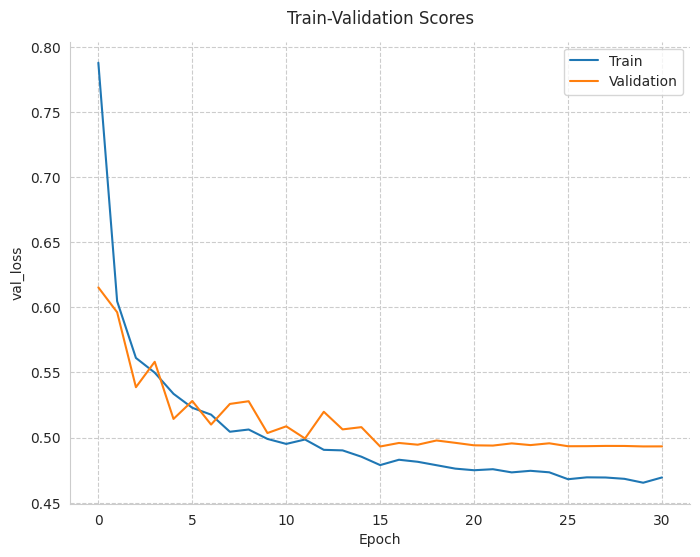

52/52 [==============================] - 1s 7ms/step
(1637,) (1637, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


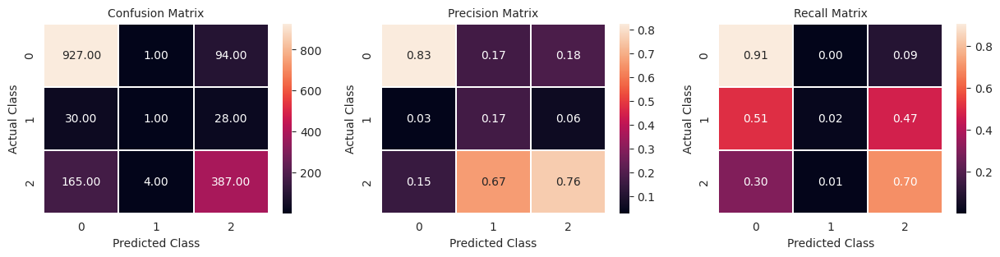


               precision    recall  f1-score   support

           0       0.83      0.91      0.86      1022
           1       0.17      0.02      0.03        59
           2       0.76      0.70      0.73       556

    accuracy                           0.80      1637
   macro avg       0.58      0.54      0.54      1637
weighted avg       0.78      0.80      0.79      1637

y_hat shape:(5271, 3)


Test log_loss: 0.49%

Running CV 1

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 38s 40ms/step - loss: 0.8399 - auc_pr: 0.7537 - val_loss: 0.6223 - val_auc_pr: 0.8073 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 6s 27ms/step - loss: 0.6183 - auc_pr: 0.8356 - val_loss: 0.5753 - val_auc_pr: 0.8381 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 5s 23ms/step - loss: 0.5755 - auc_pr: 0.8516 - val_loss: 0.6031 - val_auc_pr: 0.8286 - lr: 5.0000e-04
Epoch 4/200
205/205 [==============================] - 5s 24ms/step - loss: 0.5465 - auc_pr: 0.8598 - val_loss: 0.5827 - val_auc_pr: 0.8418 - lr: 5.0000e-04
Epoch 5/200
205/205 [==============================] - 5s 25ms/step - loss: 0.5434 - auc_pr: 0.8596 - val_loss: 0.5410 - val_auc_pr: 0.8673 - lr: 5.0000e-04
Epoch 6/200
205/205 [==============================] - 5s 24ms/step - loss: 0.5259 - auc_pr: 0.8668 - val_loss: 0.5578 - v

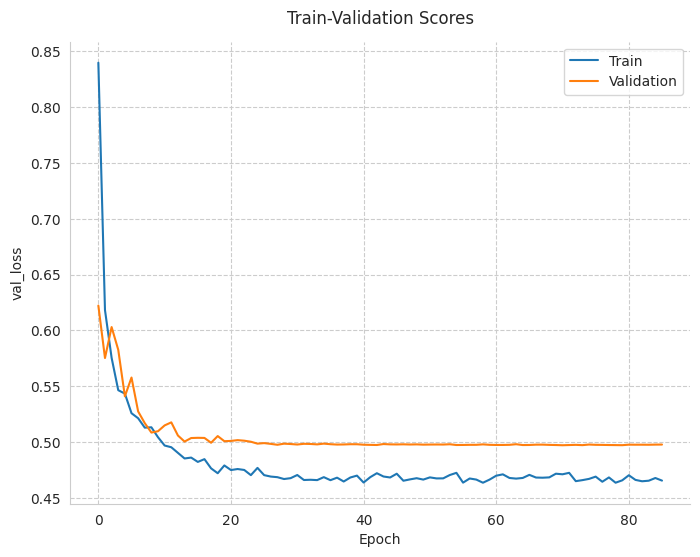

52/52 [==============================] - 1s 8ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


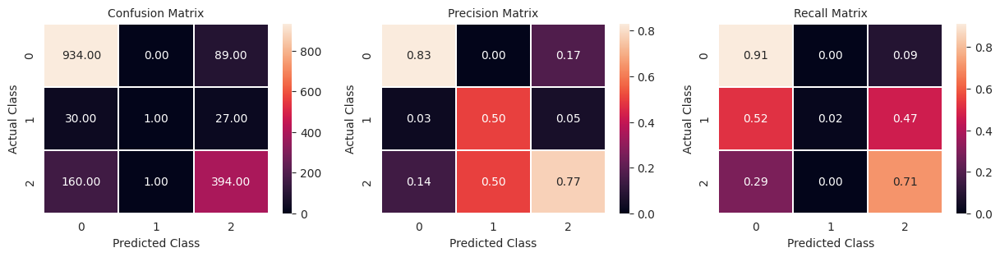


               precision    recall  f1-score   support

           0       0.83      0.91      0.87      1023
           1       0.50      0.02      0.03        58
           2       0.77      0.71      0.74       555

    accuracy                           0.81      1636
   macro avg       0.70      0.55      0.55      1636
weighted avg       0.80      0.81      0.80      1636

y_hat shape:(5271, 3)


Test log_loss: 0.5%

Running CV 2

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 38s 50ms/step - loss: 0.8352 - auc_pr: 0.7653 - val_loss: 0.6526 - val_auc_pr: 0.8054 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 6s 28ms/step - loss: 0.6250 - auc_pr: 0.8308 - val_loss: 0.6220 - val_auc_pr: 0.8179 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 6s 27ms/step - loss: 0.5781 - auc_pr: 0.8476 - val_loss: 0.5648 - val_auc_pr: 0.8547 - lr: 5.0000e-04
Epoch 4/200
205/205 [==============================] - 6s 28ms/step - loss: 0.5604 - auc_pr: 0.8560 - val_loss: 0.5349 - val_auc_pr: 0.8614 - lr: 5.0000e-04
Epoch 5/200
205/205 [==============================] - 6s 28ms/step - loss: 0.5426 - auc_pr: 0.8600 - val_loss: 0.5142 - val_auc_pr: 0.8683 - lr: 5.0000e-04
Epoch 6/200
205/205 [==============================] - 5s 25ms/step - loss: 0.5258 - auc_pr: 0.8658 - val_loss: 0.5454 - va

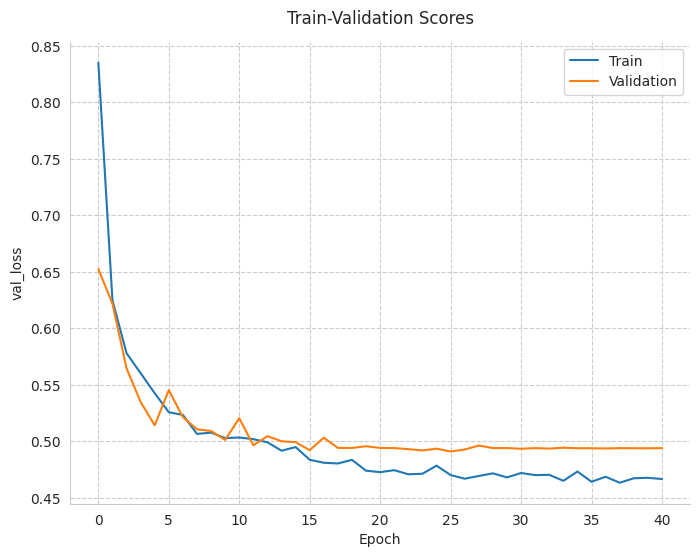

52/52 [==============================] - 1s 7ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


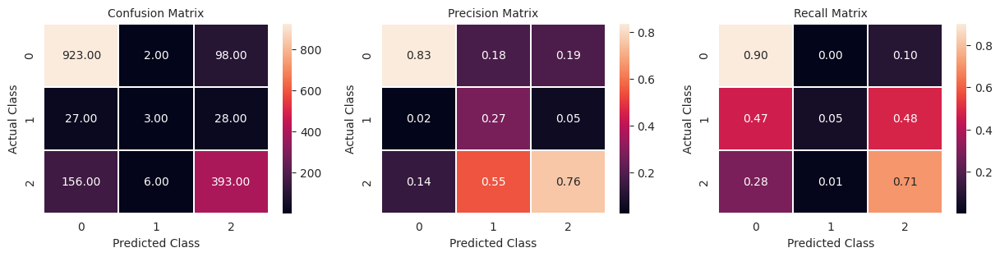


               precision    recall  f1-score   support

           0       0.83      0.90      0.87      1023
           1       0.27      0.05      0.09        58
           2       0.76      0.71      0.73       555

    accuracy                           0.81      1636
   macro avg       0.62      0.55      0.56      1636
weighted avg       0.79      0.81      0.79      1636

y_hat shape:(5271, 3)


Test log_loss: 0.49%

Running CV 3

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 39s 40ms/step - loss: 0.7994 - auc_pr: 0.7665 - val_loss: 0.5799 - val_auc_pr: 0.8365 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 5s 23ms/step - loss: 0.6181 - auc_pr: 0.8317 - val_loss: 0.6898 - val_auc_pr: 0.7833 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 5s 26ms/step - loss: 0.5710 - auc_pr: 0.8506 - val_loss: 0.5594 - val_auc_pr: 0.8582 - lr: 5.0000e-04
Epoch 4/200
205/205 [==============================] - 5s 25ms/step - loss: 0.5501 - auc_pr: 0.8566 - val_loss: 0.5219 - val_auc_pr: 0.8719 - lr: 5.0000e-04
Epoch 5/200
205/205 [==============================] - 5s 25ms/step - loss: 0.5461 - auc_pr: 0.8566 - val_loss: 0.5068 - val_auc_pr: 0.8752 - lr: 5.0000e-04
Epoch 6/200
205/205 [==============================] - 5s 24ms/step - loss: 0.5276 - auc_pr: 0.8655 - val_loss: 0.5147 - v

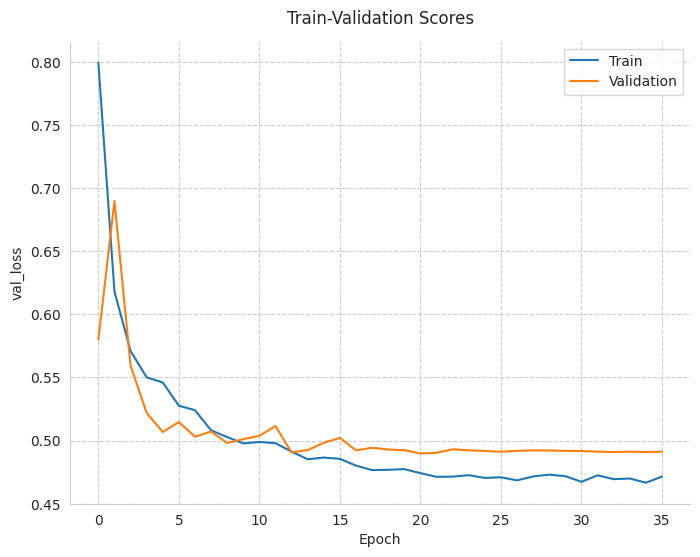

52/52 [==============================] - 1s 8ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


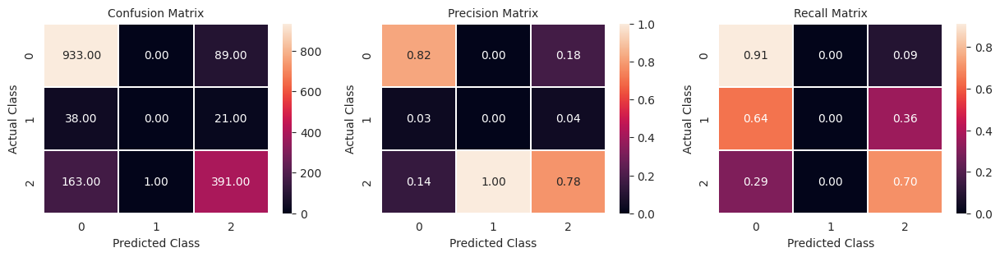


               precision    recall  f1-score   support

           0       0.82      0.91      0.87      1022
           1       0.00      0.00      0.00        59
           2       0.78      0.70      0.74       555

    accuracy                           0.81      1636
   macro avg       0.53      0.54      0.54      1636
weighted avg       0.78      0.81      0.79      1636

y_hat shape:(5271, 3)


Test log_loss: 0.49%

Running CV 4

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 40s 42ms/step - loss: 0.8125 - auc_pr: 0.7639 - val_loss: 0.6497 - val_auc_pr: 0.7955 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 6s 27ms/step - loss: 0.6257 - auc_pr: 0.8260 - val_loss: 0.5901 - val_auc_pr: 0.8249 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 6s 28ms/step - loss: 0.5811 - auc_pr: 0.8434 - val_loss: 0.4937 - val_auc_pr: 0.8820 - lr: 5.0000e-04
Epoch 4/200
205/205 [==============================] - 5s 25ms/step - loss: 0.5586 - auc_pr: 0.8534 - val_loss: 0.5054 - val_auc_pr: 0.8868 - lr: 5.0000e-04
Epoch 5/200
205/205 [==============================] - 5s 25ms/step - loss: 0.5415 - auc_pr: 0.8604 - val_loss: 0.5003 - val_auc_pr: 0.8778 - lr: 5.0000e-04
Epoch 6/200
205/205 [==============================] - 6s 27ms/step - loss: 0.5296 - auc_pr: 0.8672 - val_loss: 0.4900 - v

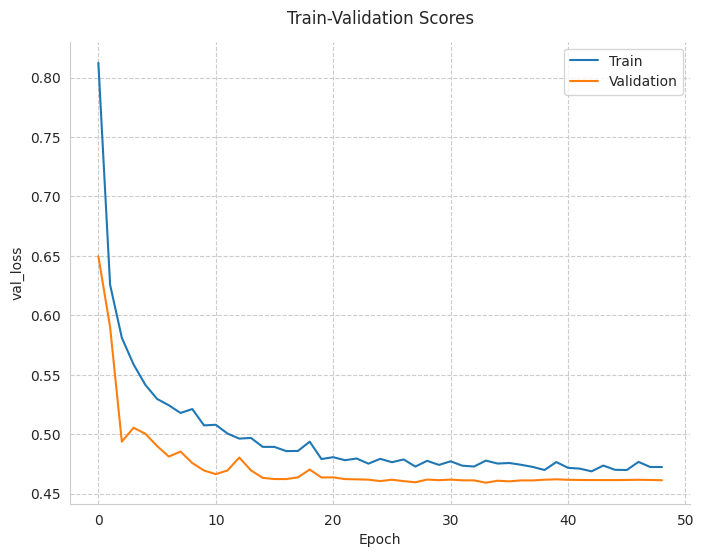

52/52 [==============================] - 1s 9ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


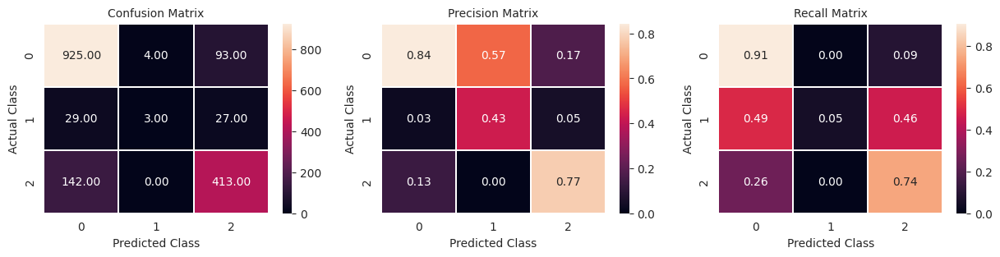


               precision    recall  f1-score   support

           0       0.84      0.91      0.87      1022
           1       0.43      0.05      0.09        59
           2       0.77      0.74      0.76       555

    accuracy                           0.82      1636
   macro avg       0.68      0.57      0.57      1636
weighted avg       0.81      0.82      0.81      1636

y_hat shape:(5271, 3)


Test log_loss: 0.46%

Running CV 5

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 37s 42ms/step - loss: 0.8122 - auc_pr: 0.7714 - val_loss: 0.8136 - val_auc_pr: 0.6433 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 8s 38ms/step - loss: 0.6285 - auc_pr: 0.8297 - val_loss: 0.5853 - val_auc_pr: 0.8337 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 6s 29ms/step - loss: 0.5753 - auc_pr: 0.8524 - val_loss: 0.5445 - val_auc_pr: 0.8537 - lr: 5.0000e-04
Epoch 4/200
205/205 [==============================] - 6s 28ms/step - loss: 0.5519 - auc_pr: 0.8580 - val_loss: 0.5200 - val_auc_pr: 0.8694 - lr: 5.0000e-04
Epoch 5/200
205/205 [==============================] - 5s 26ms/step - loss: 0.5356 - auc_pr: 0.8606 - val_loss: 0.5629 - val_auc_pr: 0.8605 - lr: 5.0000e-04
Epoch 6/200
205/205 [==============================] - 5s 26ms/step - loss: 0.5279 - auc_pr: 0.8658 - val_loss: 0.5285 - v

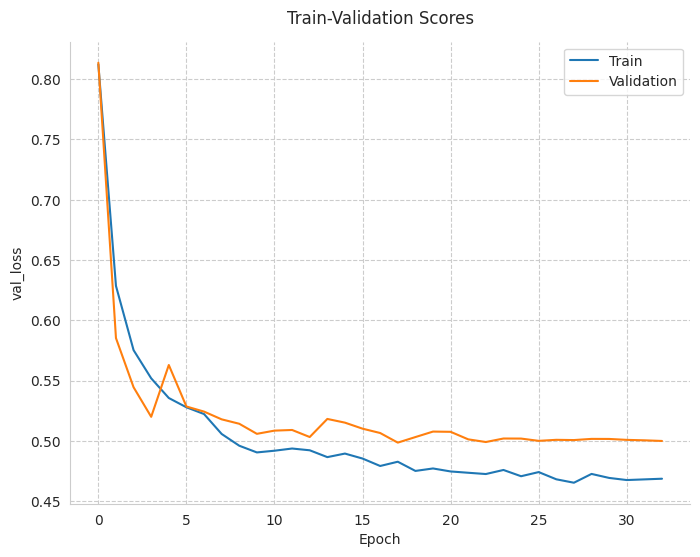

52/52 [==============================] - 1s 9ms/step
(1637,) (1637, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


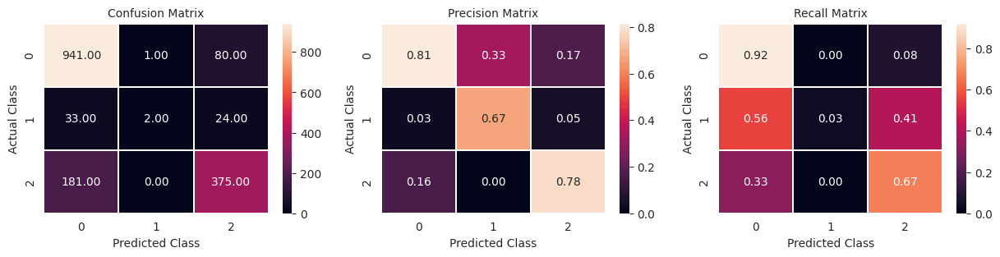


               precision    recall  f1-score   support

           0       0.81      0.92      0.86      1022
           1       0.67      0.03      0.06        59
           2       0.78      0.67      0.72       556

    accuracy                           0.81      1637
   macro avg       0.75      0.54      0.55      1637
weighted avg       0.80      0.81      0.79      1637

y_hat shape:(5271, 3)


Test log_loss: 0.5%

Running CV 6

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 40s 42ms/step - loss: 0.8464 - auc_pr: 0.7633 - val_loss: 0.6173 - val_auc_pr: 0.8096 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 6s 28ms/step - loss: 0.6302 - auc_pr: 0.8273 - val_loss: 0.5861 - val_auc_pr: 0.8328 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 6s 27ms/step - loss: 0.5873 - auc_pr: 0.8445 - val_loss: 0.5365 - val_auc_pr: 0.8593 - lr: 5.0000e-04
Epoch 4/200
205/205 [==============================] - 6s 27ms/step - loss: 0.5679 - auc_pr: 0.8494 - val_loss: 0.4892 - val_auc_pr: 0.8859 - lr: 5.0000e-04
Epoch 5/200
205/205 [==============================] - 5s 25ms/step - loss: 0.5544 - auc_pr: 0.8513 - val_loss: 0.5136 - val_auc_pr: 0.8711 - lr: 5.0000e-04
Epoch 6/200
205/205 [==============================] - 5s 26ms/step - loss: 0.5340 - auc_pr: 0.8625 - val_loss: 0.5401 - va

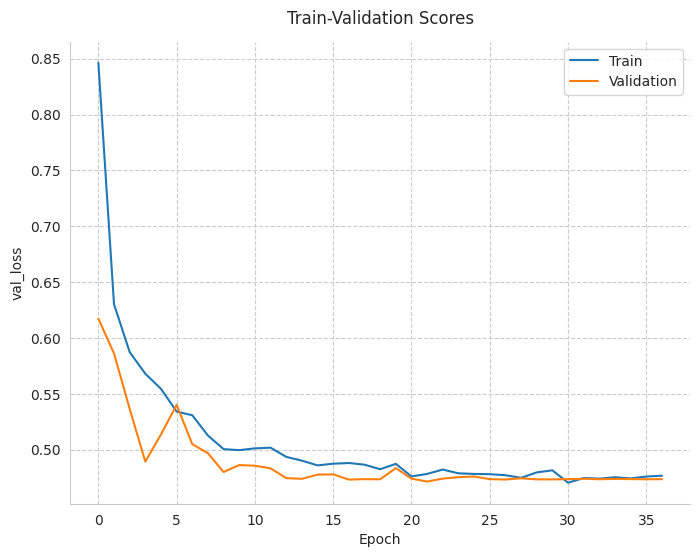

52/52 [==============================] - 1s 7ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


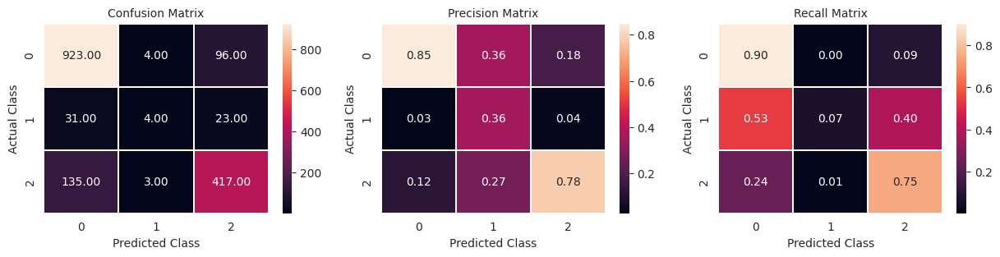


               precision    recall  f1-score   support

           0       0.85      0.90      0.87      1023
           1       0.36      0.07      0.12        58
           2       0.78      0.75      0.76       555

    accuracy                           0.82      1636
   macro avg       0.66      0.57      0.58      1636
weighted avg       0.81      0.82      0.81      1636

y_hat shape:(5271, 3)


Test log_loss: 0.47%

Running CV 7

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 37s 45ms/step - loss: 0.8245 - auc_pr: 0.7653 - val_loss: 0.6623 - val_auc_pr: 0.8009 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 6s 28ms/step - loss: 0.6157 - auc_pr: 0.8332 - val_loss: 0.5666 - val_auc_pr: 0.8497 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 5s 26ms/step - loss: 0.5715 - auc_pr: 0.8512 - val_loss: 0.5562 - val_auc_pr: 0.8503 - lr: 5.0000e-04
Epoch 4/200
205/205 [==============================] - 5s 26ms/step - loss: 0.5553 - auc_pr: 0.8549 - val_loss: 0.5274 - val_auc_pr: 0.8675 - lr: 5.0000e-04
Epoch 5/200
205/205 [==============================] - 5s 26ms/step - loss: 0.5464 - auc_pr: 0.8576 - val_loss: 0.5121 - val_auc_pr: 0.8753 - lr: 5.0000e-04
Epoch 6/200
205/205 [==============================] - 6s 27ms/step - loss: 0.5261 - auc_pr: 0.8653 - val_loss: 0.5111 - v

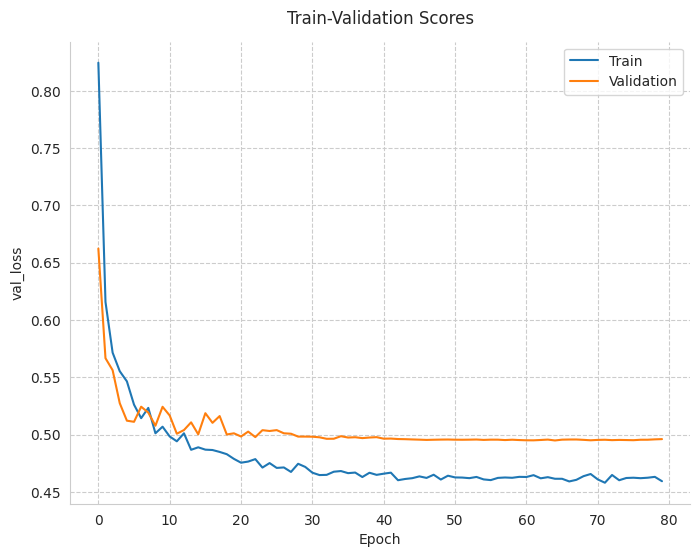

52/52 [==============================] - 1s 7ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


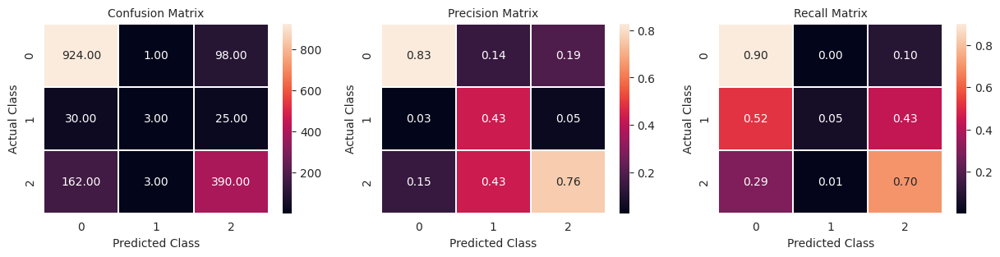


               precision    recall  f1-score   support

           0       0.83      0.90      0.86      1023
           1       0.43      0.05      0.09        58
           2       0.76      0.70      0.73       555

    accuracy                           0.81      1636
   macro avg       0.67      0.55      0.56      1636
weighted avg       0.79      0.81      0.79      1636

y_hat shape:(5271, 3)


Test log_loss: 0.49%

Running CV 8

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 38s 51ms/step - loss: 0.8015 - auc_pr: 0.7742 - val_loss: 0.6121 - val_auc_pr: 0.7976 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 6s 29ms/step - loss: 0.6170 - auc_pr: 0.8348 - val_loss: 0.5908 - val_auc_pr: 0.8210 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 6s 28ms/step - loss: 0.5872 - auc_pr: 0.8421 - val_loss: 0.5448 - val_auc_pr: 0.8423 - lr: 5.0000e-04
Epoch 4/200
205/205 [==============================] - 6s 29ms/step - loss: 0.5511 - auc_pr: 0.8563 - val_loss: 0.5160 - val_auc_pr: 0.8607 - lr: 5.0000e-04
Epoch 5/200
205/205 [==============================] - 5s 26ms/step - loss: 0.5328 - auc_pr: 0.8643 - val_loss: 0.5225 - val_auc_pr: 0.8663 - lr: 5.0000e-04
Epoch 6/200
205/205 [==============================] - 6s 29ms/step - loss: 0.5299 - auc_pr: 0.8657 - val_loss: 0.5053 - v

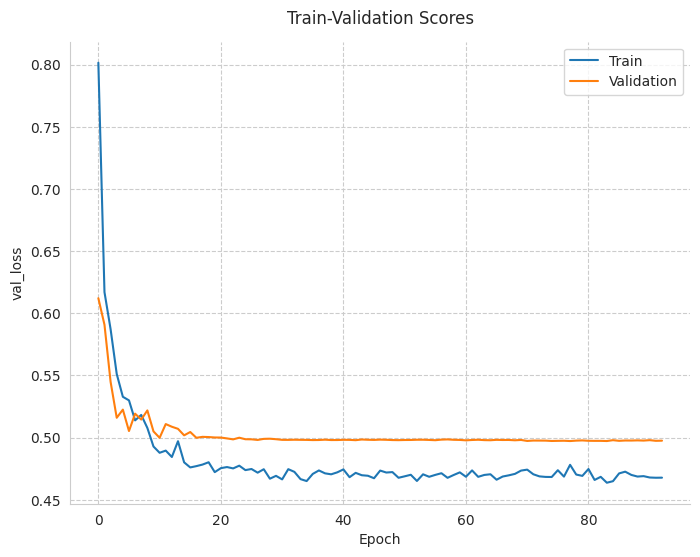

52/52 [==============================] - 1s 8ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


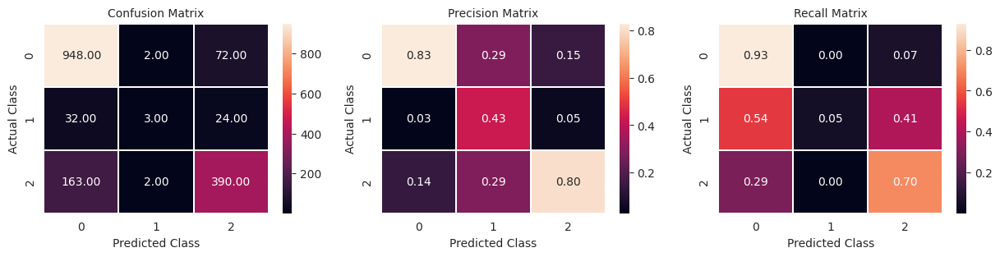


               precision    recall  f1-score   support

           0       0.83      0.93      0.88      1022
           1       0.43      0.05      0.09        59
           2       0.80      0.70      0.75       555

    accuracy                           0.82      1636
   macro avg       0.69      0.56      0.57      1636
weighted avg       0.81      0.82      0.80      1636

y_hat shape:(5271, 3)


Test log_loss: 0.5%

Running CV 9

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 36s 42ms/step - loss: 0.7967 - auc_pr: 0.7659 - val_loss: 0.5817 - val_auc_pr: 0.8343 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 5s 24ms/step - loss: 0.6053 - auc_pr: 0.8353 - val_loss: 0.6088 - val_auc_pr: 0.8115 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 6s 28ms/step - loss: 0.5696 - auc_pr: 0.8512 - val_loss: 0.5127 - val_auc_pr: 0.8750 - lr: 5.0000e-04
Epoch 4/200
205/205 [==============================] - 6s 27ms/step - loss: 0.5542 - auc_pr: 0.8551 - val_loss: 0.4977 - val_auc_pr: 0.8804 - lr: 5.0000e-04
Epoch 5/200
205/205 [==============================] - 5s 24ms/step - loss: 0.5393 - auc_pr: 0.8611 - val_loss: 0.5042 - val_auc_pr: 0.8788 - lr: 5.0000e-04
Epoch 6/200
205/205 [==============================] - 5s 25ms/step - loss: 0.5311 - auc_pr: 0.8661 - val_loss: 0.5033 - va

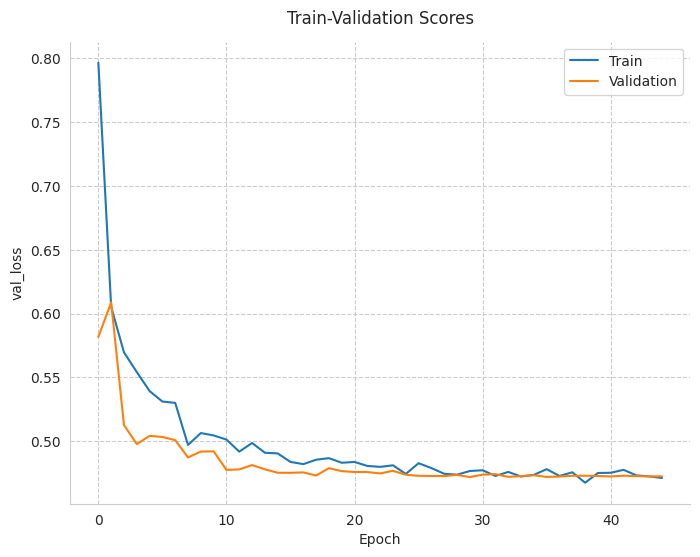

52/52 [==============================] - 1s 8ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


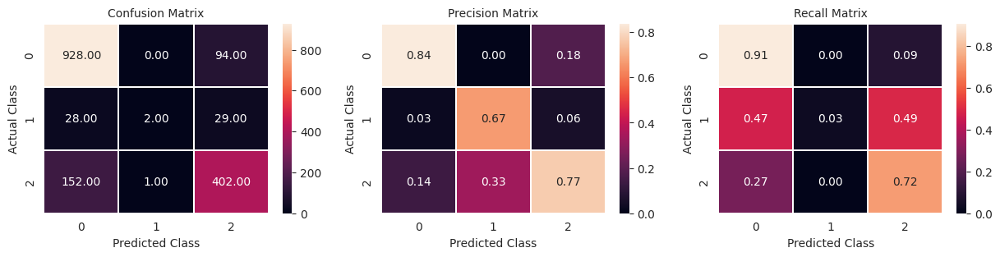


               precision    recall  f1-score   support

           0       0.84      0.91      0.87      1022
           1       0.67      0.03      0.06        59
           2       0.77      0.72      0.74       555

    accuracy                           0.81      1636
   macro avg       0.76      0.56      0.56      1636
weighted avg       0.81      0.81      0.80      1636

y_hat shape:(5271, 3)


Test log_loss: 0.47%

Running CV 10

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 42s 45ms/step - loss: 0.7976 - auc_pr: 0.7692 - val_loss: 0.6602 - val_auc_pr: 0.7926 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 6s 27ms/step - loss: 0.6026 - auc_pr: 0.8412 - val_loss: 0.6053 - val_auc_pr: 0.8215 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 6s 28ms/step - loss: 0.5705 - auc_pr: 0.8505 - val_loss: 0.5556 - val_auc_pr: 0.8461 - lr: 5.0000e-04
Epoch 4/200
205/205 [==============================] - 6s 29ms/step - loss: 0.5455 - auc_pr: 0.8600 - val_loss: 0.5457 - val_auc_pr: 0.8560 - lr: 5.0000e-04
Epoch 5/200
205/205 [==============================] - 6s 28ms/step - loss: 0.5314 - auc_pr: 0.8650 - val_loss: 0.5175 - val_auc_pr: 0.8721 - lr: 5.0000e-04
Epoch 6/200
205/205 [==============================] - 6s 28ms/step - loss: 0.5238 - auc_pr: 0.8679 - val_loss: 0.4990 - 

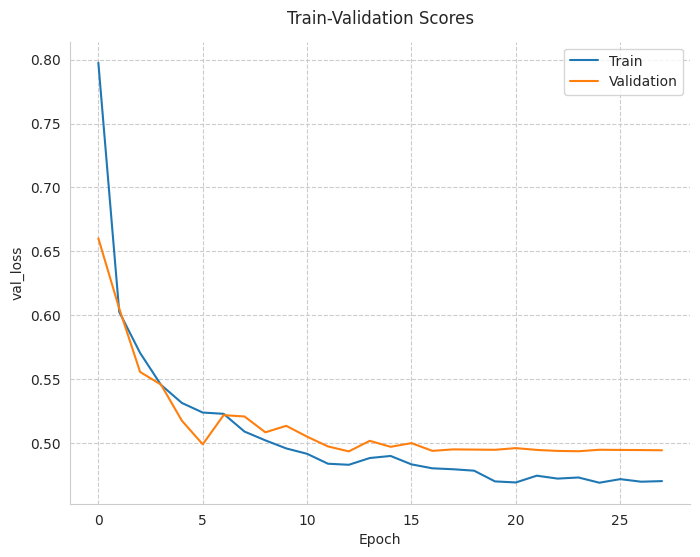

52/52 [==============================] - 1s 9ms/step
(1637,) (1637, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


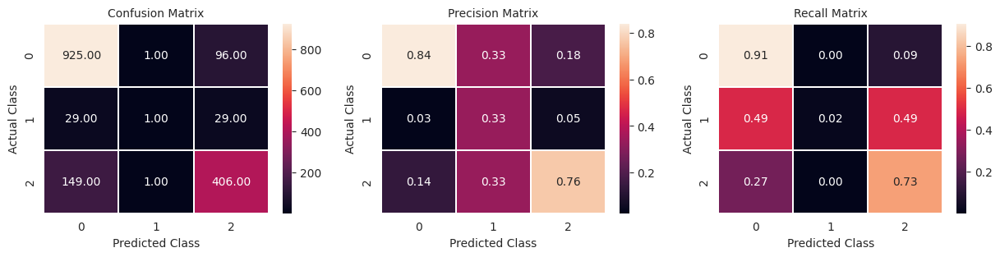


               precision    recall  f1-score   support

           0       0.84      0.91      0.87      1022
           1       0.33      0.02      0.03        59
           2       0.76      0.73      0.75       556

    accuracy                           0.81      1637
   macro avg       0.65      0.55      0.55      1637
weighted avg       0.80      0.81      0.80      1637

y_hat shape:(5271, 3)


Test log_loss: 0.49%

Running CV 11

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 37s 42ms/step - loss: 0.7916 - auc_pr: 0.7698 - val_loss: 0.5979 - val_auc_pr: 0.8154 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 6s 27ms/step - loss: 0.6071 - auc_pr: 0.8377 - val_loss: 0.5727 - val_auc_pr: 0.8377 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 6s 29ms/step - loss: 0.5821 - auc_pr: 0.8435 - val_loss: 0.5388 - val_auc_pr: 0.8640 - lr: 5.0000e-04
Epoch 4/200
205/205 [==============================] - 6s 27ms/step - loss: 0.5554 - auc_pr: 0.8536 - val_loss: 0.5068 - val_auc_pr: 0.8706 - lr: 5.0000e-04
Epoch 5/200
205/205 [==============================] - 7s 34ms/step - loss: 0.5370 - auc_pr: 0.8608 - val_loss: 0.5011 - val_auc_pr: 0.8814 - lr: 5.0000e-04
Epoch 6/200
205/205 [==============================] - 6s 29ms/step - loss: 0.5316 - auc_pr: 0.8652 - val_loss: 0.4956 - 

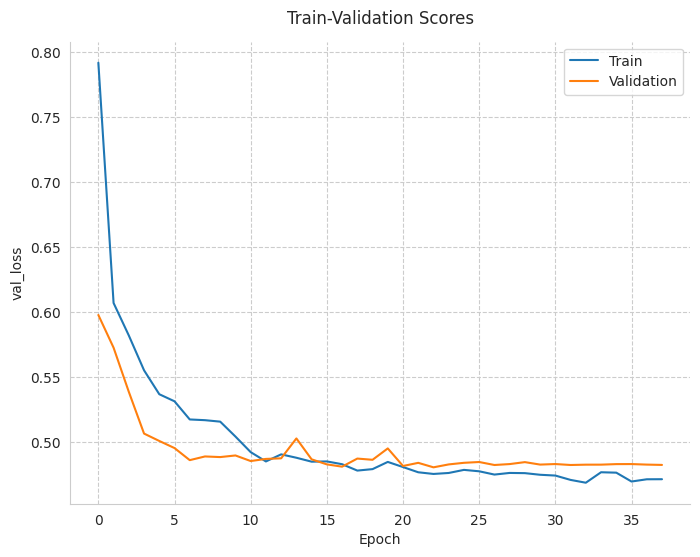

52/52 [==============================] - 1s 8ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


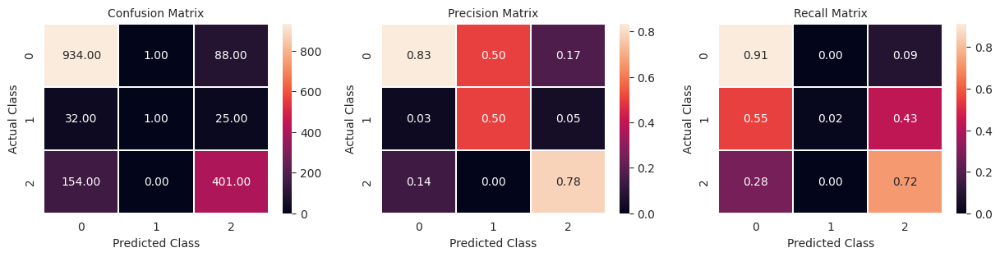


               precision    recall  f1-score   support

           0       0.83      0.91      0.87      1023
           1       0.50      0.02      0.03        58
           2       0.78      0.72      0.75       555

    accuracy                           0.82      1636
   macro avg       0.70      0.55      0.55      1636
weighted avg       0.80      0.82      0.80      1636

y_hat shape:(5271, 3)


Test log_loss: 0.48%

Running CV 12

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 41s 44ms/step - loss: 0.8262 - auc_pr: 0.7607 - val_loss: 0.5707 - val_auc_pr: 0.8368 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 6s 28ms/step - loss: 0.6293 - auc_pr: 0.8275 - val_loss: 0.5665 - val_auc_pr: 0.8497 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 6s 30ms/step - loss: 0.5947 - auc_pr: 0.8397 - val_loss: 0.5043 - val_auc_pr: 0.8816 - lr: 5.0000e-04
Epoch 4/200
205/205 [==============================] - 5s 26ms/step - loss: 0.5604 - auc_pr: 0.8513 - val_loss: 0.5058 - val_auc_pr: 0.8736 - lr: 5.0000e-04
Epoch 5/200
205/205 [==============================] - 6s 28ms/step - loss: 0.5411 - auc_pr: 0.8600 - val_loss: 0.4935 - val_auc_pr: 0.8890 - lr: 5.0000e-04
Epoch 6/200
205/205 [==============================] - 6s 28ms/step - loss: 0.5363 - auc_pr: 0.8614 - val_loss: 0.4731 - 

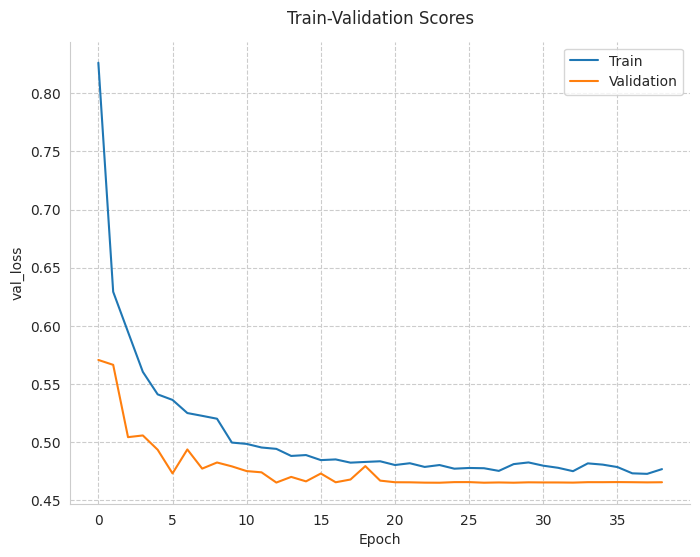

52/52 [==============================] - 1s 8ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


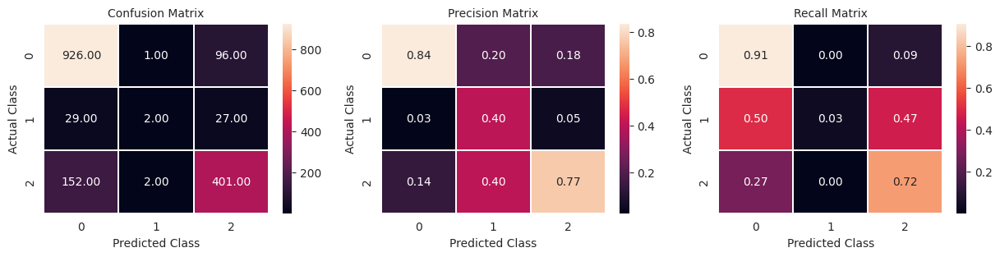


               precision    recall  f1-score   support

           0       0.84      0.91      0.87      1023
           1       0.40      0.03      0.06        58
           2       0.77      0.72      0.74       555

    accuracy                           0.81      1636
   macro avg       0.67      0.55      0.56      1636
weighted avg       0.80      0.81      0.80      1636

y_hat shape:(5271, 3)


Test log_loss: 0.47%

Running CV 13

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 40s 43ms/step - loss: 0.7849 - auc_pr: 0.7758 - val_loss: 0.7089 - val_auc_pr: 0.7441 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 6s 30ms/step - loss: 0.6062 - auc_pr: 0.8371 - val_loss: 0.6117 - val_auc_pr: 0.8145 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 6s 29ms/step - loss: 0.5737 - auc_pr: 0.8486 - val_loss: 0.5608 - val_auc_pr: 0.8596 - lr: 5.0000e-04
Epoch 4/200
205/205 [==============================] - 6s 28ms/step - loss: 0.5491 - auc_pr: 0.8538 - val_loss: 0.5193 - val_auc_pr: 0.8749 - lr: 5.0000e-04
Epoch 5/200
205/205 [==============================] - 6s 28ms/step - loss: 0.5313 - auc_pr: 0.8645 - val_loss: 0.5484 - val_auc_pr: 0.8554 - lr: 5.0000e-04
Epoch 6/200
205/205 [==============================] - 6s 28ms/step - loss: 0.5297 - auc_pr: 0.8630 - val_loss: 0.5146 - 

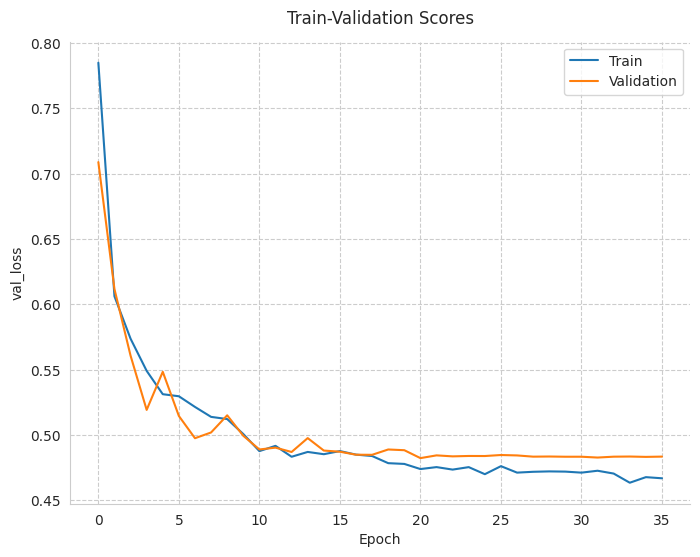

52/52 [==============================] - 1s 8ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


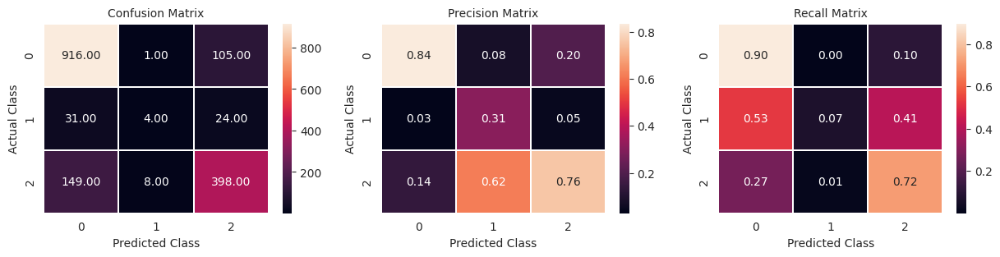


               precision    recall  f1-score   support

           0       0.84      0.90      0.86      1022
           1       0.31      0.07      0.11        59
           2       0.76      0.72      0.74       555

    accuracy                           0.81      1636
   macro avg       0.63      0.56      0.57      1636
weighted avg       0.79      0.81      0.79      1636

y_hat shape:(5271, 3)


Test log_loss: 0.48%

Running CV 14

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 42s 46ms/step - loss: 0.8101 - auc_pr: 0.7626 - val_loss: 0.5989 - val_auc_pr: 0.8250 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 6s 27ms/step - loss: 0.6115 - auc_pr: 0.8347 - val_loss: 0.5779 - val_auc_pr: 0.8352 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 6s 29ms/step - loss: 0.5622 - auc_pr: 0.8549 - val_loss: 0.5497 - val_auc_pr: 0.8496 - lr: 5.0000e-04
Epoch 4/200
205/205 [==============================] - 6s 28ms/step - loss: 0.5446 - auc_pr: 0.8596 - val_loss: 0.5193 - val_auc_pr: 0.8676 - lr: 5.0000e-04
Epoch 5/200
205/205 [==============================] - 6s 27ms/step - loss: 0.5331 - auc_pr: 0.8642 - val_loss: 0.5351 - val_auc_pr: 0.8645 - lr: 5.0000e-04
Epoch 6/200
205/205 [==============================] - 6s 27ms/step - loss: 0.5219 - auc_pr: 0.8702 - val_loss: 0.5234 - 

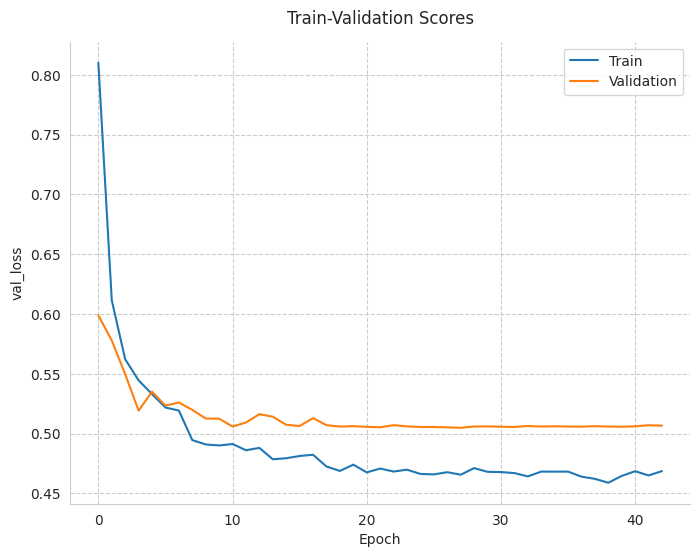

52/52 [==============================] - 1s 8ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


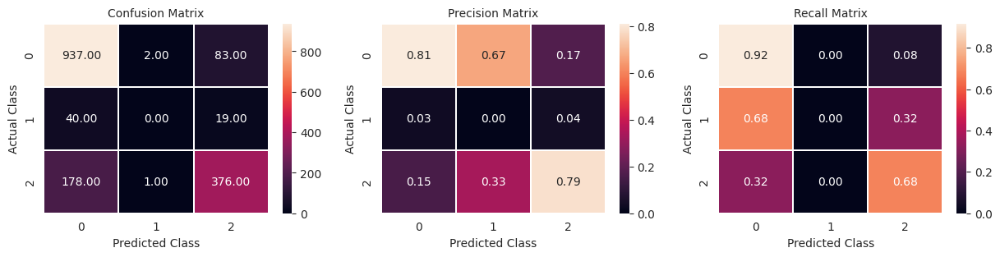


               precision    recall  f1-score   support

           0       0.81      0.92      0.86      1022
           1       0.00      0.00      0.00        59
           2       0.79      0.68      0.73       555

    accuracy                           0.80      1636
   macro avg       0.53      0.53      0.53      1636
weighted avg       0.77      0.80      0.78      1636

y_hat shape:(5271, 3)


Test log_loss: 0.5%

Running CV 15

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 38s 42ms/step - loss: 0.8276 - auc_pr: 0.7672 - val_loss: 0.7088 - val_auc_pr: 0.7403 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 6s 28ms/step - loss: 0.6141 - auc_pr: 0.8363 - val_loss: 0.6767 - val_auc_pr: 0.7586 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 7s 34ms/step - loss: 0.5824 - auc_pr: 0.8470 - val_loss: 0.5374 - val_auc_pr: 0.8577 - lr: 5.0000e-04
Epoch 4/200
205/205 [==============================] - 6s 28ms/step - loss: 0.5512 - auc_pr: 0.8557 - val_loss: 0.5240 - val_auc_pr: 0.8703 - lr: 5.0000e-04
Epoch 5/200
205/205 [==============================] - 6s 29ms/step - loss: 0.5442 - auc_pr: 0.8588 - val_loss: 0.5313 - val_auc_pr: 0.8696 - lr: 5.0000e-04
Epoch 6/200
205/205 [==============================] - 5s 26ms/step - loss: 0.5210 - auc_pr: 0.8662 - val_loss: 0.5458 - v

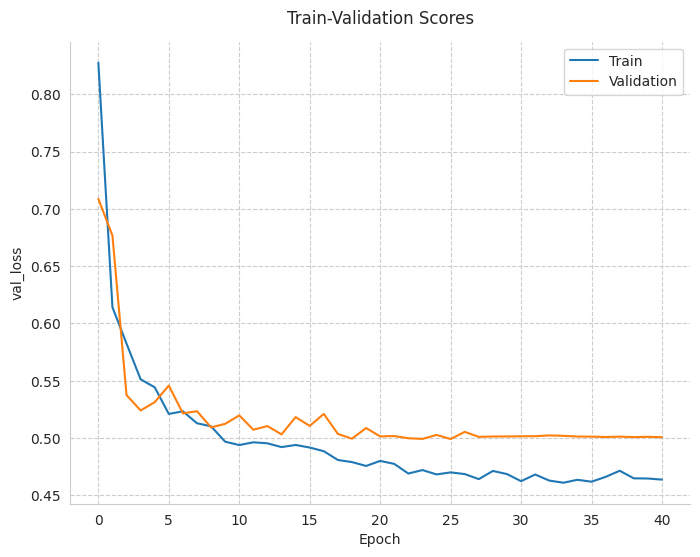

52/52 [==============================] - 1s 8ms/step
(1637,) (1637, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


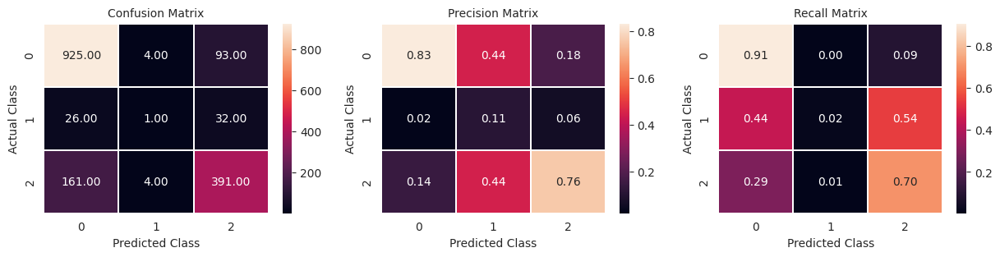


               precision    recall  f1-score   support

           0       0.83      0.91      0.87      1022
           1       0.11      0.02      0.03        59
           2       0.76      0.70      0.73       556

    accuracy                           0.80      1637
   macro avg       0.57      0.54      0.54      1637
weighted avg       0.78      0.80      0.79      1637

y_hat shape:(5271, 3)


Test log_loss: 0.5%

Running CV 16

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 41s 43ms/step - loss: 0.8361 - auc_pr: 0.7557 - val_loss: 0.5862 - val_auc_pr: 0.8210 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 6s 28ms/step - loss: 0.6013 - auc_pr: 0.8351 - val_loss: 0.5227 - val_auc_pr: 0.8689 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 6s 27ms/step - loss: 0.5939 - auc_pr: 0.8430 - val_loss: 0.5037 - val_auc_pr: 0.8781 - lr: 5.0000e-04
Epoch 4/200
205/205 [==============================] - 6s 28ms/step - loss: 0.5447 - auc_pr: 0.8574 - val_loss: 0.4972 - val_auc_pr: 0.8821 - lr: 5.0000e-04
Epoch 5/200
205/205 [==============================] - 6s 28ms/step - loss: 0.5527 - auc_pr: 0.8533 - val_loss: 0.4885 - val_auc_pr: 0.8860 - lr: 5.0000e-04
Epoch 6/200
205/205 [==============================] - 6s 29ms/step - loss: 0.5319 - auc_pr: 0.8603 - val_loss: 0.4838 - v

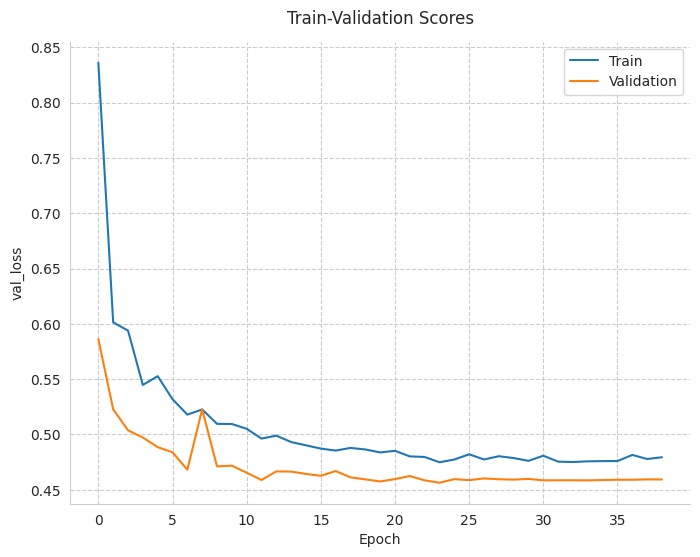

52/52 [==============================] - 1s 8ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


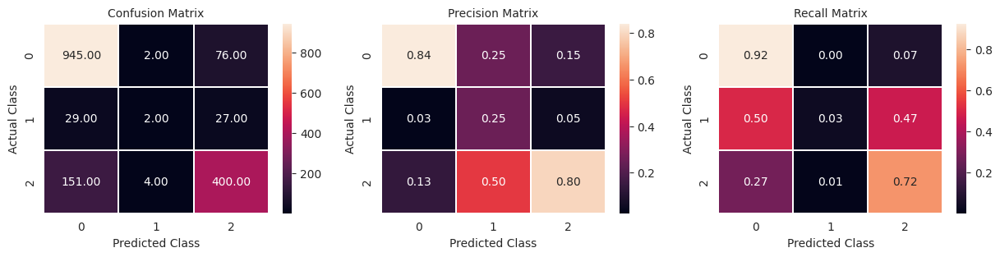


               precision    recall  f1-score   support

           0       0.84      0.92      0.88      1023
           1       0.25      0.03      0.06        58
           2       0.80      0.72      0.76       555

    accuracy                           0.82      1636
   macro avg       0.63      0.56      0.57      1636
weighted avg       0.80      0.82      0.81      1636

y_hat shape:(5271, 3)


Test log_loss: 0.46%

Running CV 17

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 36s 41ms/step - loss: 0.7773 - auc_pr: 0.7808 - val_loss: 0.6805 - val_auc_pr: 0.7784 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 8s 37ms/step - loss: 0.5959 - auc_pr: 0.8419 - val_loss: 0.6136 - val_auc_pr: 0.8317 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 6s 29ms/step - loss: 0.5748 - auc_pr: 0.8454 - val_loss: 0.5638 - val_auc_pr: 0.8351 - lr: 5.0000e-04
Epoch 4/200
205/205 [==============================] - 6s 29ms/step - loss: 0.5509 - auc_pr: 0.8582 - val_loss: 0.5386 - val_auc_pr: 0.8628 - lr: 5.0000e-04
Epoch 5/200
205/205 [==============================] - 6s 27ms/step - loss: 0.5239 - auc_pr: 0.8674 - val_loss: 0.5387 - val_auc_pr: 0.8607 - lr: 5.0000e-04
Epoch 6/200
205/205 [==============================] - 6s 29ms/step - loss: 0.5265 - auc_pr: 0.8663 - val_loss: 0.5341 - 

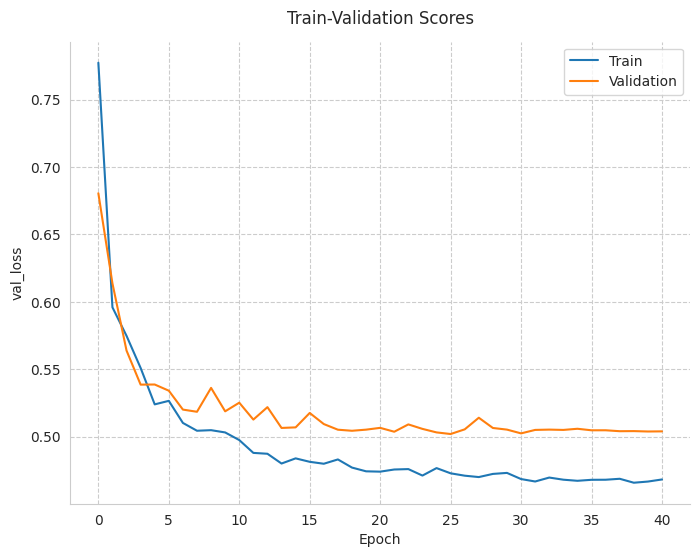

52/52 [==============================] - 1s 8ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


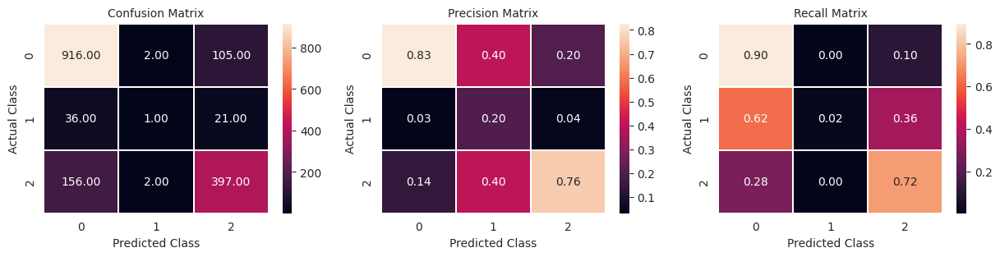


               precision    recall  f1-score   support

           0       0.83      0.90      0.86      1023
           1       0.20      0.02      0.03        58
           2       0.76      0.72      0.74       555

    accuracy                           0.80      1636
   macro avg       0.60      0.54      0.54      1636
weighted avg       0.78      0.80      0.79      1636

y_hat shape:(5271, 3)


Test log_loss: 0.5%

Running CV 18

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 42s 46ms/step - loss: 0.8097 - auc_pr: 0.7687 - val_loss: 0.6087 - val_auc_pr: 0.8124 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 6s 29ms/step - loss: 0.6177 - auc_pr: 0.8338 - val_loss: 0.5688 - val_auc_pr: 0.8366 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 6s 28ms/step - loss: 0.5816 - auc_pr: 0.8465 - val_loss: 0.5048 - val_auc_pr: 0.8761 - lr: 5.0000e-04
Epoch 4/200
205/205 [==============================] - 6s 30ms/step - loss: 0.5568 - auc_pr: 0.8562 - val_loss: 0.4945 - val_auc_pr: 0.8796 - lr: 5.0000e-04
Epoch 5/200
205/205 [==============================] - 6s 27ms/step - loss: 0.5442 - auc_pr: 0.8596 - val_loss: 0.5160 - val_auc_pr: 0.8738 - lr: 5.0000e-04
Epoch 6/200
205/205 [==============================] - 6s 27ms/step - loss: 0.5242 - auc_pr: 0.8644 - val_loss: 0.5041 - v

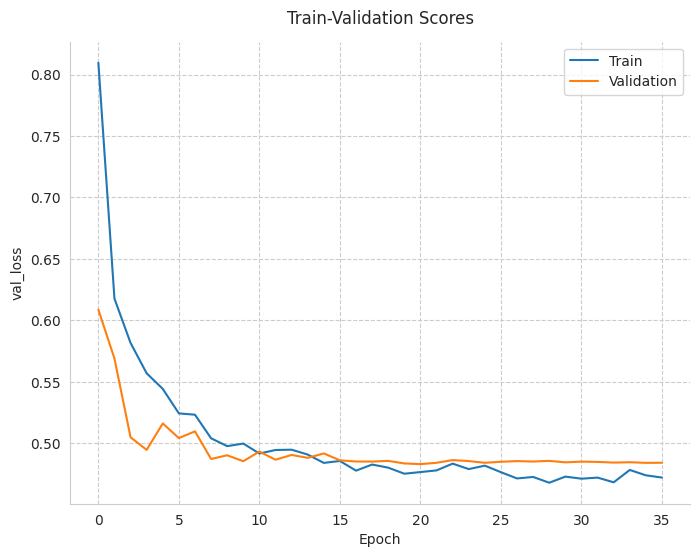

52/52 [==============================] - 1s 8ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


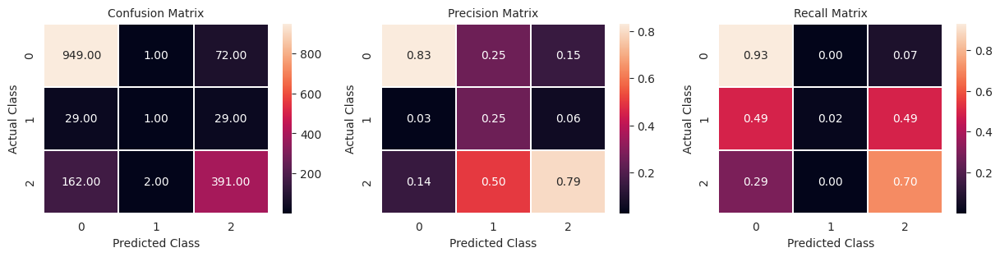


               precision    recall  f1-score   support

           0       0.83      0.93      0.88      1022
           1       0.25      0.02      0.03        59
           2       0.79      0.70      0.75       555

    accuracy                           0.82      1636
   macro avg       0.63      0.55      0.55      1636
weighted avg       0.80      0.82      0.80      1636

y_hat shape:(5271, 3)


Test log_loss: 0.48%

Running CV 19

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 36s 41ms/step - loss: 0.8227 - auc_pr: 0.7680 - val_loss: 0.6396 - val_auc_pr: 0.7890 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 8s 37ms/step - loss: 0.6122 - auc_pr: 0.8326 - val_loss: 0.5981 - val_auc_pr: 0.8125 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 6s 28ms/step - loss: 0.5696 - auc_pr: 0.8499 - val_loss: 0.6775 - val_auc_pr: 0.8464 - lr: 5.0000e-04
Epoch 4/200
205/205 [==============================] - 6s 29ms/step - loss: 0.5607 - auc_pr: 0.8542 - val_loss: 0.5578 - val_auc_pr: 0.8517 - lr: 5.0000e-04
Epoch 5/200
205/205 [==============================] - 7s 31ms/step - loss: 0.5425 - auc_pr: 0.8615 - val_loss: 0.5220 - val_auc_pr: 0.8619 - lr: 5.0000e-04
Epoch 6/200
205/205 [==============================] - 6s 27ms/step - loss: 0.5287 - auc_pr: 0.8642 - val_loss: 0.5280 - 

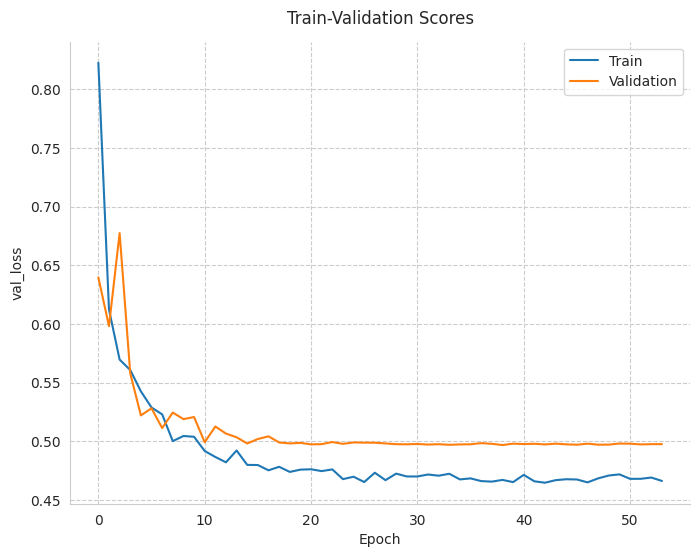

52/52 [==============================] - 1s 8ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


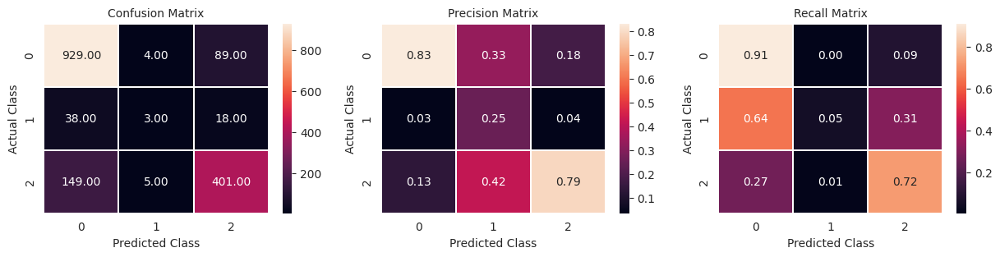


               precision    recall  f1-score   support

           0       0.83      0.91      0.87      1022
           1       0.25      0.05      0.08        59
           2       0.79      0.72      0.75       555

    accuracy                           0.81      1636
   macro avg       0.62      0.56      0.57      1636
weighted avg       0.80      0.81      0.80      1636

y_hat shape:(5271, 3)


Test log_loss: 0.5%

Running CV 20

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 43s 45ms/step - loss: 0.8090 - auc_pr: 0.7658 - val_loss: 0.6478 - val_auc_pr: 0.7966 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 6s 29ms/step - loss: 0.6018 - auc_pr: 0.8385 - val_loss: 0.5629 - val_auc_pr: 0.8510 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 6s 29ms/step - loss: 0.5706 - auc_pr: 0.8504 - val_loss: 0.5388 - val_auc_pr: 0.8643 - lr: 5.0000e-04
Epoch 4/200
205/205 [==============================] - 6s 29ms/step - loss: 0.5498 - auc_pr: 0.8574 - val_loss: 0.5285 - val_auc_pr: 0.8663 - lr: 5.0000e-04
Epoch 5/200
205/205 [==============================] - 6s 28ms/step - loss: 0.5377 - auc_pr: 0.8625 - val_loss: 0.5289 - val_auc_pr: 0.8615 - lr: 5.0000e-04
Epoch 6/200
205/205 [==============================] - 6s 27ms/step - loss: 0.5275 - auc_pr: 0.8674 - val_loss: 0.5706 - v

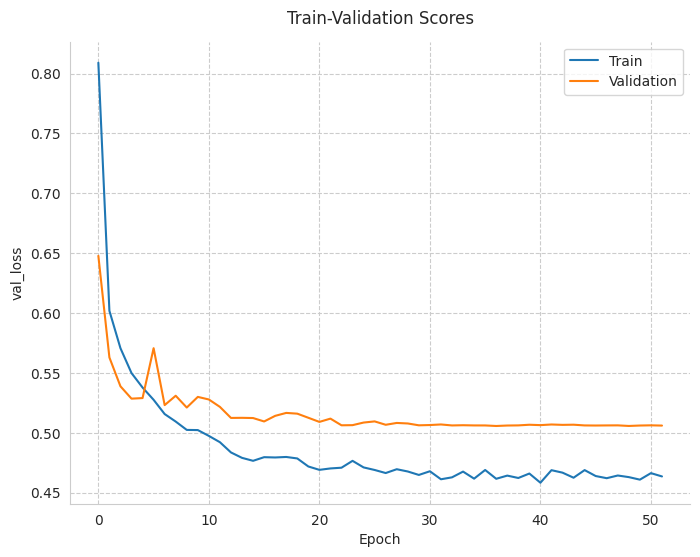

52/52 [==============================] - 1s 8ms/step
(1637,) (1637, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


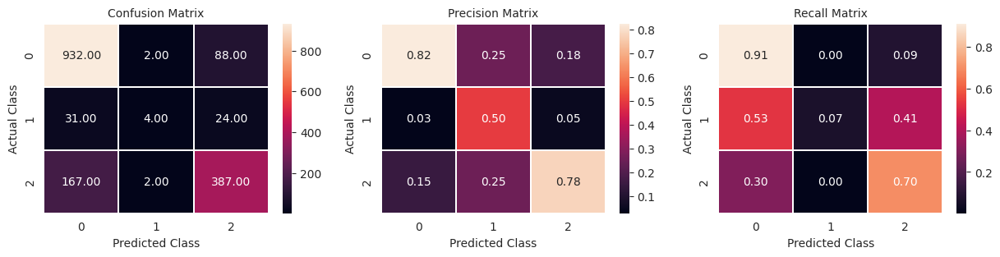


               precision    recall  f1-score   support

           0       0.82      0.91      0.87      1022
           1       0.50      0.07      0.12        59
           2       0.78      0.70      0.73       556

    accuracy                           0.81      1637
   macro avg       0.70      0.56      0.57      1637
weighted avg       0.80      0.81      0.79      1637

y_hat shape:(5271, 3)


Test log_loss: 0.51%

Running CV 21

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 36s 41ms/step - loss: 0.8031 - auc_pr: 0.7676 - val_loss: 0.6630 - val_auc_pr: 0.7951 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 6s 27ms/step - loss: 0.6252 - auc_pr: 0.8335 - val_loss: 0.5413 - val_auc_pr: 0.8591 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 8s 37ms/step - loss: 0.5752 - auc_pr: 0.8482 - val_loss: 0.5333 - val_auc_pr: 0.8629 - lr: 5.0000e-04
Epoch 4/200
205/205 [==============================] - 6s 28ms/step - loss: 0.5567 - auc_pr: 0.8549 - val_loss: 0.4962 - val_auc_pr: 0.8799 - lr: 5.0000e-04
Epoch 5/200
205/205 [==============================] - 6s 26ms/step - loss: 0.5396 - auc_pr: 0.8626 - val_loss: 0.5045 - val_auc_pr: 0.8817 - lr: 5.0000e-04
Epoch 6/200
205/205 [==============================] - 6s 31ms/step - loss: 0.5313 - auc_pr: 0.8635 - val_loss: 0.4855 - 

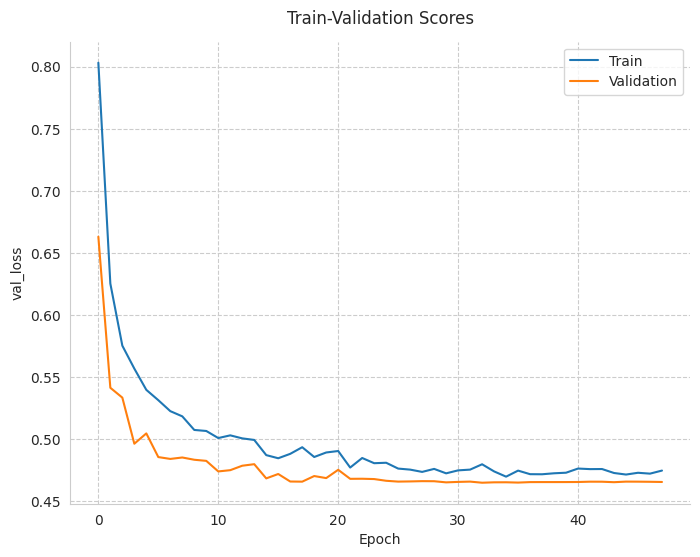

52/52 [==============================] - 1s 8ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


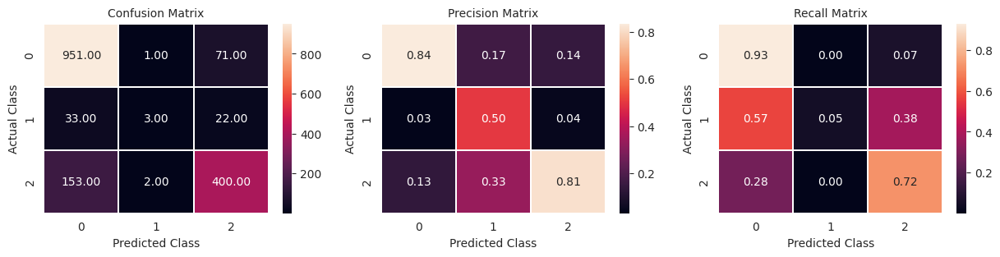


               precision    recall  f1-score   support

           0       0.84      0.93      0.88      1023
           1       0.50      0.05      0.09        58
           2       0.81      0.72      0.76       555

    accuracy                           0.83      1636
   macro avg       0.72      0.57      0.58      1636
weighted avg       0.82      0.83      0.81      1636

y_hat shape:(5271, 3)


Test log_loss: 0.46%

Running CV 22

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 43s 46ms/step - loss: 0.8300 - auc_pr: 0.7613 - val_loss: 0.6228 - val_auc_pr: 0.8114 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 6s 30ms/step - loss: 0.6109 - auc_pr: 0.8302 - val_loss: 0.5392 - val_auc_pr: 0.8569 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 6s 29ms/step - loss: 0.5736 - auc_pr: 0.8478 - val_loss: 0.5135 - val_auc_pr: 0.8800 - lr: 5.0000e-04
Epoch 4/200
205/205 [==============================] - 6s 29ms/step - loss: 0.5574 - auc_pr: 0.8542 - val_loss: 0.5100 - val_auc_pr: 0.8813 - lr: 5.0000e-04
Epoch 5/200
205/205 [==============================] - 6s 27ms/step - loss: 0.5456 - auc_pr: 0.8558 - val_loss: 0.5158 - val_auc_pr: 0.8831 - lr: 5.0000e-04
Epoch 6/200
205/205 [==============================] - 6s 29ms/step - loss: 0.5283 - auc_pr: 0.8625 - val_loss: 0.4952 - 

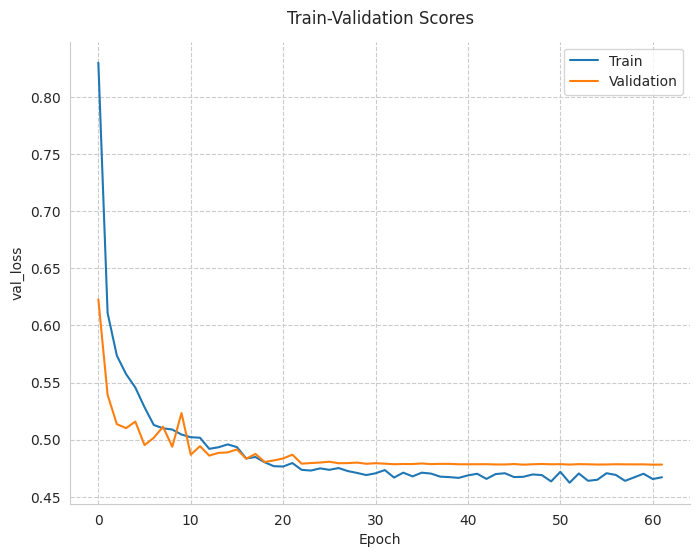

52/52 [==============================] - 1s 9ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


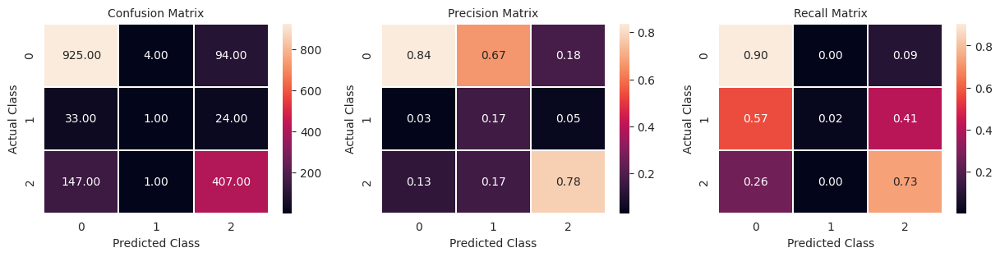


               precision    recall  f1-score   support

           0       0.84      0.90      0.87      1023
           1       0.17      0.02      0.03        58
           2       0.78      0.73      0.75       555

    accuracy                           0.81      1636
   macro avg       0.59      0.55      0.55      1636
weighted avg       0.79      0.81      0.80      1636

y_hat shape:(5271, 3)


Test log_loss: 0.48%

Running CV 23

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 40s 43ms/step - loss: 0.8060 - auc_pr: 0.7686 - val_loss: 0.6137 - val_auc_pr: 0.8059 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 6s 27ms/step - loss: 0.6037 - auc_pr: 0.8360 - val_loss: 0.5483 - val_auc_pr: 0.8469 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 5s 26ms/step - loss: 0.5712 - auc_pr: 0.8503 - val_loss: 0.5766 - val_auc_pr: 0.8321 - lr: 5.0000e-04
Epoch 4/200
205/205 [==============================] - 6s 27ms/step - loss: 0.5532 - auc_pr: 0.8543 - val_loss: 0.5350 - val_auc_pr: 0.8636 - lr: 5.0000e-04
Epoch 5/200
205/205 [==============================] - 6s 28ms/step - loss: 0.5295 - auc_pr: 0.8638 - val_loss: 0.5121 - val_auc_pr: 0.8706 - lr: 5.0000e-04
Epoch 6/200
205/205 [==============================] - 5s 26ms/step - loss: 0.5218 - auc_pr: 0.8666 - val_loss: 0.5449 - 

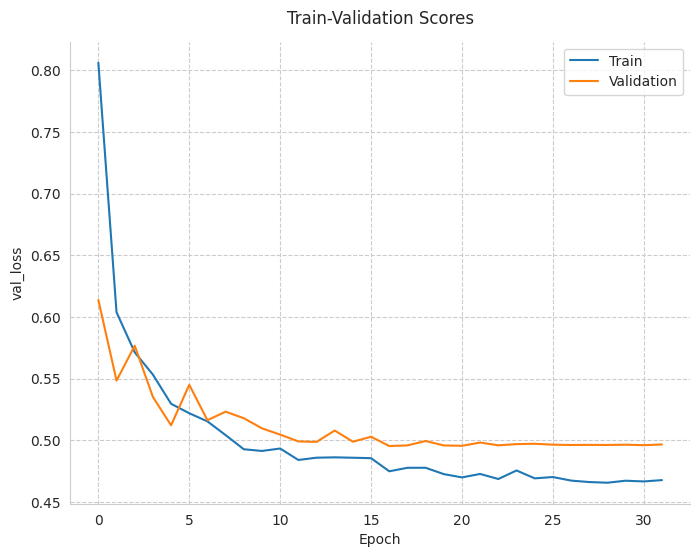

52/52 [==============================] - 1s 9ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


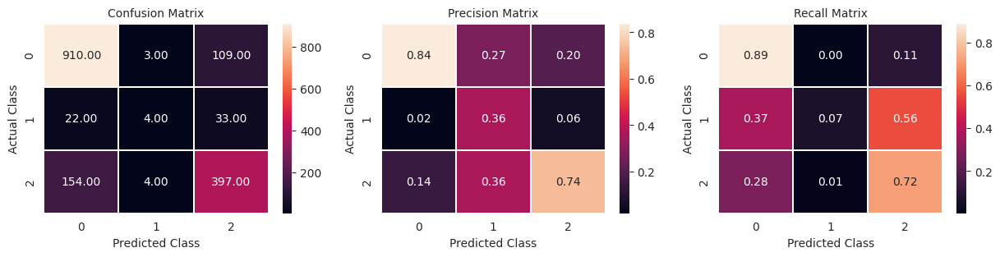


               precision    recall  f1-score   support

           0       0.84      0.89      0.86      1022
           1       0.36      0.07      0.11        59
           2       0.74      0.72      0.73       555

    accuracy                           0.80      1636
   macro avg       0.65      0.56      0.57      1636
weighted avg       0.79      0.80      0.79      1636

y_hat shape:(5271, 3)


Test log_loss: 0.5%

Running CV 24

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 40s 50ms/step - loss: 0.7799 - auc_pr: 0.7746 - val_loss: 0.6242 - val_auc_pr: 0.8109 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 6s 28ms/step - loss: 0.6090 - auc_pr: 0.8356 - val_loss: 0.6582 - val_auc_pr: 0.7979 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 6s 29ms/step - loss: 0.5607 - auc_pr: 0.8504 - val_loss: 0.5063 - val_auc_pr: 0.8769 - lr: 5.0000e-04
Epoch 4/200
205/205 [==============================] - 6s 28ms/step - loss: 0.5535 - auc_pr: 0.8558 - val_loss: 0.5340 - val_auc_pr: 0.8649 - lr: 5.0000e-04
Epoch 5/200
205/205 [==============================] - 6s 28ms/step - loss: 0.5401 - auc_pr: 0.8589 - val_loss: 0.5148 - val_auc_pr: 0.8759 - lr: 5.0000e-04
Epoch 6/200
205/205 [==============================] - 6s 27ms/step - loss: 0.5260 - auc_pr: 0.8660 - val_loss: 0.5210 - v

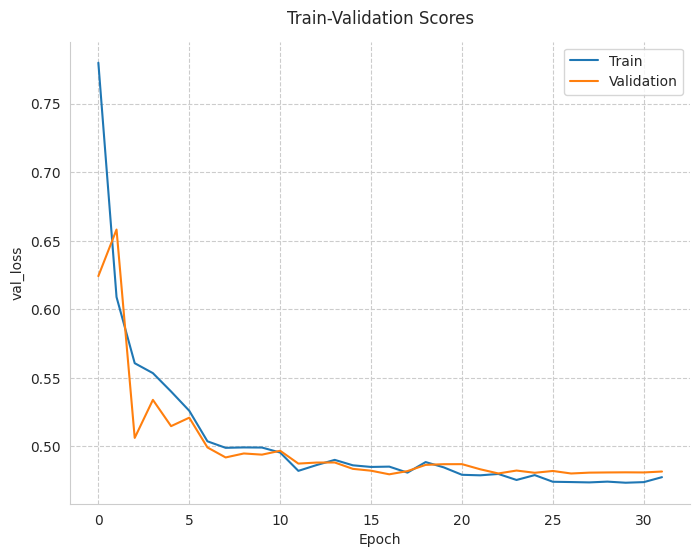

52/52 [==============================] - 1s 8ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


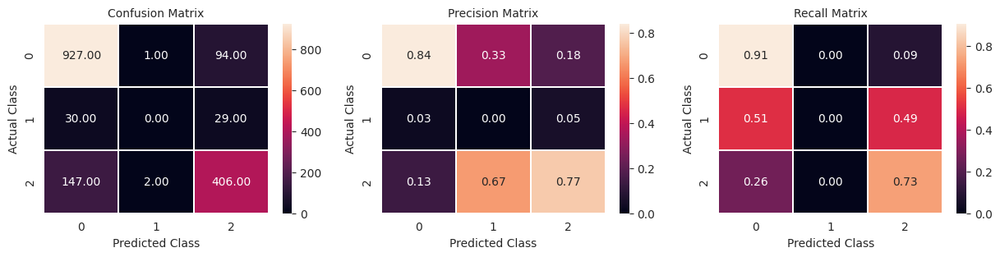


               precision    recall  f1-score   support

           0       0.84      0.91      0.87      1022
           1       0.00      0.00      0.00        59
           2       0.77      0.73      0.75       555

    accuracy                           0.81      1636
   macro avg       0.54      0.55      0.54      1636
weighted avg       0.78      0.81      0.80      1636

y_hat shape:(5271, 3)


Test log_loss: 0.48%

Running CV 25

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 39s 42ms/step - loss: 0.8080 - auc_pr: 0.7753 - val_loss: 0.7247 - val_auc_pr: 0.7219 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 6s 27ms/step - loss: 0.6331 - auc_pr: 0.8318 - val_loss: 0.5625 - val_auc_pr: 0.8433 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 6s 29ms/step - loss: 0.5796 - auc_pr: 0.8461 - val_loss: 0.5591 - val_auc_pr: 0.8528 - lr: 5.0000e-04
Epoch 4/200
205/205 [==============================] - 6s 29ms/step - loss: 0.5559 - auc_pr: 0.8557 - val_loss: 0.5097 - val_auc_pr: 0.8778 - lr: 5.0000e-04
Epoch 5/200
205/205 [==============================] - 5s 26ms/step - loss: 0.5371 - auc_pr: 0.8628 - val_loss: 0.5555 - val_auc_pr: 0.8557 - lr: 5.0000e-04
Epoch 6/200
205/205 [==============================] - 6s 28ms/step - loss: 0.5290 - auc_pr: 0.8643 - val_loss: 0.4963 - 

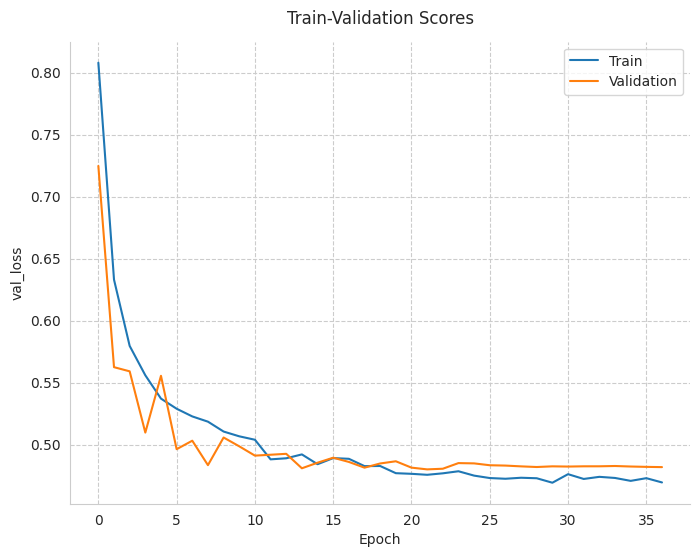

52/52 [==============================] - 1s 8ms/step
(1637,) (1637, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


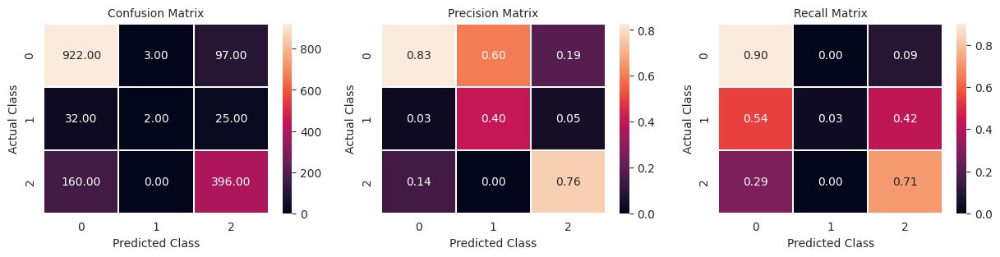


               precision    recall  f1-score   support

           0       0.83      0.90      0.86      1022
           1       0.40      0.03      0.06        59
           2       0.76      0.71      0.74       556

    accuracy                           0.81      1637
   macro avg       0.66      0.55      0.55      1637
weighted avg       0.79      0.81      0.79      1637

y_hat shape:(5271, 3)


Test log_loss: 0.48%

Running CV 26

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 36s 41ms/step - loss: 0.8245 - auc_pr: 0.7672 - val_loss: 0.7120 - val_auc_pr: 0.7386 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 5s 26ms/step - loss: 0.6344 - auc_pr: 0.8290 - val_loss: 0.5996 - val_auc_pr: 0.8126 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 5s 25ms/step - loss: 0.5852 - auc_pr: 0.8447 - val_loss: 0.5365 - val_auc_pr: 0.8713 - lr: 5.0000e-04
Epoch 4/200
205/205 [==============================] - 5s 26ms/step - loss: 0.5642 - auc_pr: 0.8529 - val_loss: 0.5226 - val_auc_pr: 0.8715 - lr: 5.0000e-04
Epoch 5/200
205/205 [==============================] - 8s 37ms/step - loss: 0.5398 - auc_pr: 0.8620 - val_loss: 0.4964 - val_auc_pr: 0.8816 - lr: 5.0000e-04
Epoch 6/200
205/205 [==============================] - 5s 26ms/step - loss: 0.5238 - auc_pr: 0.8687 - val_loss: 0.5052 - 

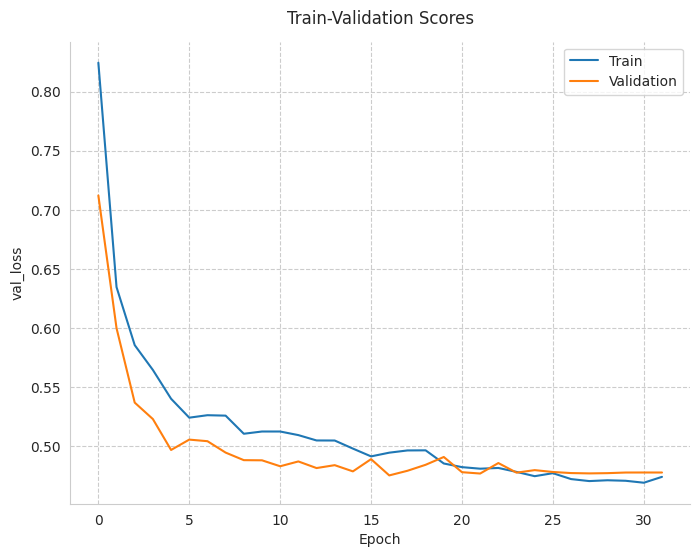

52/52 [==============================] - 1s 9ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


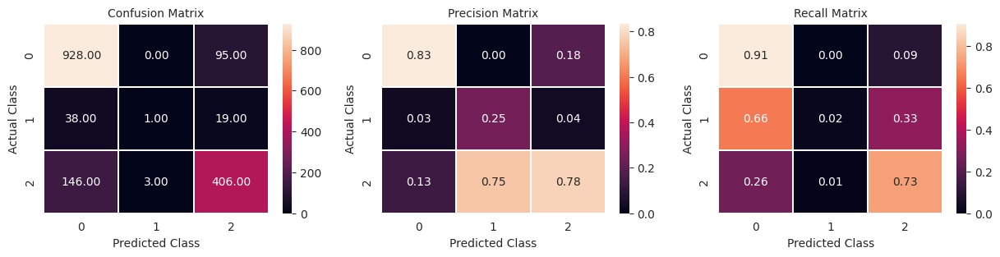


               precision    recall  f1-score   support

           0       0.83      0.91      0.87      1023
           1       0.25      0.02      0.03        58
           2       0.78      0.73      0.76       555

    accuracy                           0.82      1636
   macro avg       0.62      0.55      0.55      1636
weighted avg       0.80      0.82      0.80      1636

y_hat shape:(5271, 3)


Test log_loss: 0.47%

Running CV 27

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 44s 46ms/step - loss: 0.8120 - auc_pr: 0.7666 - val_loss: 0.5647 - val_auc_pr: 0.8404 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 6s 29ms/step - loss: 0.6198 - auc_pr: 0.8262 - val_loss: 0.5445 - val_auc_pr: 0.8616 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 6s 28ms/step - loss: 0.5730 - auc_pr: 0.8510 - val_loss: 0.5216 - val_auc_pr: 0.8705 - lr: 5.0000e-04
Epoch 4/200
205/205 [==============================] - 6s 31ms/step - loss: 0.5539 - auc_pr: 0.8562 - val_loss: 0.5074 - val_auc_pr: 0.8770 - lr: 5.0000e-04
Epoch 5/200
205/205 [==============================] - 6s 28ms/step - loss: 0.5443 - auc_pr: 0.8580 - val_loss: 0.4916 - val_auc_pr: 0.8837 - lr: 5.0000e-04
Epoch 6/200
205/205 [==============================] - 6s 28ms/step - loss: 0.5310 - auc_pr: 0.8629 - val_loss: 0.5057 - 

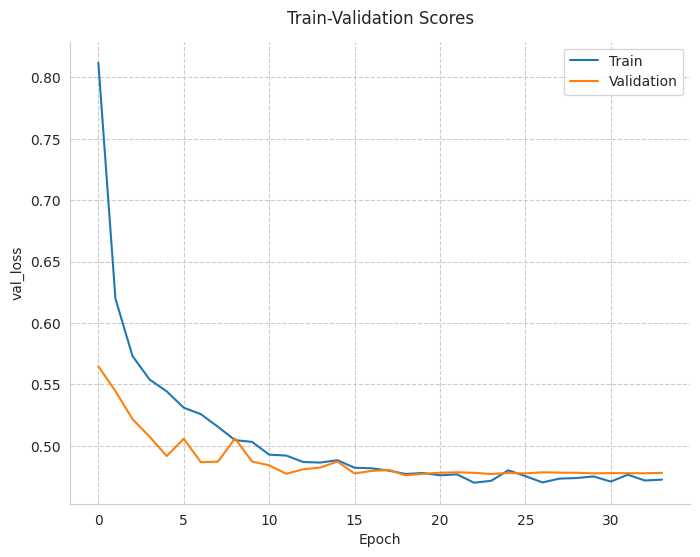

52/52 [==============================] - 1s 9ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


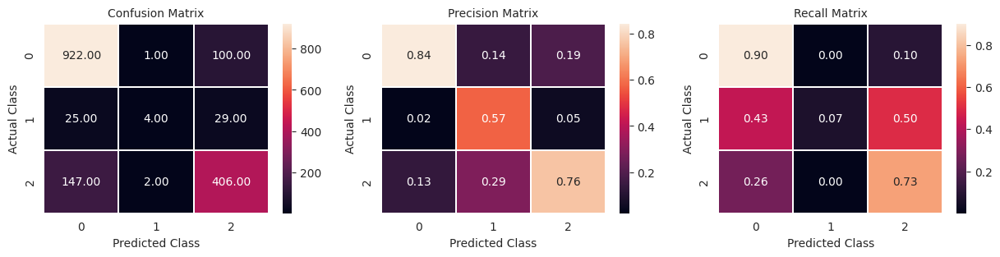


               precision    recall  f1-score   support

           0       0.84      0.90      0.87      1023
           1       0.57      0.07      0.12        58
           2       0.76      0.73      0.74       555

    accuracy                           0.81      1636
   macro avg       0.72      0.57      0.58      1636
weighted avg       0.80      0.81      0.80      1636

y_hat shape:(5271, 3)


Test log_loss: 0.48%

Running CV 28

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 38s 46ms/step - loss: 0.8034 - auc_pr: 0.7713 - val_loss: 0.6609 - val_auc_pr: 0.7868 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 6s 28ms/step - loss: 0.6073 - auc_pr: 0.8396 - val_loss: 0.6244 - val_auc_pr: 0.7976 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 6s 30ms/step - loss: 0.5703 - auc_pr: 0.8486 - val_loss: 0.5672 - val_auc_pr: 0.8429 - lr: 5.0000e-04
Epoch 4/200
205/205 [==============================] - 6s 27ms/step - loss: 0.5458 - auc_pr: 0.8634 - val_loss: 0.5647 - val_auc_pr: 0.8548 - lr: 5.0000e-04
Epoch 5/200
205/205 [==============================] - 6s 28ms/step - loss: 0.5333 - auc_pr: 0.8649 - val_loss: 0.5576 - val_auc_pr: 0.8562 - lr: 5.0000e-04
Epoch 6/200
205/205 [==============================] - 6s 28ms/step - loss: 0.5267 - auc_pr: 0.8687 - val_loss: 0.5412 - 

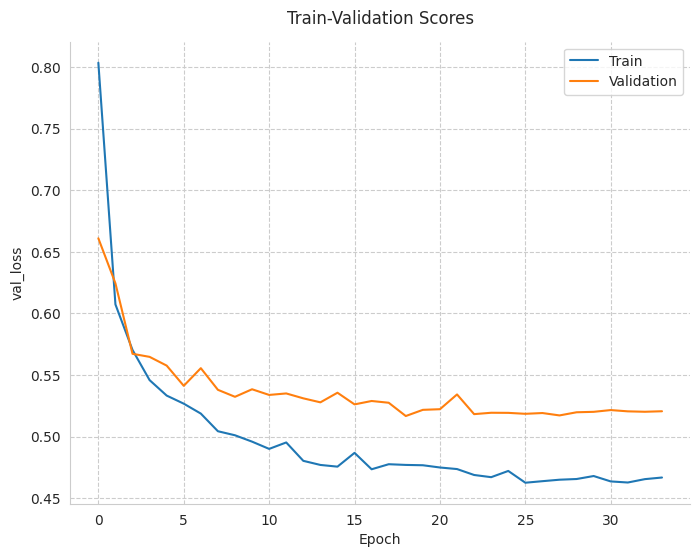

52/52 [==============================] - 1s 7ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


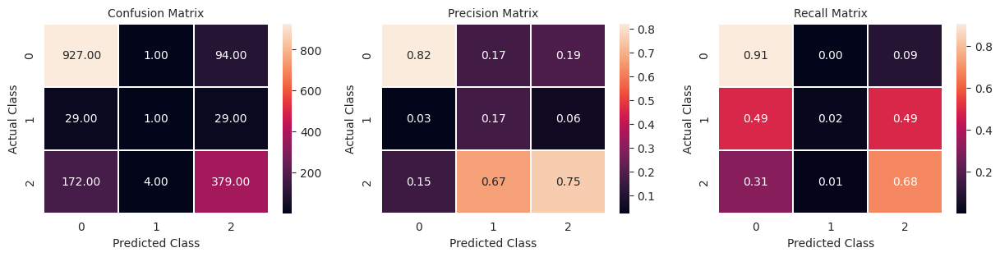


               precision    recall  f1-score   support

           0       0.82      0.91      0.86      1022
           1       0.17      0.02      0.03        59
           2       0.75      0.68      0.72       555

    accuracy                           0.80      1636
   macro avg       0.58      0.54      0.54      1636
weighted avg       0.78      0.80      0.78      1636

y_hat shape:(5271, 3)


Test log_loss: 0.52%

Running CV 29

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 42s 45ms/step - loss: 0.8330 - auc_pr: 0.7562 - val_loss: 0.6137 - val_auc_pr: 0.8197 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 6s 29ms/step - loss: 0.6165 - auc_pr: 0.8337 - val_loss: 0.5526 - val_auc_pr: 0.8480 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 6s 30ms/step - loss: 0.5825 - auc_pr: 0.8448 - val_loss: 0.5062 - val_auc_pr: 0.8734 - lr: 5.0000e-04
Epoch 4/200
205/205 [==============================] - 6s 27ms/step - loss: 0.5580 - auc_pr: 0.8539 - val_loss: 0.5349 - val_auc_pr: 0.8639 - lr: 5.0000e-04
Epoch 5/200
205/205 [==============================] - 6s 27ms/step - loss: 0.5438 - auc_pr: 0.8583 - val_loss: 0.5075 - val_auc_pr: 0.8812 - lr: 5.0000e-04
Epoch 6/200
205/205 [==============================] - 6s 29ms/step - loss: 0.5236 - auc_pr: 0.8670 - val_loss: 0.5029 - 

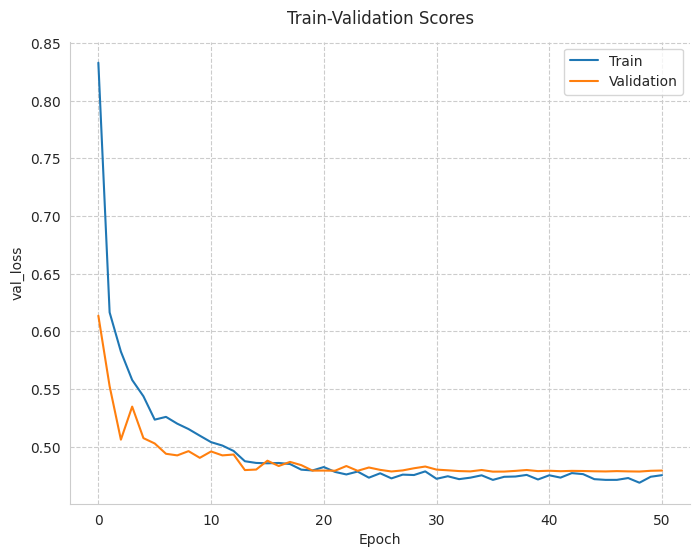

52/52 [==============================] - 1s 8ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


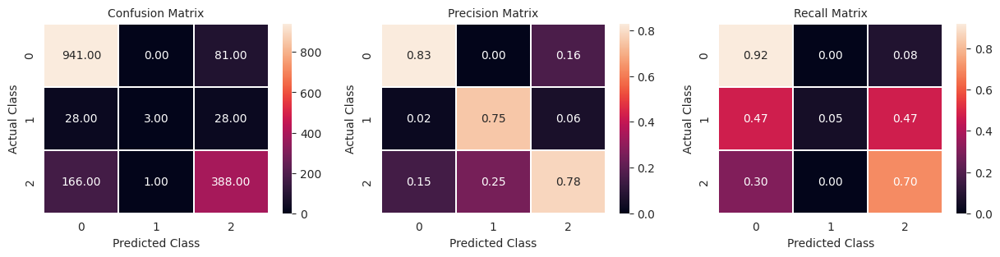


               precision    recall  f1-score   support

           0       0.83      0.92      0.87      1022
           1       0.75      0.05      0.10        59
           2       0.78      0.70      0.74       555

    accuracy                           0.81      1636
   macro avg       0.79      0.56      0.57      1636
weighted avg       0.81      0.81      0.80      1636

y_hat shape:(5271, 3)


Test log_loss: 0.48%

Running CV 30

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 41s 44ms/step - loss: 0.8078 - auc_pr: 0.7612 - val_loss: 0.6481 - val_auc_pr: 0.7857 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 6s 29ms/step - loss: 0.6168 - auc_pr: 0.8322 - val_loss: 0.5504 - val_auc_pr: 0.8579 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 6s 28ms/step - loss: 0.5901 - auc_pr: 0.8443 - val_loss: 0.5074 - val_auc_pr: 0.8780 - lr: 5.0000e-04
Epoch 4/200
205/205 [==============================] - 6s 29ms/step - loss: 0.5563 - auc_pr: 0.8537 - val_loss: 0.4941 - val_auc_pr: 0.8821 - lr: 5.0000e-04
Epoch 5/200
205/205 [==============================] - 6s 30ms/step - loss: 0.5388 - auc_pr: 0.8638 - val_loss: 0.4884 - val_auc_pr: 0.8848 - lr: 5.0000e-04
Epoch 6/200
205/205 [==============================] - 6s 28ms/step - loss: 0.5273 - auc_pr: 0.8635 - val_loss: 0.4922 - 

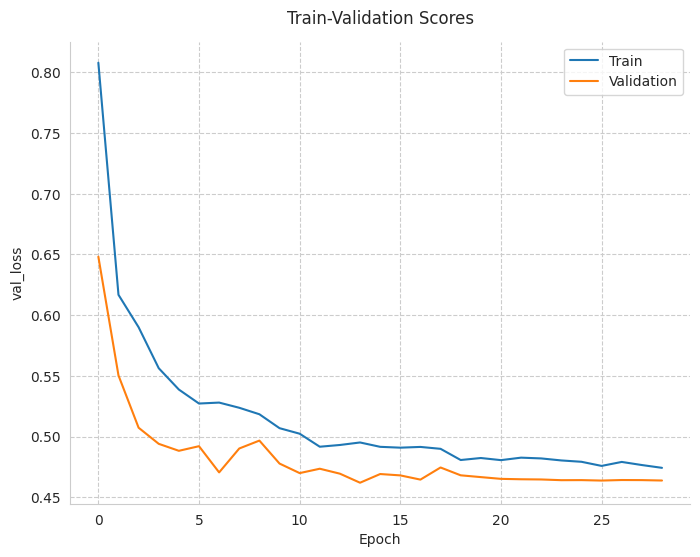

52/52 [==============================] - 1s 8ms/step
(1637,) (1637, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


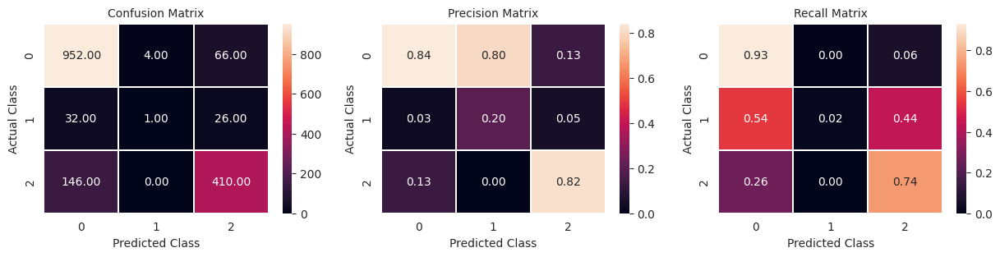


               precision    recall  f1-score   support

           0       0.84      0.93      0.88      1022
           1       0.20      0.02      0.03        59
           2       0.82      0.74      0.78       556

    accuracy                           0.83      1637
   macro avg       0.62      0.56      0.56      1637
weighted avg       0.81      0.83      0.82      1637

y_hat shape:(5271, 3)


Test log_loss: 0.46%

Running CV 31

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 42s 45ms/step - loss: 0.8165 - auc_pr: 0.7593 - val_loss: 0.6888 - val_auc_pr: 0.7675 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 6s 28ms/step - loss: 0.6161 - auc_pr: 0.8304 - val_loss: 0.5764 - val_auc_pr: 0.8379 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 6s 29ms/step - loss: 0.5731 - auc_pr: 0.8482 - val_loss: 0.5367 - val_auc_pr: 0.8539 - lr: 5.0000e-04
Epoch 4/200
205/205 [==============================] - 6s 28ms/step - loss: 0.5558 - auc_pr: 0.8565 - val_loss: 0.5178 - val_auc_pr: 0.8688 - lr: 5.0000e-04
Epoch 5/200
205/205 [==============================] - 6s 28ms/step - loss: 0.5476 - auc_pr: 0.8586 - val_loss: 0.5082 - val_auc_pr: 0.8713 - lr: 5.0000e-04
Epoch 6/200
205/205 [==============================] - 5s 25ms/step - loss: 0.5350 - auc_pr: 0.8620 - val_loss: 0.5119 - 

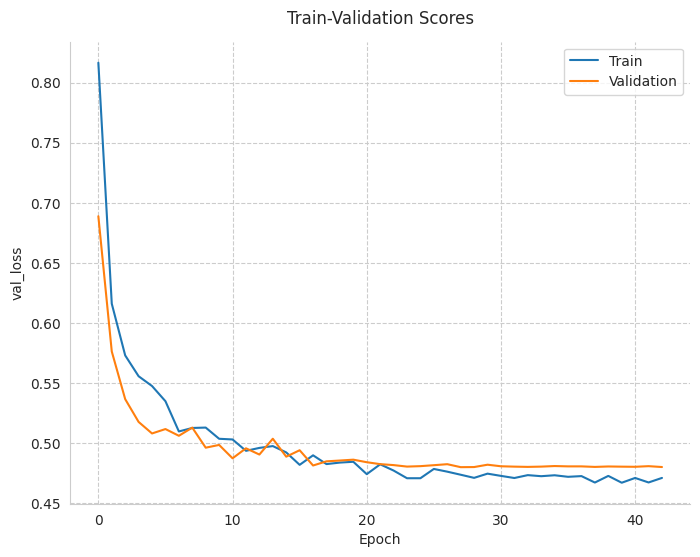

52/52 [==============================] - 1s 8ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


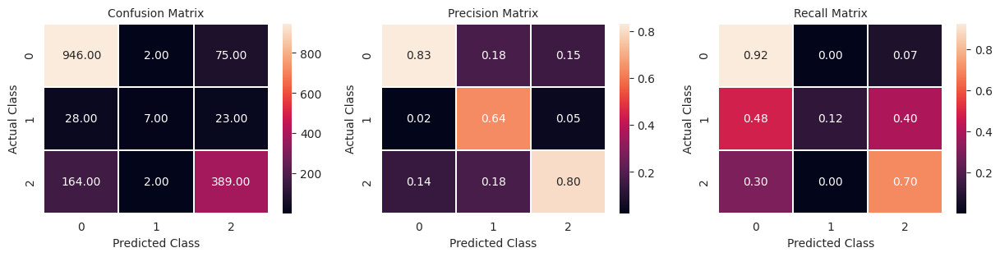


               precision    recall  f1-score   support

           0       0.83      0.92      0.88      1023
           1       0.64      0.12      0.20        58
           2       0.80      0.70      0.75       555

    accuracy                           0.82      1636
   macro avg       0.76      0.58      0.61      1636
weighted avg       0.81      0.82      0.81      1636

y_hat shape:(5271, 3)


Test log_loss: 0.48%

Running CV 32

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 36s 39ms/step - loss: 0.8182 - auc_pr: 0.7684 - val_loss: 0.6223 - val_auc_pr: 0.8182 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 5s 24ms/step - loss: 0.6154 - auc_pr: 0.8307 - val_loss: 0.5607 - val_auc_pr: 0.8609 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 8s 37ms/step - loss: 0.5764 - auc_pr: 0.8480 - val_loss: 0.5177 - val_auc_pr: 0.8749 - lr: 5.0000e-04
Epoch 4/200
205/205 [==============================] - 5s 25ms/step - loss: 0.5573 - auc_pr: 0.8535 - val_loss: 0.5290 - val_auc_pr: 0.8728 - lr: 5.0000e-04
Epoch 5/200
205/205 [==============================] - 5s 25ms/step - loss: 0.5375 - auc_pr: 0.8606 - val_loss: 0.5488 - val_auc_pr: 0.8629 - lr: 5.0000e-04
Epoch 6/200
205/205 [==============================] - 6s 29ms/step - loss: 0.5326 - auc_pr: 0.8631 - val_loss: 0.5166 - 

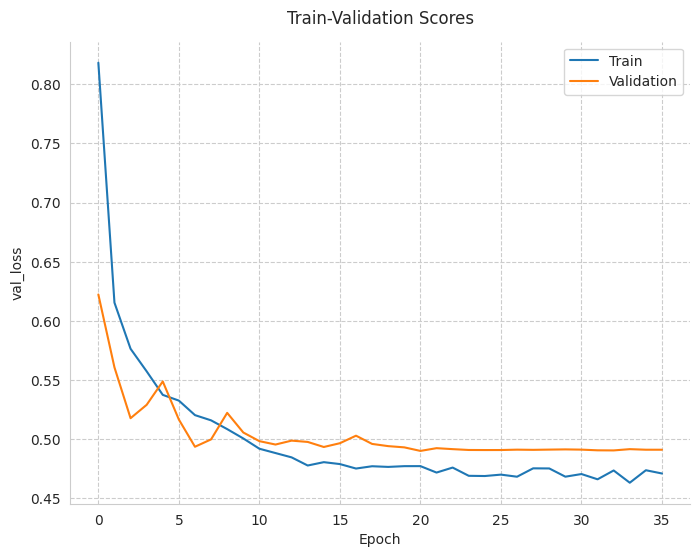

52/52 [==============================] - 1s 8ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


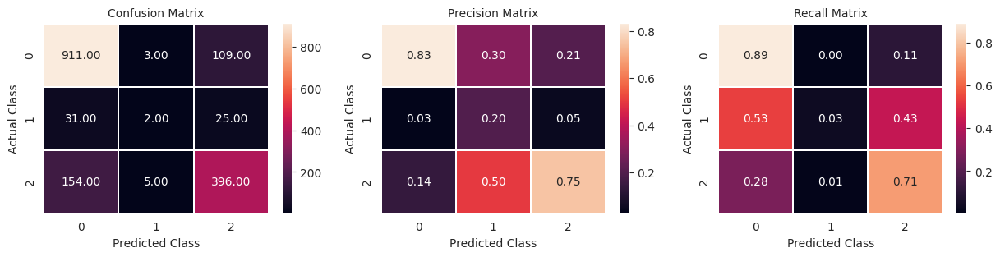


               precision    recall  f1-score   support

           0       0.83      0.89      0.86      1023
           1       0.20      0.03      0.06        58
           2       0.75      0.71      0.73       555

    accuracy                           0.80      1636
   macro avg       0.59      0.55      0.55      1636
weighted avg       0.78      0.80      0.79      1636

y_hat shape:(5271, 3)


Test log_loss: 0.49%

Running CV 33

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 46s 49ms/step - loss: 0.7966 - auc_pr: 0.7646 - val_loss: 0.6091 - val_auc_pr: 0.8258 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 6s 28ms/step - loss: 0.6228 - auc_pr: 0.8285 - val_loss: 0.5670 - val_auc_pr: 0.8410 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 6s 27ms/step - loss: 0.5870 - auc_pr: 0.8415 - val_loss: 0.5407 - val_auc_pr: 0.8596 - lr: 5.0000e-04
Epoch 4/200
205/205 [==============================] - 6s 27ms/step - loss: 0.5479 - auc_pr: 0.8585 - val_loss: 0.5382 - val_auc_pr: 0.8590 - lr: 5.0000e-04
Epoch 5/200
205/205 [==============================] - 5s 25ms/step - loss: 0.5325 - auc_pr: 0.8635 - val_loss: 0.5437 - val_auc_pr: 0.8573 - lr: 5.0000e-04
Epoch 6/200
205/205 [==============================] - 6s 28ms/step - loss: 0.5282 - auc_pr: 0.8666 - val_loss: 0.5351 - 

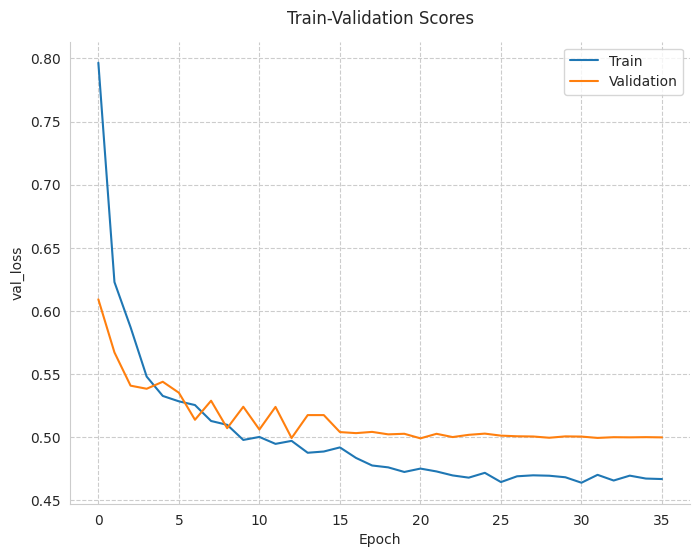

52/52 [==============================] - 1s 8ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


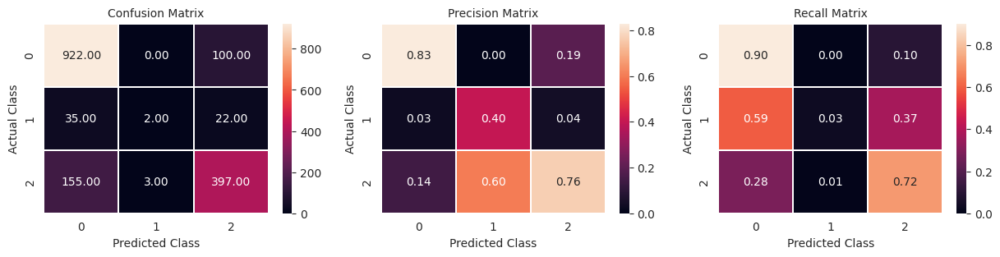


               precision    recall  f1-score   support

           0       0.83      0.90      0.86      1022
           1       0.40      0.03      0.06        59
           2       0.76      0.72      0.74       555

    accuracy                           0.81      1636
   macro avg       0.66      0.55      0.56      1636
weighted avg       0.79      0.81      0.79      1636

y_hat shape:(5271, 3)


Test log_loss: 0.5%

Running CV 34

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 38s 43ms/step - loss: 0.8073 - auc_pr: 0.7665 - val_loss: 0.6482 - val_auc_pr: 0.7740 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 6s 30ms/step - loss: 0.6124 - auc_pr: 0.8344 - val_loss: 0.5763 - val_auc_pr: 0.8293 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 6s 28ms/step - loss: 0.5735 - auc_pr: 0.8495 - val_loss: 0.5492 - val_auc_pr: 0.8585 - lr: 5.0000e-04
Epoch 4/200
205/205 [==============================] - 6s 29ms/step - loss: 0.5404 - auc_pr: 0.8640 - val_loss: 0.5478 - val_auc_pr: 0.8695 - lr: 5.0000e-04
Epoch 5/200
205/205 [==============================] - 7s 34ms/step - loss: 0.5344 - auc_pr: 0.8638 - val_loss: 0.5432 - val_auc_pr: 0.8647 - lr: 5.0000e-04
Epoch 6/200
205/205 [==============================] - 6s 28ms/step - loss: 0.5195 - auc_pr: 0.8677 - val_loss: 0.5488 - v

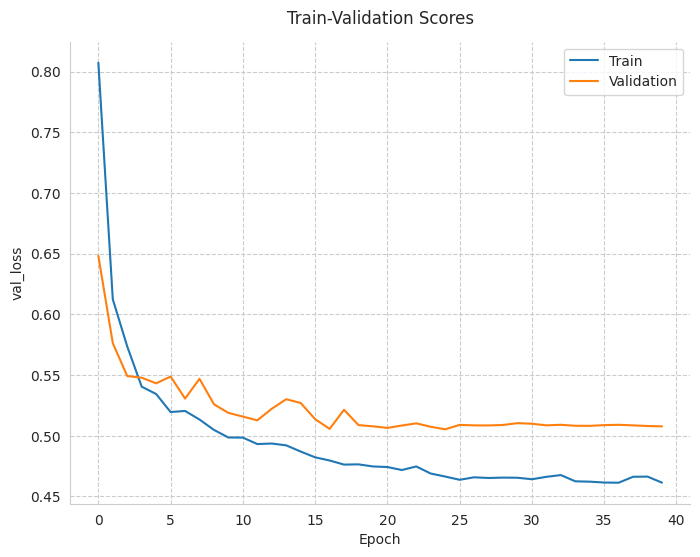

52/52 [==============================] - 1s 8ms/step
(1636,) (1636, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


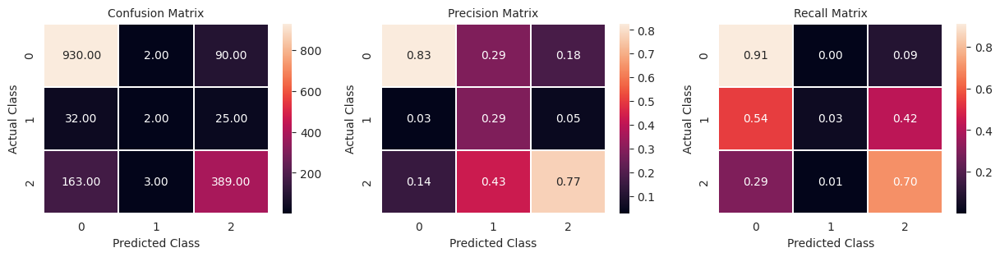


               precision    recall  f1-score   support

           0       0.83      0.91      0.87      1022
           1       0.29      0.03      0.06        59
           2       0.77      0.70      0.73       555

    accuracy                           0.81      1636
   macro avg       0.63      0.55      0.55      1636
weighted avg       0.79      0.81      0.79      1636

y_hat shape:(5271, 3)


Test log_loss: 0.51%

Running CV 35

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 44s 47ms/step - loss: 0.8196 - auc_pr: 0.7640 - val_loss: 0.6424 - val_auc_pr: 0.7983 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 6s 31ms/step - loss: 0.6126 - auc_pr: 0.8352 - val_loss: 0.5706 - val_auc_pr: 0.8414 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 6s 31ms/step - loss: 0.5707 - auc_pr: 0.8477 - val_loss: 0.5467 - val_auc_pr: 0.8616 - lr: 5.0000e-04
Epoch 4/200
205/205 [==============================] - 6s 27ms/step - loss: 0.5569 - auc_pr: 0.8544 - val_loss: 0.5763 - val_auc_pr: 0.8399 - lr: 5.0000e-04
Epoch 5/200
205/205 [==============================] - 6s 30ms/step - loss: 0.5381 - auc_pr: 0.8615 - val_loss: 0.5230 - val_auc_pr: 0.8761 - lr: 5.0000e-04
Epoch 6/200
205/205 [==============================] - 6s 30ms/step - loss: 0.5280 - auc_pr: 0.8653 - val_loss: 0.5229 - 

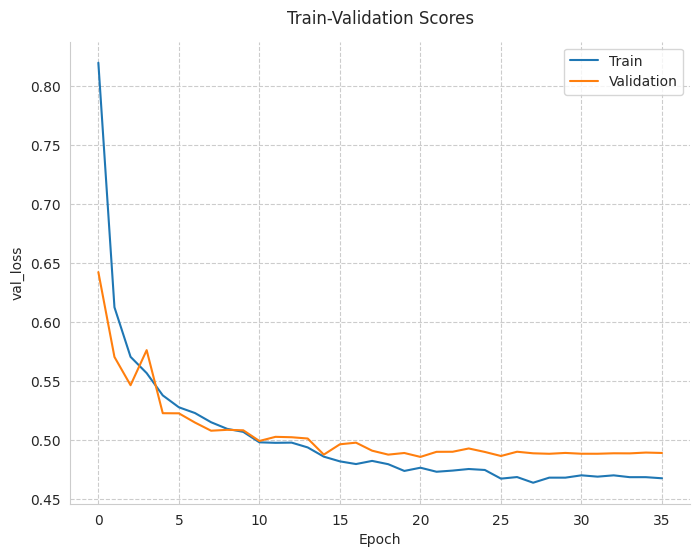

52/52 [==============================] - 1s 9ms/step
(1637,) (1637, 1)
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


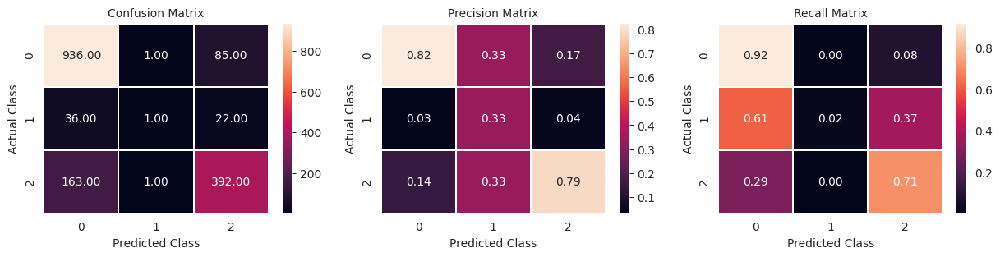


               precision    recall  f1-score   support

           0       0.82      0.92      0.87      1022
           1       0.33      0.02      0.03        59
           2       0.79      0.71      0.74       556

    accuracy                           0.81      1637
   macro avg       0.65      0.55      0.55      1637
weighted avg       0.79      0.81      0.80      1637

y_hat shape:(5271, 3)


Test log_loss: 0.49%

Running CV 36

Adapting Features Space....
Start training the model...
Epoch 1/200
205/205 [==============================] - 35s 40ms/step - loss: 0.8161 - auc_pr: 0.7682 - val_loss: 0.5837 - val_auc_pr: 0.8254 - lr: 5.0000e-04
Epoch 2/200
205/205 [==============================] - 5s 24ms/step - loss: 0.6162 - auc_pr: 0.8322 - val_loss: 0.6264 - val_auc_pr: 0.8037 - lr: 5.0000e-04
Epoch 3/200
205/205 [==============================] - 6s 28ms/step - loss: 0.5795 - auc_pr: 0.8464 - val_loss: 0.5652 - val_auc_pr: 0.8444 - lr: 5.0000e-04
Epoch 4/200
204/205 [============================>.] - ETA: 0s - loss: 0.5641 - auc_pr: 0.8502

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.

Custom TB Handler failed, unregistering
ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.



Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py", line 3553, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-28-0e2368e2c890>", line 1, in <cell line: 1>
    test_results_df_C,test_results_df_CL,test_results_df_D, test_results_df = run_experiment(X_train,
  File "<ipython-input-27-2b38315af6f1>", line 96, in run_experiment
    history = model.fit(preprocessed_train_ds,
  File "/usr/local/lib/python3.10/dist-packages/keras/src/utils/traceback_utils.py", line 70, in error_handler
    raise e.with_traceback(filtered_tb) from None
  File "/usr/local/lib/python3.10/dist-packages/tensorflow/python/eager/execute.py", line 53, in quick_execute
    tensors = pywrap_tfe.TFE_Py_Execute(ctx._handle, device_name, op_name,
tensorflow.python.framework.errors_impl.NotFoundError: {{function_node __wrapped__SaveV2_dtypes_739_device_/job:localhost/replica:0/task:0/device:CPU:0}} /content/drive/MyD

In [ ]:
test_results_df_C,test_results_df_CL,test_results_df_D, test_results_df = run_experiment(X_train,
                                                                                         X_test,
                                                                                         input_format="dict",
                                                                                         experiment_name="model_DW_v0_no_upsampling",
                                                                                         splits=5, num_epochs=200,
                                                                                         batch_size=32)

In [ ]:
test_results_df

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.



Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py", line 3553, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-28-6f46990e02b9>", line 1, in <cell line: 1>
    test_results_df
NameError: name 'test_results_df' is not defined

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py", line 2099, in showtraceback
    stb = value._render_traceback_()
AttributeError: 'NameError' object has no attribute '_render_traceback_'

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/IPython/core/ultratb.py", line 1101, in get_records
    return _fixed_getinnerframes(etb, number_of_lines_of_context, tb_offset)
  File "/usr/local/lib/python3.10/dist-packages/IPython/core

In [ ]:
test_results_df.to_csv("DeepWide_v0_no_oversampling.csv")

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.



Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py", line 3553, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-28-3ef266a856cc>", line 1, in <cell line: 1>
    test_results_df.to_csv("DeepWide_v0_no_oversampling.csv")
NameError: name 'test_results_df' is not defined

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py", line 2099, in showtraceback
    stb = value._render_traceback_()
AttributeError: 'NameError' object has no attribute '_render_traceback_'

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/IPython/core/ultratb.py", line 1101, in get_records
    return _fixed_getinnerframes(etb, number_of_lines_of_context, tb_offset)
  File "/usr/local

**Recreate Results**

In [ ]:
experiment_name = "model_DW_v0"
folds = 36

test_results_df_C = pd.DataFrame(index=X_test.index, columns=list(range(folds)))
test_results_df_CL = pd.DataFrame(index=X_test.index, columns=list(range(folds)))
test_results_df_D = pd.DataFrame(index=X_test.index, columns=list(range(folds)))

test_results_df = pd.DataFrame(index=X_test.index, columns=["Status_C","Status_CL","Status_D"])

for i in range(folds):
  test_dataset = dataframe_to_dataset(X_test, batch_size=32, shuffle=False)
  feature_space = keras.models.load_model(f"{folders_nn+experiment_name}/CV_{i}/myfeaturespace_{experiment_name}.keras")
  preprocessed_test_ds = test_dataset.map(lambda x, y: (feature_space(x), y), num_parallel_calls=tf.data.AUTOTUNE).prefetch(tf.data.AUTOTUNE)

  model = tf.keras.saving.load_model(f'{folders_nn+experiment_name}/CV_{i}')

  y_hat = model.predict(preprocessed_test_ds)

  test_results_df_C.iloc[:,i] = y_hat[:,0]
  test_results_df_CL.iloc[:,i] = y_hat[:,1]
  test_results_df_D.iloc[:,i] = y_hat[:,2]


test_results_df_C["Mean"] = test_results_df_C.mean(axis=1)
test_results_df_CL["Mean"] = test_results_df_CL.mean(axis=1)
test_results_df_D["Mean"] = test_results_df_D.mean(axis=1)

test_results_df.loc[:,"Status_C"] = test_results_df_C["Mean"].values
test_results_df.loc[:,"Status_CL"] = test_results_df_CL["Mean"].values
test_results_df.loc[:,"Status_D"] = test_results_df_D["Mean"].values

165/165 [==============================] - 6s 10ms/step


In [ ]:
test_results_df

,Status_C,Status_CL,Status_D
0,0.682218,0.021731,0.296050
1,0.845891,0.049463,0.104647
2,0.046954,0.030720,0.922327
3,0.947294,0.006197,0.046508
4,0.713587,0.036996,0.249417
...,...,...,...
5266,0.851158,0.016465,0.132377
5267,0.925178,0.010472,0.064350
5268,0.817390,0.009510,0.173100
5269,0.983962,0.009467,0.006570


In [ ]:
test_results_df

,Status_C,Status_CL,Status_D
0,0.685789,0.020781,0.293429
1,0.834943,0.054916,0.110141
2,0.040396,0.028503,0.931100
3,0.946559,0.005940,0.047502
4,0.697088,0.036456,0.266455
...,...,...,...
5266,0.849489,0.015881,0.134631
5267,0.928901,0.010318,0.060781
5268,0.817649,0.009916,0.172436
5269,0.984299,0.009394,0.006306


In [ ]:
sub = pd.read_csv("sample_submission.csv", index_col=0)
sub.iloc[:,:] = test_results_df.values
sub.to_csv(f"Results/{experiment_name}.csv")

#### 6.2.2 Fit the Model - With OverSampling

In [52]:
def run_experiment(train, test_data_file, input_format="dict", experiment_name="model_baseline", splits=5, num_epochs=200, batch_size=32, n_repeats=8, rs=42):

  neg = 5112
  resampled_steps_per_epoch = int(np.ceil(2.0*neg/batch_size))

  skf = StratifiedKFold(n_splits=splits,
                        #n_repeats=n_repeats
                        #random_state=rs
                        )

  test_results_df_C = pd.DataFrame(index=test_data_file.index, columns=list(range(splits*n_repeats)))
  test_results_df_CL = pd.DataFrame(index=test_data_file.index, columns=list(range(splits*n_repeats)))
  test_results_df_D = pd.DataFrame(index=test_data_file.index, columns=list(range(splits*n_repeats)))

  test_results_df = pd.DataFrame(index=test_data_file.index, columns=["Status_C","Status_CL","Status_D"])

  all_logloss = []
  all_AUC_pr = []

  valid_pred = []

  for i, (train_index, valid_index) in enumerate(skf.split(X_train,strat_feature)):

    print(f"\nRunning CV {i}\n")
    ########################################################################## Prepare the Dataset:
    X_trn = train.iloc[train_index,:]
    X_val = train.iloc[valid_index,:]
    ####

    train_dataset = dataframe_to_dataset(X_trn, batch_size=batch_size, shuffle=True)
    valid_dataset = dataframe_to_dataset(X_val, batch_size=batch_size, shuffle=False)
    test_dataset = dataframe_to_dataset(X_test, batch_size=batch_size, shuffle=False)

    C_instances = X_trn[X_trn.Status_C==1]
    CL_instances = X_trn[X_trn.Status_CL==1]
    D_instances = X_trn[X_trn.Status_D==1]

    C_dataset = dataframe_to_dataset_class(C_instances,batch_size=1, shuffle=True)
    CL_dataset = dataframe_to_dataset_class(CL_instances,batch_size=1, shuffle=True)
    D_dataset = dataframe_to_dataset_class(D_instances,batch_size=1, shuffle=True)

    feature_space = FeatureSpace(
                                features={**{a:FeatureSpace.integer_categorical(num_oov_indices=1, output_mode="int") for a in cat_var},**{a:FeatureSpace.float_normalized() for a in num_var}},
                                # Specify feature cross with a custom crossing dim.
                                crosses=[FeatureSpace.cross(feature_names=("count_disease","bill_proh_binned"), crossing_dim=10, output_mode="int"),
                                        FeatureSpace.cross(feature_names=("Drug","Bilirubin_binned"), crossing_dim=5, output_mode="int")],
                                output_mode=input_format
                                )

    train_ds_with_no_labels = train_dataset.map(lambda x, *_: x)
    print("Adapting Features Space....")
    feature_space.adapt(train_ds_with_no_labels)

    preprocessed_train_ds = train_dataset.map(lambda x, y: (feature_space(x), y), num_parallel_calls=tf.data.AUTOTUNE).prefetch(tf.data.AUTOTUNE)
    preprocessed_valid_ds = valid_dataset.map(lambda x, y: (feature_space(x), y), num_parallel_calls=tf.data.AUTOTUNE).prefetch(tf.data.AUTOTUNE)
    preprocessed_test_ds = test_dataset.map(lambda x, y: (feature_space(x), y), num_parallel_calls=tf.data.AUTOTUNE).prefetch(tf.data.AUTOTUNE)

    preprocessed_train_C = C_dataset.map(lambda x, y: (feature_space(x), tf.squeeze(y)), num_parallel_calls=tf.data.AUTOTUNE).prefetch(tf.data.AUTOTUNE)
    preprocessed_train_CL = CL_dataset.map(lambda x, y: (feature_space(x), tf.squeeze(y)), num_parallel_calls=tf.data.AUTOTUNE).prefetch(tf.data.AUTOTUNE)
    preprocessed_train_D = D_dataset.map(lambda x, y: (feature_space(x), tf.squeeze(y)), num_parallel_calls=tf.data.AUTOTUNE).prefetch(tf.data.AUTOTUNE)

    resampled_ds = tf.data.Dataset.sample_from_datasets([preprocessed_train_C, preprocessed_train_CL, preprocessed_train_D], weights=[0.4, 0.2, 0.4])
    resampled_ds = resampled_ds.batch(batch_size=batch_size).prefetch(tf.data.AUTOTUNE)

    #################################################################### End of Dataset Preparation


    # Callbacks:
    early_stopping = tf.keras.callbacks.EarlyStopping(monitor="val_loss",
                                                      patience=15,
                                                      restore_best_weights=True,
                                                      start_from_epoch=5)

    reduce_on_plat = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss',
                                                          factor=0.5,
                                                          patience=3,
                                                          min_lr=0.000005)

    checkpoint_filepath = folders_nn + 'checkpoint/'
    Checkpoint = tf.keras.callbacks.ModelCheckpoint(filepath=checkpoint_filepath,
                                                    save_weights_only=True,
                                                    monitor="val_loss",
                                                    mode='min',
                                                    restore_best_weights=True,
                                                    start_from_epoch=5,
                                                    save_best_only=True)

    # Generate Model
    model = create_DW_model(feature_space,
                            name=experiment_name,
                            learning_rate = 0.0005,
                            gn_noise= 0.01,
                            dropout = 0.5,
                            units_0 = 256,
                            hidden_layers = 2,
                            units_1 = 256,
                            edense_wide = 6,
                            edense_deep = 6,
                            attention = 1,
                            activation = 'relu')

    print("Start training the model...")
    history = model.fit(resampled_ds,
                        epochs=num_epochs,
                        steps_per_epoch=resampled_steps_per_epoch,
                        callbacks=[early_stopping,Checkpoint,reduce_on_plat],
                        validation_data=preprocessed_valid_ds)
    print("Model training finished")

    model.load_weights(checkpoint_filepath)

    log_loss, AUC_pr = model.evaluate(preprocessed_valid_ds, verbose=0)

    plot_training_session(history)

    y_hat = model.predict(preprocessed_test_ds)
    eval = model.predict(preprocessed_valid_ds)

    eval_df = pd.DataFrame(columns=["prob_Status_C","prob_Status_CL","prob_Status_D"], index=valid_index, data=eval)
    valid_pred.append(eval_df)


    eval = eval.argmax(axis=1)
    y_validation = X_val[['Status_C', 'Status_CL', 'Status_D']].values
    #eval = tf.expand_dims(tf.math.argmax(eval,-1),axis=-1)
    target = tf.expand_dims(tf.math.argmax(y_validation,axis=1),axis=-1)
    print(eval.shape,target.shape)
    plot_confusion_matrix(target, eval, labels=[0,1,2])

    print("\n",classification_report(y_true=target, y_pred=eval))
    print(f"y_hat shape:{y_hat.shape}")

    test_results_df_C.iloc[:,i] = y_hat[:,0]
    test_results_df_CL.iloc[:,i] = y_hat[:,1]
    test_results_df_D.iloc[:,i] = y_hat[:,2]

    model.save(f'{folders_nn+experiment_name}/CV_{i}')
    feature_space.save(f"{folders_nn+experiment_name}/CV_{i}/myfeaturespace_{experiment_name}.keras")


    print(f"Test log_loss: {round(log_loss, 2)}%")
    all_logloss.append(round(log_loss, 3))
    all_AUC_pr.append(round(AUC_pr, 3))

  test_results_df_C["Mean"] = test_results_df_C.mean(axis=1)
  test_results_df_CL["Mean"] = test_results_df_CL.mean(axis=1)
  test_results_df_D["Mean"] = test_results_df_D.mean(axis=1)

  test_results_df.loc[:,"Status_C"] = test_results_df_C["Mean"].values
  test_results_df.loc[:,"Status_CL"] = test_results_df_CL["Mean"].values
  test_results_df.loc[:,"Status_D"] = test_results_df_D["Mean"].values

  valid_pred = pd.concat(valid_pred, axis=0)
  valid_pred.sort_index(inplace=True)

  print(f"All Valuation AUC_pr: {all_AUC_pr}")
  print(f"All Valuation lOGlOSS: {all_logloss}")

  return test_results_df_C,test_results_df_CL,test_results_df_D, test_results_df, valid_pred

In [53]:
test_results_df_C,test_results_df_CL,test_results_df_D, test_results_df, valid_pred = run_experiment(X_train,
                                                                                                      X_test,
                                                                                                      input_format="dict",
                                                                                                      experiment_name="model_DW_v0_upsampling",
                                                                                                      splits=5, num_epochs=200,
                                                                                                      batch_size=32,
                                                                                                      calibrate=True)


Running CV 0

Adapting Features Space....
Start training the model...
Epoch 1/200
320/320 [==============================] - 48s 44ms/step - loss: 0.9978 - auc_pr: 0.6487 - val_loss: 0.7080 - val_auc_pr: 0.7887 - lr: 5.0000e-04
Epoch 2/200
320/320 [==============================] - 11s 34ms/step - loss: 0.7971 - auc_pr: 0.7321 - val_loss: 0.6509 - val_auc_pr: 0.8053 - lr: 5.0000e-04
Epoch 3/200
320/320 [==============================] - 11s 33ms/step - loss: 0.7496 - auc_pr: 0.7544 - val_loss: 0.6815 - val_auc_pr: 0.7919 - lr: 5.0000e-04
Epoch 4/200
320/320 [==============================] - 11s 35ms/step - loss: 0.7271 - auc_pr: 0.7649 - val_loss: 0.5931 - val_auc_pr: 0.8351 - lr: 5.0000e-04
Epoch 5/200
320/320 [==============================] - 11s 34ms/step - loss: 0.7125 - auc_pr: 0.7720 - val_loss: 0.5980 - val_auc_pr: 0.8356 - lr: 5.0000e-04
Epoch 6/200
320/320 [==============================] - 11s 34ms/step - loss: 0.7008 - auc_pr: 0.7753 - val_loss: 0.6220 - val_auc_pr: 0.819

InvalidParameterError: ignored

In [49]:
#test_results_df.dropna(inplace=True)
#test_results_df.rename({"C":"Status_C","CL":"Status_CL","D":"Status_D"},inplace=True)
test_results_df

,Status_C,Status_CL,Status_D
0,0.531616,0.095368,0.373016
1,0.802204,0.051672,0.146124
2,0.027988,0.040475,0.931537
3,0.878745,0.032602,0.088653
4,0.660350,0.092889,0.246762
...,...,...,...
5266,0.699475,0.052706,0.247819
5267,0.890930,0.008845,0.100224
5268,0.794718,0.029462,0.175820
5269,0.795290,0.195492,0.009218


In [50]:
experiment_name="model_DW_v0_upsampling"

sub = pd.read_csv("sample_submission.csv", index_col=0)
sub.iloc[:,:] = test_results_df.values
sub.to_csv(f"Results/{experiment_name}.csv")
valid_pred.to_csv(f"Results/{experiment_name}_add_features.csv")

### 6.3 Random Forest

In [ ]:
X_train = pd.read_csv("new_train.csv", index_col=0)
X_test = pd.read_csv("new_test.csv", index_col=0)

#X_train["weights"] = X_train["Status"]
#X_test["weights"] = 1.0

strat_feature = X_train["Status"]

X_train.drop(columns=["id","Status_C","Status_CL","Status_D","min_class_feat_RF"],inplace=True)
X_test.drop(columns=["id","Status_C","Status_CL","Status_D","min_class_feat_RF"],inplace=True)

num_var = X_train.select_dtypes("float").columns
cat_var = X_train.select_dtypes("int").columns

X_train[num_var]=X_train[num_var].astype("float32")
X_train[cat_var]=X_train[cat_var].astype("int32")

X_test[num_var]=X_test[num_var].astype("float32")
X_test[cat_var]=X_test[cat_var].astype("int32")

X_train.Status = X_train.Status.replace({"C":0,"CL":1,"D":2})

X_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8181 entries, 0 to 311
Data columns (total 37 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Drug                            8181 non-null   int32  
 1   Sex                             8181 non-null   int32  
 2   Ascites                         8181 non-null   int32  
 3   Hepatomegaly                    8181 non-null   int32  
 4   Spiders                         8181 non-null   int32  
 5   Edema                           8181 non-null   int32  
 6   Bilirubin                       8181 non-null   float32
 7   Cholesterol                     8181 non-null   float32
 8   Albumin                         8181 non-null   float32
 9   Copper                          8181 non-null   float32
 10  Alk_Phos                        8181 non-null   float32
 11  SGOT                            8181 non-null   float32
 12  Tryglicerides                   818

In [ ]:
X_test.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5271 entries, 0 to 5270
Data columns (total 37 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Drug                            5271 non-null   int32  
 1   Sex                             5271 non-null   int32  
 2   Ascites                         5271 non-null   int32  
 3   Hepatomegaly                    5271 non-null   int32  
 4   Spiders                         5271 non-null   int32  
 5   Edema                           5271 non-null   int32  
 6   Bilirubin                       5271 non-null   float32
 7   Cholesterol                     5271 non-null   float32
 8   Albumin                         5271 non-null   float32
 9   Copper                          5271 non-null   float32
 10  Alk_Phos                        5271 non-null   float32
 11  SGOT                            5271 non-null   float32
 12  Tryglicerides                   52

**Check Unconstrained Model**

In [ ]:
X = X_train.drop(columns=["Status"]).copy()
y = X_train["Status"].copy()

In [ ]:
skf = RepeatedStratifiedKFold(n_splits=5, n_repeats=5, random_state=48)
clf = RandomForestClassifier()
cross_val_score(clf, X, y, n_jobs=-1, cv=skf, scoring="neg_log_loss").mean()

-0.5537257095861373

#### 6.3.1 **Optuna Optimization**

In [ ]:
skf = RepeatedStratifiedKFold(n_splits=5, n_repeats=5, random_state=48)

def objective(trial):
      n_estimators = trial.suggest_int('n_estimators', 400, 700)
      max_depth = trial.suggest_int('max_depth', 15, 19)
      min_samples_split = trial.suggest_int("min_samples_split", 2, 10)
      min_samples_leaf = trial.suggest_int("min_samples_leaf", 2, 5)
      max_samples = trial.suggest_uniform("max_samples", 0.6, 0.9)
      max_features = trial.suggest_int("max_features", 6, 10)

      clf = RandomForestClassifier(n_estimators=n_estimators, max_depth=max_depth,
                                   min_samples_split=min_samples_split, min_samples_leaf=min_samples_leaf,
                                   max_samples=max_samples)

      score = cross_val_score(clf, X, y, n_jobs=-1, cv=skf, scoring="neg_log_loss").mean()

      return score

In [ ]:
# Create study object
study = optuna.create_study(direction="maximize")

# Run optimization process
study.optimize(objective, n_trials=40, show_progress_bar=True)

[I 2023-12-15 12:00:41,811] A new study created in memory with name: no-name-0fe1f9db-5115-48e1-a2a6-6b42b8492d85


  0%|          | 0/40 [00:00<?, ?it/s]

[I 2023-12-15 12:01:21,017] Trial 0 finished with value: -0.46541699815026205 and parameters: {'n_estimators': 613, 'max_depth': 18, 'min_samples_split': 10, 'min_samples_leaf': 3, 'max_samples': 0.8457741418033721, 'max_features': 8}. Best is trial 0 with value: -0.46541699815026205.
[I 2023-12-15 12:01:46,498] Trial 1 finished with value: -0.46745549315543755 and parameters: {'n_estimators': 435, 'max_depth': 17, 'min_samples_split': 5, 'min_samples_leaf': 5, 'max_samples': 0.8379973853294556, 'max_features': 10}. Best is trial 0 with value: -0.46541699815026205.
[I 2023-12-15 12:02:16,245] Trial 2 finished with value: -0.4684073677429469 and parameters: {'n_estimators': 550, 'max_depth': 19, 'min_samples_split': 2, 'min_samples_leaf': 5, 'max_samples': 0.7350911652692331, 'max_features': 7}. Best is trial 0 with value: -0.46541699815026205.
[I 2023-12-15 12:02:41,722] Trial 3 finished with value: -0.4659623964883688 and parameters: {'n_estimators': 425, 'max_depth': 18, 'min_samples

In [ ]:
trial = study.best_trial
print('LogLoss: {}'.format(trial.value))
print("Best hyperparameters: {}".format(trial.params))

LogLoss: -0.4612960620430244
Best hyperparameters: {'n_estimators': 530, 'max_depth': 16, 'min_samples_split': 2, 'min_samples_leaf': 2, 'max_samples': 0.8691077199062475, 'max_features': 6}


In [ ]:
trial = study.best_trial
print('LogLoss: {}'.format(trial.value))
print("Best hyperparameters: {}".format(trial.params))

LogLoss: -0.4618806081560918
Best hyperparameters: {'n_estimators': 539, 'max_depth': 17, 'min_samples_split': 2, 'min_samples_leaf': 2, 'max_samples': 0.8249441730824305}


In [ ]:
# Print best trial and best hyperparameters
print("Best trial:", study.best_trial)
print("Best hyperparameters:", study.best_params)

Best trial: FrozenTrial(number=17, state=TrialState.COMPLETE, values=[-0.4612960620430244], datetime_start=datetime.datetime(2023, 12, 15, 12, 9, 28, 642965), datetime_complete=datetime.datetime(2023, 12, 15, 12, 10, 2, 703146), params={'n_estimators': 530, 'max_depth': 16, 'min_samples_split': 2, 'min_samples_leaf': 2, 'max_samples': 0.8691077199062475, 'max_features': 6}, user_attrs={}, system_attrs={}, intermediate_values={}, distributions={'n_estimators': IntDistribution(high=700, log=False, low=400, step=1), 'max_depth': IntDistribution(high=19, log=False, low=15, step=1), 'min_samples_split': IntDistribution(high=10, log=False, low=2, step=1), 'min_samples_leaf': IntDistribution(high=5, log=False, low=2, step=1), 'max_samples': FloatDistribution(high=0.9, log=False, low=0.6, step=None), 'max_features': IntDistribution(high=10, log=False, low=6, step=1)}, trial_id=17, value=None)
Best hyperparameters: {'n_estimators': 530, 'max_depth': 16, 'min_samples_split': 2, 'min_samples_leaf

In [ ]:
fig = optuna.visualization.plot_optimization_history(study)
fig.show()

In [ ]:
fig = optuna.visualization.plot_param_importances(study)
fig.show()

In [ ]:
fig = optuna.visualization.plot_rank(study, params=["min_samples_split", "min_samples_leaf"])
fig.show()

In [ ]:
fig = optuna.visualization.plot_rank(study, params=["min_samples_split", "max_samples"])
fig.show()

In [ ]:
best_par = {'n_estimators': 530, 'max_depth': 16, 'min_samples_split': 2, 'min_samples_leaf': 2, 'max_samples': 0.8691077199062475, 'max_features': 6}
clf = RandomForestClassifier(**best_par)
cross_val_score(clf, X, y, n_jobs=-1, cv=skf, scoring="neg_log_loss").mean()
#clf.fit( X, y)

-0.4616849480802361

#### 6.3.2 Fit the Model

In [ ]:
def run_experiment(train, test_data_file, best_params=best_par, experiment_name="model_rf", splits=5, n_repeats=8, rs=42, calibrate=True):

  skf = RepeatedStratifiedKFold(n_splits=splits, n_repeats=n_repeats, random_state=rs)

  test_results_df_C = pd.DataFrame(index=test_data_file.index, columns=list(range(splits*n_repeats)))
  test_results_df_CL = pd.DataFrame(index=test_data_file.index, columns=list(range(splits*n_repeats)))
  test_results_df_D = pd.DataFrame(index=test_data_file.index, columns=list(range(splits*n_repeats)))

  test_results_df = pd.DataFrame(index=test_data_file.index, columns=["Status_C","Status_CL","Status_D"])

  all_logloss = []
  all_AUC_pr = []

  for i, (train_index, valid_index) in enumerate(skf.split(X_train,strat_feature)):

    print(f"\nRunning CV {i}\n")
    ########################################################################## Prepare the Dataset:
    X_trn = train.iloc[train_index,:]
    X_val = train.iloc[valid_index,:]

    X = X_trn.drop(columns=["Status"]).copy()
    y = X_trn["Status"].copy()

    val_X = X_val.drop(columns=["Status"]).copy()
    val_y = X_val["Status"].copy()

    test_X = test_data_file.drop(columns=["Status"]).copy()
    #################################################################### End of Dataset Preparation

    ##################################################################### Generate and Fit Model
    model = RandomForestClassifier(random_state=rs, **best_params)
    print("Start training the model...")
    history = model.fit(X,y)
    if calibrate:
      print("Model Calibration")
      cal_model = CalibratedClassifierCV(model, method="sigmoid", cv="prefit")
      cal_model.fit(val_X, val_y)
      model = cal_model
    print("Model training finished")

    val_probs = model.predict_proba(val_X)
    test_prob = model.predict_proba(test_X)

    logloss = log_loss(val_y, val_probs)

    y_hat_val = model.predict(val_X)

    plot_confusion_matrix(val_y, y_hat_val, labels=[0,1,2])

    print("\n",classification_report(y_true=val_y, y_pred=y_hat_val))

    test_results_df_C.iloc[:,i] = test_prob[:,0]
    test_results_df_CL.iloc[:,i] = test_prob[:,1]
    test_results_df_D.iloc[:,i] = test_prob[:,2]

    ##################################################################### Save the Model
    folders_experiment = f"/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/{experiment_name}/"
    folders_experiment_cv = f"/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/{experiment_name}/cv_{i}/"

    list_directories = [folder_data,folders_experiment,folders_experiment_cv]

    for path in list_directories:
      try:
          os.mkdir(path)
      except OSError as error:
          print(f"{path} already exists")

    os.chdir(folders_experiment_cv)
    dump(clf, f'{experiment_name}.joblib')
    os.chdir(folder_data)

    print(f"Test log_loss: {round(logloss, 2)}%")
    all_logloss.append(round(logloss, 3))

  ##################################################################### Create Model Output
  test_results_df_C["Mean"] = test_results_df_C.mean(axis=1)
  test_results_df_CL["Mean"] = test_results_df_CL.mean(axis=1)
  test_results_df_D["Mean"] = test_results_df_D.mean(axis=1)

  test_results_df.loc[:,"Status_C"] = test_results_df_C["Mean"].values
  test_results_df.loc[:,"Status_CL"] = test_results_df_CL["Mean"].values
  test_results_df.loc[:,"Status_D"] = test_results_df_D["Mean"].values

  print(f"All Valuation lOGlOSS: {all_logloss}")

  return test_results_df_C,test_results_df_CL,test_results_df_D, test_results_df


Running CV 0

Start training the model...
Model Calibration
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


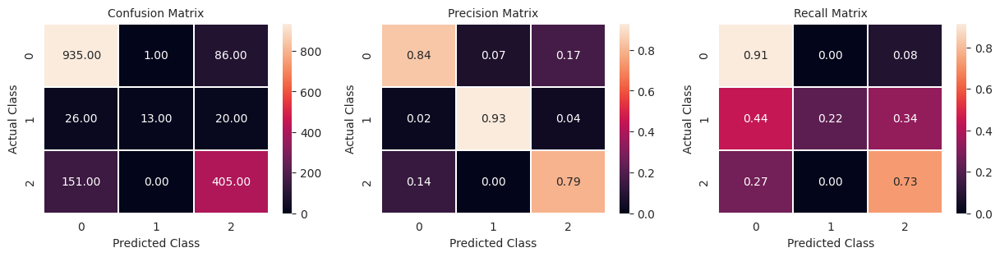


               precision    recall  f1-score   support

           0       0.84      0.91      0.88      1022
           1       0.93      0.22      0.36        59
           2       0.79      0.73      0.76       556

    accuracy                           0.83      1637
   macro avg       0.85      0.62      0.66      1637
weighted avg       0.83      0.83      0.82      1637

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
Test log_loss: 0.47%

Running CV 1

Start training the model...
Model Calibration
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


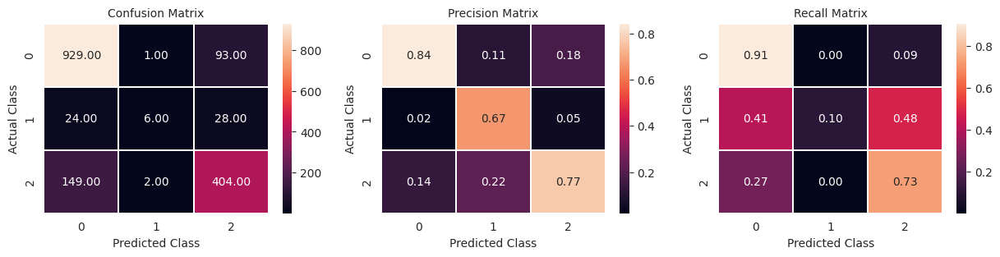


               precision    recall  f1-score   support

           0       0.84      0.91      0.87      1023
           1       0.67      0.10      0.18        58
           2       0.77      0.73      0.75       555

    accuracy                           0.82      1636
   macro avg       0.76      0.58      0.60      1636
weighted avg       0.81      0.82      0.81      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_rf_v0_cal/ already exists
Test log_loss: 0.49%

Running CV 2

Start training the model...
Model Calibration
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


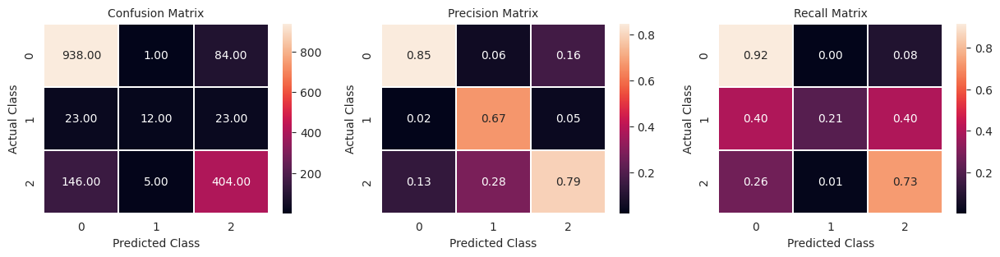


               precision    recall  f1-score   support

           0       0.85      0.92      0.88      1023
           1       0.67      0.21      0.32        58
           2       0.79      0.73      0.76       555

    accuracy                           0.83      1636
   macro avg       0.77      0.62      0.65      1636
weighted avg       0.82      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_rf_v0_cal/ already exists
Test log_loss: 0.47%

Running CV 3

Start training the model...
Model Calibration
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


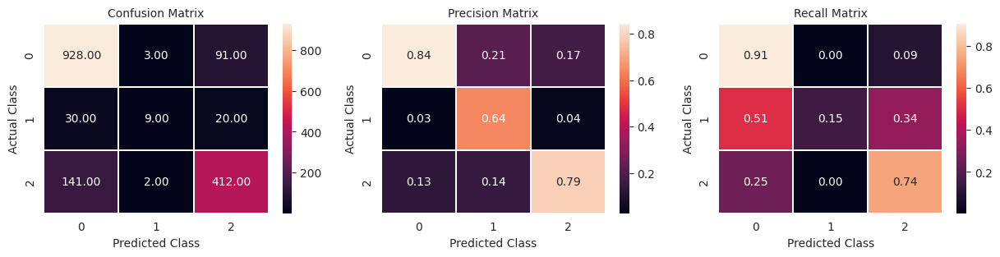


               precision    recall  f1-score   support

           0       0.84      0.91      0.88      1022
           1       0.64      0.15      0.25        59
           2       0.79      0.74      0.76       555

    accuracy                           0.82      1636
   macro avg       0.76      0.60      0.63      1636
weighted avg       0.82      0.82      0.81      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_rf_v0_cal/ already exists
Test log_loss: 0.46%

Running CV 4

Start training the model...
Model Calibration
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


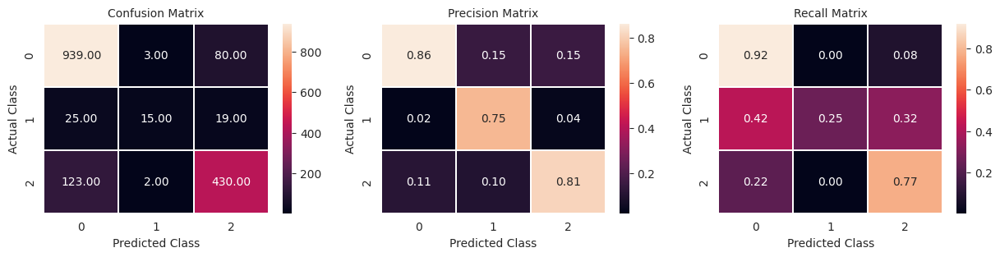


               precision    recall  f1-score   support

           0       0.86      0.92      0.89      1022
           1       0.75      0.25      0.38        59
           2       0.81      0.77      0.79       555

    accuracy                           0.85      1636
   macro avg       0.81      0.65      0.69      1636
weighted avg       0.84      0.85      0.84      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_rf_v0_cal/ already exists
Test log_loss: 0.43%

Running CV 5

Start training the model...
Model Calibration
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


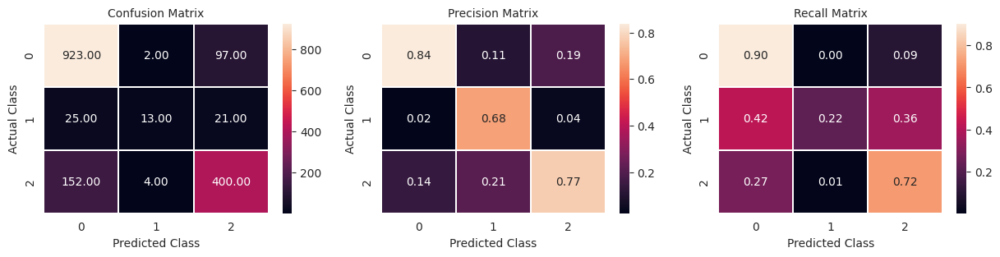


               precision    recall  f1-score   support

           0       0.84      0.90      0.87      1022
           1       0.68      0.22      0.33        59
           2       0.77      0.72      0.74       556

    accuracy                           0.82      1637
   macro avg       0.77      0.61      0.65      1637
weighted avg       0.81      0.82      0.81      1637

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_rf_v0_cal/ already exists
Test log_loss: 0.47%

Running CV 6

Start training the model...
Model Calibration
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


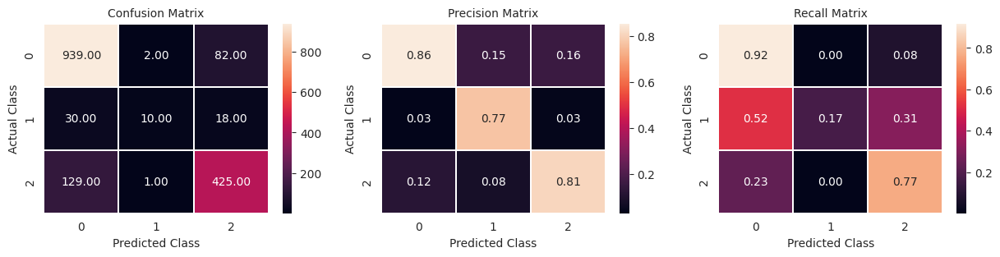


               precision    recall  f1-score   support

           0       0.86      0.92      0.89      1023
           1       0.77      0.17      0.28        58
           2       0.81      0.77      0.79       555

    accuracy                           0.84      1636
   macro avg       0.81      0.62      0.65      1636
weighted avg       0.84      0.84      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_rf_v0_cal/ already exists
Test log_loss: 0.45%

Running CV 7

Start training the model...
Model Calibration
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


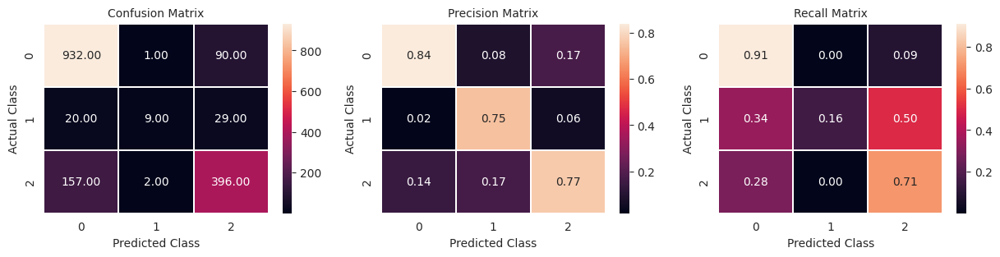


               precision    recall  f1-score   support

           0       0.84      0.91      0.87      1023
           1       0.75      0.16      0.26        58
           2       0.77      0.71      0.74       555

    accuracy                           0.82      1636
   macro avg       0.79      0.59      0.62      1636
weighted avg       0.81      0.82      0.81      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_rf_v0_cal/ already exists
Test log_loss: 0.48%

Running CV 8

Start training the model...
Model Calibration
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


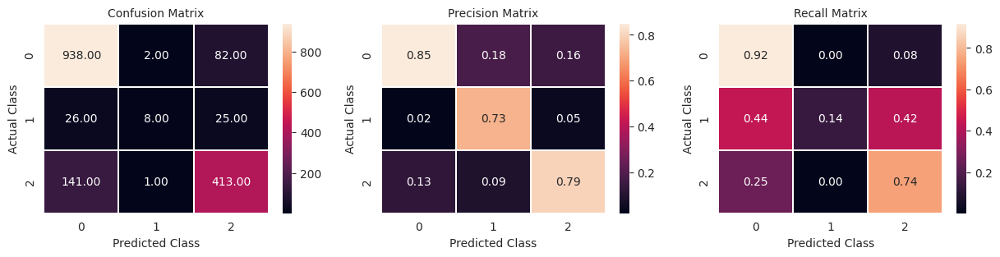


               precision    recall  f1-score   support

           0       0.85      0.92      0.88      1022
           1       0.73      0.14      0.23        59
           2       0.79      0.74      0.77       555

    accuracy                           0.83      1636
   macro avg       0.79      0.60      0.63      1636
weighted avg       0.83      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_rf_v0_cal/ already exists
Test log_loss: 0.46%

Running CV 9

Start training the model...
Model Calibration
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


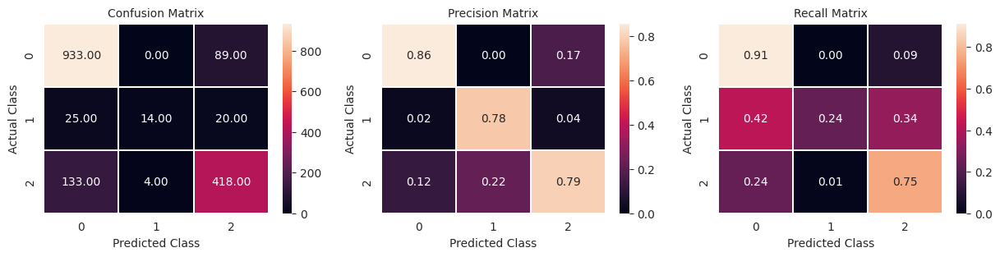


               precision    recall  f1-score   support

           0       0.86      0.91      0.88      1022
           1       0.78      0.24      0.36        59
           2       0.79      0.75      0.77       555

    accuracy                           0.83      1636
   macro avg       0.81      0.63      0.67      1636
weighted avg       0.83      0.83      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_rf_v0_cal/ already exists
Test log_loss: 0.44%

Running CV 10

Start training the model...
Model Calibration
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


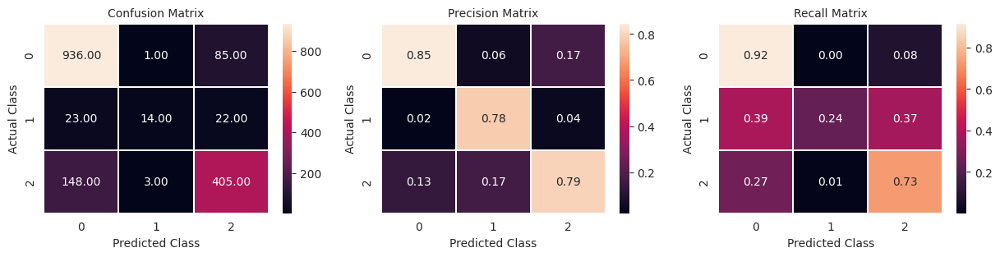


               precision    recall  f1-score   support

           0       0.85      0.92      0.88      1022
           1       0.78      0.24      0.36        59
           2       0.79      0.73      0.76       556

    accuracy                           0.83      1637
   macro avg       0.80      0.63      0.67      1637
weighted avg       0.82      0.83      0.82      1637

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_rf_v0_cal/ already exists
Test log_loss: 0.47%

Running CV 11

Start training the model...
Model Calibration
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


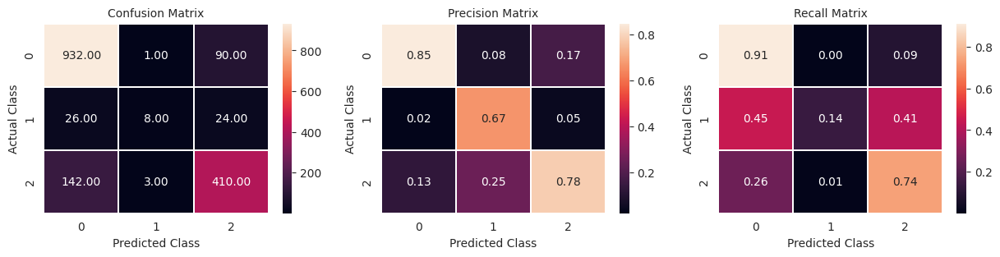


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1023
           1       0.67      0.14      0.23        58
           2       0.78      0.74      0.76       555

    accuracy                           0.83      1636
   macro avg       0.77      0.60      0.62      1636
weighted avg       0.82      0.83      0.81      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_rf_v0_cal/ already exists
Test log_loss: 0.47%

Running CV 12

Start training the model...
Model Calibration
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


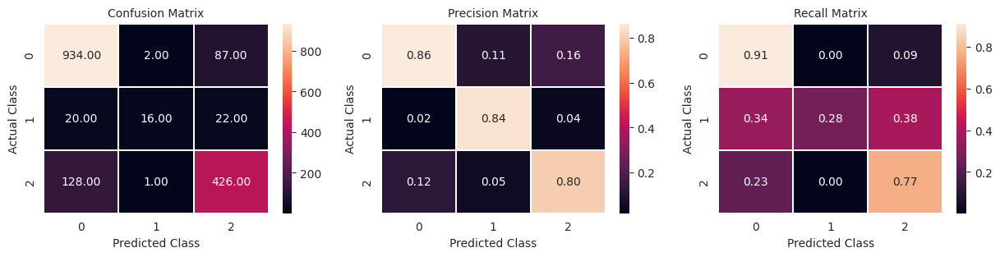


               precision    recall  f1-score   support

           0       0.86      0.91      0.89      1023
           1       0.84      0.28      0.42        58
           2       0.80      0.77      0.78       555

    accuracy                           0.84      1636
   macro avg       0.83      0.65      0.69      1636
weighted avg       0.84      0.84      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_rf_v0_cal/ already exists
Test log_loss: 0.43%

Running CV 13

Start training the model...
Model Calibration
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


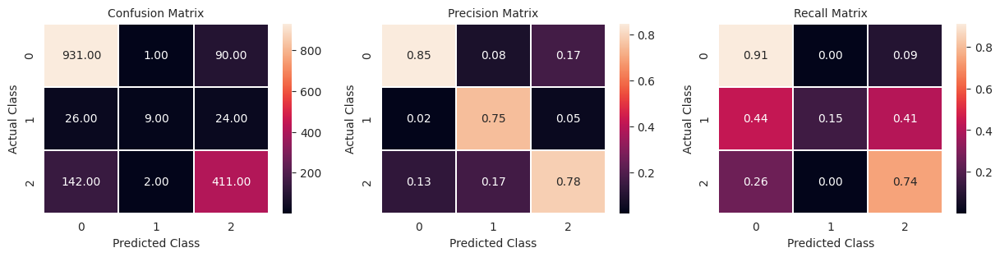


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1022
           1       0.75      0.15      0.25        59
           2       0.78      0.74      0.76       555

    accuracy                           0.83      1636
   macro avg       0.79      0.60      0.63      1636
weighted avg       0.82      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_rf_v0_cal/ already exists
Test log_loss: 0.46%

Running CV 14

Start training the model...
Model Calibration
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


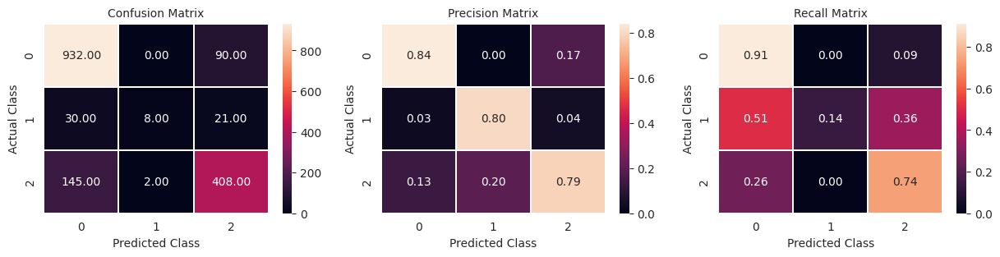


               precision    recall  f1-score   support

           0       0.84      0.91      0.88      1022
           1       0.80      0.14      0.23        59
           2       0.79      0.74      0.76       555

    accuracy                           0.82      1636
   macro avg       0.81      0.59      0.62      1636
weighted avg       0.82      0.82      0.81      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_rf_v0_cal/ already exists
Test log_loss: 0.47%

Running CV 15

Start training the model...
Model Calibration
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


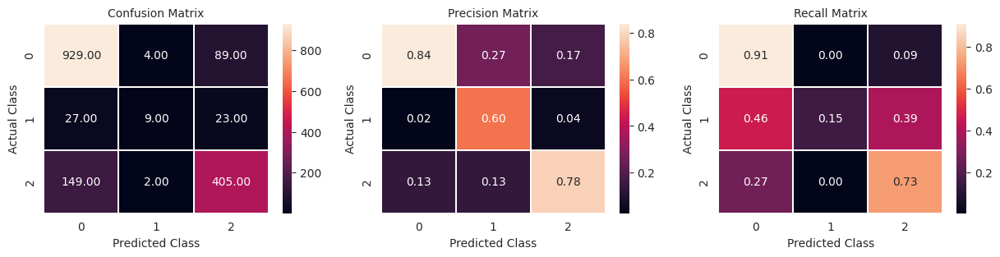


               precision    recall  f1-score   support

           0       0.84      0.91      0.87      1022
           1       0.60      0.15      0.24        59
           2       0.78      0.73      0.75       556

    accuracy                           0.82      1637
   macro avg       0.74      0.60      0.62      1637
weighted avg       0.81      0.82      0.81      1637

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_rf_v0_cal/ already exists
Test log_loss: 0.48%

Running CV 16

Start training the model...
Model Calibration
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


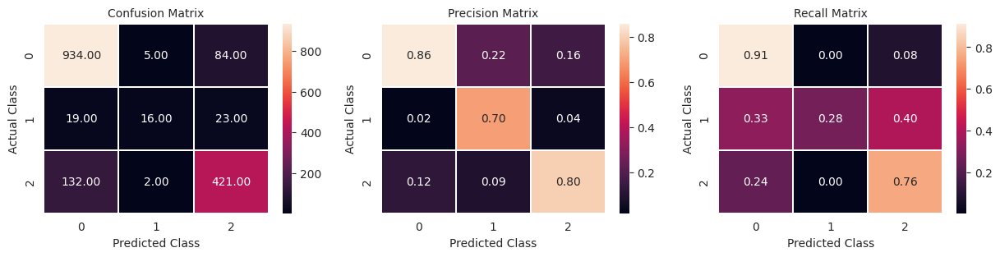


               precision    recall  f1-score   support

           0       0.86      0.91      0.89      1023
           1       0.70      0.28      0.40        58
           2       0.80      0.76      0.78       555

    accuracy                           0.84      1636
   macro avg       0.78      0.65      0.69      1636
weighted avg       0.83      0.84      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_rf_v0_cal/ already exists
Test log_loss: 0.43%

Running CV 17

Start training the model...
Model Calibration
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


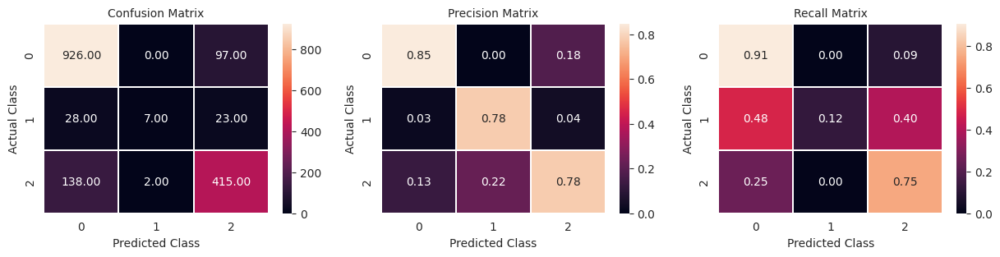


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1023
           1       0.78      0.12      0.21        58
           2       0.78      0.75      0.76       555

    accuracy                           0.82      1636
   macro avg       0.80      0.59      0.62      1636
weighted avg       0.82      0.82      0.81      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_rf_v0_cal/ already exists
Test log_loss: 0.47%

Running CV 18

Start training the model...
Model Calibration
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


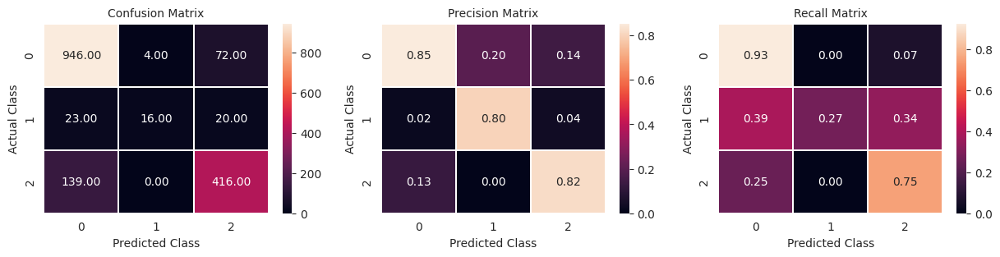


               precision    recall  f1-score   support

           0       0.85      0.93      0.89      1022
           1       0.80      0.27      0.41        59
           2       0.82      0.75      0.78       555

    accuracy                           0.84      1636
   macro avg       0.82      0.65      0.69      1636
weighted avg       0.84      0.84      0.84      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_rf_v0_cal/ already exists
Test log_loss: 0.45%

Running CV 19

Start training the model...
Model Calibration
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


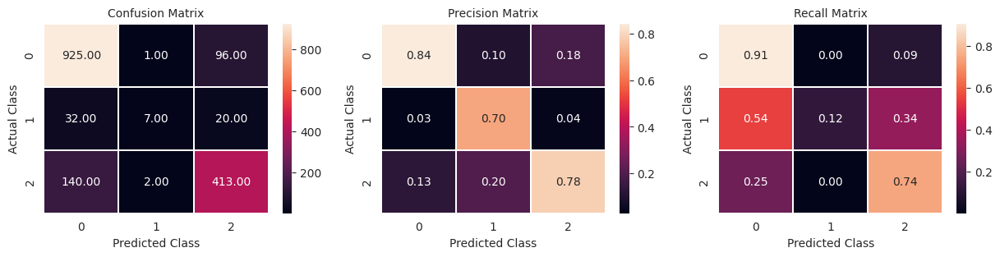


               precision    recall  f1-score   support

           0       0.84      0.91      0.87      1022
           1       0.70      0.12      0.20        59
           2       0.78      0.74      0.76       555

    accuracy                           0.82      1636
   macro avg       0.77      0.59      0.61      1636
weighted avg       0.82      0.82      0.81      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_rf_v0_cal/ already exists
Test log_loss: 0.48%

Running CV 20

Start training the model...
Model Calibration
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


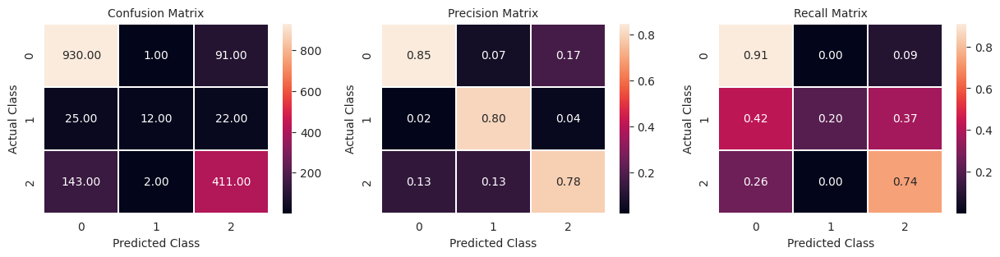


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1022
           1       0.80      0.20      0.32        59
           2       0.78      0.74      0.76       556

    accuracy                           0.83      1637
   macro avg       0.81      0.62      0.65      1637
weighted avg       0.82      0.83      0.82      1637

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_rf_v0_cal/ already exists
Test log_loss: 0.47%

Running CV 21

Start training the model...
Model Calibration
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


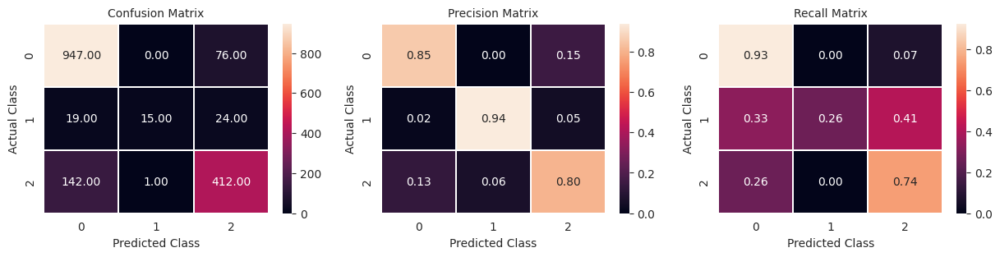


               precision    recall  f1-score   support

           0       0.85      0.93      0.89      1023
           1       0.94      0.26      0.41        58
           2       0.80      0.74      0.77       555

    accuracy                           0.84      1636
   macro avg       0.87      0.64      0.69      1636
weighted avg       0.84      0.84      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_rf_v0_cal/ already exists
Test log_loss: 0.44%

Running CV 22

Start training the model...
Model Calibration
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


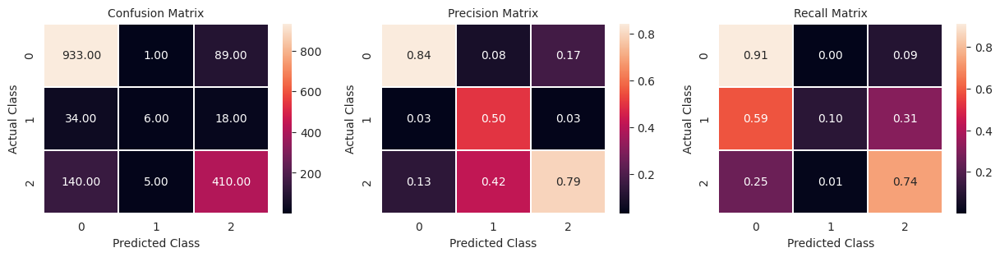


               precision    recall  f1-score   support

           0       0.84      0.91      0.88      1023
           1       0.50      0.10      0.17        58
           2       0.79      0.74      0.76       555

    accuracy                           0.82      1636
   macro avg       0.71      0.58      0.60      1636
weighted avg       0.81      0.82      0.81      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_rf_v0_cal/ already exists
Test log_loss: 0.47%

Running CV 23

Start training the model...
Model Calibration
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


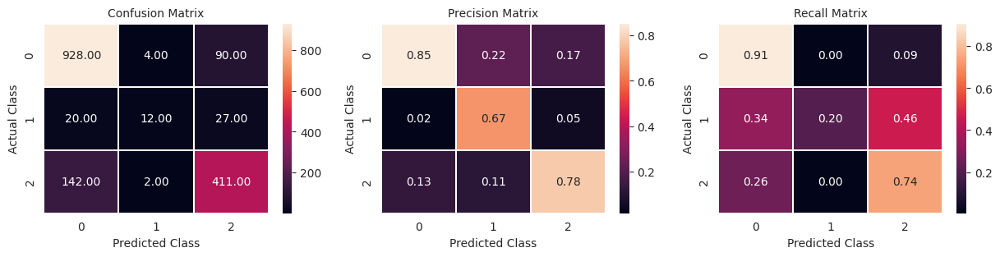


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1022
           1       0.67      0.20      0.31        59
           2       0.78      0.74      0.76       555

    accuracy                           0.83      1636
   macro avg       0.77      0.62      0.65      1636
weighted avg       0.82      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_rf_v0_cal/ already exists
Test log_loss: 0.46%

Running CV 24

Start training the model...
Model Calibration
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


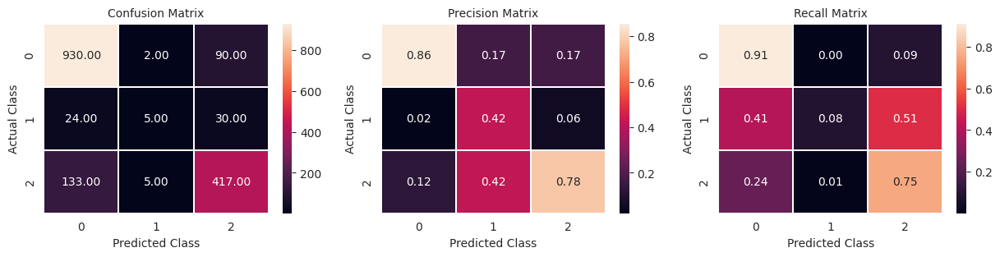


               precision    recall  f1-score   support

           0       0.86      0.91      0.88      1022
           1       0.42      0.08      0.14        59
           2       0.78      0.75      0.76       555

    accuracy                           0.83      1636
   macro avg       0.68      0.58      0.60      1636
weighted avg       0.81      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_rf_v0_cal/ already exists
Test log_loss: 0.47%

Running CV 25

Start training the model...
Model Calibration
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


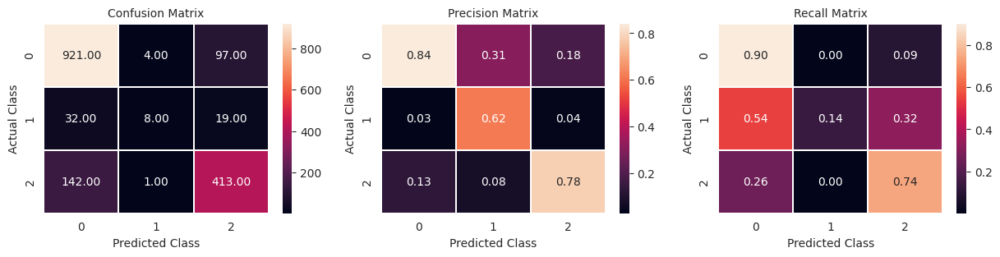


               precision    recall  f1-score   support

           0       0.84      0.90      0.87      1022
           1       0.62      0.14      0.22        59
           2       0.78      0.74      0.76       556

    accuracy                           0.82      1637
   macro avg       0.75      0.59      0.62      1637
weighted avg       0.81      0.82      0.81      1637

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_rf_v0_cal/ already exists
Test log_loss: 0.47%

Running CV 26

Start training the model...
Model Calibration
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


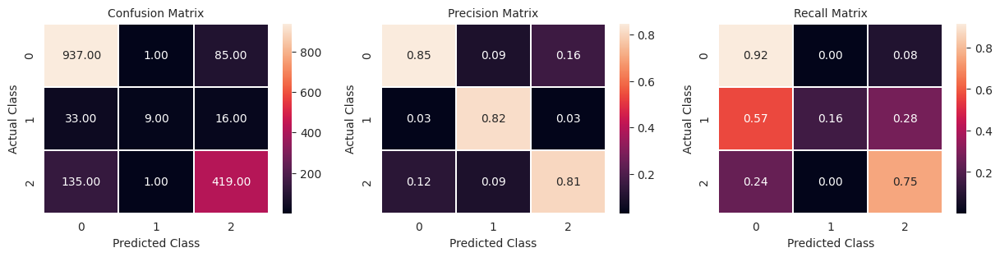


               precision    recall  f1-score   support

           0       0.85      0.92      0.88      1023
           1       0.82      0.16      0.26        58
           2       0.81      0.75      0.78       555

    accuracy                           0.83      1636
   macro avg       0.82      0.61      0.64      1636
weighted avg       0.83      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_rf_v0_cal/ already exists
Test log_loss: 0.46%

Running CV 27

Start training the model...
Model Calibration
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


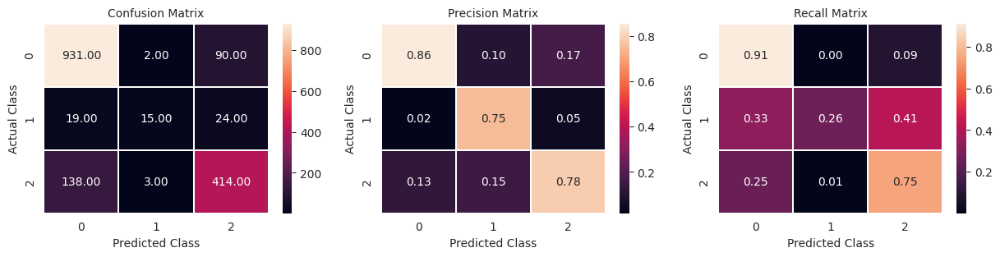


               precision    recall  f1-score   support

           0       0.86      0.91      0.88      1023
           1       0.75      0.26      0.38        58
           2       0.78      0.75      0.76       555

    accuracy                           0.83      1636
   macro avg       0.80      0.64      0.68      1636
weighted avg       0.83      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_rf_v0_cal/ already exists
Test log_loss: 0.44%

Running CV 28

Start training the model...
Model Calibration
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


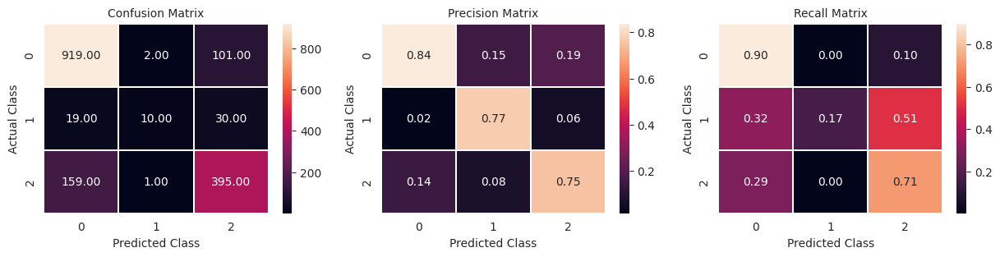


               precision    recall  f1-score   support

           0       0.84      0.90      0.87      1022
           1       0.77      0.17      0.28        59
           2       0.75      0.71      0.73       555

    accuracy                           0.81      1636
   macro avg       0.79      0.59      0.63      1636
weighted avg       0.81      0.81      0.80      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_rf_v0_cal/ already exists
Test log_loss: 0.49%

Running CV 29

Start training the model...
Model Calibration
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


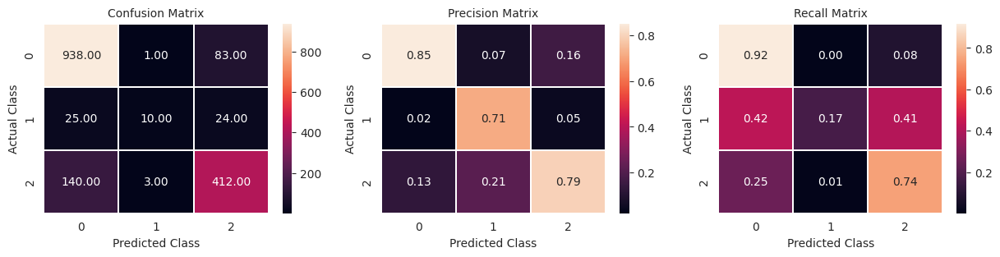


               precision    recall  f1-score   support

           0       0.85      0.92      0.88      1022
           1       0.71      0.17      0.27        59
           2       0.79      0.74      0.77       555

    accuracy                           0.83      1636
   macro avg       0.79      0.61      0.64      1636
weighted avg       0.83      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_rf_v0_cal/ already exists
Test log_loss: 0.46%

Running CV 30

Start training the model...
Model Calibration
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


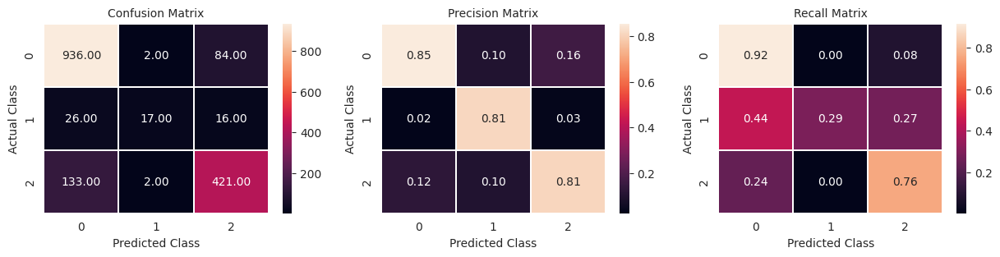


               precision    recall  f1-score   support

           0       0.85      0.92      0.88      1022
           1       0.81      0.29      0.43        59
           2       0.81      0.76      0.78       556

    accuracy                           0.84      1637
   macro avg       0.82      0.65      0.70      1637
weighted avg       0.84      0.84      0.83      1637

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_rf_v0_cal/ already exists
Test log_loss: 0.42%

Running CV 31

Start training the model...
Model Calibration
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


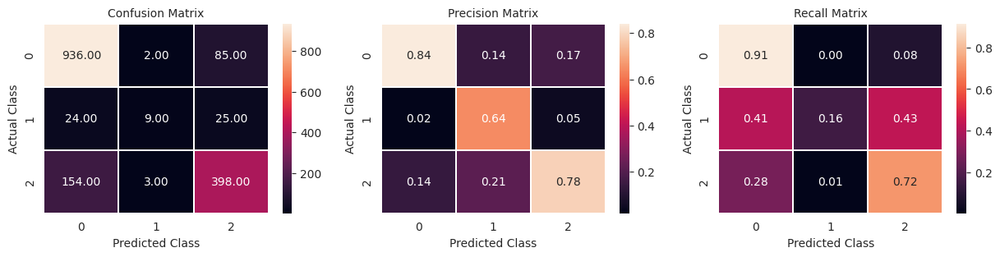


               precision    recall  f1-score   support

           0       0.84      0.91      0.88      1023
           1       0.64      0.16      0.25        58
           2       0.78      0.72      0.75       555

    accuracy                           0.82      1636
   macro avg       0.76      0.60      0.62      1636
weighted avg       0.81      0.82      0.81      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_rf_v0_cal/ already exists
Test log_loss: 0.47%

Running CV 32

Start training the model...
Model Calibration
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


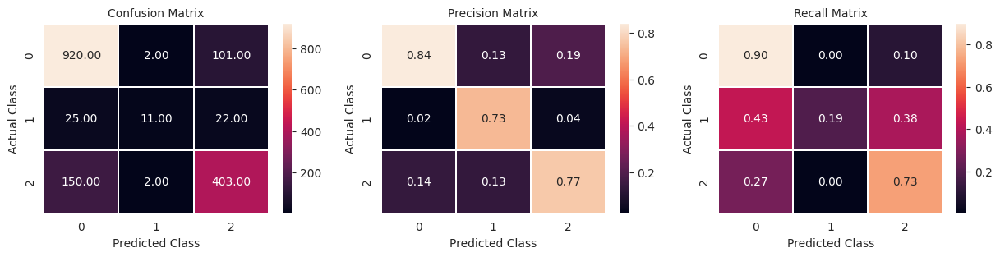


               precision    recall  f1-score   support

           0       0.84      0.90      0.87      1023
           1       0.73      0.19      0.30        58
           2       0.77      0.73      0.75       555

    accuracy                           0.82      1636
   macro avg       0.78      0.61      0.64      1636
weighted avg       0.81      0.82      0.81      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_rf_v0_cal/ already exists
Test log_loss: 0.48%

Running CV 33

Start training the model...
Model Calibration
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


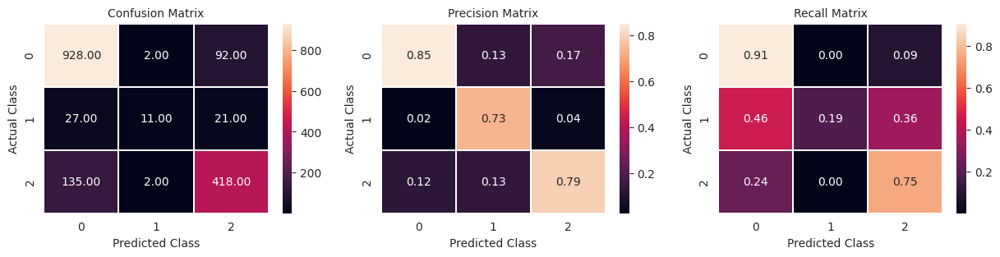


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1022
           1       0.73      0.19      0.30        59
           2       0.79      0.75      0.77       555

    accuracy                           0.83      1636
   macro avg       0.79      0.62      0.65      1636
weighted avg       0.83      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_rf_v0_cal/ already exists
Test log_loss: 0.47%

Running CV 34

Start training the model...
Model Calibration
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


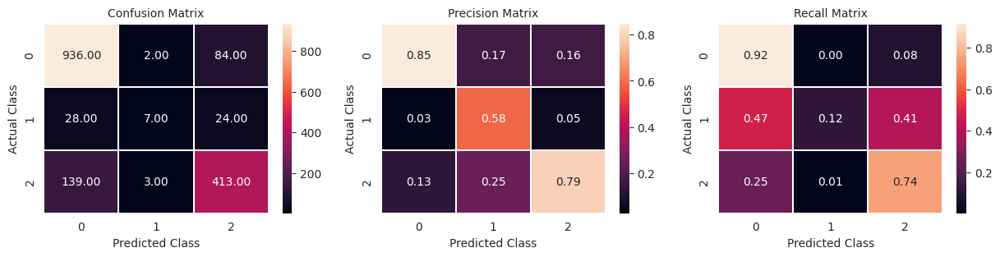


               precision    recall  f1-score   support

           0       0.85      0.92      0.88      1022
           1       0.58      0.12      0.20        59
           2       0.79      0.74      0.77       555

    accuracy                           0.83      1636
   macro avg       0.74      0.59      0.62      1636
weighted avg       0.82      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_rf_v0_cal/ already exists
Test log_loss: 0.47%

Running CV 35

Start training the model...
Model Calibration
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


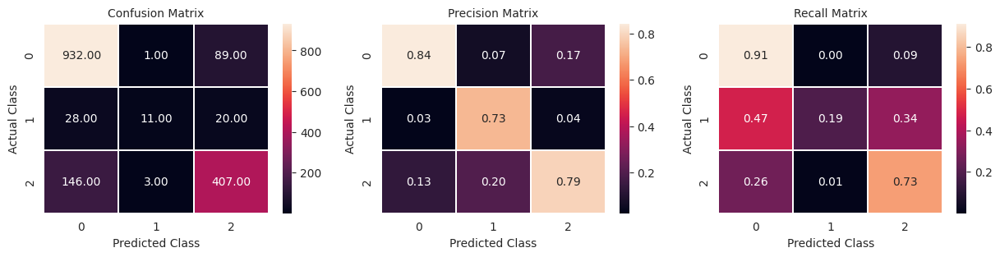


               precision    recall  f1-score   support

           0       0.84      0.91      0.88      1022
           1       0.73      0.19      0.30        59
           2       0.79      0.73      0.76       556

    accuracy                           0.82      1637
   macro avg       0.79      0.61      0.64      1637
weighted avg       0.82      0.82      0.82      1637

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_rf_v0_cal/ already exists
Test log_loss: 0.46%

Running CV 36

Start training the model...
Model Calibration
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


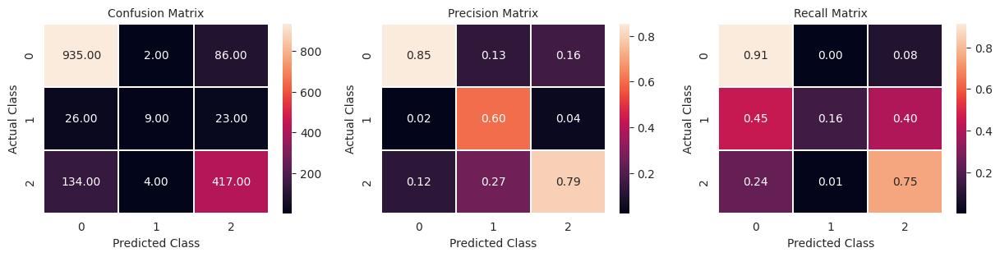


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1023
           1       0.60      0.16      0.25        58
           2       0.79      0.75      0.77       555

    accuracy                           0.83      1636
   macro avg       0.75      0.61      0.63      1636
weighted avg       0.82      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_rf_v0_cal/ already exists
Test log_loss: 0.45%

Running CV 37

Start training the model...
Model Calibration
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


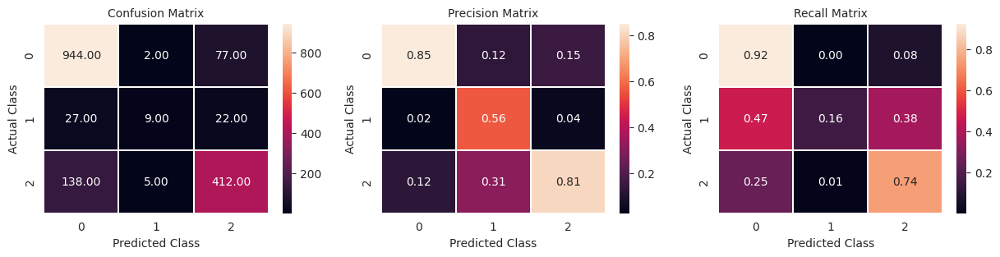


               precision    recall  f1-score   support

           0       0.85      0.92      0.89      1023
           1       0.56      0.16      0.24        58
           2       0.81      0.74      0.77       555

    accuracy                           0.83      1636
   macro avg       0.74      0.61      0.63      1636
weighted avg       0.83      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_rf_v0_cal/ already exists
Test log_loss: 0.45%

Running CV 38

Start training the model...
Model Calibration
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


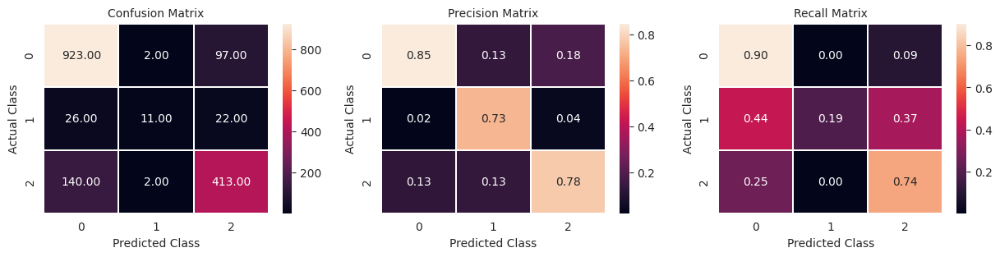


               precision    recall  f1-score   support

           0       0.85      0.90      0.87      1022
           1       0.73      0.19      0.30        59
           2       0.78      0.74      0.76       555

    accuracy                           0.82      1636
   macro avg       0.79      0.61      0.64      1636
weighted avg       0.82      0.82      0.81      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_rf_v0_cal/ already exists
Test log_loss: 0.47%

Running CV 39

Start training the model...
Model Calibration
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


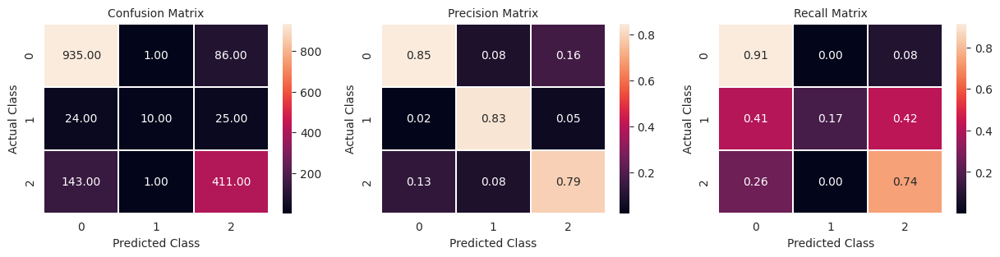


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1022
           1       0.83      0.17      0.28        59
           2       0.79      0.74      0.76       555

    accuracy                           0.83      1636
   macro avg       0.82      0.61      0.64      1636
weighted avg       0.83      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_rf_v0_cal/ already exists
Test log_loss: 0.47%
All Valuation lOGlOSS: [0.467, 0.487, 0.467, 0.461, 0.431, 0.474, 0.447, 0.479, 0.456, 0.445, 0.472, 0.472, 0.434, 0.464, 0.468, 0.483, 0.433, 0.474, 0.445, 0.478, 0.471, 0.437, 0.466, 0.462, 0.472, 0.466, 0.456, 0.443, 0.492, 0.455, 0.423, 0.467, 0.484, 0.47, 0.468, 0.464, 0.452, 0.453, 0.475, 0.469]


In [ ]:
test_results_df_C,test_results_df_CL,test_results_df_D, test_results_df = run_experiment(X_train,
                                                                                         X_test,
                                                                                         best_params=best_par,
                                                                                         experiment_name="model_rf_v0_cal",
                                                                                         splits=5,
                                                                                         n_repeats=8,
                                                                                         rs=42,
                                                                                         calibrate=True)

In [ ]:
res_cal = [0.467, 0.487, 0.467, 0.461, 0.431, 0.474, 0.447, 0.479, 0.456, 0.445, 0.472, 0.472, 0.434, 0.464, 0.468, 0.483, 0.433, 0.474, 0.445, 0.478,
           0.471, 0.437, 0.466, 0.462, 0.472, 0.466, 0.456, 0.443, 0.492, 0.455, 0.423, 0.467, 0.484, 0.47, 0.468, 0.464, 0.452, 0.453, 0.475, 0.469]

res_unc = [0.465, 0.486, 0.462, 0.458, 0.439, 0.469, 0.451, 0.477, 0.46, 0.446, 0.478, 0.463, 0.439, 0.457, 0.469, 0.476, 0.437, 0.476, 0.449, 0.479,
          0.475, 0.439, 0.458, 0.468, 0.471, 0.467, 0.466, 0.447, 0.486, 0.451, 0.432, 0.471, 0.477, 0.469, 0.466, 0.463, 0.447, 0.452, 0.477, 0.472]

np.mean(res_cal),np.mean(res_unc),

(0.46204999999999996, 0.46225000000000005)

In [ ]:
test_results_df

,Status_C,Status_CL,Status_D
0,0.817539,0.029856,0.152605
1,0.819182,0.047731,0.133087
2,0.083021,0.060995,0.855984
3,0.926430,0.014901,0.058668
4,0.807327,0.043389,0.149284
...,...,...,...
5266,0.860294,0.039961,0.099746
5267,0.888645,0.017259,0.094096
5268,0.913122,0.016252,0.070626
5269,0.939147,0.014592,0.046261


In [ ]:
experiment_name="model_rf_v0_cal"

sub = pd.read_csv("sample_submission.csv", index_col=0)
sub.iloc[:,:] = test_results_df.values
sub.to_csv(f"Results/{experiment_name}.csv")

In [ ]:
sub

,Status_C,Status_CL,Status_D
id,,,
7905,0.817539,0.029856,0.152605
7906,0.819182,0.047731,0.133087
7907,0.083021,0.060995,0.855984
7908,0.926430,0.014901,0.058668
7909,0.807327,0.043389,0.149284
...,...,...,...
13171,0.860294,0.039961,0.099746
13172,0.888645,0.017259,0.094096
13173,0.913122,0.016252,0.070626


### 6.4 LGBMClassifier

In [ ]:
X_train = pd.read_csv("new_train.csv", index_col=0)
X_test = pd.read_csv("new_test.csv", index_col=0)

#X_train["weights"] = X_train["Status"]
#X_test["weights"] = 1.0

strat_feature = X_train["Status"]

X_train.drop(columns=["id","Status_C","Status_CL","Status_D","min_class_feat_RF"],inplace=True)
X_test.drop(columns=["id","Status_C","Status_CL","Status_D","min_class_feat_RF"],inplace=True)

num_var = X_train.select_dtypes("float").columns
cat_var = X_train.select_dtypes("int").columns

X_train[num_var]=X_train[num_var].astype("float32")
X_train[cat_var]=X_train[cat_var].astype("int32")

X_test[num_var]=X_test[num_var].astype("float32")
X_test[cat_var]=X_test[cat_var].astype("int32")

X_train.Status = X_train.Status.replace({"C":0,"CL":1,"D":2})

X_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8181 entries, 0 to 311
Data columns (total 37 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Drug                            8181 non-null   int32  
 1   Sex                             8181 non-null   int32  
 2   Ascites                         8181 non-null   int32  
 3   Hepatomegaly                    8181 non-null   int32  
 4   Spiders                         8181 non-null   int32  
 5   Edema                           8181 non-null   int32  
 6   Bilirubin                       8181 non-null   float32
 7   Cholesterol                     8181 non-null   float32
 8   Albumin                         8181 non-null   float32
 9   Copper                          8181 non-null   float32
 10  Alk_Phos                        8181 non-null   float32
 11  SGOT                            8181 non-null   float32
 12  Tryglicerides                   818

In [ ]:
X_test.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5271 entries, 0 to 5270
Data columns (total 37 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Drug                            5271 non-null   int32  
 1   Sex                             5271 non-null   int32  
 2   Ascites                         5271 non-null   int32  
 3   Hepatomegaly                    5271 non-null   int32  
 4   Spiders                         5271 non-null   int32  
 5   Edema                           5271 non-null   int32  
 6   Bilirubin                       5271 non-null   float32
 7   Cholesterol                     5271 non-null   float32
 8   Albumin                         5271 non-null   float32
 9   Copper                          5271 non-null   float32
 10  Alk_Phos                        5271 non-null   float32
 11  SGOT                            5271 non-null   float32
 12  Tryglicerides                   52

**Check Unconstrained Model**

In [ ]:
X = X_train.drop(columns=["Status"]).copy()
y = X_train["Status"].copy()

In [ ]:
skf = RepeatedStratifiedKFold(n_splits=5, n_repeats=5, random_state=48)
clf = LGBMClassifier()
cross_val_score(clf, X, y, n_jobs=-1, cv=skf, scoring="neg_log_loss").mean()

-0.46592665899212926

#### 6.3.1 **Optuna Optimization**

In [ ]:
skf = RepeatedStratifiedKFold(n_splits=4, n_repeats=4, random_state=48)

def objective(trial):
    train_x, valid_x, train_y, valid_y = train_test_split(X, y, test_size=0.25, stratify=y)
    dtrain = lgb.Dataset(train_x, label=train_y)
    dvalid = lgb.Dataset(valid_x, label=valid_y)

    param = {
        'objective': 'multiclass',
        'num_leaves': trial.suggest_int('num_leaves', 41, 61),
        'subsample': trial.suggest_uniform("subsample", 0.4, 0.7),
        'colsample_bytree': trial.suggest_uniform("colsample_bytree", 0.7, 1.0),
        'min_child_samples': trial.suggest_int('min_child_samples', 21, 41),
        'min_child_weight' : trial.suggest_float("min_child_weight", 1e-2, 1.0, log=True),
        "reg_alpha" : trial.suggest_float("reg_alpha", 1e-2, 10.0, log=True), #
        "reg_lambda" : trial.suggest_float("reg_lambda", 1e-4, 1e-1, log=True),
        "n_estimators" : trial.suggest_int('n_estimators', 200, 450), #
        "max_depth" : trial.suggest_int('max_depth', 3, 10),
        "learning_rate" : trial.suggest_float("learning_rate",1e-3, 1e-1, log=True)}

    clf = LGBMClassifier(random_state = 42, force_row_wise=True, **param)
    fit_params={"eval_set":(valid_x,valid_y),"callbacks":[early_stopping(stopping_rounds=31)]}
    clf.fit(train_x,train_y,**fit_params)
    y_prob = clf.predict_proba(valid_x)

    score = log_loss(valid_y,y_prob)

    return score

In [ ]:
# Create study object
study = optuna.create_study(direction="minimize")

# Run optimization process
study.optimize(objective, n_trials=81, show_progress_bar=True)

[I 2023-12-16 19:41:49,669] A new study created in memory with name: no-name-16da4f50-5158-494f-93a5-1bed7cd0aece


  0%|          | 0/81 [00:00<?, ?it/s]

Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

In [ ]:
trial = study.best_trial
print('LogLoss: {}'.format(trial.value))
print("Best hyperparameters: {}".format(trial.params))

LogLoss: 0.42962760064296296
Best hyperparameters: {'num_leaves': 51, 'subsample': 0.5460791265761185, 'colsample_bytree': 0.8973742337230413, 'min_child_samples': 27, 'min_child_weight': 0.05623621235430086, 'reg_alpha': 0.8423827289841265, 'reg_lambda': 0.0018472092059678479, 'n_estimators': 348, 'max_depth': 5, 'learning_rate': 0.03392592813352654}


In [ ]:
trial = study.best_trial
print('LogLoss: {}'.format(trial.value))
print("Best hyperparameters: {}".format(trial.params))

LogLoss: 0.4147948970705978
Best hyperparameters: {'num_leaves': 58, 'subsample': 0.6824880137754312, 'colsample_bytree': 0.8553788777382636, 'min_child_samples': 32, 'min_child_weight': 0.16200403161409616, 'reg_alpha': 0.09786765613808512, 'reg_lambda': 0.03489729616997099, 'n_estimators': 280, 'max_depth': 7, 'learning_rate': 0.05500614673556781}


In [ ]:
# Print best trial and best hyperparameters
print("Best trial:", study.best_trial)
print("Best hyperparameters:", study.best_params)

Best trial: FrozenTrial(number=69, state=TrialState.COMPLETE, values=[0.4147948970705978], datetime_start=datetime.datetime(2023, 12, 16, 19, 43, 3, 54441), datetime_complete=datetime.datetime(2023, 12, 16, 19, 43, 3, 922079), params={'num_leaves': 58, 'subsample': 0.6824880137754312, 'colsample_bytree': 0.8553788777382636, 'min_child_samples': 32, 'min_child_weight': 0.16200403161409616, 'reg_alpha': 0.09786765613808512, 'reg_lambda': 0.03489729616997099, 'n_estimators': 280, 'max_depth': 7, 'learning_rate': 0.05500614673556781}, user_attrs={}, system_attrs={}, intermediate_values={}, distributions={'num_leaves': IntDistribution(high=61, log=False, low=41, step=1), 'subsample': FloatDistribution(high=0.7, log=False, low=0.4, step=None), 'colsample_bytree': FloatDistribution(high=1.0, log=False, low=0.7, step=None), 'min_child_samples': IntDistribution(high=41, log=False, low=21, step=1), 'min_child_weight': FloatDistribution(high=1.0, log=True, low=0.01, step=None), 'reg_alpha': Float

In [ ]:
fig = optuna.visualization.plot_optimization_history(study)
fig.show()

In [ ]:
fig = optuna.visualization.plot_param_importances(study)
fig.show()

In [ ]:
fig = optuna.visualization.plot_rank(study, params=["subsample", "colsample_bytree"])
fig.show()

In [ ]:
fig = optuna.visualization.plot_rank(study, params=["n_estimators", "reg_alpha"])
fig.show()

In [ ]:
skf = RepeatedStratifiedKFold(n_splits=5, n_repeats=5, random_state=42)
best_par = {'num_leaves': 58, 'subsample': 0.6824880137754312, 'colsample_bytree': 0.8553788777382636, 'min_child_samples': 32, 'min_child_weight': 0.16200403161409616,
            'reg_alpha': 0.09786765613808512, 'reg_lambda': 0.03489729616997099, 'n_estimators': 280, 'max_depth': 7, 'learning_rate': 0.05500614673556781}
clf = LGBMClassifier(random_state = 42, force_row_wise=True, **best_par)
#cross_val_score(clf, X, y, n_jobs=-1, cv=skf, scoring="neg_log_loss").mean()
#clf.fit( X, y)

#### 6.3.2 Fit the Model

In [ ]:
def run_experiment(train, test_data_file, best_params=best_par, experiment_name="model_lgbm", splits=5, n_repeats=8, rs=42, calibrate=True):

  skf = RepeatedStratifiedKFold(n_splits=splits, n_repeats=n_repeats, random_state=rs)

  test_results_df_C = pd.DataFrame(index=test_data_file.index, columns=list(range(splits*n_repeats)))
  test_results_df_CL = pd.DataFrame(index=test_data_file.index, columns=list(range(splits*n_repeats)))
  test_results_df_D = pd.DataFrame(index=test_data_file.index, columns=list(range(splits*n_repeats)))

  test_results_df = pd.DataFrame(index=test_data_file.index, columns=["Status_C","Status_CL","Status_D"])

  all_logloss = []
  all_AUC_pr = []

  for i, (train_index, valid_index) in enumerate(skf.split(X_train,strat_feature)):

    print(f"\nRunning CV {i}\n")
    ########################################################################## Prepare the Dataset:
    X_trn = train.iloc[train_index,:]
    X_val = train.iloc[valid_index,:]

    X = X_trn.drop(columns=["Status"]).copy()
    y = X_trn["Status"].copy()

    val_X = X_val.drop(columns=["Status"]).copy()
    val_y = X_val["Status"].copy()

    test_X = test_data_file.drop(columns=["Status"]).copy()
    #################################################################### End of Dataset Preparation

    ##################################################################### Generate and Fit Model
    model = LGBMClassifier(random_state = rs, force_row_wise=True, **best_par)
    print("Start training the model...")
    model.fit(X,y, eval_set=(val_X,val_y), callbacks=[early_stopping(stopping_rounds=25)])
    if calibrate:
      print("Model Calibration")
      cal_model = CalibratedClassifierCV(model, method="sigmoid", cv="prefit")
      cal_model.fit(val_X, val_y)
      model = cal_model
    print("Model training finished")

    val_probs = model.predict_proba(val_X)
    test_prob = model.predict_proba(test_X)

    logloss = log_loss(val_y, val_probs)

    y_hat_val = model.predict(val_X)

    plot_confusion_matrix(val_y, y_hat_val, labels=[0,1,2])

    print("\n",classification_report(y_true=val_y, y_pred=y_hat_val))

    test_results_df_C.iloc[:,i] = test_prob[:,0]
    test_results_df_CL.iloc[:,i] = test_prob[:,1]
    test_results_df_D.iloc[:,i] = test_prob[:,2]

    ##################################################################### Save the Model
    folders_experiment = f"/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/{experiment_name}/"
    folders_experiment_cv = f"/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/{experiment_name}/cv_{i}/"

    list_directories = [folder_data,folders_experiment,folders_experiment_cv]

    for path in list_directories:
      try:
          os.mkdir(path)
      except OSError as error:
          print(f"{path} already exists")

    os.chdir(folders_experiment_cv)
    dump(clf, f'{experiment_name}.joblib')
    os.chdir(folder_data)

    print(f"Test log_loss: {round(logloss, 2)}%")
    all_logloss.append(round(logloss, 3))

  ##################################################################### Create Model Output
  test_results_df_C["Mean"] = test_results_df_C.mean(axis=1)
  test_results_df_CL["Mean"] = test_results_df_CL.mean(axis=1)
  test_results_df_D["Mean"] = test_results_df_D.mean(axis=1)

  test_results_df.loc[:,"Status_C"] = test_results_df_C["Mean"].values
  test_results_df.loc[:,"Status_CL"] = test_results_df_CL["Mean"].values
  test_results_df.loc[:,"Status_D"] = test_results_df_D["Mean"].values

  print(f"All Valuation lOGlOSS: {all_logloss}")

  return test_results_df_C,test_results_df_CL,test_results_df_D, test_results_df


Running CV 0

Start training the model...
[LightGBM] [Info] Total Bins 1780
[LightGBM] [Info] Number of data points in the train set: 6544, number of used features: 36
[LightGBM] [Info] Start training from score -0.470004
[LightGBM] [Info] Start training from score -3.330983
[LightGBM] [Info] Start training from score -1.081041
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 25 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGB

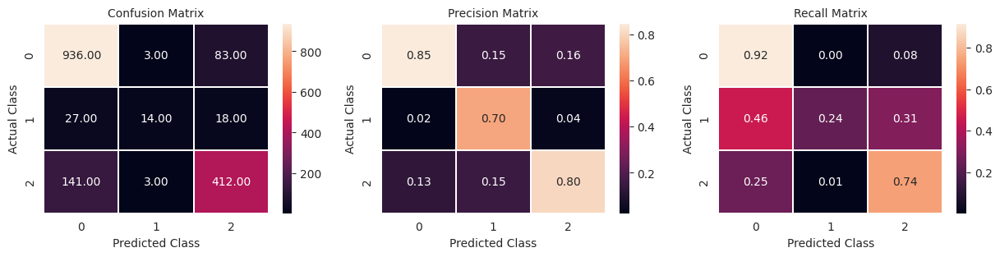


               precision    recall  f1-score   support

           0       0.85      0.92      0.88      1022
           1       0.70      0.24      0.35        59
           2       0.80      0.74      0.77       556

    accuracy                           0.83      1637
   macro avg       0.78      0.63      0.67      1637
weighted avg       0.83      0.83      0.82      1637

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
Test log_loss: 0.46%

Running CV 1

Start training the model...
[LightGBM] [Info] Total Bins 1772
[LightGBM] [Info] Number of data points in the train set: 6545, number of used features: 36
[LightGBM] [Info] Start training from score -0.470401
[LightGBM] [Info] Start training from score -3.326871
[LightGBM] [Info] Start training from score -1.080744
Training until validation scores don't improve for 25 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

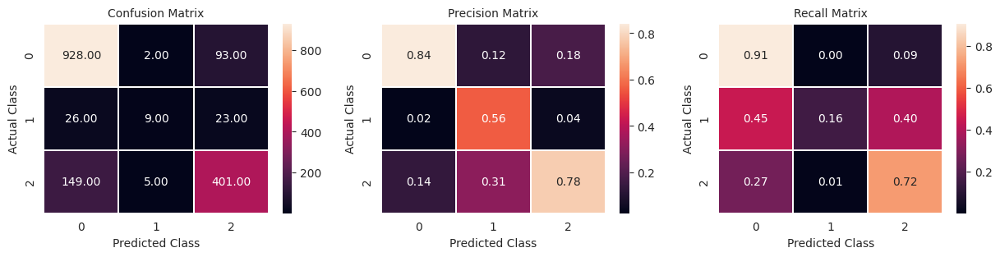


               precision    recall  f1-score   support

           0       0.84      0.91      0.87      1023
           1       0.56      0.16      0.24        58
           2       0.78      0.72      0.75       555

    accuracy                           0.82      1636
   macro avg       0.73      0.59      0.62      1636
weighted avg       0.81      0.82      0.81      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_lgbm_v2_cal/ already exists
Test log_loss: 0.49%

Running CV 2

Start training the model...
[LightGBM] [Info] Total Bins 1781
[LightGBM] [Info] Number of data points in the train set: 6545, number of used features: 36
[LightGBM] [Info] Start training from score -0.470401
[LightGBM] [Info] Start training from score -3.326871
[LightGBM] [Info] Start training from score -1.080744
[LightGBM] [Warning] No further splits with pos

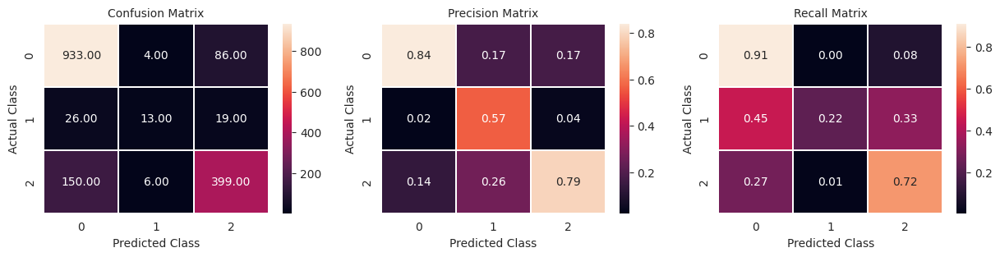


               precision    recall  f1-score   support

           0       0.84      0.91      0.88      1023
           1       0.57      0.22      0.32        58
           2       0.79      0.72      0.75       555

    accuracy                           0.82      1636
   macro avg       0.73      0.62      0.65      1636
weighted avg       0.81      0.82      0.81      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_lgbm_v2_cal/ already exists
Test log_loss: 0.47%

Running CV 3

Start training the model...
[LightGBM] [Info] Total Bins 1770
[LightGBM] [Info] Number of data points in the train set: 6545, number of used features: 36
[LightGBM] [Info] Start training from score -0.470156
[LightGBM] [Info] Start training from score -3.331136
[LightGBM] [Info] Start training from score -1.080744
[LightGBM] [Warning] No further splits with pos

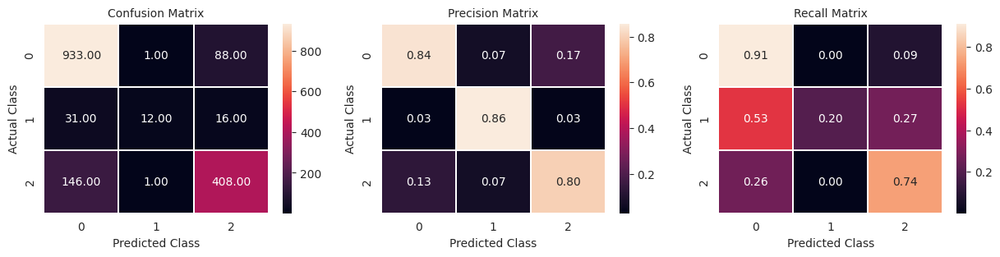


               precision    recall  f1-score   support

           0       0.84      0.91      0.88      1022
           1       0.86      0.20      0.33        59
           2       0.80      0.74      0.76       555

    accuracy                           0.83      1636
   macro avg       0.83      0.62      0.66      1636
weighted avg       0.83      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_lgbm_v2_cal/ already exists
Test log_loss: 0.45%

Running CV 4

Start training the model...
[LightGBM] [Info] Total Bins 1773
[LightGBM] [Info] Number of data points in the train set: 6545, number of used features: 36
[LightGBM] [Info] Start training from score -0.470156
[LightGBM] [Info] Start training from score -3.331136
[LightGBM] [Info] Start training from score -1.080744
[LightGBM] [Warning] No further splits with pos

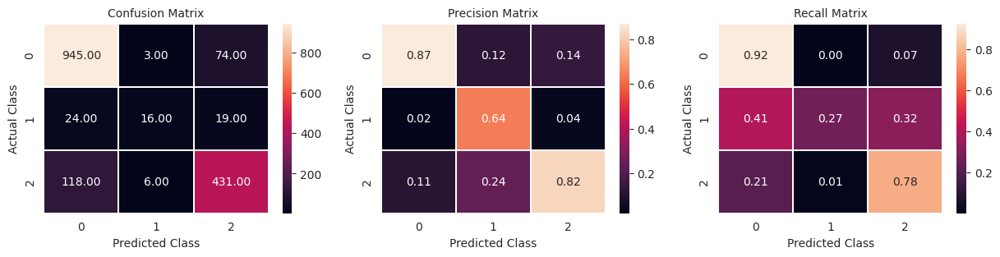


               precision    recall  f1-score   support

           0       0.87      0.92      0.90      1022
           1       0.64      0.27      0.38        59
           2       0.82      0.78      0.80       555

    accuracy                           0.85      1636
   macro avg       0.78      0.66      0.69      1636
weighted avg       0.85      0.85      0.84      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_lgbm_v2_cal/ already exists
Test log_loss: 0.42%

Running CV 5

Start training the model...
[LightGBM] [Info] Total Bins 1772
[LightGBM] [Info] Number of data points in the train set: 6544, number of used features: 36
[LightGBM] [Info] Start training from score -0.470004
[LightGBM] [Info] Start training from score -3.330983
[LightGBM] [Info] Start training from score -1.081041
[LightGBM] [Warning] No further splits with pos

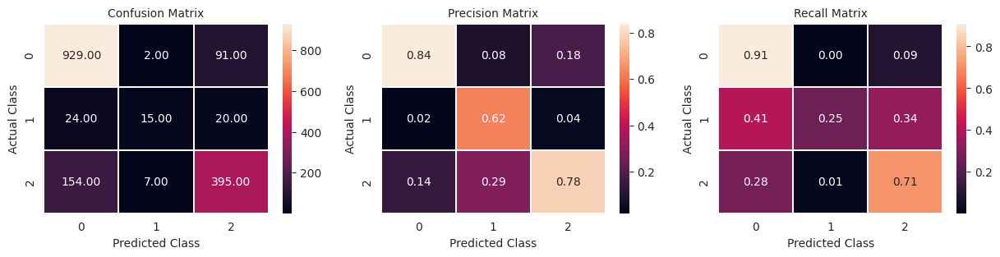


               precision    recall  f1-score   support

           0       0.84      0.91      0.87      1022
           1       0.62      0.25      0.36        59
           2       0.78      0.71      0.74       556

    accuracy                           0.82      1637
   macro avg       0.75      0.62      0.66      1637
weighted avg       0.81      0.82      0.81      1637

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_lgbm_v2_cal/ already exists
Test log_loss: 0.48%

Running CV 6

Start training the model...
[LightGBM] [Info] Total Bins 1778
[LightGBM] [Info] Number of data points in the train set: 6545, number of used features: 36
[LightGBM] [Info] Start training from score -0.470401
[LightGBM] [Info] Start training from score -3.326871
[LightGBM] [Info] Start training from score -1.080744
[LightGBM] [Warning] No further splits with pos

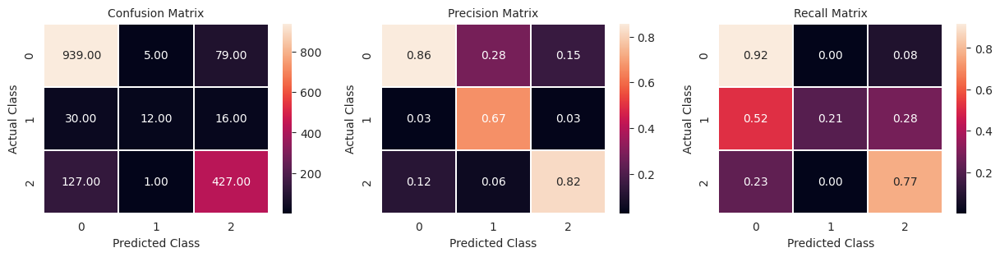


               precision    recall  f1-score   support

           0       0.86      0.92      0.89      1023
           1       0.67      0.21      0.32        58
           2       0.82      0.77      0.79       555

    accuracy                           0.84      1636
   macro avg       0.78      0.63      0.66      1636
weighted avg       0.84      0.84      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_lgbm_v2_cal/ already exists
Test log_loss: 0.45%

Running CV 7

Start training the model...
[LightGBM] [Info] Total Bins 1778
[LightGBM] [Info] Number of data points in the train set: 6545, number of used features: 36
[LightGBM] [Info] Start training from score -0.470401
[LightGBM] [Info] Start training from score -3.326871
[LightGBM] [Info] Start training from score -1.080744
[LightGBM] [Warning] No further splits with pos

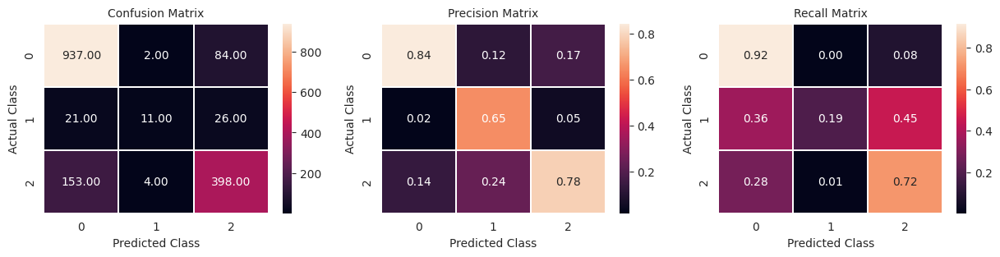


               precision    recall  f1-score   support

           0       0.84      0.92      0.88      1023
           1       0.65      0.19      0.29        58
           2       0.78      0.72      0.75       555

    accuracy                           0.82      1636
   macro avg       0.76      0.61      0.64      1636
weighted avg       0.82      0.82      0.81      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_lgbm_v2_cal/ already exists
Test log_loss: 0.48%

Running CV 8

Start training the model...
[LightGBM] [Info] Total Bins 1774
[LightGBM] [Info] Number of data points in the train set: 6545, number of used features: 36
[LightGBM] [Info] Start training from score -0.470156
[LightGBM] [Info] Start training from score -3.331136
[LightGBM] [Info] Start training from score -1.080744
[LightGBM] [Warning] No further splits with pos

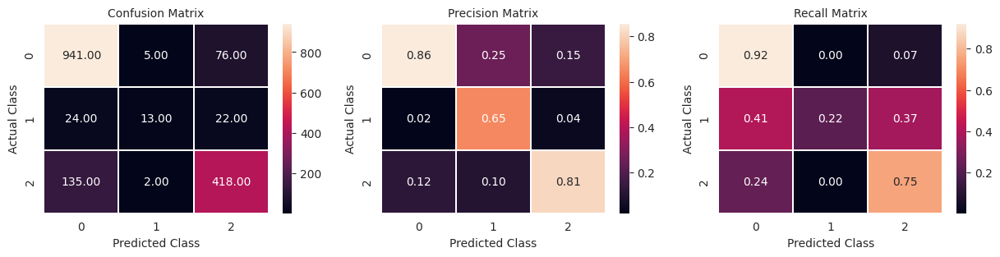


               precision    recall  f1-score   support

           0       0.86      0.92      0.89      1022
           1       0.65      0.22      0.33        59
           2       0.81      0.75      0.78       555

    accuracy                           0.84      1636
   macro avg       0.77      0.63      0.67      1636
weighted avg       0.83      0.84      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_lgbm_v2_cal/ already exists
Test log_loss: 0.46%

Running CV 9

Start training the model...
[LightGBM] [Info] Total Bins 1777
[LightGBM] [Info] Number of data points in the train set: 6545, number of used features: 36
[LightGBM] [Info] Start training from score -0.470156
[LightGBM] [Info] Start training from score -3.331136
[LightGBM] [Info] Start training from score -1.080744
[LightGBM] [Warning] No further splits with pos

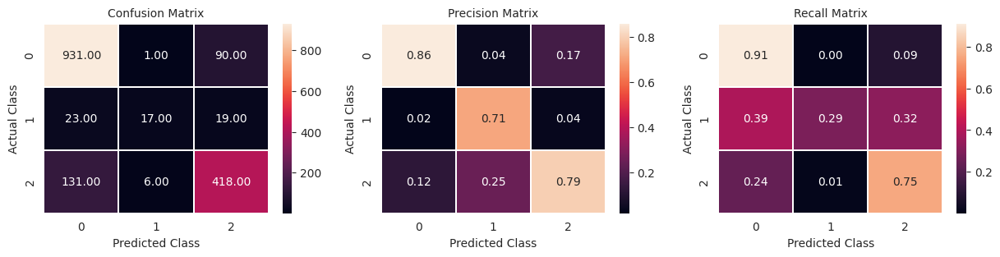


               precision    recall  f1-score   support

           0       0.86      0.91      0.88      1022
           1       0.71      0.29      0.41        59
           2       0.79      0.75      0.77       555

    accuracy                           0.83      1636
   macro avg       0.79      0.65      0.69      1636
weighted avg       0.83      0.83      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_lgbm_v2_cal/ already exists
Test log_loss: 0.43%

Running CV 10

Start training the model...
[LightGBM] [Info] Total Bins 1784
[LightGBM] [Info] Number of data points in the train set: 6544, number of used features: 36
[LightGBM] [Info] Start training from score -0.470004
[LightGBM] [Info] Start training from score -3.330983
[LightGBM] [Info] Start training from score -1.081041
[LightGBM] [Warning] No further splits with po

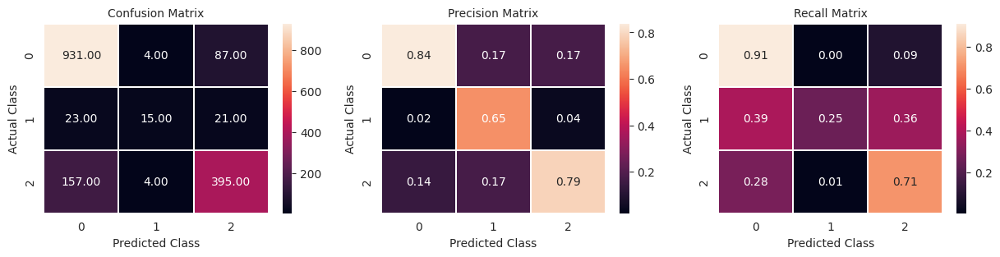


               precision    recall  f1-score   support

           0       0.84      0.91      0.87      1022
           1       0.65      0.25      0.37        59
           2       0.79      0.71      0.75       556

    accuracy                           0.82      1637
   macro avg       0.76      0.63      0.66      1637
weighted avg       0.81      0.82      0.81      1637

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_lgbm_v2_cal/ already exists
Test log_loss: 0.48%

Running CV 11

Start training the model...
[LightGBM] [Info] Total Bins 1770
[LightGBM] [Info] Number of data points in the train set: 6545, number of used features: 36
[LightGBM] [Info] Start training from score -0.470401
[LightGBM] [Info] Start training from score -3.326871
[LightGBM] [Info] Start training from score -1.080744
[LightGBM] [Warning] No further splits with po

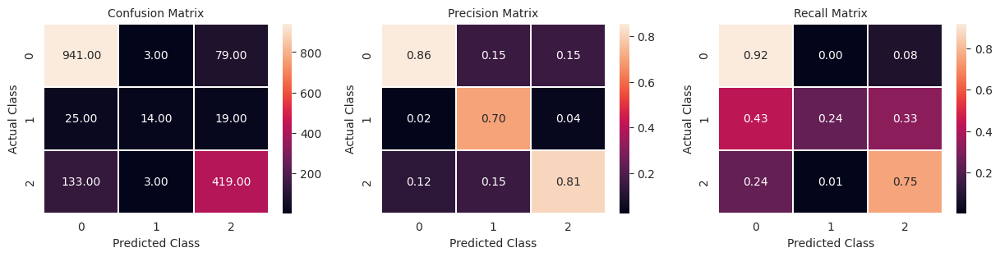


               precision    recall  f1-score   support

           0       0.86      0.92      0.89      1023
           1       0.70      0.24      0.36        58
           2       0.81      0.75      0.78       555

    accuracy                           0.84      1636
   macro avg       0.79      0.64      0.68      1636
weighted avg       0.84      0.84      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_lgbm_v2_cal/ already exists
Test log_loss: 0.45%

Running CV 12

Start training the model...
[LightGBM] [Info] Total Bins 1778
[LightGBM] [Info] Number of data points in the train set: 6545, number of used features: 36
[LightGBM] [Info] Start training from score -0.470401
[LightGBM] [Info] Start training from score -3.326871
[LightGBM] [Info] Start training from score -1.080744
[LightGBM] [Warning] No further splits with po

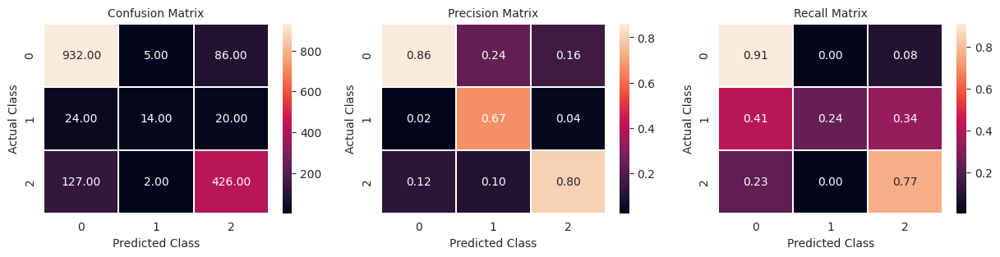


               precision    recall  f1-score   support

           0       0.86      0.91      0.89      1023
           1       0.67      0.24      0.35        58
           2       0.80      0.77      0.78       555

    accuracy                           0.84      1636
   macro avg       0.78      0.64      0.67      1636
weighted avg       0.83      0.84      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_lgbm_v2_cal/ already exists
Test log_loss: 0.43%

Running CV 13

Start training the model...
[LightGBM] [Info] Total Bins 1776
[LightGBM] [Info] Number of data points in the train set: 6545, number of used features: 36
[LightGBM] [Info] Start training from score -0.470156
[LightGBM] [Info] Start training from score -3.331136
[LightGBM] [Info] Start training from score -1.080744
Training until validation scores don't improve

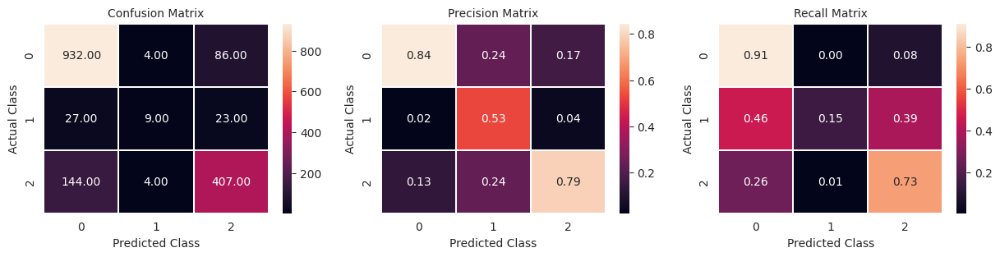


               precision    recall  f1-score   support

           0       0.84      0.91      0.88      1022
           1       0.53      0.15      0.24        59
           2       0.79      0.73      0.76       555

    accuracy                           0.82      1636
   macro avg       0.72      0.60      0.62      1636
weighted avg       0.81      0.82      0.81      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_lgbm_v2_cal/ already exists
Test log_loss: 0.46%

Running CV 14

Start training the model...
[LightGBM] [Info] Total Bins 1777
[LightGBM] [Info] Number of data points in the train set: 6545, number of used features: 36
[LightGBM] [Info] Start training from score -0.470156
[LightGBM] [Info] Start training from score -3.331136
[LightGBM] [Info] Start training from score -1.080744
Training until validation scores don't improve

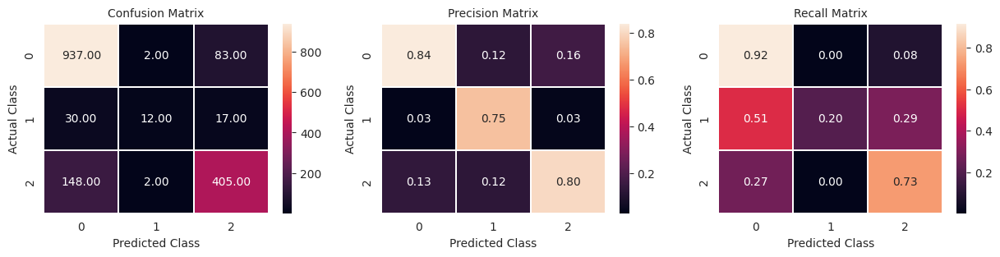


               precision    recall  f1-score   support

           0       0.84      0.92      0.88      1022
           1       0.75      0.20      0.32        59
           2       0.80      0.73      0.76       555

    accuracy                           0.83      1636
   macro avg       0.80      0.62      0.65      1636
weighted avg       0.82      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_lgbm_v2_cal/ already exists
Test log_loss: 0.47%

Running CV 15

Start training the model...
[LightGBM] [Info] Total Bins 1779
[LightGBM] [Info] Number of data points in the train set: 6544, number of used features: 36
[LightGBM] [Info] Start training from score -0.470004
[LightGBM] [Info] Start training from score -3.330983
[LightGBM] [Info] Start training from score -1.081041
[LightGBM] [Warning] No further splits with po

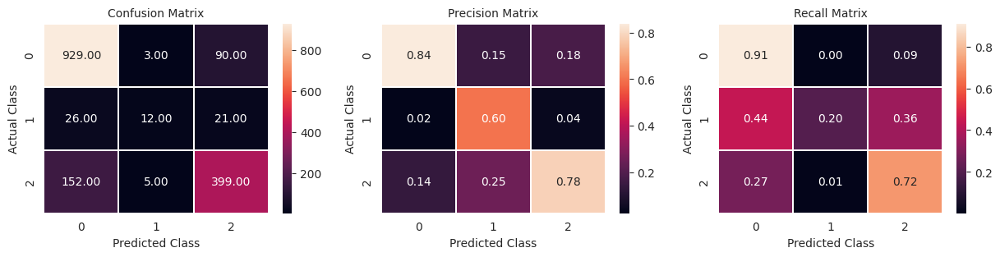


               precision    recall  f1-score   support

           0       0.84      0.91      0.87      1022
           1       0.60      0.20      0.30        59
           2       0.78      0.72      0.75       556

    accuracy                           0.82      1637
   macro avg       0.74      0.61      0.64      1637
weighted avg       0.81      0.82      0.81      1637

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_lgbm_v2_cal/ already exists
Test log_loss: 0.49%

Running CV 16

Start training the model...
[LightGBM] [Info] Total Bins 1780
[LightGBM] [Info] Number of data points in the train set: 6545, number of used features: 36
[LightGBM] [Info] Start training from score -0.470401
[LightGBM] [Info] Start training from score -3.326871
[LightGBM] [Info] Start training from score -1.080744
[LightGBM] [Warning] No further splits with po

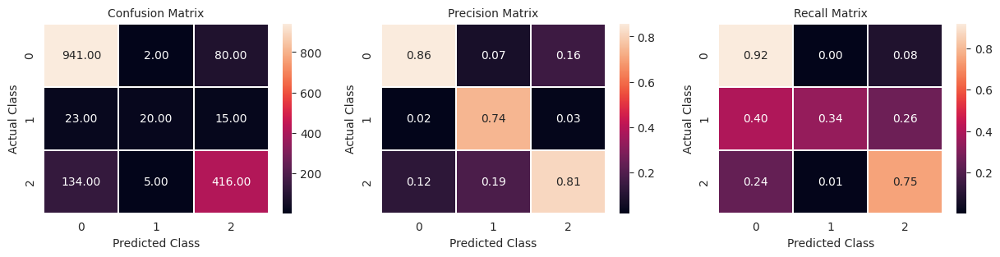


               precision    recall  f1-score   support

           0       0.86      0.92      0.89      1023
           1       0.74      0.34      0.47        58
           2       0.81      0.75      0.78       555

    accuracy                           0.84      1636
   macro avg       0.80      0.67      0.71      1636
weighted avg       0.84      0.84      0.84      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_lgbm_v2_cal/ already exists
Test log_loss: 0.42%

Running CV 17

Start training the model...
[LightGBM] [Info] Total Bins 1778
[LightGBM] [Info] Number of data points in the train set: 6545, number of used features: 36
[LightGBM] [Info] Start training from score -0.470401
[LightGBM] [Info] Start training from score -3.326871
[LightGBM] [Info] Start training from score -1.080744
[LightGBM] [Warning] No further splits with po

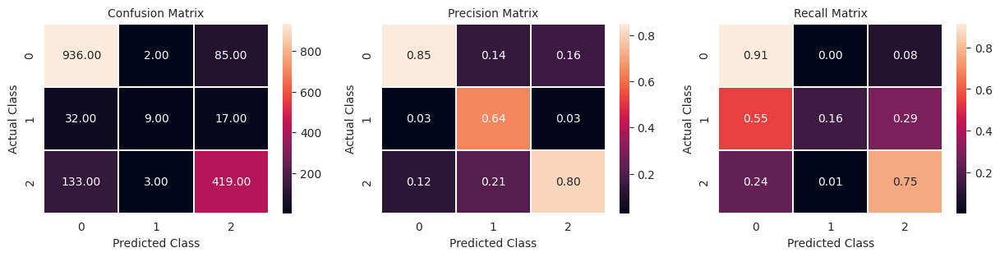


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1023
           1       0.64      0.16      0.25        58
           2       0.80      0.75      0.78       555

    accuracy                           0.83      1636
   macro avg       0.77      0.61      0.64      1636
weighted avg       0.83      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_lgbm_v2_cal/ already exists
Test log_loss: 0.46%

Running CV 18

Start training the model...
[LightGBM] [Info] Total Bins 1779
[LightGBM] [Info] Number of data points in the train set: 6545, number of used features: 36
[LightGBM] [Info] Start training from score -0.470156
[LightGBM] [Info] Start training from score -3.331136
[LightGBM] [Info] Start training from score -1.080744
[LightGBM] [Warning] No further splits with po

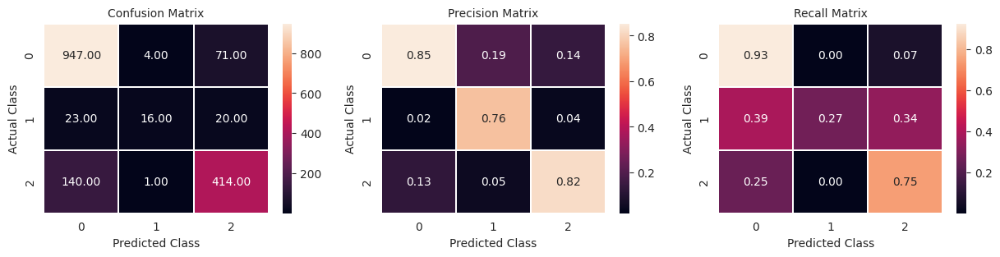


               precision    recall  f1-score   support

           0       0.85      0.93      0.89      1022
           1       0.76      0.27      0.40        59
           2       0.82      0.75      0.78       555

    accuracy                           0.84      1636
   macro avg       0.81      0.65      0.69      1636
weighted avg       0.84      0.84      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_lgbm_v2_cal/ already exists
Test log_loss: 0.44%

Running CV 19

Start training the model...
[LightGBM] [Info] Total Bins 1774
[LightGBM] [Info] Number of data points in the train set: 6545, number of used features: 36
[LightGBM] [Info] Start training from score -0.470156
[LightGBM] [Info] Start training from score -3.331136
[LightGBM] [Info] Start training from score -1.080744
Training until validation scores don't improve

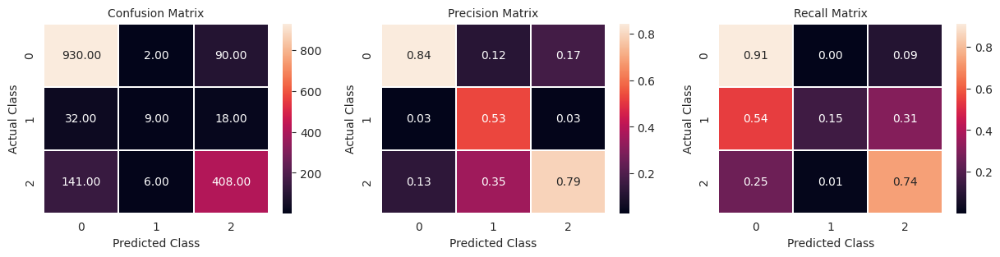


               precision    recall  f1-score   support

           0       0.84      0.91      0.88      1022
           1       0.53      0.15      0.24        59
           2       0.79      0.74      0.76       555

    accuracy                           0.82      1636
   macro avg       0.72      0.60      0.62      1636
weighted avg       0.81      0.82      0.81      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_lgbm_v2_cal/ already exists
Test log_loss: 0.48%

Running CV 20

Start training the model...
[LightGBM] [Info] Total Bins 1774
[LightGBM] [Info] Number of data points in the train set: 6544, number of used features: 36
[LightGBM] [Info] Start training from score -0.470004
[LightGBM] [Info] Start training from score -3.330983
[LightGBM] [Info] Start training from score -1.081041
[LightGBM] [Warning] No further splits with po

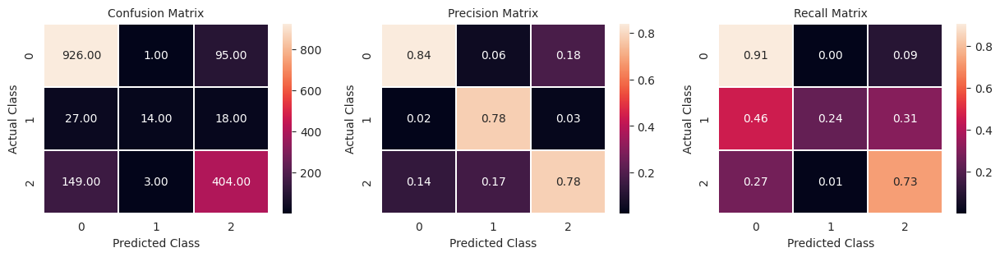


               precision    recall  f1-score   support

           0       0.84      0.91      0.87      1022
           1       0.78      0.24      0.36        59
           2       0.78      0.73      0.75       556

    accuracy                           0.82      1637
   macro avg       0.80      0.62      0.66      1637
weighted avg       0.82      0.82      0.81      1637

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_lgbm_v2_cal/ already exists
Test log_loss: 0.47%

Running CV 21

Start training the model...
[LightGBM] [Info] Total Bins 1781
[LightGBM] [Info] Number of data points in the train set: 6545, number of used features: 36
[LightGBM] [Info] Start training from score -0.470401
[LightGBM] [Info] Start training from score -3.326871
[LightGBM] [Info] Start training from score -1.080744
[LightGBM] [Warning] No further splits with po

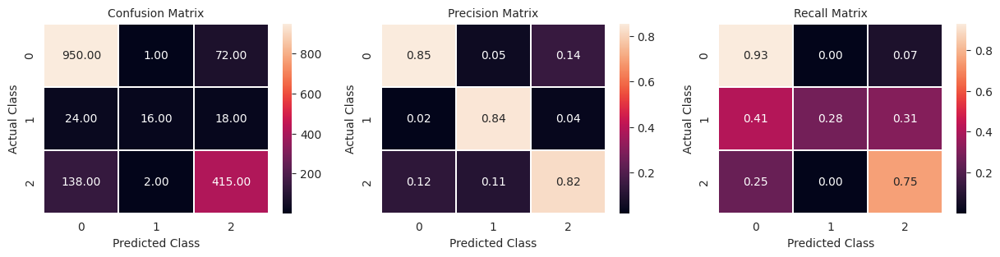


               precision    recall  f1-score   support

           0       0.85      0.93      0.89      1023
           1       0.84      0.28      0.42        58
           2       0.82      0.75      0.78       555

    accuracy                           0.84      1636
   macro avg       0.84      0.65      0.70      1636
weighted avg       0.84      0.84      0.84      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_lgbm_v2_cal/ already exists
Test log_loss: 0.44%

Running CV 22

Start training the model...
[LightGBM] [Info] Total Bins 1772
[LightGBM] [Info] Number of data points in the train set: 6545, number of used features: 36
[LightGBM] [Info] Start training from score -0.470401
[LightGBM] [Info] Start training from score -3.326871
[LightGBM] [Info] Start training from score -1.080744
[LightGBM] [Warning] No further splits with po

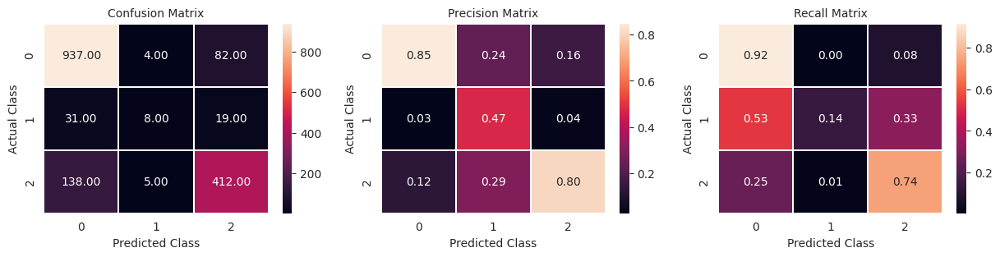


               precision    recall  f1-score   support

           0       0.85      0.92      0.88      1023
           1       0.47      0.14      0.21        58
           2       0.80      0.74      0.77       555

    accuracy                           0.83      1636
   macro avg       0.71      0.60      0.62      1636
weighted avg       0.82      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_lgbm_v2_cal/ already exists
Test log_loss: 0.46%

Running CV 23

Start training the model...
[LightGBM] [Info] Total Bins 1776
[LightGBM] [Info] Number of data points in the train set: 6545, number of used features: 36
[LightGBM] [Info] Start training from score -0.470156
[LightGBM] [Info] Start training from score -3.331136
[LightGBM] [Info] Start training from score -1.080744
[LightGBM] [Warning] No further splits with po

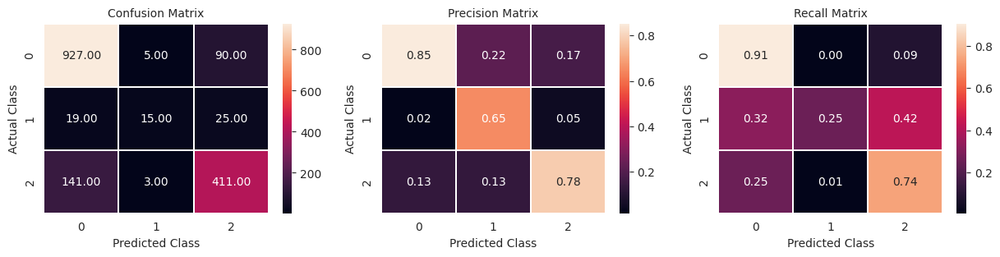


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1022
           1       0.65      0.25      0.37        59
           2       0.78      0.74      0.76       555

    accuracy                           0.83      1636
   macro avg       0.76      0.63      0.67      1636
weighted avg       0.82      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_lgbm_v2_cal/ already exists
Test log_loss: 0.46%

Running CV 24

Start training the model...
[LightGBM] [Info] Total Bins 1777
[LightGBM] [Info] Number of data points in the train set: 6545, number of used features: 36
[LightGBM] [Info] Start training from score -0.470156
[LightGBM] [Info] Start training from score -3.331136
[LightGBM] [Info] Start training from score -1.080744
[LightGBM] [Warning] No further splits with po

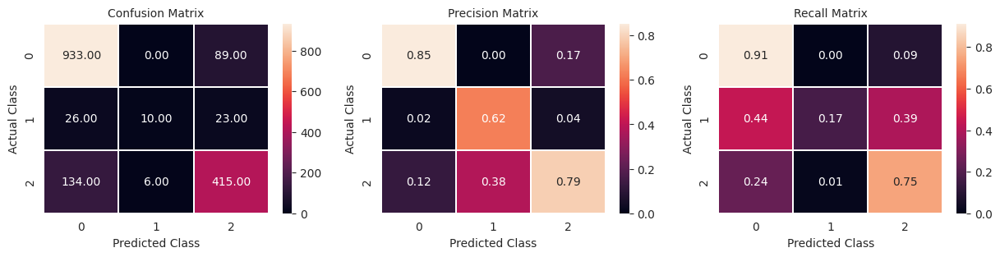


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1022
           1       0.62      0.17      0.27        59
           2       0.79      0.75      0.77       555

    accuracy                           0.83      1636
   macro avg       0.76      0.61      0.64      1636
weighted avg       0.82      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_lgbm_v2_cal/ already exists
Test log_loss: 0.46%

Running CV 25

Start training the model...
[LightGBM] [Info] Total Bins 1780
[LightGBM] [Info] Number of data points in the train set: 6544, number of used features: 36
[LightGBM] [Info] Start training from score -0.470004
[LightGBM] [Info] Start training from score -3.330983
[LightGBM] [Info] Start training from score -1.081041
[LightGBM] [Warning] No further splits with po

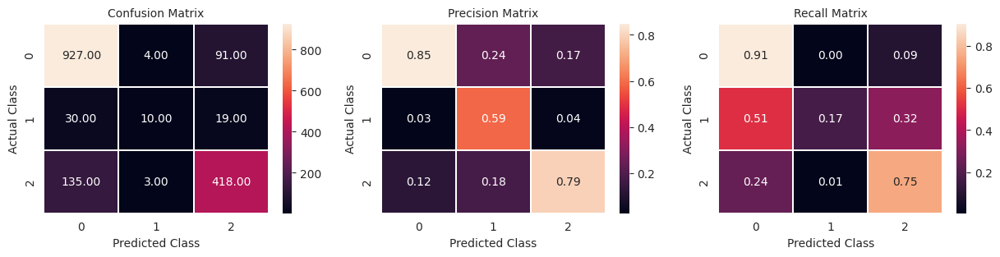


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1022
           1       0.59      0.17      0.26        59
           2       0.79      0.75      0.77       556

    accuracy                           0.83      1637
   macro avg       0.74      0.61      0.64      1637
weighted avg       0.82      0.83      0.82      1637

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_lgbm_v2_cal/ already exists
Test log_loss: 0.47%

Running CV 26

Start training the model...
[LightGBM] [Info] Total Bins 1772
[LightGBM] [Info] Number of data points in the train set: 6545, number of used features: 36
[LightGBM] [Info] Start training from score -0.470401
[LightGBM] [Info] Start training from score -3.326871
[LightGBM] [Info] Start training from score -1.080744
[LightGBM] [Warning] No further splits with po

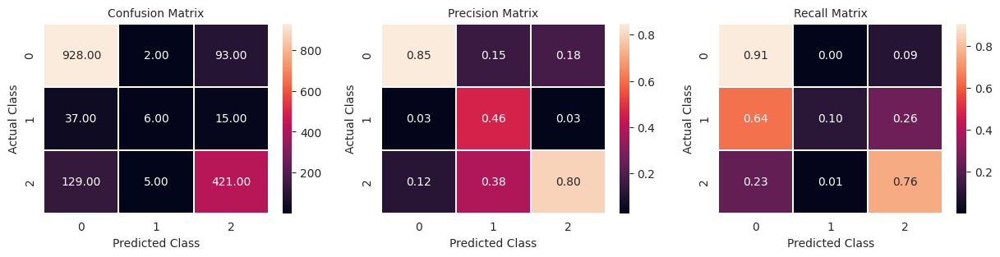


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1023
           1       0.46      0.10      0.17        58
           2       0.80      0.76      0.78       555

    accuracy                           0.83      1636
   macro avg       0.70      0.59      0.61      1636
weighted avg       0.82      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_lgbm_v2_cal/ already exists
Test log_loss: 0.47%

Running CV 27

Start training the model...
[LightGBM] [Info] Total Bins 1776
[LightGBM] [Info] Number of data points in the train set: 6545, number of used features: 36
[LightGBM] [Info] Start training from score -0.470401
[LightGBM] [Info] Start training from score -3.326871
[LightGBM] [Info] Start training from score -1.080744
Training until validation scores don't improve

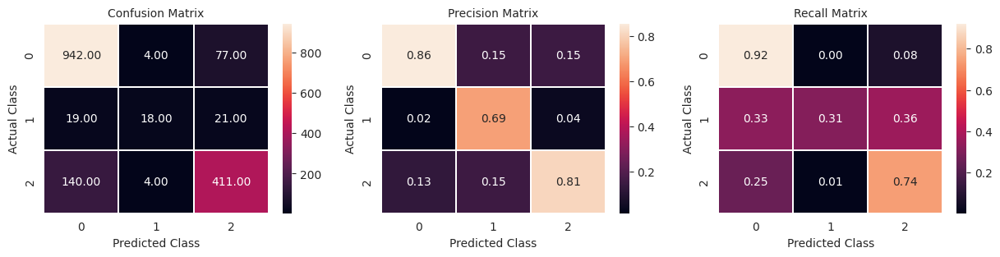


               precision    recall  f1-score   support

           0       0.86      0.92      0.89      1023
           1       0.69      0.31      0.43        58
           2       0.81      0.74      0.77       555

    accuracy                           0.84      1636
   macro avg       0.79      0.66      0.70      1636
weighted avg       0.83      0.84      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_lgbm_v2_cal/ already exists
Test log_loss: 0.43%

Running CV 28

Start training the model...
[LightGBM] [Info] Total Bins 1776
[LightGBM] [Info] Number of data points in the train set: 6545, number of used features: 36
[LightGBM] [Info] Start training from score -0.470156
[LightGBM] [Info] Start training from score -3.331136
[LightGBM] [Info] Start training from score -1.080744
[LightGBM] [Warning] No further splits with po

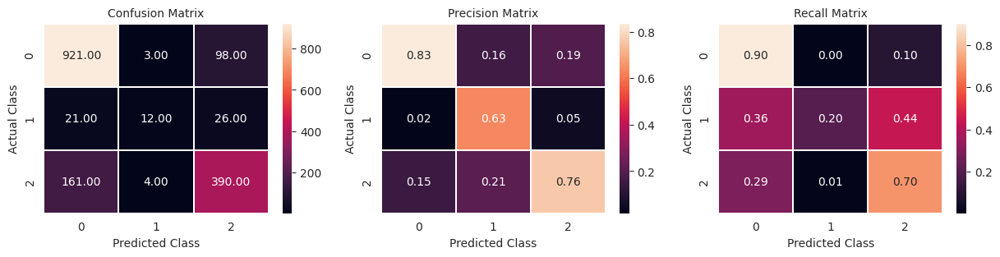


               precision    recall  f1-score   support

           0       0.83      0.90      0.87      1022
           1       0.63      0.20      0.31        59
           2       0.76      0.70      0.73       555

    accuracy                           0.81      1636
   macro avg       0.74      0.60      0.63      1636
weighted avg       0.80      0.81      0.80      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_lgbm_v2_cal/ already exists
Test log_loss: 0.5%

Running CV 29

Start training the model...
[LightGBM] [Info] Total Bins 1777
[LightGBM] [Info] Number of data points in the train set: 6545, number of used features: 36
[LightGBM] [Info] Start training from score -0.470156
[LightGBM] [Info] Start training from score -3.331136
[LightGBM] [Info] Start training from score -1.080744
[LightGBM] [Warning] No further splits with pos

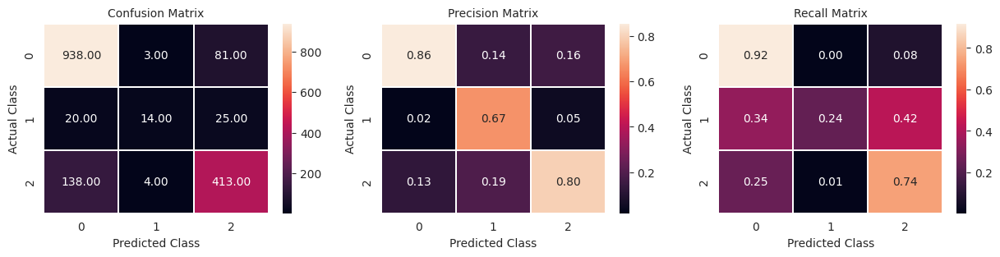


               precision    recall  f1-score   support

           0       0.86      0.92      0.89      1022
           1       0.67      0.24      0.35        59
           2       0.80      0.74      0.77       555

    accuracy                           0.83      1636
   macro avg       0.77      0.63      0.67      1636
weighted avg       0.83      0.83      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_lgbm_v2_cal/ already exists
Test log_loss: 0.45%

Running CV 30

Start training the model...
[LightGBM] [Info] Total Bins 1771
[LightGBM] [Info] Number of data points in the train set: 6544, number of used features: 36
[LightGBM] [Info] Start training from score -0.470004
[LightGBM] [Info] Start training from score -3.330983
[LightGBM] [Info] Start training from score -1.081041
[LightGBM] [Warning] No further splits with po

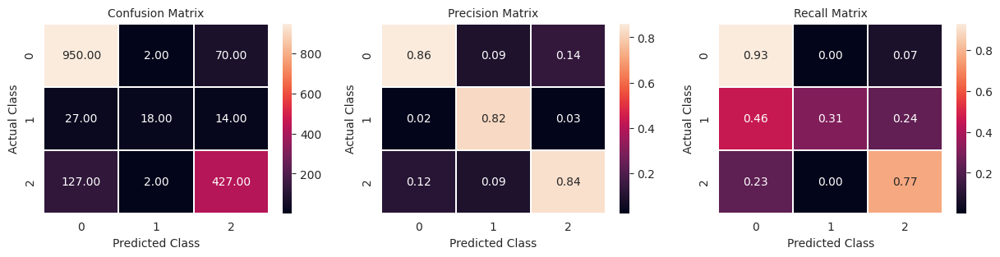


               precision    recall  f1-score   support

           0       0.86      0.93      0.89      1022
           1       0.82      0.31      0.44        59
           2       0.84      0.77      0.80       556

    accuracy                           0.85      1637
   macro avg       0.84      0.67      0.71      1637
weighted avg       0.85      0.85      0.85      1637

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_lgbm_v2_cal/ already exists
Test log_loss: 0.42%

Running CV 31

Start training the model...
[LightGBM] [Info] Total Bins 1773
[LightGBM] [Info] Number of data points in the train set: 6545, number of used features: 36
[LightGBM] [Info] Start training from score -0.470401
[LightGBM] [Info] Start training from score -3.326871
[LightGBM] [Info] Start training from score -1.080744
[LightGBM] [Warning] No further splits with po

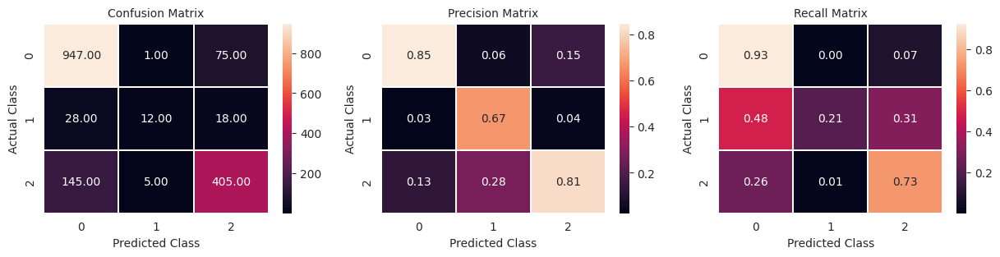


               precision    recall  f1-score   support

           0       0.85      0.93      0.88      1023
           1       0.67      0.21      0.32        58
           2       0.81      0.73      0.77       555

    accuracy                           0.83      1636
   macro avg       0.78      0.62      0.66      1636
weighted avg       0.83      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_lgbm_v2_cal/ already exists
Test log_loss: 0.46%

Running CV 32

Start training the model...
[LightGBM] [Info] Total Bins 1776
[LightGBM] [Info] Number of data points in the train set: 6545, number of used features: 36
[LightGBM] [Info] Start training from score -0.470401
[LightGBM] [Info] Start training from score -3.326871
[LightGBM] [Info] Start training from score -1.080744
[LightGBM] [Warning] No further splits with po

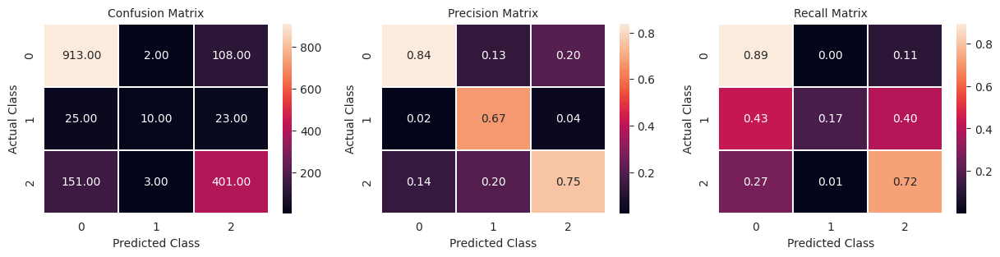


               precision    recall  f1-score   support

           0       0.84      0.89      0.86      1023
           1       0.67      0.17      0.27        58
           2       0.75      0.72      0.74       555

    accuracy                           0.81      1636
   macro avg       0.75      0.60      0.63      1636
weighted avg       0.80      0.81      0.80      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_lgbm_v2_cal/ already exists
Test log_loss: 0.49%

Running CV 33

Start training the model...
[LightGBM] [Info] Total Bins 1770
[LightGBM] [Info] Number of data points in the train set: 6545, number of used features: 36
[LightGBM] [Info] Start training from score -0.470156
[LightGBM] [Info] Start training from score -3.331136
[LightGBM] [Info] Start training from score -1.080744
[LightGBM] [Warning] No further splits with po

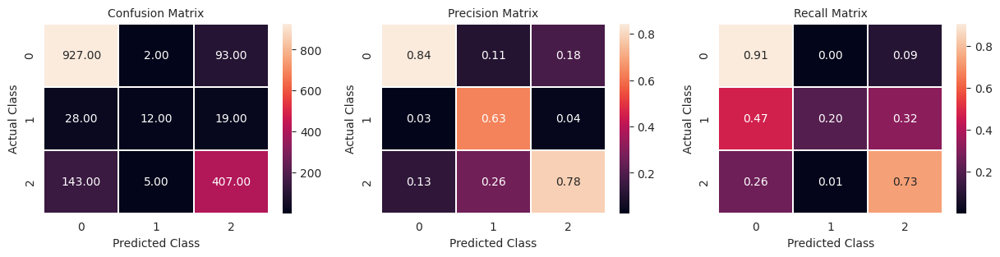


               precision    recall  f1-score   support

           0       0.84      0.91      0.87      1022
           1       0.63      0.20      0.31        59
           2       0.78      0.73      0.76       555

    accuracy                           0.82      1636
   macro avg       0.75      0.61      0.65      1636
weighted avg       0.82      0.82      0.81      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_lgbm_v2_cal/ already exists
Test log_loss: 0.48%

Running CV 34

Start training the model...
[LightGBM] [Info] Total Bins 1780
[LightGBM] [Info] Number of data points in the train set: 6545, number of used features: 36
[LightGBM] [Info] Start training from score -0.470156
[LightGBM] [Info] Start training from score -3.331136
[LightGBM] [Info] Start training from score -1.080744
Training until validation scores don't improve

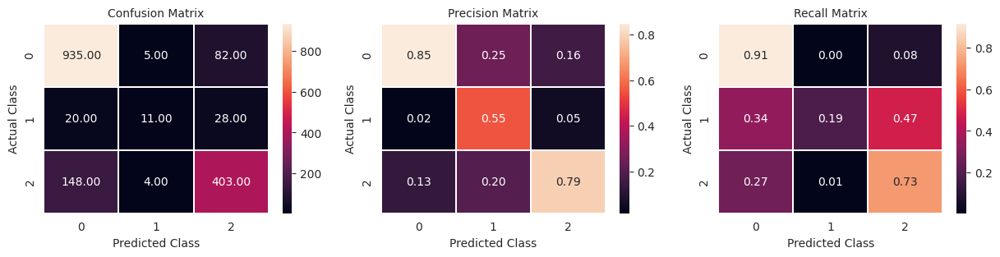


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1022
           1       0.55      0.19      0.28        59
           2       0.79      0.73      0.75       555

    accuracy                           0.82      1636
   macro avg       0.73      0.61      0.64      1636
weighted avg       0.82      0.82      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_lgbm_v2_cal/ already exists
Test log_loss: 0.47%

Running CV 35

Start training the model...
[LightGBM] [Info] Total Bins 1777
[LightGBM] [Info] Number of data points in the train set: 6544, number of used features: 36
[LightGBM] [Info] Start training from score -0.470004
[LightGBM] [Info] Start training from score -3.330983
[LightGBM] [Info] Start training from score -1.081041
[LightGBM] [Warning] No further splits with po

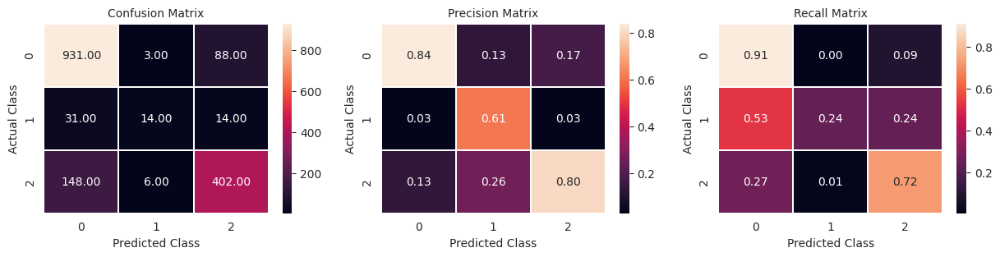


               precision    recall  f1-score   support

           0       0.84      0.91      0.87      1022
           1       0.61      0.24      0.34        59
           2       0.80      0.72      0.76       556

    accuracy                           0.82      1637
   macro avg       0.75      0.62      0.66      1637
weighted avg       0.82      0.82      0.82      1637

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_lgbm_v2_cal/ already exists
Test log_loss: 0.47%

Running CV 36

Start training the model...
[LightGBM] [Info] Total Bins 1783
[LightGBM] [Info] Number of data points in the train set: 6545, number of used features: 36
[LightGBM] [Info] Start training from score -0.470401
[LightGBM] [Info] Start training from score -3.326871
[LightGBM] [Info] Start training from score -1.080744
[LightGBM] [Warning] No further splits with po

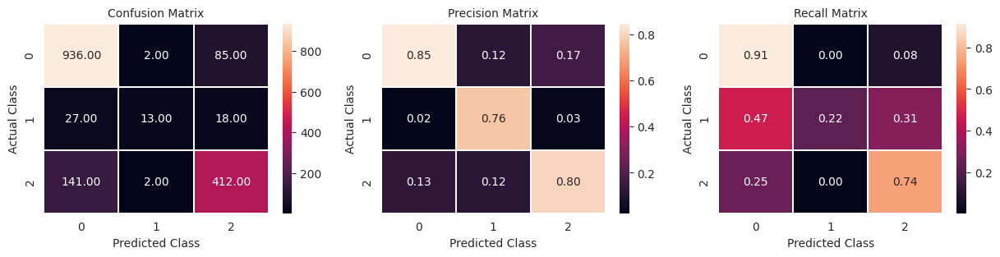


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1023
           1       0.76      0.22      0.35        58
           2       0.80      0.74      0.77       555

    accuracy                           0.83      1636
   macro avg       0.80      0.63      0.67      1636
weighted avg       0.83      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_lgbm_v2_cal/ already exists
Test log_loss: 0.45%

Running CV 37

Start training the model...
[LightGBM] [Info] Total Bins 1774
[LightGBM] [Info] Number of data points in the train set: 6545, number of used features: 36
[LightGBM] [Info] Start training from score -0.470401
[LightGBM] [Info] Start training from score -3.326871
[LightGBM] [Info] Start training from score -1.080744
[LightGBM] [Warning] No further splits with po

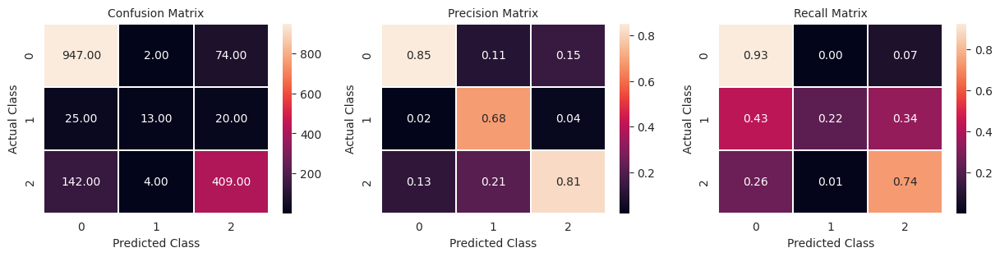


               precision    recall  f1-score   support

           0       0.85      0.93      0.89      1023
           1       0.68      0.22      0.34        58
           2       0.81      0.74      0.77       555

    accuracy                           0.84      1636
   macro avg       0.78      0.63      0.67      1636
weighted avg       0.83      0.84      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_lgbm_v2_cal/ already exists
Test log_loss: 0.45%

Running CV 38

Start training the model...
[LightGBM] [Info] Total Bins 1773
[LightGBM] [Info] Number of data points in the train set: 6545, number of used features: 36
[LightGBM] [Info] Start training from score -0.470156
[LightGBM] [Info] Start training from score -3.331136
[LightGBM] [Info] Start training from score -1.080744
[LightGBM] [Warning] No further splits with po

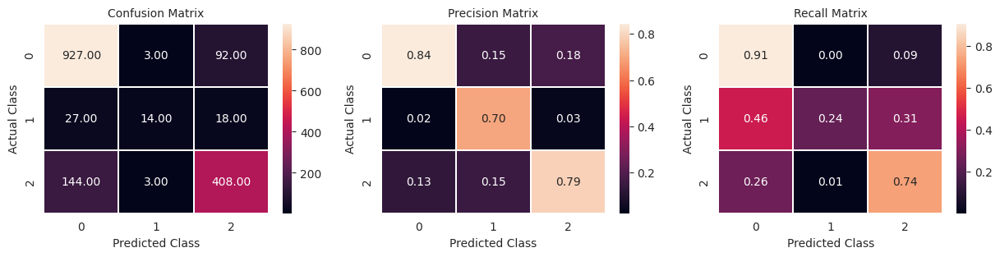


               precision    recall  f1-score   support

           0       0.84      0.91      0.87      1022
           1       0.70      0.24      0.35        59
           2       0.79      0.74      0.76       555

    accuracy                           0.82      1636
   macro avg       0.78      0.63      0.66      1636
weighted avg       0.82      0.82      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_lgbm_v2_cal/ already exists
Test log_loss: 0.47%

Running CV 39

Start training the model...
[LightGBM] [Info] Total Bins 1772
[LightGBM] [Info] Number of data points in the train set: 6545, number of used features: 36
[LightGBM] [Info] Start training from score -0.470156
[LightGBM] [Info] Start training from score -3.331136
[LightGBM] [Info] Start training from score -1.080744
Training until validation scores don't improve

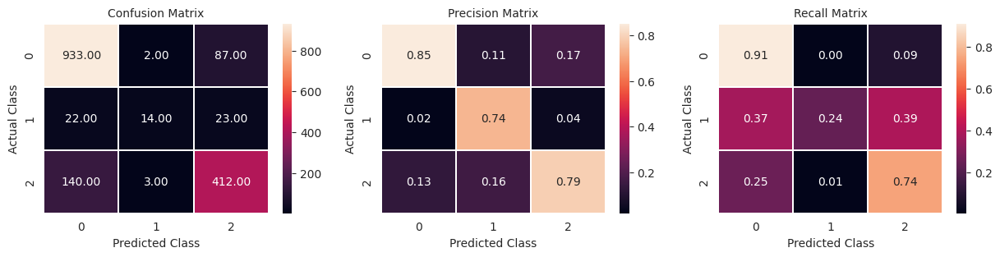


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1022
           1       0.74      0.24      0.36        59
           2       0.79      0.74      0.77       555

    accuracy                           0.83      1636
   macro avg       0.79      0.63      0.67      1636
weighted avg       0.83      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_lgbm_v2_cal/ already exists
Test log_loss: 0.46%
All Valuation lOGlOSS: [0.46, 0.491, 0.466, 0.453, 0.423, 0.478, 0.449, 0.478, 0.456, 0.434, 0.476, 0.454, 0.434, 0.463, 0.466, 0.491, 0.424, 0.465, 0.444, 0.48, 0.474, 0.439, 0.46, 0.457, 0.465, 0.467, 0.469, 0.434, 0.495, 0.451, 0.422, 0.459, 0.494, 0.475, 0.47, 0.468, 0.454, 0.449, 0.473, 0.459]


In [ ]:
test_results_df_C,test_results_df_CL,test_results_df_D, test_results_df = run_experiment(X_train,
                                                                                         X_test,
                                                                                         best_params=best_par,
                                                                                         experiment_name="model_lgbm_v2_cal",
                                                                                         splits=5,
                                                                                         n_repeats=8,
                                                                                         rs=42,
                                                                                         calibrate=True)

In [ ]:
res_cal = [0.467, 0.487, 0.467, 0.461, 0.431, 0.474, 0.447, 0.479, 0.456, 0.445, 0.472, 0.472, 0.434, 0.464, 0.468, 0.483, 0.433, 0.474, 0.445, 0.478,
           0.471, 0.437, 0.466, 0.462, 0.472, 0.466, 0.456, 0.443, 0.492, 0.455, 0.423, 0.467, 0.484, 0.47, 0.468, 0.464, 0.452, 0.453, 0.475, 0.469]

res_unc = [0.465, 0.486, 0.462, 0.458, 0.439, 0.469, 0.451, 0.477, 0.46, 0.446, 0.478, 0.463, 0.439, 0.457, 0.469, 0.476, 0.437, 0.476, 0.449, 0.479,
          0.475, 0.439, 0.458, 0.468, 0.471, 0.467, 0.466, 0.447, 0.486, 0.451, 0.432, 0.471, 0.477, 0.469, 0.466, 0.463, 0.447, 0.452, 0.477, 0.472]

res_lgbm = [0.463, 0.486, 0.463, 0.454, 0.427, 0.475, 0.447, 0.475, 0.452, 0.428, 0.468, 0.458, 0.434, 0.456, 0.468, 0.484, 0.418, 0.462, 0.447, 0.482,
            0.478, 0.437, 0.462, 0.457, 0.469, 0.465, 0.466, 0.431, 0.49, 0.448, 0.411, 0.458, 0.486, 0.468, 0.469, 0.468, 0.455, 0.444, 0.466, 0.461]

res_lgbm_v2_cal = [0.46, 0.491, 0.466, 0.453, 0.423, 0.478, 0.449, 0.478, 0.456, 0.434, 0.476, 0.454, 0.434, 0.463, 0.466, 0.491, 0.424, 0.465, 0.444,
                   0.48, 0.474, 0.439, 0.46, 0.457, 0.465, 0.467, 0.469, 0.434, 0.495, 0.451, 0.422, 0.459, 0.494, 0.475, 0.47, 0.468, 0.454, 0.449, 0.473, 0.459]

res_lgbm_v1_unc = [0.456, 0.475, 0.449, 0.451, 0.416, 0.459, 0.447, 0.468, 0.455, 0.424, 0.469, 0.444, 0.424, 0.45, 0.463, 0.474, 0.413, 0.463, 0.442, 0.47, 0.47,
                   0.432, 0.443, 0.454, 0.454, 0.456, 0.462, 0.424, 0.484, 0.441, 0.41, 0.455, 0.48, 0.467, 0.459, 0.455, 0.434, 0.436, 0.465, 0.457]


np.mean(res_cal),np.mean(res_unc),np.mean(res_lgbm),np.mean(res_lgbm_v2_cal), np.mean(res_lgbm_v1_unc)

(0.46204999999999996,
 0.46225000000000005,
 0.4584,
 0.460475,
 0.45124999999999993)

In [ ]:
test_results_df

,Status_C,Status_CL,Status_D
0,0.811314,0.032447,0.156239
1,0.777118,0.052298,0.170584
2,0.063933,0.020685,0.915382
3,0.910735,0.019820,0.069445
4,0.860495,0.025590,0.113915
...,...,...,...
5266,0.876485,0.032800,0.090716
5267,0.913793,0.019515,0.066692
5268,0.898481,0.020172,0.081347
5269,0.924279,0.020177,0.055543


In [ ]:
experiment_name="model_lgbm_v2_cal"

sub = pd.read_csv("sample_submission.csv", index_col=0)
sub.iloc[:,:] = test_results_df.values
sub.to_csv(f"Results/{experiment_name}.csv")

In [ ]:
sub

,Status_C,Status_CL,Status_D
id,,,
7905,0.811314,0.032447,0.156239
7906,0.777118,0.052298,0.170584
7907,0.063933,0.020685,0.915382
7908,0.910735,0.019820,0.069445
7909,0.860495,0.025590,0.113915
...,...,...,...
13171,0.876485,0.032800,0.090716
13172,0.913793,0.019515,0.066692
13173,0.898481,0.020172,0.081347


### 6.5  XGBClassifer

In [ ]:
X_train = pd.read_csv("new_train.csv", index_col=0)
X_test = pd.read_csv("new_test.csv", index_col=0)

#X_train["weights"] = X_train["Status"]
#X_test["weights"] = 1.0

strat_feature = X_train["Status"]

X_train.drop(columns=["id","Status_C","Status_CL","Status_D",
                    #  "min_class_feat_RF"
                      ]
             ,inplace=True)
X_test.drop(columns=["id","Status_C","Status_CL","Status_D",
                    # "min_class_feat_RF"
                     ],inplace=True)

num_var = X_train.select_dtypes("float").columns
cat_var = X_train.select_dtypes("int").columns

X_train[num_var]=X_train[num_var].astype("float32")
X_train[cat_var]=X_train[cat_var].astype("int32")

X_test[num_var]=X_test[num_var].astype("float32")
X_test[cat_var]=X_test[cat_var].astype("int32")

X_train.Status = X_train.Status.replace({"C":0,"CL":1,"D":2})

X_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8181 entries, 0 to 311
Data columns (total 38 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Drug                            8181 non-null   int32  
 1   Sex                             8181 non-null   int32  
 2   Ascites                         8181 non-null   int32  
 3   Hepatomegaly                    8181 non-null   int32  
 4   Spiders                         8181 non-null   int32  
 5   Edema                           8181 non-null   int32  
 6   Bilirubin                       8181 non-null   float32
 7   Cholesterol                     8181 non-null   float32
 8   Albumin                         8181 non-null   float32
 9   Copper                          8181 non-null   float32
 10  Alk_Phos                        8181 non-null   float32
 11  SGOT                            8181 non-null   float32
 12  Tryglicerides                   818

In [ ]:
X_test.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5271 entries, 0 to 5270
Data columns (total 38 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Drug                            5271 non-null   int32  
 1   Sex                             5271 non-null   int32  
 2   Ascites                         5271 non-null   int32  
 3   Hepatomegaly                    5271 non-null   int32  
 4   Spiders                         5271 non-null   int32  
 5   Edema                           5271 non-null   int32  
 6   Bilirubin                       5271 non-null   float32
 7   Cholesterol                     5271 non-null   float32
 8   Albumin                         5271 non-null   float32
 9   Copper                          5271 non-null   float32
 10  Alk_Phos                        5271 non-null   float32
 11  SGOT                            5271 non-null   float32
 12  Tryglicerides                   52

**Check Unconstrained Model**

In [ ]:
X = X_train.drop(columns=["Status"]).copy()
y = X_train["Status"].copy()

In [ ]:
%%time
skf = RepeatedStratifiedKFold(n_splits=5, n_repeats=5, random_state=48)
clf = XGBClassifier()
cross_val_score(clf, X, y, n_jobs=-1, cv=skf, scoring="neg_log_loss").mean()

CPU times: user 226 ms, sys: 24.7 ms, total: 251 ms
Wall time: 6.13 s


-0.5143040599985368

#### 6.5.1 **Optuna Optimization**

In [ ]:
skf = RepeatedStratifiedKFold(n_splits=4, n_repeats=4, random_state=48)

def objective(trial):

    #train_x, valid_x, train_y, valid_y = train_test_split(X, y, test_size=0.25, stratify=y)
    #dtrain = lgb.Dataset(train_x, label=train_y)
    #dvalid = lgb.Dataset(valid_x, label=valid_y)

    param = {
        'objective': 'multi_logloss', #
        'num_leaves': trial.suggest_int('num_leaves', 60, 70),
        'subsample': trial.suggest_uniform("subsample", 0.45, 0.65),
        'colsample_bytree': trial.suggest_uniform("colsample_bytree", 0.50, 0.70),
        'min_child_samples': trial.suggest_int('min_child_samples', 30, 45),
        'min_child_weight' : trial.suggest_float("min_child_weight", 5e-3, 5e-2, log=True),
        "reg_alpha" : trial.suggest_float("reg_alpha", 5e-4, 1e-2, log=True),
        "reg_lambda" : trial.suggest_float("reg_lambda", 1e-2, 1.0, log=True),
        "n_estimators" : trial.suggest_int('n_estimators', 400, 700),
        "max_depth" : trial.suggest_int('max_depth', 3, 8),
        "learning_rate" : trial.suggest_float("learning_rate",1e-2, 1e-1, log=True)}

    #early_stop = xgb.callback.EarlyStopping(rounds=31, metric_name='multi_logloss', data_name='Validation_0', save_best=True)
    clf = XGBClassifier(random_state = 42,
                       # callbacks=[early_stop],
                        **param)

    score = cross_val_score(clf, X, y, n_jobs=-1, cv=skf, scoring="neg_log_loss").mean()

    return score

In [ ]:
# Create study object
study = optuna.create_study(direction="maximize")

# Run optimization process
study.optimize(objective, n_trials=51, show_progress_bar=True)

[I 2023-12-17 01:58:23,296] A new study created in memory with name: no-name-67451d05-e327-4923-a778-fd6037490367


  0%|          | 0/51 [00:00<?, ?it/s]

[I 2023-12-17 01:58:45,646] Trial 0 finished with value: -0.45791082691494667 and parameters: {'num_leaves': 61, 'subsample': 0.5753907529916996, 'colsample_bytree': 0.6452711349492479, 'min_child_samples': 38, 'min_child_weight': 0.01983201832154502, 'reg_alpha': 0.0014668924052593305, 'reg_lambda': 0.4117781733932595, 'n_estimators': 511, 'max_depth': 7, 'learning_rate': 0.023416799204068528}. Best is trial 0 with value: -0.45791082691494667.
[I 2023-12-17 01:59:02,415] Trial 1 finished with value: -0.4710380422380509 and parameters: {'num_leaves': 65, 'subsample': 0.5253081841727867, 'colsample_bytree': 0.5112444958610031, 'min_child_samples': 33, 'min_child_weight': 0.005068774901009777, 'reg_alpha': 0.0031882451979451895, 'reg_lambda': 0.014120047978576385, 'n_estimators': 646, 'max_depth': 6, 'learning_rate': 0.030786141599372617}. Best is trial 0 with value: -0.45791082691494667.
[I 2023-12-17 01:59:10,679] Trial 2 finished with value: -0.46128876676492053 and parameters: {'num_

In [ ]:
trial = study.best_trial
print('LogLoss: {}'.format(trial.value))
print("Best hyperparameters: {}".format(trial.params))

LogLoss: -0.4402928941944343
Best hyperparameters: {'num_leaves': 61, 'subsample': 0.5854229867525893, 'colsample_bytree': 0.5341257398062063, 'min_child_samples': 34, 'min_child_weight': 0.017658371321484845, 'reg_alpha': 0.009580844048300287, 'reg_lambda': 0.10625149128896696, 'n_estimators': 502, 'max_depth': 5, 'learning_rate': 0.02085965953206677}


In [ ]:
trial = study.best_trial
print('LogLoss: {}'.format(trial.value))
print("Best hyperparameters: {}".format(trial.params))

LogLoss: -0.43983943819344545
Best hyperparameters: {'num_leaves': 65, 'subsample': 0.5270534160517968, 'colsample_bytree': 0.5984679413500695, 'min_child_samples': 35, 'min_child_weight': 0.017566939676964665, 'reg_alpha': 0.002847504385636832, 'reg_lambda': 0.3902105729942543, 'n_estimators': 593, 'max_depth': 5, 'learning_rate': 0.018353098931699}


In [ ]:
# Print best trial and best hyperparameters
print("Best trial:", study.best_trial)
print("Best hyperparameters:", study.best_params)

Best trial: FrozenTrial(number=44, state=TrialState.COMPLETE, values=[-0.43983943819344545], datetime_start=datetime.datetime(2023, 12, 17, 0, 1, 8, 319738), datetime_complete=datetime.datetime(2023, 12, 17, 0, 1, 20, 316356), params={'num_leaves': 65, 'subsample': 0.5270534160517968, 'colsample_bytree': 0.5984679413500695, 'min_child_samples': 35, 'min_child_weight': 0.017566939676964665, 'reg_alpha': 0.002847504385636832, 'reg_lambda': 0.3902105729942543, 'n_estimators': 593, 'max_depth': 5, 'learning_rate': 0.018353098931699}, user_attrs={}, system_attrs={}, intermediate_values={}, distributions={'num_leaves': IntDistribution(high=65, log=False, low=50, step=1), 'subsample': FloatDistribution(high=0.9, log=False, low=0.4, step=None), 'colsample_bytree': FloatDistribution(high=0.85, log=False, low=0.4, step=None), 'min_child_samples': IntDistribution(high=55, log=False, low=15, step=1), 'min_child_weight': FloatDistribution(high=0.1, log=True, low=0.001, step=None), 'reg_alpha': Floa

In [ ]:
fig = optuna.visualization.plot_optimization_history(study)
fig.show()

In [ ]:
fig = optuna.visualization.plot_param_importances(study)
fig.show()

In [ ]:
fig = optuna.visualization.plot_rank(study, params=["subsample", "colsample_bytree"])
fig.show()

In [ ]:
fig = optuna.visualization.plot_rank(study, params=["n_estimators", "reg_alpha"])
fig.show()

In [ ]:
# Best Parameter with no feature for CL:
best_par = {'objective': 'multi_logloss','num_leaves': 65, 'subsample': 0.5270534160517968, 'colsample_bytree': 0.5984679413500695, 'min_child_samples': 35, 'min_child_weight': 0.017566939676964665,
            'reg_alpha': 0.002847504385636832, 'reg_lambda': 0.3902105729942543, 'n_estimators': 593, 'max_depth': 5, 'learning_rate': 0.018353098931699}

In [ ]:
skf = RepeatedStratifiedKFold(n_splits=5, n_repeats=5, random_state=42)
best_par = {'objective': 'multi_logloss','num_leaves': 65, 'subsample': 0.5270534160517968, 'colsample_bytree': 0.5984679413500695, 'min_child_samples': 35, 'min_child_weight': 0.017566939676964665,
            'reg_alpha': 0.002847504385636832, 'reg_lambda': 0.3902105729942543, 'n_estimators': 593, 'max_depth': 5, 'learning_rate': 0.018353098931699}
clf = XGBClassifier(random_state = 42, **best_par)
cross_val_score(clf, X, y, n_jobs=-1, cv=skf, scoring="neg_log_loss").mean()
#clf.fit( X, y)

-0.4411562340236802

#### 6.5.2 Fit the Model

In [ ]:
def run_experiment(train, test_data_file, best_params=best_par, experiment_name="model_xgb", splits=5, n_repeats=8, rs=42, calibrate=True):

  skf = RepeatedStratifiedKFold(n_splits=splits, n_repeats=n_repeats, random_state=rs)

  test_results_df_C = pd.DataFrame(index=test_data_file.index, columns=list(range(splits*n_repeats)))
  test_results_df_CL = pd.DataFrame(index=test_data_file.index, columns=list(range(splits*n_repeats)))
  test_results_df_D = pd.DataFrame(index=test_data_file.index, columns=list(range(splits*n_repeats)))

  test_results_df = pd.DataFrame(index=test_data_file.index, columns=["Status_C","Status_CL","Status_D"])

  all_logloss = []
  all_AUC_pr = []

  for i, (train_index, valid_index) in enumerate(skf.split(X_train,strat_feature)):

    print(f"\nRunning CV {i}\n")
    ########################################################################## Prepare the Dataset:
    X_trn = train.iloc[train_index,:]
    X_val = train.iloc[valid_index,:]

    X = X_trn.drop(columns=["Status"]).copy()
    y = X_trn["Status"].copy()

    val_X = X_val.drop(columns=["Status"]).copy()
    val_y = X_val["Status"].copy()

    test_X = test_data_file.drop(columns=["Status"]).copy()
    #################################################################### End of Dataset Preparation

    ##################################################################### Generate and Fit Model
    model = XGBClassifier(random_state = rs, **best_par)
    early_stop = xgb.callback.EarlyStopping(rounds=31, save_best=True)
    print("Start training the model...")
    model.fit(X,y, eval_set=[(val_X,val_y)], callbacks=[early_stop])
    if calibrate:
      print("Model Calibration")
      cal_model = CalibratedClassifierCV(model, method="sigmoid", cv="prefit")
      cal_model.fit(val_X, val_y)
      model = cal_model
    print("Model training finished")

    val_probs = model.predict_proba(val_X)
    test_prob = model.predict_proba(test_X)

    logloss = log_loss(val_y, val_probs)

    y_hat_val = model.predict(val_X)

    plot_confusion_matrix(val_y, y_hat_val, labels=[0,1,2])

    print("\n",classification_report(y_true=val_y, y_pred=y_hat_val))

    test_results_df_C.iloc[:,i] = test_prob[:,0]
    test_results_df_CL.iloc[:,i] = test_prob[:,1]
    test_results_df_D.iloc[:,i] = test_prob[:,2]

    ##################################################################### Save the Model
    folders_experiment = f"/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/{experiment_name}/"
    folders_experiment_cv = f"/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/{experiment_name}/cv_{i}/"

    list_directories = [folder_data,folders_experiment,folders_experiment_cv]

    for path in list_directories:
      try:
          os.mkdir(path)
      except OSError as error:
          print(f"{path} already exists")

    os.chdir(folders_experiment_cv)
    dump(clf, f'{experiment_name}.joblib')
    os.chdir(folder_data)

    print(f"Test log_loss: {round(logloss, 2)}%")
    all_logloss.append(round(logloss, 3))

  ##################################################################### Create Model Output
  test_results_df_C["Mean"] = test_results_df_C.mean(axis=1)
  test_results_df_CL["Mean"] = test_results_df_CL.mean(axis=1)
  test_results_df_D["Mean"] = test_results_df_D.mean(axis=1)

  test_results_df.loc[:,"Status_C"] = test_results_df_C["Mean"].values
  test_results_df.loc[:,"Status_CL"] = test_results_df_CL["Mean"].values
  test_results_df.loc[:,"Status_D"] = test_results_df_D["Mean"].values

  print(f"All Valuation lOGlOSS: {all_logloss}")

  return test_results_df_C,test_results_df_CL,test_results_df_D, test_results_df


Running CV 0

Start training the model...
[0]	validation_0-mlogloss:1.08302
[1]	validation_0-mlogloss:1.06784
[2]	validation_0-mlogloss:1.05336
[3]	validation_0-mlogloss:1.03955
[4]	validation_0-mlogloss:1.02620
[5]	validation_0-mlogloss:1.01263
[6]	validation_0-mlogloss:0.99984
[7]	validation_0-mlogloss:0.98728
[8]	validation_0-mlogloss:0.97515
[9]	validation_0-mlogloss:0.96326
[10]	validation_0-mlogloss:0.95202
[11]	validation_0-mlogloss:0.94070
[12]	validation_0-mlogloss:0.92978
[13]	validation_0-mlogloss:0.91961
[14]	validation_0-mlogloss:0.90936
[15]	validation_0-mlogloss:0.89943
[16]	validation_0-mlogloss:0.88943
[17]	validation_0-mlogloss:0.88019
[18]	validation_0-mlogloss:0.87086
[19]	validation_0-mlogloss:0.86190
[20]	validation_0-mlogloss:0.85309
[21]	validation_0-mlogloss:0.84444
[22]	validation_0-mlogloss:0.83612
[23]	validation_0-mlogloss:0.82781
[24]	validation_0-mlogloss:0.81982
[25]	validation_0-mlogloss:0.81195
[26]	validation_0-mlogloss:0.80423
[27]	validation_0-mlog

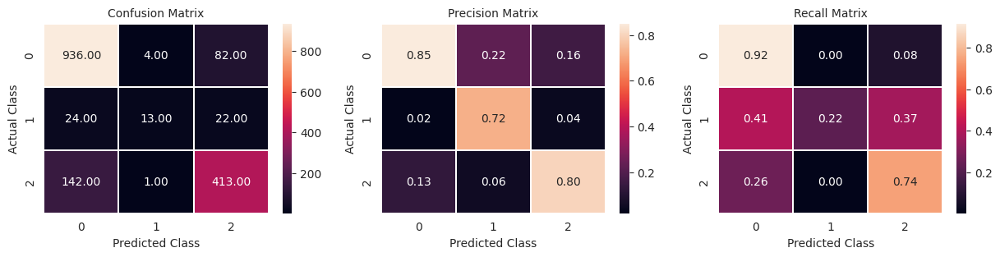


               precision    recall  f1-score   support

           0       0.85      0.92      0.88      1022
           1       0.72      0.22      0.34        59
           2       0.80      0.74      0.77       556

    accuracy                           0.83      1637
   macro avg       0.79      0.63      0.66      1637
weighted avg       0.83      0.83      0.82      1637

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
Test log_loss: 0.45%

Running CV 1

Start training the model...
[0]	validation_0-mlogloss:1.08355
[1]	validation_0-mlogloss:1.06900
[2]	validation_0-mlogloss:1.05486
[3]	validation_0-mlogloss:1.04150
[4]	validation_0-mlogloss:1.02847
[5]	validation_0-mlogloss:1.01547
[6]	validation_0-mlogloss:1.00287
[7]	validation_0-mlogloss:0.99064
[8]	validation_0-mlogloss:0.97877
[9]	validation_0-mlogloss:0.96740
[10]	validation_0-mlogloss:0.95633
[11]	validation_0-mlogloss:0.94526
[12]	validation_0-mlogloss:0.93448
[13]	validation_

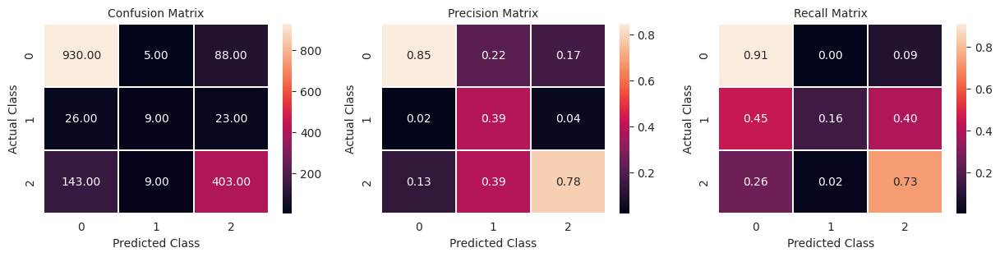


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1023
           1       0.39      0.16      0.22        58
           2       0.78      0.73      0.75       555

    accuracy                           0.82      1636
   macro avg       0.67      0.60      0.62      1636
weighted avg       0.81      0.82      0.81      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_xgb_v2_unc_all/ already exists
Test log_loss: 0.47%

Running CV 2

Start training the model...
[0]	validation_0-mlogloss:1.08346
[1]	validation_0-mlogloss:1.06863
[2]	validation_0-mlogloss:1.05431
[3]	validation_0-mlogloss:1.04068
[4]	validation_0-mlogloss:1.02761
[5]	validation_0-mlogloss:1.01441
[6]	validation_0-mlogloss:1.00172
[7]	validation_0-mlogloss:0.98929
[8]	validation_0-mlogloss:0.97702
[9]	validation_0-mlogloss:

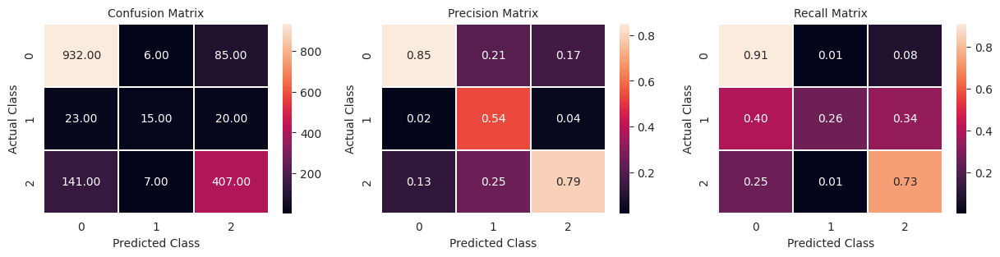


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1023
           1       0.54      0.26      0.35        58
           2       0.79      0.73      0.76       555

    accuracy                           0.83      1636
   macro avg       0.73      0.63      0.66      1636
weighted avg       0.82      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_xgb_v2_unc_all/ already exists
Test log_loss: 0.44%

Running CV 3

Start training the model...
[0]	validation_0-mlogloss:1.08308
[1]	validation_0-mlogloss:1.06802
[2]	validation_0-mlogloss:1.05352
[3]	validation_0-mlogloss:1.03974
[4]	validation_0-mlogloss:1.02627
[5]	validation_0-mlogloss:1.01304
[6]	validation_0-mlogloss:1.00034
[7]	validation_0-mlogloss:0.98762
[8]	validation_0-mlogloss:0.97549
[9]	validation_0-mlogloss:

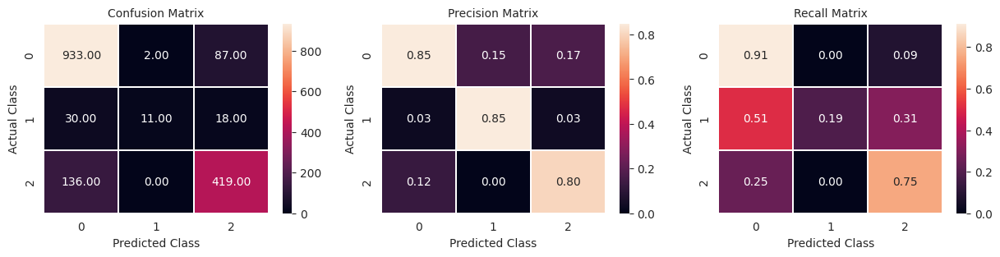


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1022
           1       0.85      0.19      0.31        59
           2       0.80      0.75      0.78       555

    accuracy                           0.83      1636
   macro avg       0.83      0.62      0.65      1636
weighted avg       0.83      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_xgb_v2_unc_all/ already exists
Test log_loss: 0.44%

Running CV 4

Start training the model...
[0]	validation_0-mlogloss:1.08309
[1]	validation_0-mlogloss:1.06806
[2]	validation_0-mlogloss:1.05338
[3]	validation_0-mlogloss:1.03927
[4]	validation_0-mlogloss:1.02592
[5]	validation_0-mlogloss:1.01245
[6]	validation_0-mlogloss:0.99958
[7]	validation_0-mlogloss:0.98691
[8]	validation_0-mlogloss:0.97480
[9]	validation_0-mlogloss:

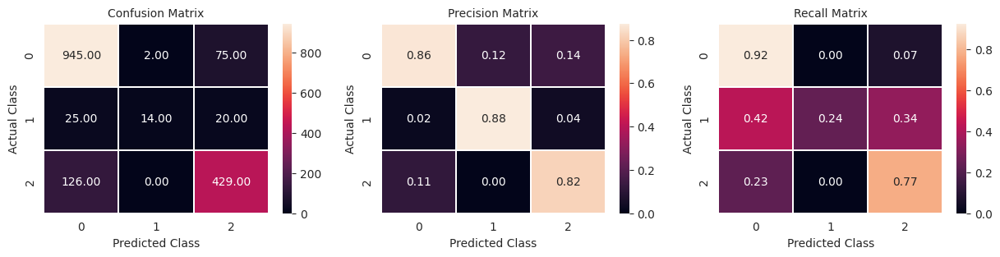


               precision    recall  f1-score   support

           0       0.86      0.92      0.89      1022
           1       0.88      0.24      0.37        59
           2       0.82      0.77      0.80       555

    accuracy                           0.85      1636
   macro avg       0.85      0.64      0.69      1636
weighted avg       0.85      0.85      0.84      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_xgb_v2_unc_all/ already exists
Test log_loss: 0.41%

Running CV 5

Start training the model...
[0]	validation_0-mlogloss:1.08324
[1]	validation_0-mlogloss:1.06857
[2]	validation_0-mlogloss:1.05424
[3]	validation_0-mlogloss:1.04081
[4]	validation_0-mlogloss:1.02773
[5]	validation_0-mlogloss:1.01473
[6]	validation_0-mlogloss:1.00199
[7]	validation_0-mlogloss:0.98970
[8]	validation_0-mlogloss:0.97760
[9]	validation_0-mlogloss:

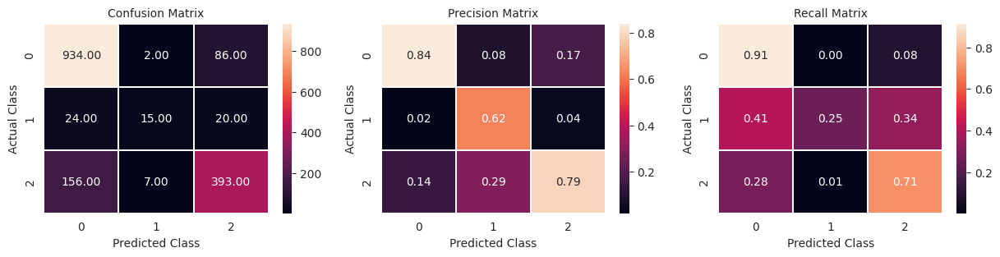


               precision    recall  f1-score   support

           0       0.84      0.91      0.87      1022
           1       0.62      0.25      0.36        59
           2       0.79      0.71      0.75       556

    accuracy                           0.82      1637
   macro avg       0.75      0.62      0.66      1637
weighted avg       0.81      0.82      0.81      1637

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_xgb_v2_unc_all/ already exists
Test log_loss: 0.45%

Running CV 6

Start training the model...
[0]	validation_0-mlogloss:1.08309
[1]	validation_0-mlogloss:1.06798
[2]	validation_0-mlogloss:1.05370
[3]	validation_0-mlogloss:1.03969
[4]	validation_0-mlogloss:1.02641
[5]	validation_0-mlogloss:1.01324
[6]	validation_0-mlogloss:1.00015
[7]	validation_0-mlogloss:0.98738
[8]	validation_0-mlogloss:0.97528
[9]	validation_0-mlogloss:

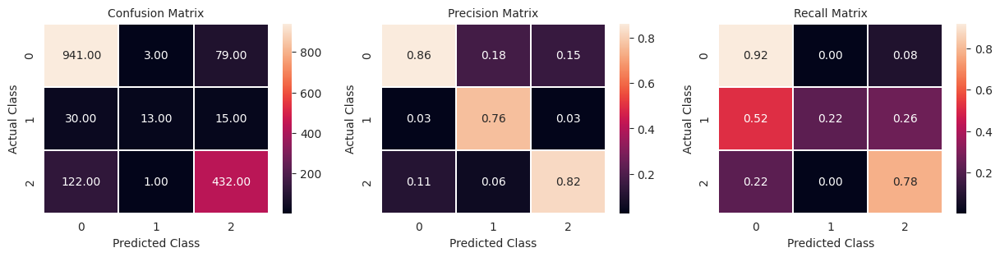


               precision    recall  f1-score   support

           0       0.86      0.92      0.89      1023
           1       0.76      0.22      0.35        58
           2       0.82      0.78      0.80       555

    accuracy                           0.85      1636
   macro avg       0.82      0.64      0.68      1636
weighted avg       0.84      0.85      0.84      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_xgb_v2_unc_all/ already exists
Test log_loss: 0.43%

Running CV 7

Start training the model...
[0]	validation_0-mlogloss:1.08311
[1]	validation_0-mlogloss:1.06824
[2]	validation_0-mlogloss:1.05388
[3]	validation_0-mlogloss:1.04026
[4]	validation_0-mlogloss:1.02727
[5]	validation_0-mlogloss:1.01417
[6]	validation_0-mlogloss:1.00150
[7]	validation_0-mlogloss:0.98912
[8]	validation_0-mlogloss:0.97718
[9]	validation_0-mlogloss:

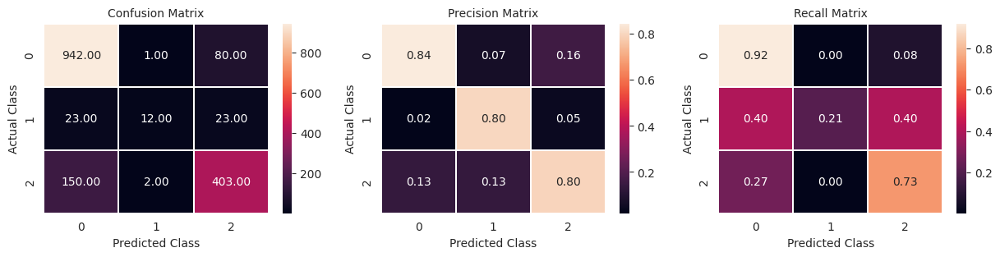


               precision    recall  f1-score   support

           0       0.84      0.92      0.88      1023
           1       0.80      0.21      0.33        58
           2       0.80      0.73      0.76       555

    accuracy                           0.83      1636
   macro avg       0.81      0.62      0.66      1636
weighted avg       0.83      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_xgb_v2_unc_all/ already exists
Test log_loss: 0.45%

Running CV 8

Start training the model...
[0]	validation_0-mlogloss:1.08319
[1]	validation_0-mlogloss:1.06829
[2]	validation_0-mlogloss:1.05389
[3]	validation_0-mlogloss:1.04003
[4]	validation_0-mlogloss:1.02656
[5]	validation_0-mlogloss:1.01347
[6]	validation_0-mlogloss:1.00045
[7]	validation_0-mlogloss:0.98818
[8]	validation_0-mlogloss:0.97601
[9]	validation_0-mlogloss:

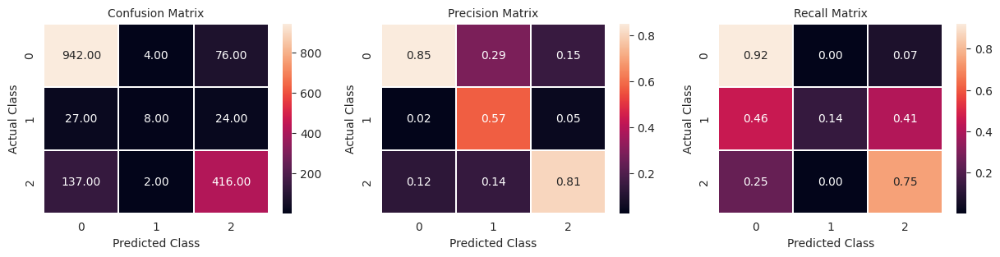


               precision    recall  f1-score   support

           0       0.85      0.92      0.89      1022
           1       0.57      0.14      0.22        59
           2       0.81      0.75      0.78       555

    accuracy                           0.83      1636
   macro avg       0.74      0.60      0.63      1636
weighted avg       0.83      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_xgb_v2_unc_all/ already exists
Test log_loss: 0.44%

Running CV 9

Start training the model...
[0]	validation_0-mlogloss:1.08334
[1]	validation_0-mlogloss:1.06846
[2]	validation_0-mlogloss:1.05403
[3]	validation_0-mlogloss:1.04042
[4]	validation_0-mlogloss:1.02722
[5]	validation_0-mlogloss:1.01380
[6]	validation_0-mlogloss:1.00090
[7]	validation_0-mlogloss:0.98822
[8]	validation_0-mlogloss:0.97621
[9]	validation_0-mlogloss:

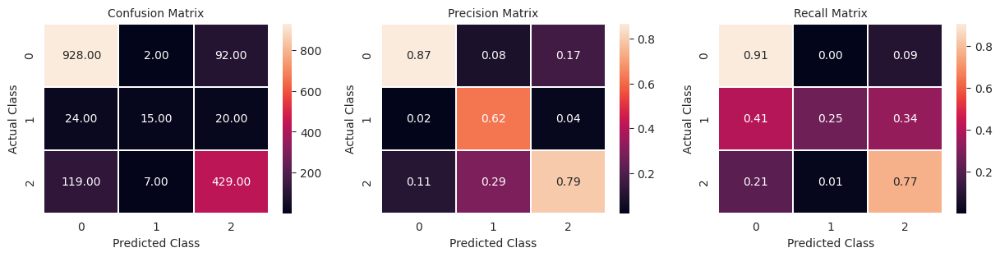


               precision    recall  f1-score   support

           0       0.87      0.91      0.89      1022
           1       0.62      0.25      0.36        59
           2       0.79      0.77      0.78       555

    accuracy                           0.84      1636
   macro avg       0.76      0.65      0.68      1636
weighted avg       0.83      0.84      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_xgb_v2_unc_all/ already exists
Test log_loss: 0.42%

Running CV 10

Start training the model...
[0]	validation_0-mlogloss:1.08356
[1]	validation_0-mlogloss:1.06867
[2]	validation_0-mlogloss:1.05448
[3]	validation_0-mlogloss:1.04114
[4]	validation_0-mlogloss:1.02816
[5]	validation_0-mlogloss:1.01507
[6]	validation_0-mlogloss:1.00252
[7]	validation_0-mlogloss:0.99002
[8]	validation_0-mlogloss:0.97804
[9]	validation_0-mlogloss

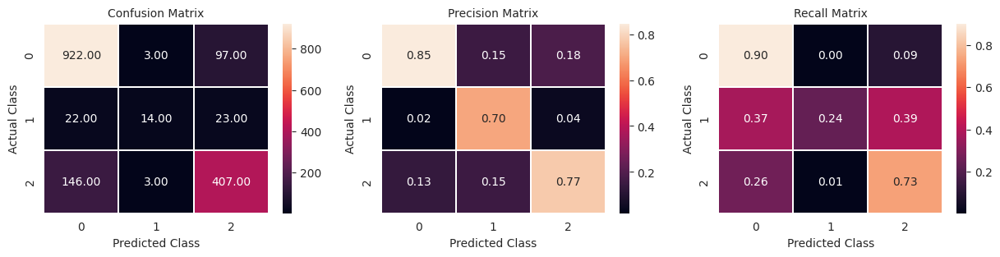


               precision    recall  f1-score   support

           0       0.85      0.90      0.87      1022
           1       0.70      0.24      0.35        59
           2       0.77      0.73      0.75       556

    accuracy                           0.82      1637
   macro avg       0.77      0.62      0.66      1637
weighted avg       0.82      0.82      0.81      1637

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_xgb_v2_unc_all/ already exists
Test log_loss: 0.46%

Running CV 11

Start training the model...
[0]	validation_0-mlogloss:1.08302
[1]	validation_0-mlogloss:1.06808
[2]	validation_0-mlogloss:1.05380
[3]	validation_0-mlogloss:1.04031
[4]	validation_0-mlogloss:1.02683
[5]	validation_0-mlogloss:1.01377
[6]	validation_0-mlogloss:1.00103
[7]	validation_0-mlogloss:0.98858
[8]	validation_0-mlogloss:0.97635
[9]	validation_0-mlogloss

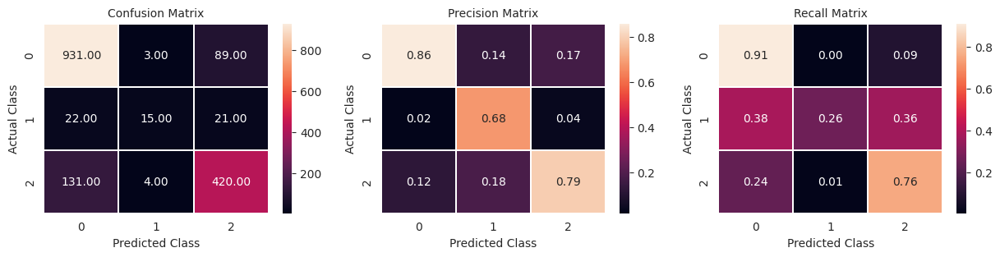


               precision    recall  f1-score   support

           0       0.86      0.91      0.88      1023
           1       0.68      0.26      0.38        58
           2       0.79      0.76      0.77       555

    accuracy                           0.83      1636
   macro avg       0.78      0.64      0.68      1636
weighted avg       0.83      0.83      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_xgb_v2_unc_all/ already exists
Test log_loss: 0.44%

Running CV 12

Start training the model...
[0]	validation_0-mlogloss:1.08292
[1]	validation_0-mlogloss:1.06783
[2]	validation_0-mlogloss:1.05316
[3]	validation_0-mlogloss:1.03940
[4]	validation_0-mlogloss:1.02599
[5]	validation_0-mlogloss:1.01253
[6]	validation_0-mlogloss:0.99937
[7]	validation_0-mlogloss:0.98690
[8]	validation_0-mlogloss:0.97458
[9]	validation_0-mlogloss

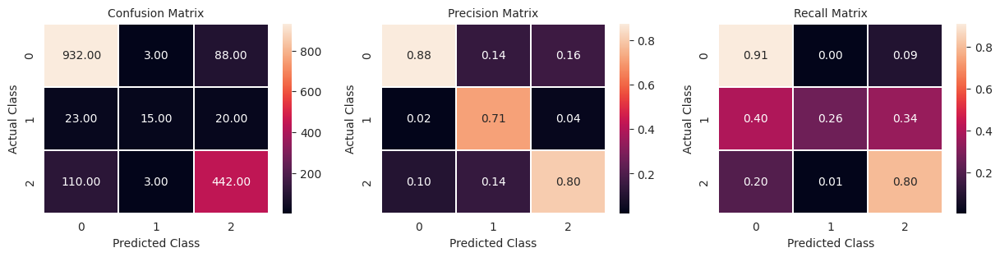


               precision    recall  f1-score   support

           0       0.88      0.91      0.89      1023
           1       0.71      0.26      0.38        58
           2       0.80      0.80      0.80       555

    accuracy                           0.85      1636
   macro avg       0.80      0.66      0.69      1636
weighted avg       0.85      0.85      0.84      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_xgb_v2_unc_all/ already exists
Test log_loss: 0.41%

Running CV 13

Start training the model...
[0]	validation_0-mlogloss:1.08308
[1]	validation_0-mlogloss:1.06807
[2]	validation_0-mlogloss:1.05357
[3]	validation_0-mlogloss:1.03975
[4]	validation_0-mlogloss:1.02652
[5]	validation_0-mlogloss:1.01329
[6]	validation_0-mlogloss:1.00058
[7]	validation_0-mlogloss:0.98817
[8]	validation_0-mlogloss:0.97601
[9]	validation_0-mlogloss

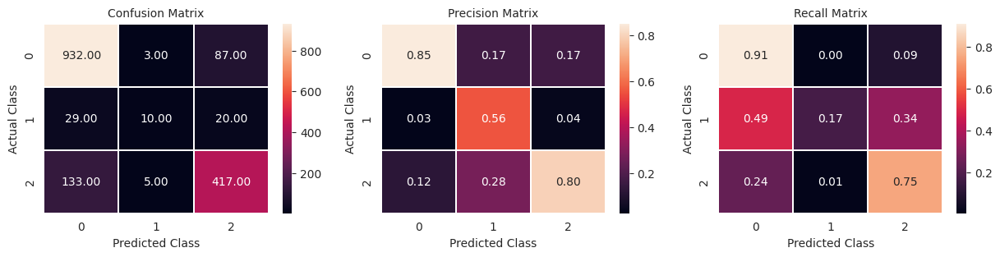


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1022
           1       0.56      0.17      0.26        59
           2       0.80      0.75      0.77       555

    accuracy                           0.83      1636
   macro avg       0.73      0.61      0.64      1636
weighted avg       0.82      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_xgb_v2_unc_all/ already exists
Test log_loss: 0.43%

Running CV 14

Start training the model...
[0]	validation_0-mlogloss:1.08339
[1]	validation_0-mlogloss:1.06868
[2]	validation_0-mlogloss:1.05445
[3]	validation_0-mlogloss:1.04111
[4]	validation_0-mlogloss:1.02796
[5]	validation_0-mlogloss:1.01497
[6]	validation_0-mlogloss:1.00251
[7]	validation_0-mlogloss:0.99012
[8]	validation_0-mlogloss:0.97825
[9]	validation_0-mlogloss

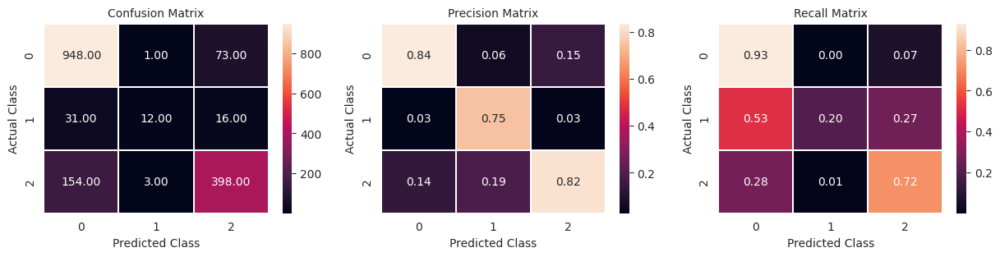


               precision    recall  f1-score   support

           0       0.84      0.93      0.88      1022
           1       0.75      0.20      0.32        59
           2       0.82      0.72      0.76       555

    accuracy                           0.83      1636
   macro avg       0.80      0.62      0.65      1636
weighted avg       0.83      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_xgb_v2_unc_all/ already exists
Test log_loss: 0.46%

Running CV 15

Start training the model...
[0]	validation_0-mlogloss:1.08323
[1]	validation_0-mlogloss:1.06843
[2]	validation_0-mlogloss:1.05404
[3]	validation_0-mlogloss:1.04052
[4]	validation_0-mlogloss:1.02755
[5]	validation_0-mlogloss:1.01454
[6]	validation_0-mlogloss:1.00206
[7]	validation_0-mlogloss:0.98996
[8]	validation_0-mlogloss:0.97794
[9]	validation_0-mlogloss

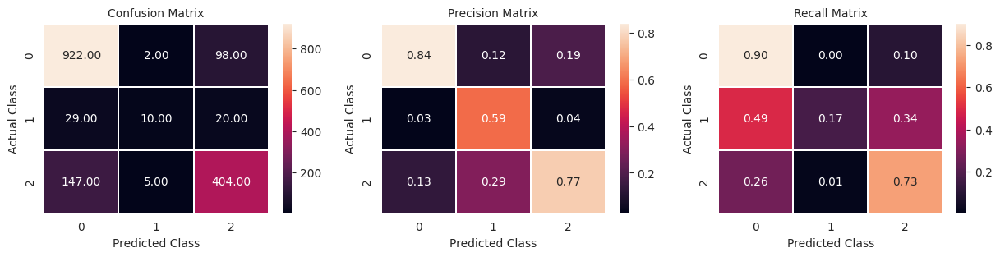


               precision    recall  f1-score   support

           0       0.84      0.90      0.87      1022
           1       0.59      0.17      0.26        59
           2       0.77      0.73      0.75       556

    accuracy                           0.82      1637
   macro avg       0.73      0.60      0.63      1637
weighted avg       0.81      0.82      0.81      1637

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_xgb_v2_unc_all/ already exists
Test log_loss: 0.46%

Running CV 16

Start training the model...
[0]	validation_0-mlogloss:1.08284
[1]	validation_0-mlogloss:1.06770
[2]	validation_0-mlogloss:1.05290
[3]	validation_0-mlogloss:1.03903
[4]	validation_0-mlogloss:1.02556
[5]	validation_0-mlogloss:1.01199
[6]	validation_0-mlogloss:0.99872
[7]	validation_0-mlogloss:0.98590
[8]	validation_0-mlogloss:0.97367
[9]	validation_0-mlogloss

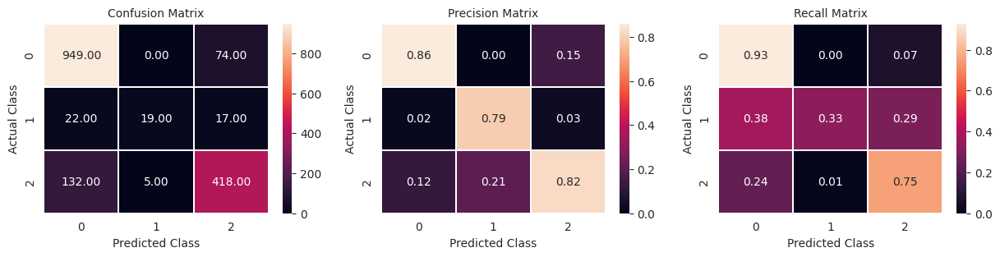


               precision    recall  f1-score   support

           0       0.86      0.93      0.89      1023
           1       0.79      0.33      0.46        58
           2       0.82      0.75      0.79       555

    accuracy                           0.85      1636
   macro avg       0.82      0.67      0.71      1636
weighted avg       0.84      0.85      0.84      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_xgb_v2_unc_all/ already exists
Test log_loss: 0.4%

Running CV 17

Start training the model...
[0]	validation_0-mlogloss:1.08320
[1]	validation_0-mlogloss:1.06860
[2]	validation_0-mlogloss:1.05483
[3]	validation_0-mlogloss:1.04151
[4]	validation_0-mlogloss:1.02849
[5]	validation_0-mlogloss:1.01543
[6]	validation_0-mlogloss:1.00271
[7]	validation_0-mlogloss:0.99044
[8]	validation_0-mlogloss:0.97853
[9]	validation_0-mlogloss:

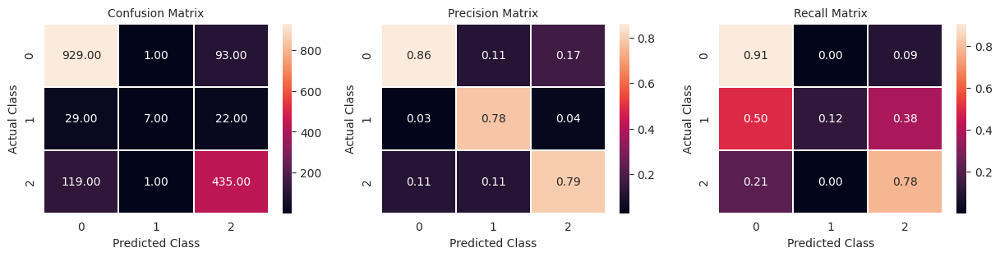


               precision    recall  f1-score   support

           0       0.86      0.91      0.88      1023
           1       0.78      0.12      0.21        58
           2       0.79      0.78      0.79       555

    accuracy                           0.84      1636
   macro avg       0.81      0.60      0.63      1636
weighted avg       0.84      0.84      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_xgb_v2_unc_all/ already exists
Test log_loss: 0.45%

Running CV 18

Start training the model...
[0]	validation_0-mlogloss:1.08306
[1]	validation_0-mlogloss:1.06808
[2]	validation_0-mlogloss:1.05370
[3]	validation_0-mlogloss:1.04011
[4]	validation_0-mlogloss:1.02676
[5]	validation_0-mlogloss:1.01336
[6]	validation_0-mlogloss:1.00045
[7]	validation_0-mlogloss:0.98776
[8]	validation_0-mlogloss:0.97554
[9]	validation_0-mlogloss

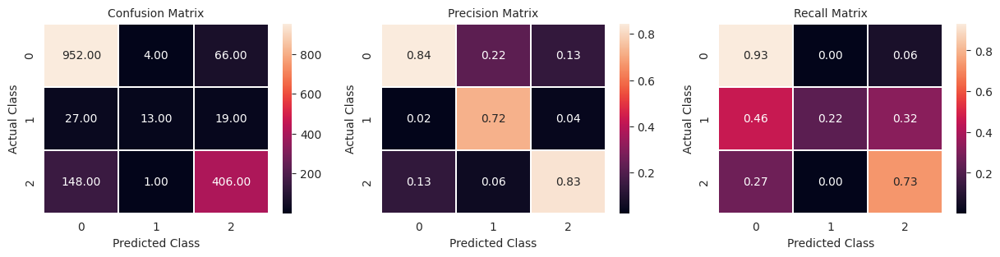


               precision    recall  f1-score   support

           0       0.84      0.93      0.89      1022
           1       0.72      0.22      0.34        59
           2       0.83      0.73      0.78       555

    accuracy                           0.84      1636
   macro avg       0.80      0.63      0.67      1636
weighted avg       0.83      0.84      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_xgb_v2_unc_all/ already exists
Test log_loss: 0.43%

Running CV 19

Start training the model...
[0]	validation_0-mlogloss:1.08346
[1]	validation_0-mlogloss:1.06858
[2]	validation_0-mlogloss:1.05451
[3]	validation_0-mlogloss:1.04092
[4]	validation_0-mlogloss:1.02759
[5]	validation_0-mlogloss:1.01441
[6]	validation_0-mlogloss:1.00179
[7]	validation_0-mlogloss:0.98928
[8]	validation_0-mlogloss:0.97740
[9]	validation_0-mlogloss

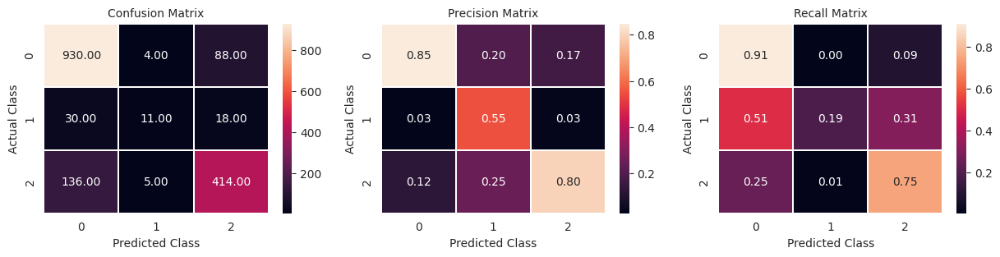


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1022
           1       0.55      0.19      0.28        59
           2       0.80      0.75      0.77       555

    accuracy                           0.83      1636
   macro avg       0.73      0.61      0.64      1636
weighted avg       0.82      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_xgb_v2_unc_all/ already exists
Test log_loss: 0.46%

Running CV 20

Start training the model...
[0]	validation_0-mlogloss:1.08338
[1]	validation_0-mlogloss:1.06853
[2]	validation_0-mlogloss:1.05416
[3]	validation_0-mlogloss:1.04052
[4]	validation_0-mlogloss:1.02745
[5]	validation_0-mlogloss:1.01435
[6]	validation_0-mlogloss:1.00183
[7]	validation_0-mlogloss:0.98950
[8]	validation_0-mlogloss:0.97762
[9]	validation_0-mlogloss

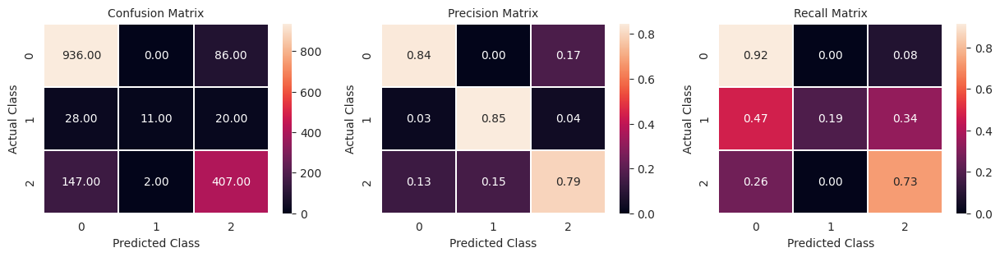


               precision    recall  f1-score   support

           0       0.84      0.92      0.88      1022
           1       0.85      0.19      0.31        59
           2       0.79      0.73      0.76       556

    accuracy                           0.83      1637
   macro avg       0.83      0.61      0.65      1637
weighted avg       0.83      0.83      0.82      1637

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_xgb_v2_unc_all/ already exists
Test log_loss: 0.46%

Running CV 21

Start training the model...
[0]	validation_0-mlogloss:1.08296
[1]	validation_0-mlogloss:1.06773
[2]	validation_0-mlogloss:1.05312
[3]	validation_0-mlogloss:1.03906
[4]	validation_0-mlogloss:1.02567
[5]	validation_0-mlogloss:1.01225
[6]	validation_0-mlogloss:0.99918
[7]	validation_0-mlogloss:0.98630
[8]	validation_0-mlogloss:0.97378
[9]	validation_0-mlogloss

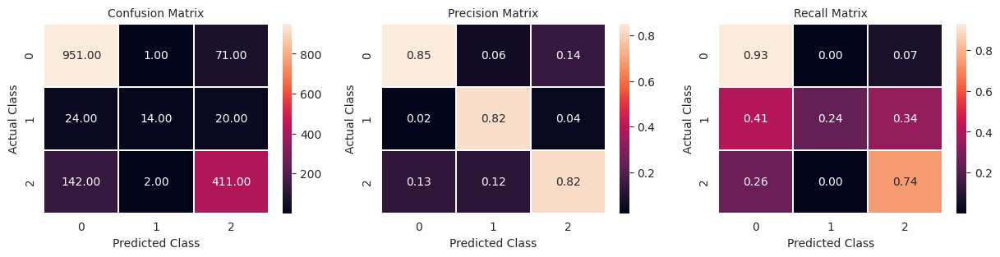


               precision    recall  f1-score   support

           0       0.85      0.93      0.89      1023
           1       0.82      0.24      0.37        58
           2       0.82      0.74      0.78       555

    accuracy                           0.84      1636
   macro avg       0.83      0.64      0.68      1636
weighted avg       0.84      0.84      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_xgb_v2_unc_all/ already exists
Test log_loss: 0.42%

Running CV 22

Start training the model...
[0]	validation_0-mlogloss:1.08313
[1]	validation_0-mlogloss:1.06824
[2]	validation_0-mlogloss:1.05390
[3]	validation_0-mlogloss:1.04022
[4]	validation_0-mlogloss:1.02695
[5]	validation_0-mlogloss:1.01380
[6]	validation_0-mlogloss:1.00090
[7]	validation_0-mlogloss:0.98821
[8]	validation_0-mlogloss:0.97624
[9]	validation_0-mlogloss

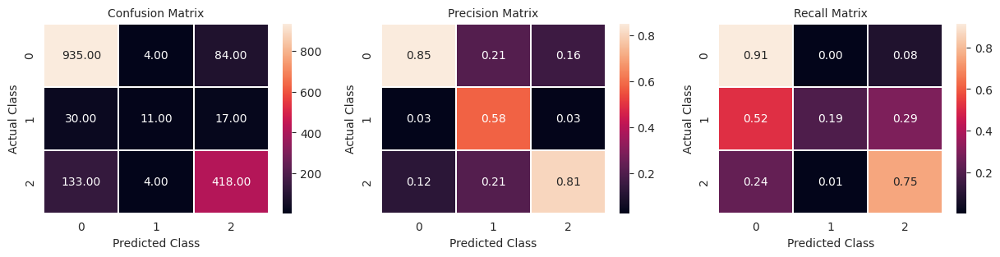


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1023
           1       0.58      0.19      0.29        58
           2       0.81      0.75      0.78       555

    accuracy                           0.83      1636
   macro avg       0.75      0.62      0.65      1636
weighted avg       0.83      0.83      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_xgb_v2_unc_all/ already exists
Test log_loss: 0.43%

Running CV 23

Start training the model...
[0]	validation_0-mlogloss:1.08329
[1]	validation_0-mlogloss:1.06856
[2]	validation_0-mlogloss:1.05431
[3]	validation_0-mlogloss:1.04093
[4]	validation_0-mlogloss:1.02808
[5]	validation_0-mlogloss:1.01508
[6]	validation_0-mlogloss:1.00230
[7]	validation_0-mlogloss:0.98999
[8]	validation_0-mlogloss:0.97807
[9]	validation_0-mlogloss

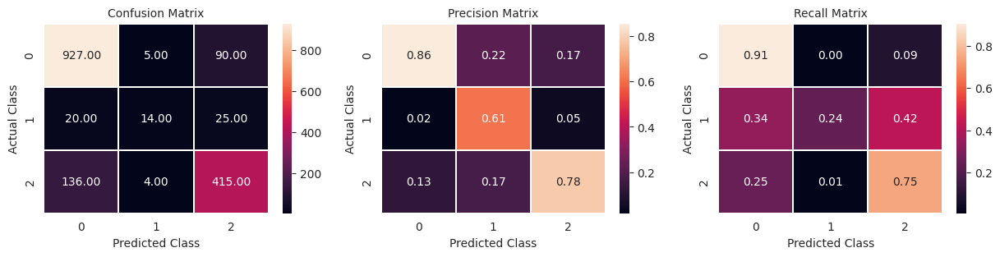


               precision    recall  f1-score   support

           0       0.86      0.91      0.88      1022
           1       0.61      0.24      0.34        59
           2       0.78      0.75      0.76       555

    accuracy                           0.83      1636
   macro avg       0.75      0.63      0.66      1636
weighted avg       0.82      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_xgb_v2_unc_all/ already exists
Test log_loss: 0.45%

Running CV 24

Start training the model...
[0]	validation_0-mlogloss:1.08331
[1]	validation_0-mlogloss:1.06840
[2]	validation_0-mlogloss:1.05399
[3]	validation_0-mlogloss:1.04042
[4]	validation_0-mlogloss:1.02737
[5]	validation_0-mlogloss:1.01421
[6]	validation_0-mlogloss:1.00143
[7]	validation_0-mlogloss:0.98889
[8]	validation_0-mlogloss:0.97679
[9]	validation_0-mlogloss

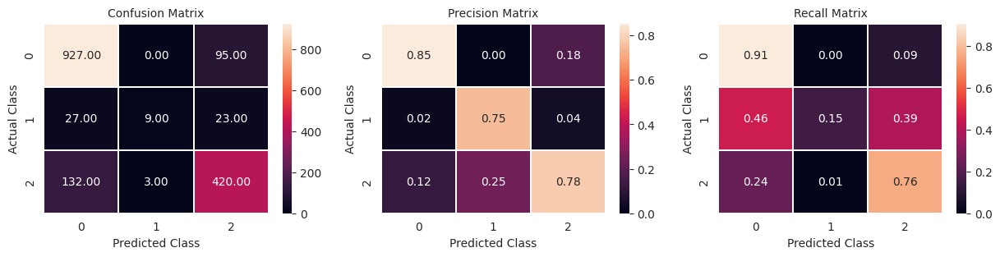


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1022
           1       0.75      0.15      0.25        59
           2       0.78      0.76      0.77       555

    accuracy                           0.83      1636
   macro avg       0.79      0.61      0.63      1636
weighted avg       0.83      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_xgb_v2_unc_all/ already exists
Test log_loss: 0.45%

Running CV 25

Start training the model...
[0]	validation_0-mlogloss:1.08331
[1]	validation_0-mlogloss:1.06859
[2]	validation_0-mlogloss:1.05449
[3]	validation_0-mlogloss:1.04101
[4]	validation_0-mlogloss:1.02781
[5]	validation_0-mlogloss:1.01472
[6]	validation_0-mlogloss:1.00202
[7]	validation_0-mlogloss:0.98967
[8]	validation_0-mlogloss:0.97784
[9]	validation_0-mlogloss

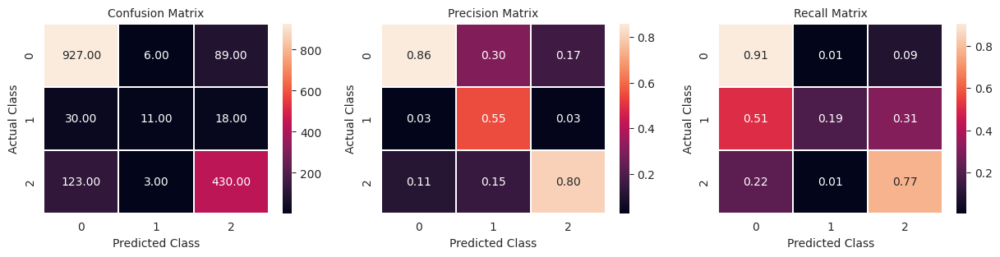


               precision    recall  f1-score   support

           0       0.86      0.91      0.88      1022
           1       0.55      0.19      0.28        59
           2       0.80      0.77      0.79       556

    accuracy                           0.84      1637
   macro avg       0.74      0.62      0.65      1637
weighted avg       0.83      0.84      0.83      1637

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_xgb_v2_unc_all/ already exists
Test log_loss: 0.44%

Running CV 26

Start training the model...
[0]	validation_0-mlogloss:1.08334
[1]	validation_0-mlogloss:1.06827
[2]	validation_0-mlogloss:1.05364
[3]	validation_0-mlogloss:1.03973
[4]	validation_0-mlogloss:1.02646
[5]	validation_0-mlogloss:1.01335
[6]	validation_0-mlogloss:1.00030
[7]	validation_0-mlogloss:0.98772
[8]	validation_0-mlogloss:0.97556
[9]	validation_0-mlogloss

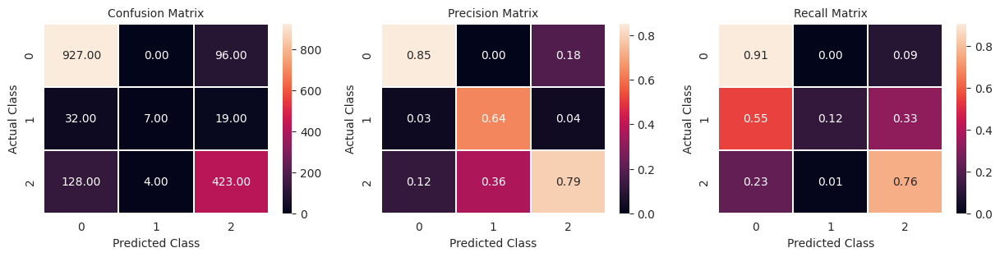


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1023
           1       0.64      0.12      0.20        58
           2       0.79      0.76      0.77       555

    accuracy                           0.83      1636
   macro avg       0.76      0.60      0.62      1636
weighted avg       0.82      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_xgb_v2_unc_all/ already exists
Test log_loss: 0.45%

Running CV 27

Start training the model...
[0]	validation_0-mlogloss:1.08329
[1]	validation_0-mlogloss:1.06856
[2]	validation_0-mlogloss:1.05426
[3]	validation_0-mlogloss:1.04082
[4]	validation_0-mlogloss:1.02765
[5]	validation_0-mlogloss:1.01449
[6]	validation_0-mlogloss:1.00212
[7]	validation_0-mlogloss:0.98967
[8]	validation_0-mlogloss:0.97753
[9]	validation_0-mlogloss

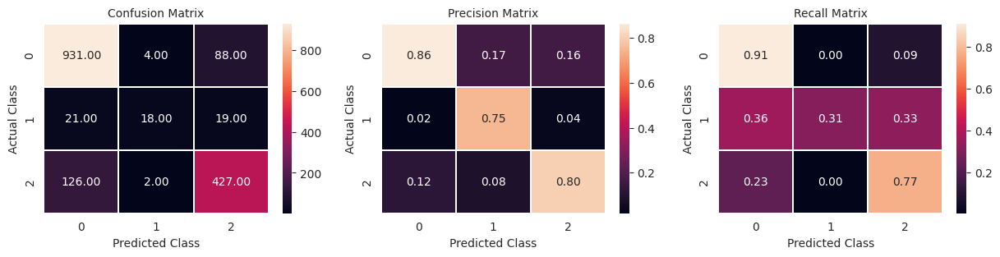


               precision    recall  f1-score   support

           0       0.86      0.91      0.89      1023
           1       0.75      0.31      0.44        58
           2       0.80      0.77      0.78       555

    accuracy                           0.84      1636
   macro avg       0.80      0.66      0.70      1636
weighted avg       0.84      0.84      0.84      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_xgb_v2_unc_all/ already exists
Test log_loss: 0.42%

Running CV 28

Start training the model...
[0]	validation_0-mlogloss:1.08330
[1]	validation_0-mlogloss:1.06873
[2]	validation_0-mlogloss:1.05442
[3]	validation_0-mlogloss:1.04129
[4]	validation_0-mlogloss:1.02825
[5]	validation_0-mlogloss:1.01531
[6]	validation_0-mlogloss:1.00269
[7]	validation_0-mlogloss:0.99036
[8]	validation_0-mlogloss:0.97869
[9]	validation_0-mlogloss

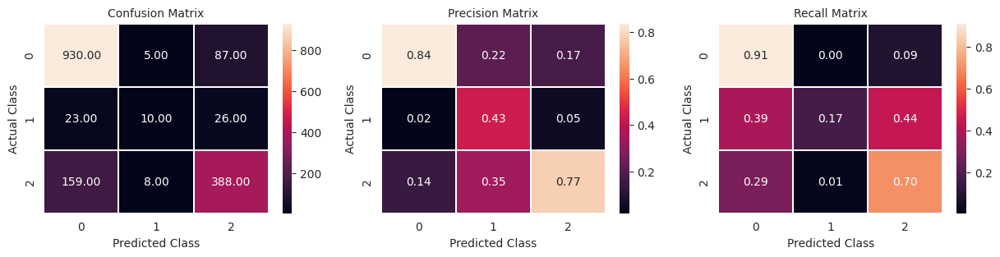


               precision    recall  f1-score   support

           0       0.84      0.91      0.87      1022
           1       0.43      0.17      0.24        59
           2       0.77      0.70      0.73       555

    accuracy                           0.81      1636
   macro avg       0.68      0.59      0.62      1636
weighted avg       0.80      0.81      0.80      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_xgb_v2_unc_all/ already exists
Test log_loss: 0.48%

Running CV 29

Start training the model...
[0]	validation_0-mlogloss:1.08274
[1]	validation_0-mlogloss:1.06750
[2]	validation_0-mlogloss:1.05261
[3]	validation_0-mlogloss:1.03885
[4]	validation_0-mlogloss:1.02543
[5]	validation_0-mlogloss:1.01190
[6]	validation_0-mlogloss:0.99914
[7]	validation_0-mlogloss:0.98653
[8]	validation_0-mlogloss:0.97435
[9]	validation_0-mlogloss

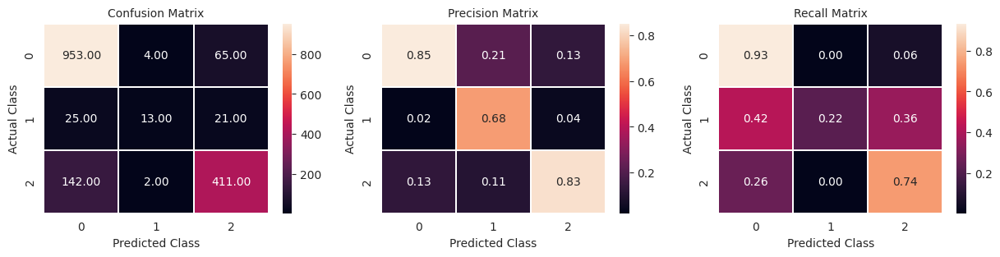


               precision    recall  f1-score   support

           0       0.85      0.93      0.89      1022
           1       0.68      0.22      0.33        59
           2       0.83      0.74      0.78       555

    accuracy                           0.84      1636
   macro avg       0.79      0.63      0.67      1636
weighted avg       0.84      0.84      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_xgb_v2_unc_all/ already exists
Test log_loss: 0.43%

Running CV 30

Start training the model...
[0]	validation_0-mlogloss:1.08309
[1]	validation_0-mlogloss:1.06781
[2]	validation_0-mlogloss:1.05299
[3]	validation_0-mlogloss:1.03917
[4]	validation_0-mlogloss:1.02583
[5]	validation_0-mlogloss:1.01237
[6]	validation_0-mlogloss:0.99947
[7]	validation_0-mlogloss:0.98684
[8]	validation_0-mlogloss:0.97449
[9]	validation_0-mlogloss

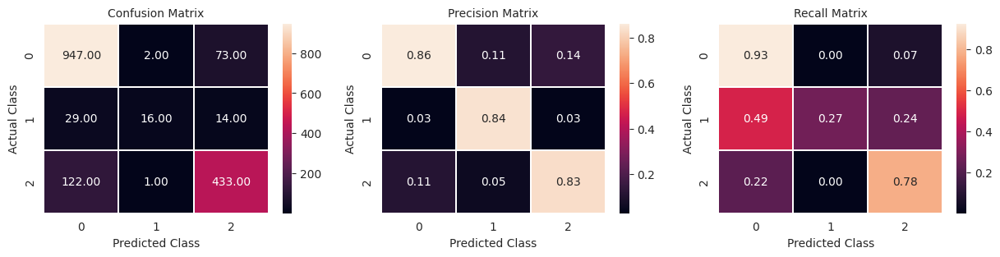


               precision    recall  f1-score   support

           0       0.86      0.93      0.89      1022
           1       0.84      0.27      0.41        59
           2       0.83      0.78      0.80       556

    accuracy                           0.85      1637
   macro avg       0.85      0.66      0.70      1637
weighted avg       0.85      0.85      0.85      1637

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_xgb_v2_unc_all/ already exists
Test log_loss: 0.4%

Running CV 31

Start training the model...
[0]	validation_0-mlogloss:1.08309
[1]	validation_0-mlogloss:1.06810
[2]	validation_0-mlogloss:1.05382
[3]	validation_0-mlogloss:1.04023
[4]	validation_0-mlogloss:1.02713
[5]	validation_0-mlogloss:1.01376
[6]	validation_0-mlogloss:1.00091
[7]	validation_0-mlogloss:0.98812
[8]	validation_0-mlogloss:0.97607
[9]	validation_0-mlogloss:

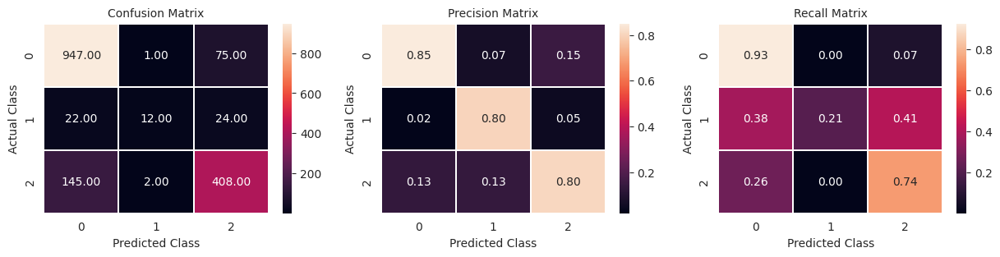


               precision    recall  f1-score   support

           0       0.85      0.93      0.89      1023
           1       0.80      0.21      0.33        58
           2       0.80      0.74      0.77       555

    accuracy                           0.84      1636
   macro avg       0.82      0.62      0.66      1636
weighted avg       0.83      0.84      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_xgb_v2_unc_all/ already exists
Test log_loss: 0.44%

Running CV 32

Start training the model...
[0]	validation_0-mlogloss:1.08325
[1]	validation_0-mlogloss:1.06868
[2]	validation_0-mlogloss:1.05443
[3]	validation_0-mlogloss:1.04088
[4]	validation_0-mlogloss:1.02777
[5]	validation_0-mlogloss:1.01502
[6]	validation_0-mlogloss:1.00254
[7]	validation_0-mlogloss:0.99028
[8]	validation_0-mlogloss:0.97838
[9]	validation_0-mlogloss

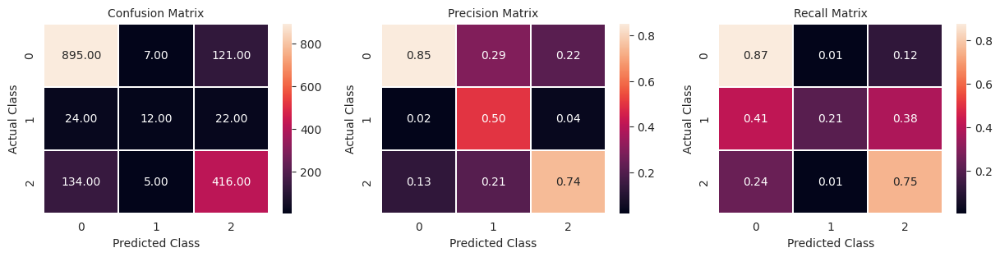


               precision    recall  f1-score   support

           0       0.85      0.87      0.86      1023
           1       0.50      0.21      0.29        58
           2       0.74      0.75      0.75       555

    accuracy                           0.81      1636
   macro avg       0.70      0.61      0.63      1636
weighted avg       0.80      0.81      0.80      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_xgb_v2_unc_all/ already exists
Test log_loss: 0.47%

Running CV 33

Start training the model...
[0]	validation_0-mlogloss:1.08306
[1]	validation_0-mlogloss:1.06829
[2]	validation_0-mlogloss:1.05390
[3]	validation_0-mlogloss:1.04033
[4]	validation_0-mlogloss:1.02742
[5]	validation_0-mlogloss:1.01415
[6]	validation_0-mlogloss:1.00150
[7]	validation_0-mlogloss:0.98884
[8]	validation_0-mlogloss:0.97664
[9]	validation_0-mlogloss

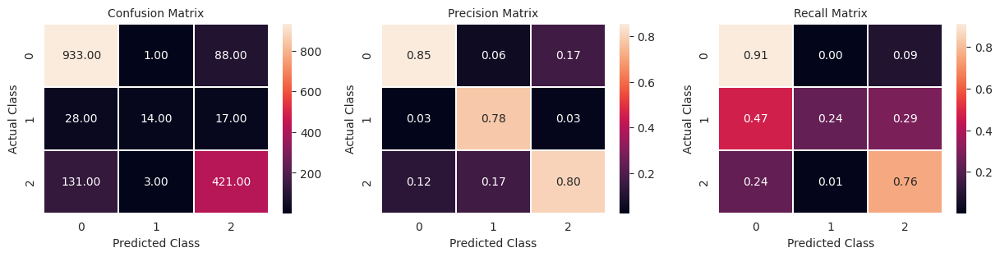


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1022
           1       0.78      0.24      0.36        59
           2       0.80      0.76      0.78       555

    accuracy                           0.84      1636
   macro avg       0.81      0.64      0.68      1636
weighted avg       0.83      0.84      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_xgb_v2_unc_all/ already exists
Test log_loss: 0.45%

Running CV 34

Start training the model...
[0]	validation_0-mlogloss:1.08302
[1]	validation_0-mlogloss:1.06829
[2]	validation_0-mlogloss:1.05383
[3]	validation_0-mlogloss:1.04019
[4]	validation_0-mlogloss:1.02692
[5]	validation_0-mlogloss:1.01387
[6]	validation_0-mlogloss:1.00105
[7]	validation_0-mlogloss:0.98847
[8]	validation_0-mlogloss:0.97640
[9]	validation_0-mlogloss

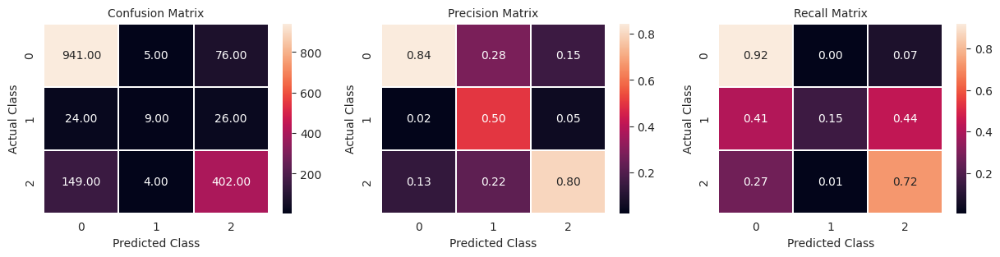


               precision    recall  f1-score   support

           0       0.84      0.92      0.88      1022
           1       0.50      0.15      0.23        59
           2       0.80      0.72      0.76       555

    accuracy                           0.83      1636
   macro avg       0.71      0.60      0.62      1636
weighted avg       0.82      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_xgb_v2_unc_all/ already exists
Test log_loss: 0.45%

Running CV 35

Start training the model...
[0]	validation_0-mlogloss:1.08350
[1]	validation_0-mlogloss:1.06871
[2]	validation_0-mlogloss:1.05462
[3]	validation_0-mlogloss:1.04120
[4]	validation_0-mlogloss:1.02821
[5]	validation_0-mlogloss:1.01513
[6]	validation_0-mlogloss:1.00236
[7]	validation_0-mlogloss:0.98996
[8]	validation_0-mlogloss:0.97793
[9]	validation_0-mlogloss

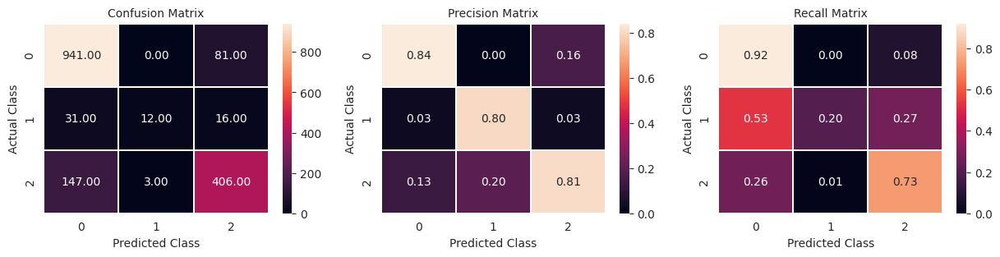


               precision    recall  f1-score   support

           0       0.84      0.92      0.88      1022
           1       0.80      0.20      0.32        59
           2       0.81      0.73      0.77       556

    accuracy                           0.83      1637
   macro avg       0.82      0.62      0.66      1637
weighted avg       0.83      0.83      0.82      1637

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_xgb_v2_unc_all/ already exists
Test log_loss: 0.45%

Running CV 36

Start training the model...
[0]	validation_0-mlogloss:1.08308
[1]	validation_0-mlogloss:1.06799
[2]	validation_0-mlogloss:1.05341
[3]	validation_0-mlogloss:1.03979
[4]	validation_0-mlogloss:1.02662
[5]	validation_0-mlogloss:1.01351
[6]	validation_0-mlogloss:1.00041
[7]	validation_0-mlogloss:0.98791
[8]	validation_0-mlogloss:0.97576
[9]	validation_0-mlogloss

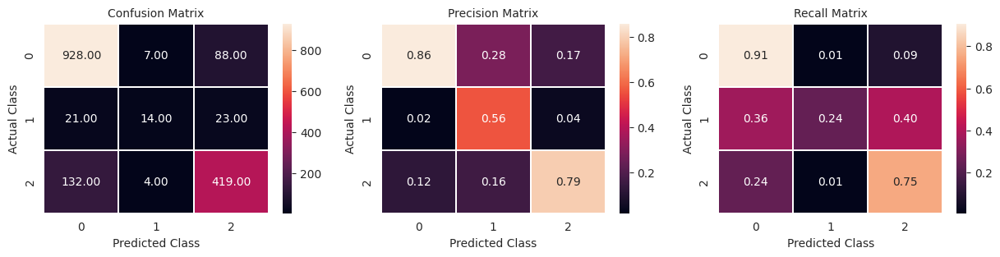


               precision    recall  f1-score   support

           0       0.86      0.91      0.88      1023
           1       0.56      0.24      0.34        58
           2       0.79      0.75      0.77       555

    accuracy                           0.83      1636
   macro avg       0.74      0.63      0.66      1636
weighted avg       0.82      0.83      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_xgb_v2_unc_all/ already exists
Test log_loss: 0.42%

Running CV 37

Start training the model...
[0]	validation_0-mlogloss:1.08296
[1]	validation_0-mlogloss:1.06794
[2]	validation_0-mlogloss:1.05342
[3]	validation_0-mlogloss:1.03966
[4]	validation_0-mlogloss:1.02635
[5]	validation_0-mlogloss:1.01309
[6]	validation_0-mlogloss:1.00031
[7]	validation_0-mlogloss:0.98764
[8]	validation_0-mlogloss:0.97538
[9]	validation_0-mlogloss

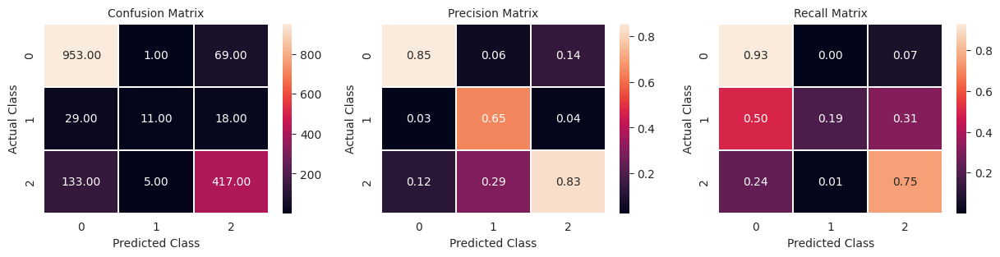


               precision    recall  f1-score   support

           0       0.85      0.93      0.89      1023
           1       0.65      0.19      0.29        58
           2       0.83      0.75      0.79       555

    accuracy                           0.84      1636
   macro avg       0.78      0.62      0.66      1636
weighted avg       0.84      0.84      0.84      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_xgb_v2_unc_all/ already exists
Test log_loss: 0.43%

Running CV 38

Start training the model...
[0]	validation_0-mlogloss:1.08330
[1]	validation_0-mlogloss:1.06842
[2]	validation_0-mlogloss:1.05442
[3]	validation_0-mlogloss:1.04103
[4]	validation_0-mlogloss:1.02803
[5]	validation_0-mlogloss:1.01511
[6]	validation_0-mlogloss:1.00215
[7]	validation_0-mlogloss:0.98969
[8]	validation_0-mlogloss:0.97777
[9]	validation_0-mlogloss

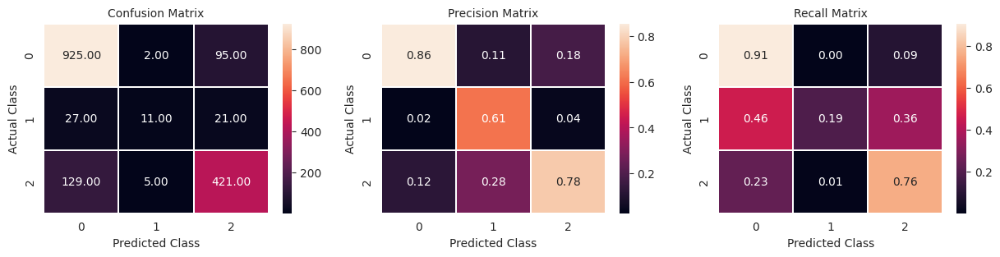


               precision    recall  f1-score   support

           0       0.86      0.91      0.88      1022
           1       0.61      0.19      0.29        59
           2       0.78      0.76      0.77       555

    accuracy                           0.83      1636
   macro avg       0.75      0.62      0.65      1636
weighted avg       0.82      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_xgb_v2_unc_all/ already exists
Test log_loss: 0.45%

Running CV 39

Start training the model...
[0]	validation_0-mlogloss:1.08306
[1]	validation_0-mlogloss:1.06816
[2]	validation_0-mlogloss:1.05375
[3]	validation_0-mlogloss:1.04010
[4]	validation_0-mlogloss:1.02688
[5]	validation_0-mlogloss:1.01348
[6]	validation_0-mlogloss:1.00070
[7]	validation_0-mlogloss:0.98826
[8]	validation_0-mlogloss:0.97627
[9]	validation_0-mlogloss

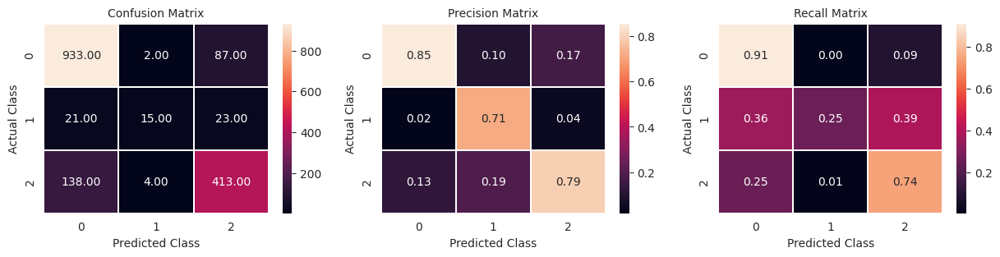


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1022
           1       0.71      0.25      0.38        59
           2       0.79      0.74      0.77       555

    accuracy                           0.83      1636
   macro avg       0.79      0.64      0.67      1636
weighted avg       0.83      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_xgb_v2_unc_all/ already exists
Test log_loss: 0.45%
All Valuation lOGlOSS: [0.448, 0.465, 0.438, 0.439, 0.408, 0.452, 0.433, 0.454, 0.443, 0.419, 0.459, 0.437, 0.413, 0.435, 0.458, 0.464, 0.403, 0.452, 0.432, 0.461, 0.458, 0.419, 0.433, 0.451, 0.449, 0.444, 0.447, 0.415, 0.477, 0.433, 0.4, 0.444, 0.466, 0.45, 0.451, 0.447, 0.424, 0.429, 0.455, 0.448]


In [ ]:
test_results_df_C,test_results_df_CL,test_results_df_D, test_results_df = run_experiment(X_train,
                                                                                         X_test,
                                                                                         best_params=best_par,
                                                                                         experiment_name="model_xgb_v2_unc_all",
                                                                                         splits=5,
                                                                                         n_repeats=8,
                                                                                         rs=42,
                                                                                         calibrate=False)

In [ ]:
res_cal = [0.467, 0.487, 0.467, 0.461, 0.431, 0.474, 0.447, 0.479, 0.456, 0.445, 0.472, 0.472, 0.434, 0.464, 0.468, 0.483, 0.433, 0.474, 0.445, 0.478,
           0.471, 0.437, 0.466, 0.462, 0.472, 0.466, 0.456, 0.443, 0.492, 0.455, 0.423, 0.467, 0.484, 0.47, 0.468, 0.464, 0.452, 0.453, 0.475, 0.469]

res_unc = [0.465, 0.486, 0.462, 0.458, 0.439, 0.469, 0.451, 0.477, 0.46, 0.446, 0.478, 0.463, 0.439, 0.457, 0.469, 0.476, 0.437, 0.476, 0.449, 0.479,
          0.475, 0.439, 0.458, 0.468, 0.471, 0.467, 0.466, 0.447, 0.486, 0.451, 0.432, 0.471, 0.477, 0.469, 0.466, 0.463, 0.447, 0.452, 0.477, 0.472]

res_lgbm = [0.463, 0.486, 0.463, 0.454, 0.427, 0.475, 0.447, 0.475, 0.452, 0.428, 0.468, 0.458, 0.434, 0.456, 0.468, 0.484, 0.418, 0.462, 0.447, 0.482,
            0.478, 0.437, 0.462, 0.457, 0.469, 0.465, 0.466, 0.431, 0.49, 0.448, 0.411, 0.458, 0.486, 0.468, 0.469, 0.468, 0.455, 0.444, 0.466, 0.461]

res_lgbm_v2_cal = [0.46, 0.491, 0.466, 0.453, 0.423, 0.478, 0.449, 0.478, 0.456, 0.434, 0.476, 0.454, 0.434, 0.463, 0.466, 0.491, 0.424, 0.465, 0.444,
                   0.48, 0.474, 0.439, 0.46, 0.457, 0.465, 0.467, 0.469, 0.434, 0.495, 0.451, 0.422, 0.459, 0.494, 0.475, 0.47, 0.468, 0.454, 0.449, 0.473, 0.459]

res_lgbm_v1_unc = [0.456, 0.475, 0.449, 0.451, 0.416, 0.459, 0.447, 0.468, 0.455, 0.424, 0.469, 0.444, 0.424, 0.45, 0.463, 0.474, 0.413, 0.463, 0.442, 0.47, 0.47,
                   0.432, 0.443, 0.454, 0.454, 0.456, 0.462, 0.424, 0.484, 0.441, 0.41, 0.455, 0.48, 0.467, 0.459, 0.455, 0.434, 0.436, 0.465, 0.457]

res_xgb_v0_unc = [0.447, 0.463, 0.437, 0.436, 0.408, 0.452, 0.431, 0.452, 0.44, 0.416, 0.455, 0.437, 0.416, 0.434, 0.453, 0.463, 0.405, 0.448, 0.432,
                  0.459, 0.458, 0.418, 0.432, 0.446, 0.448, 0.443, 0.446, 0.413, 0.473, 0.428, 0.396, 0.443, 0.458, 0.451, 0.447, 0.444, 0.425, 0.428, 0.456, 0.446]

res_xgb_v1_cal = [0.458, 0.482, 0.456, 0.442, 0.416, 0.471, 0.442, 0.467, 0.447, 0.426, 0.463, 0.454, 0.425, 0.455, 0.464, 0.483, 0.416, 0.452,
                 0.441, 0.472, 0.467, 0.427, 0.454, 0.457, 0.461, 0.454, 0.457, 0.424, 0.488, 0.442, 0.402, 0.451, 0.477, 0.463, 0.461, 0.458, 0.449, 0.439, 0.468, 0.454]


np.mean(res_cal),np.mean(res_unc),np.mean(res_lgbm),np.mean(res_lgbm_v2_cal), np.mean(res_lgbm_v1_unc), np.mean(res_xgb_v0_unc), np.mean(res_xgb_v1_cal)

(0.46204999999999996,
 0.46225000000000005,
 0.4584,
 0.460475,
 0.45124999999999993,
 0.43957499999999994,
 0.452125)

In [ ]:
test_results_df

,Status_C,Status_CL,Status_D
0,0.732625,0.033887,0.233489
1,0.715721,0.087127,0.197153
2,0.027806,0.013625,0.958568
3,0.948126,0.005591,0.046283
4,0.845019,0.044299,0.110681
...,...,...,...
5266,0.866807,0.037172,0.096021
5267,0.958851,0.004970,0.036179
5268,0.904146,0.007461,0.088393
5269,0.981010,0.008185,0.010805


In [ ]:
experiment_name="model_xgb_v0_unc"

sub = pd.read_csv("sample_submission.csv", index_col=0)
sub.iloc[:,:] = test_results_df.values
sub.to_csv(f"Results/{experiment_name}.csv")

In [ ]:
sub

,Status_C,Status_CL,Status_D
id,,,
7905,0.732625,0.033887,0.233489
7906,0.715721,0.087127,0.197153
7907,0.027806,0.013625,0.958568
7908,0.948126,0.005591,0.046283
7909,0.845019,0.044299,0.110681
...,...,...,...
13171,0.866807,0.037172,0.096021
13172,0.958851,0.004970,0.036179
13173,0.904146,0.007461,0.088393


### 6.6  CatBoostClassifer

In [ ]:
X_train = pd.read_csv("new_train.csv", index_col=0)
X_test = pd.read_csv("new_test.csv", index_col=0)

#X_train["weights"] = X_train["Status"]
#X_test["weights"] = 1.0

strat_feature = X_train["Status"]

X_train.drop(columns=["id","Status_C","Status_CL","Status_D","min_class_feat_RF"],inplace=True)
X_test.drop(columns=["id","Status_C","Status_CL","Status_D","min_class_feat_RF"],inplace=True)

num_var = X_train.select_dtypes("float").columns
cat_var = X_train.select_dtypes("int").columns

X_train[num_var]=X_train[num_var].astype("float32")
X_train[cat_var]=X_train[cat_var].astype("int32")

X_test[num_var]=X_test[num_var].astype("float32")
X_test[cat_var]=X_test[cat_var].astype("int32")

X_train.Status = X_train.Status.replace({"C":0,"CL":1,"D":2})

X_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8181 entries, 0 to 311
Data columns (total 37 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Drug                            8181 non-null   int32  
 1   Sex                             8181 non-null   int32  
 2   Ascites                         8181 non-null   int32  
 3   Hepatomegaly                    8181 non-null   int32  
 4   Spiders                         8181 non-null   int32  
 5   Edema                           8181 non-null   int32  
 6   Bilirubin                       8181 non-null   float32
 7   Cholesterol                     8181 non-null   float32
 8   Albumin                         8181 non-null   float32
 9   Copper                          8181 non-null   float32
 10  Alk_Phos                        8181 non-null   float32
 11  SGOT                            8181 non-null   float32
 12  Tryglicerides                   818

In [ ]:
X_test.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5271 entries, 0 to 5270
Data columns (total 37 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Drug                            5271 non-null   int32  
 1   Sex                             5271 non-null   int32  
 2   Ascites                         5271 non-null   int32  
 3   Hepatomegaly                    5271 non-null   int32  
 4   Spiders                         5271 non-null   int32  
 5   Edema                           5271 non-null   int32  
 6   Bilirubin                       5271 non-null   float32
 7   Cholesterol                     5271 non-null   float32
 8   Albumin                         5271 non-null   float32
 9   Copper                          5271 non-null   float32
 10  Alk_Phos                        5271 non-null   float32
 11  SGOT                            5271 non-null   float32
 12  Tryglicerides                   52

**Check Unconstrained Model**

In [ ]:
X = X_train.drop(columns=["Status"]).copy()
y = X_train["Status"].copy()

In [ ]:
%%time
skf = RepeatedStratifiedKFold(n_splits=5, n_repeats=5, random_state=48)
clf = CatBoostClassifier()
cross_val_score(clf, X, y, n_jobs=-1, cv=skf, scoring="neg_log_loss").mean()

CPU times: user 3.12 s, sys: 974 ms, total: 4.1 s
Wall time: 3min 52s


-0.4635801634143491

#### 6.5.1 **Optuna Optimization**

In [ ]:
skf = RepeatedStratifiedKFold(n_splits=4, n_repeats=4, random_state=78)

def objective(trial):

    train_x, valid_x, train_y, valid_y = train_test_split(X, y, test_size=0.25, stratify=y)

    param = {
        #'objective': 'Logloss',
        'loss_function': 'MultiClass',
        'early_stopping_rounds':51,
        "l2_leaf_reg" : trial.suggest_float("l2_leaf_reg", 5e-5, 1e-3, log=True), #
        "model_size_reg" : trial.suggest_float("model_size_reg", 1e-4, 1e-3, log=True), #
        "iterations" : trial.suggest_int('n_estimators', 850, 1200), #
        "depth" : trial.suggest_int('depth', 4, 8), #
        "learning_rate" : trial.suggest_float("learning_rate",1e-3, 1e-1, log=True),
        'random_strength':trial.suggest_uniform('random_strength', 3.5,5.5),
        "bootstrap_type": "Bernoulli",
        "subsample" : trial.suggest_float("subsample", 0.35, 0.7),
        "eval_metric": "MultiClass",
        "auto_class_weights":None}

    clf = CatBoostClassifier(random_state = 42, silent=True,
                             **param)

    fit_params={"eval_set":(valid_x,valid_y)}

    clf.fit(train_x,train_y,**fit_params)

    y_prob = clf.predict_proba(valid_x)

    score = log_loss(valid_y,y_prob)

    return score

#{'l2_leaf_reg': 0.00012778855734723414, 'model_size_reg': 0.0007227220762895177, 'n_estimators': 964, 'depth': 6,
# 'learning_rate': 0.029736117595598605, 'random_strength': 4.862917969265431, 'subsample': 0.4784765189410421} 0.4091074514701459

In [ ]:
# Create study object
study = optuna.create_study(direction="minimize")

# Run optimization process
study.optimize(objective, n_trials=301, show_progress_bar=True)

[I 2023-12-17 13:03:57,352] A new study created in memory with name: no-name-2ce154ad-5d88-4e19-9fe2-58939bc7954d


  0%|          | 0/301 [00:00<?, ?it/s]

[I 2023-12-17 13:04:04,986] Trial 0 finished with value: 0.5274698125353607 and parameters: {'l2_leaf_reg': 0.000103230088864719, 'model_size_reg': 0.0008093692020231118, 'n_estimators': 1160, 'depth': 6, 'learning_rate': 0.0020630183361632073, 'random_strength': 5.488815031480065, 'subsample': 0.6793591081361718}. Best is trial 0 with value: 0.5274698125353607.
[I 2023-12-17 13:04:11,197] Trial 1 finished with value: 0.46711454733052193 and parameters: {'l2_leaf_reg': 9.498894716550145e-05, 'model_size_reg': 0.0003891779417612801, 'n_estimators': 908, 'depth': 8, 'learning_rate': 0.04617587379770512, 'random_strength': 3.610466812460294, 'subsample': 0.41705706442641743}. Best is trial 1 with value: 0.46711454733052193.
[I 2023-12-17 13:04:20,129] Trial 2 finished with value: 0.48945943032205974 and parameters: {'l2_leaf_reg': 0.00021783597840271393, 'model_size_reg': 0.0008153484823816287, 'n_estimators': 1071, 'depth': 7, 'learning_rate': 0.00396348926232637, 'random_strength': 5.41

In [ ]:
trial = study.best_trial
print('LogLoss: {}'.format(trial.value))
print("Best hyperparameters: {}".format(trial.params))

LogLoss: 0.42399838777278703
Best hyperparameters: {'l2_leaf_reg': 7.900983123920014e-05, 'model_size_reg': 0.000505627746127701, 'n_estimators': 865, 'depth': 8, 'learning_rate': 0.026008846566778335, 'random_strength': 4.318937869637732, 'subsample': 0.5731771727050616}


In [ ]:
trial = study.best_trial
print('LogLoss: {}'.format(trial.value))
print("Best hyperparameters: {}".format(trial.params))

LogLoss: 0.4319914603023654
Best hyperparameters: {'reg_alpha': 0.00012943084375079074, 'reg_lambda': 0.0010806254729875003, 'n_estimators': 715, 'depth': 4, 'learning_rate': 0.09882846372573945, 'random_strength': 4.735374838498915, 'bootstrap_type': 'Bernoulli', 'auto_class_weights': None, 'subsample': 0.13450814955323345}


In [ ]:
# Print best trial and best hyperparameters
print("Best trial:", study.best_trial)
print("Best hyperparameters:", study.best_params)

Best trial: FrozenTrial(number=120, state=TrialState.COMPLETE, values=[0.4091074514701459], datetime_start=datetime.datetime(2023, 12, 17, 12, 36, 8, 717920), datetime_complete=datetime.datetime(2023, 12, 17, 12, 36, 14, 255384), params={'l2_leaf_reg': 0.00012778855734723414, 'model_size_reg': 0.0007227220762895177, 'n_estimators': 964, 'depth': 6, 'learning_rate': 0.029736117595598605, 'random_strength': 4.862917969265431, 'subsample': 0.4784765189410421}, user_attrs={}, system_attrs={}, intermediate_values={}, distributions={'l2_leaf_reg': FloatDistribution(high=0.001, log=True, low=5e-05, step=None), 'model_size_reg': FloatDistribution(high=0.001, log=True, low=5e-05, step=None), 'n_estimators': IntDistribution(high=1000, log=False, low=600, step=1), 'depth': IntDistribution(high=7, log=False, low=3, step=1), 'learning_rate': FloatDistribution(high=0.3, log=True, low=0.01, step=None), 'random_strength': FloatDistribution(high=5.0, log=False, low=3.0, step=None), 'subsample': FloatDi

In [ ]:
fig = optuna.visualization.plot_optimization_history(study)
fig.show()

In [ ]:
fig = optuna.visualization.plot_param_importances(study)
fig.show()

In [ ]:
fig = optuna.visualization.plot_rank(study, params=["subsample", "colsample_bytree"])
fig.show()

In [ ]:
fig = optuna.visualization.plot_rank(study, params=["n_estimators", "reg_alpha"])
fig.show()

In [ ]:
skf = RepeatedStratifiedKFold(n_splits=5, n_repeats=5, random_state=42)
best_par = {'loss_function': 'MultiClass','early_stopping_rounds':51, 'l2_leaf_reg': 0.00012778855734723414, 'model_size_reg': 0.0007227220762895177, 'n_estimators': 964, 'depth': 6,
           'learning_rate': 0.029736117595598605, 'random_strength': 4.862917969265431, 'subsample': 0.4784765189410421,'loss_function': 'MultiClass',
           'early_stopping_rounds':51,"bootstrap_type": "Bernoulli","eval_metric": "MultiClass",}

clf = CatBoostClassifier(random_state = 42, **best_par)
#cross_val_score(clf, X, y, n_jobs=-1, cv=skf, scoring="neg_log_loss").mean()
#clf.fit( X, y)

#### 6.5.2 Fit the Model

In [ ]:
def run_experiment(train, test_data_file, best_params=best_par, experiment_name="model_catboost", splits=5, n_repeats=8, rs=42, calibrate=True):

  skf = RepeatedStratifiedKFold(n_splits=splits, n_repeats=n_repeats, random_state=rs)

  test_results_df_C = pd.DataFrame(index=test_data_file.index, columns=list(range(splits*n_repeats)))
  test_results_df_CL = pd.DataFrame(index=test_data_file.index, columns=list(range(splits*n_repeats)))
  test_results_df_D = pd.DataFrame(index=test_data_file.index, columns=list(range(splits*n_repeats)))

  test_results_df = pd.DataFrame(index=test_data_file.index, columns=["Status_C","Status_CL","Status_D"])

  all_logloss = []
  all_AUC_pr = []

  for i, (train_index, valid_index) in enumerate(skf.split(X_train,strat_feature)):

    print(f"\nRunning CV {i}\n")
    ########################################################################## Prepare the Dataset:
    X_trn = train.iloc[train_index,:]
    X_val = train.iloc[valid_index,:]

    X = X_trn.drop(columns=["Status"]).copy()
    y = X_trn["Status"].copy()

    val_X = X_val.drop(columns=["Status"]).copy()
    val_y = X_val["Status"].copy()

    test_X = test_data_file.drop(columns=["Status"]).copy()
    #################################################################### End of Dataset Preparation

    ##################################################################### Generate and Fit Model
    model = CatBoostClassifier(random_state = rs, **best_par)
    print("Start training the model...")
    model.fit(X,y, eval_set=[(val_X,val_y)])
    if calibrate:
      print("Model Calibration")
      cal_model = CalibratedClassifierCV(model, method="sigmoid", cv="prefit")
      cal_model.fit(val_X, val_y)
      model = cal_model
    print("Model training finished")

    val_probs = model.predict_proba(val_X)
    test_prob = model.predict_proba(test_X)

    logloss = log_loss(val_y, val_probs)

    y_hat_val = model.predict(val_X)

    plot_confusion_matrix(val_y, y_hat_val, labels=[0,1,2])

    print("\n",classification_report(y_true=val_y, y_pred=y_hat_val))

    test_results_df_C.iloc[:,i] = test_prob[:,0]
    test_results_df_CL.iloc[:,i] = test_prob[:,1]
    test_results_df_D.iloc[:,i] = test_prob[:,2]

    ##################################################################### Save the Model
    folders_experiment = f"/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/{experiment_name}/"
    folders_experiment_cv = f"/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/{experiment_name}/cv_{i}/"

    list_directories = [folder_data,folders_experiment,folders_experiment_cv]

    for path in list_directories:
      try:
          os.mkdir(path)
      except OSError as error:
          print(f"{path} already exists")

    os.chdir(folders_experiment_cv)
    dump(clf, f'{experiment_name}.joblib')
    os.chdir(folder_data)

    print(f"Test log_loss: {round(logloss, 2)}%")
    all_logloss.append(round(logloss, 3))

  ##################################################################### Create Model Output
  test_results_df_C["Mean"] = test_results_df_C.mean(axis=1)
  test_results_df_CL["Mean"] = test_results_df_CL.mean(axis=1)
  test_results_df_D["Mean"] = test_results_df_D.mean(axis=1)

  test_results_df.loc[:,"Status_C"] = test_results_df_C["Mean"].values
  test_results_df.loc[:,"Status_CL"] = test_results_df_CL["Mean"].values
  test_results_df.loc[:,"Status_D"] = test_results_df_D["Mean"].values

  print(f"All Valuation lOGlOSS: {all_logloss}")

  return test_results_df_C,test_results_df_CL,test_results_df_D, test_results_df


Running CV 0

Start training the model...
0:	learn: 1.0699556	test: 1.0695090	best: 1.0695090 (0)	total: 6.04ms	remaining: 5.81s
1:	learn: 1.0430093	test: 1.0422546	best: 1.0422546 (1)	total: 11.8ms	remaining: 5.66s
2:	learn: 1.0156275	test: 1.0151461	best: 1.0151461 (2)	total: 16.7ms	remaining: 5.34s
3:	learn: 0.9895848	test: 0.9895701	best: 0.9895701 (3)	total: 20.7ms	remaining: 4.97s
4:	learn: 0.9681192	test: 0.9684166	best: 0.9684166 (4)	total: 25.7ms	remaining: 4.93s
5:	learn: 0.9494578	test: 0.9495801	best: 0.9495801 (5)	total: 31.3ms	remaining: 5s
6:	learn: 0.9304387	test: 0.9302159	best: 0.9302159 (6)	total: 36.2ms	remaining: 4.95s
7:	learn: 0.9108035	test: 0.9106568	best: 0.9106568 (7)	total: 41.1ms	remaining: 4.91s
8:	learn: 0.8930409	test: 0.8926989	best: 0.8926989 (8)	total: 45.8ms	remaining: 4.86s
9:	learn: 0.8772151	test: 0.8767031	best: 0.8767031 (9)	total: 50.1ms	remaining: 4.78s
10:	learn: 0.8613015	test: 0.8607869	best: 0.8607869 (10)	total: 54.7ms	remaining: 4.74s
1

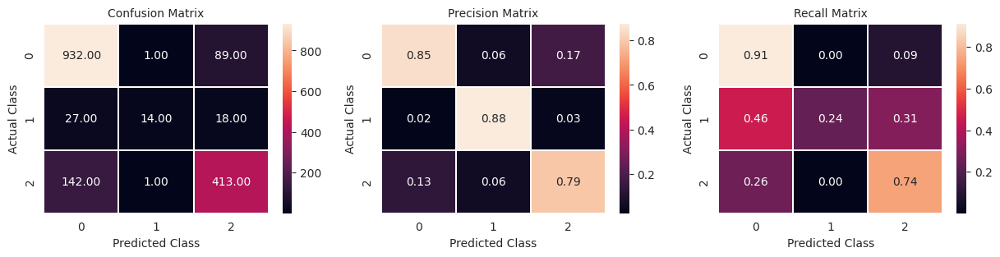


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1022
           1       0.88      0.24      0.37        59
           2       0.79      0.74      0.77       556

    accuracy                           0.83      1637
   macro avg       0.84      0.63      0.67      1637
weighted avg       0.83      0.83      0.82      1637

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/ already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/cv_0/ already exists
Test log_loss: 0.46%

Running CV 1

Start training the model...
0:	learn: 1.0681683	test: 1.0692056	best: 1.0692056 (0)	total: 4.83ms	remaining: 4.65s
1:	learn: 1.0405708	test: 1.0427222	best: 1.0427222 (1)	total: 8.83ms	remaining: 4.25s
2:	learn: 1.0152608	te

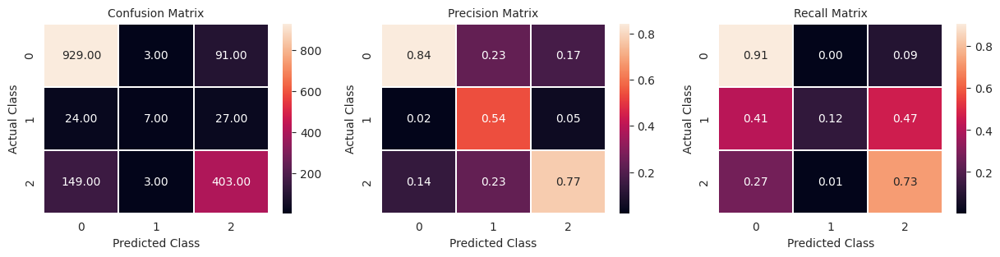


               precision    recall  f1-score   support

           0       0.84      0.91      0.87      1023
           1       0.54      0.12      0.20        58
           2       0.77      0.73      0.75       555

    accuracy                           0.82      1636
   macro avg       0.72      0.58      0.61      1636
weighted avg       0.81      0.82      0.81      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/ already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/cv_1/ already exists
Test log_loss: 0.48%

Running CV 2

Start training the model...
0:	learn: 1.0681953	test: 1.0691642	best: 1.0691642 (0)	total: 6.11ms	remaining: 5.88s
1:	learn: 1.0409256	test: 1.0421746	best: 1.0421746 (1)	total: 10.8ms	remaining: 5.2s
2:	learn: 1.0147503	tes

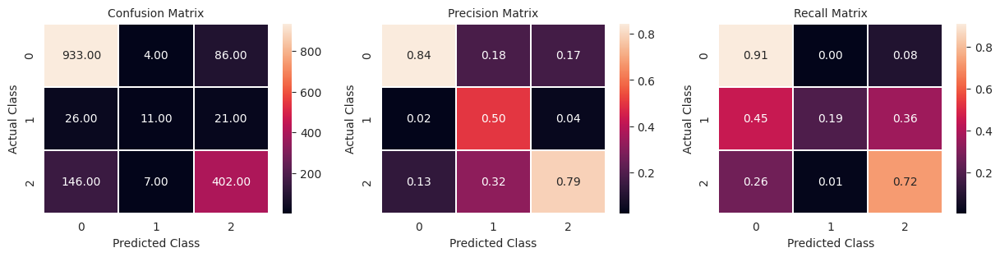


               precision    recall  f1-score   support

           0       0.84      0.91      0.88      1023
           1       0.50      0.19      0.27        58
           2       0.79      0.72      0.76       555

    accuracy                           0.82      1636
   macro avg       0.71      0.61      0.64      1636
weighted avg       0.81      0.82      0.81      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/ already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/cv_2/ already exists
Test log_loss: 0.47%

Running CV 3

Start training the model...
0:	learn: 1.0686373	test: 1.0681844	best: 1.0681844 (0)	total: 4.57ms	remaining: 4.4s
1:	learn: 1.0415403	test: 1.0407284	best: 1.0407284 (1)	total: 11.2ms	remaining: 5.4s
2:	learn: 1.0153478	test

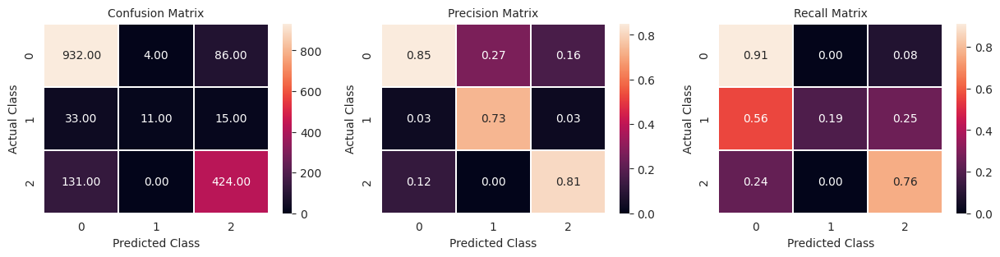


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1022
           1       0.73      0.19      0.30        59
           2       0.81      0.76      0.79       555

    accuracy                           0.84      1636
   macro avg       0.80      0.62      0.65      1636
weighted avg       0.83      0.84      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/ already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/cv_3/ already exists
Test log_loss: 0.45%

Running CV 4

Start training the model...
0:	learn: 1.0685641	test: 1.0684084	best: 1.0684084 (0)	total: 4.59ms	remaining: 4.42s
1:	learn: 1.0416218	test: 1.0410698	best: 1.0410698 (1)	total: 9.1ms	remaining: 4.37s
2:	learn: 1.0156263	tes

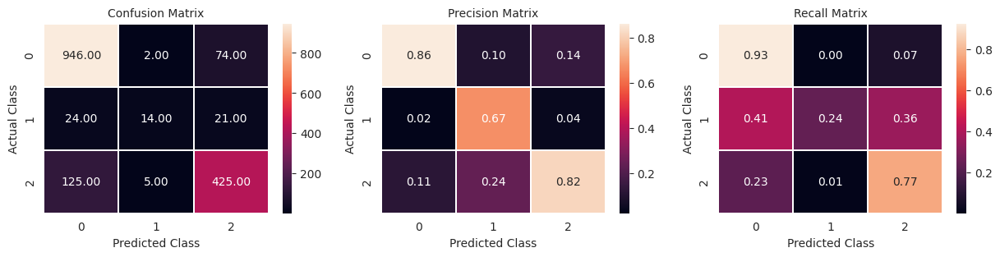


               precision    recall  f1-score   support

           0       0.86      0.93      0.89      1022
           1       0.67      0.24      0.35        59
           2       0.82      0.77      0.79       555

    accuracy                           0.85      1636
   macro avg       0.78      0.64      0.68      1636
weighted avg       0.84      0.85      0.84      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/ already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/cv_4/ already exists
Test log_loss: 0.42%

Running CV 5

Start training the model...
0:	learn: 1.0694120	test: 1.0704929	best: 1.0704929 (0)	total: 4.37ms	remaining: 4.21s
1:	learn: 1.0422996	test: 1.0436790	best: 1.0436790 (1)	total: 8.17ms	remaining: 3.93s
2:	learn: 1.0149728	te

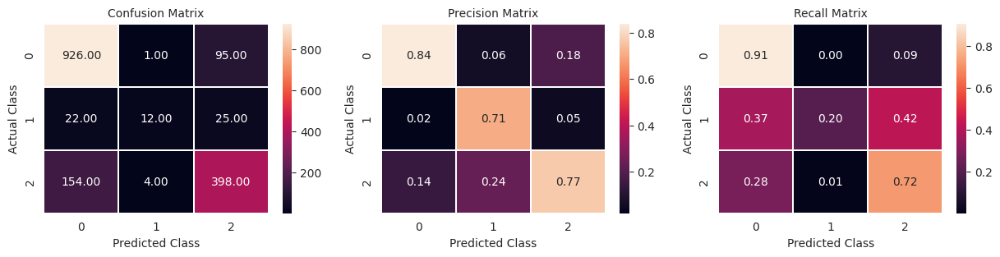


               precision    recall  f1-score   support

           0       0.84      0.91      0.87      1022
           1       0.71      0.20      0.32        59
           2       0.77      0.72      0.74       556

    accuracy                           0.82      1637
   macro avg       0.77      0.61      0.64      1637
weighted avg       0.81      0.82      0.81      1637

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/ already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/cv_5/ already exists
Test log_loss: 0.47%

Running CV 6

Start training the model...
0:	learn: 1.0686628	test: 1.0680693	best: 1.0680693 (0)	total: 4.22ms	remaining: 4.07s
1:	learn: 1.0416642	test: 1.0402719	best: 1.0402719 (1)	total: 8.19ms	remaining: 3.94s
2:	learn: 1.0156520	te

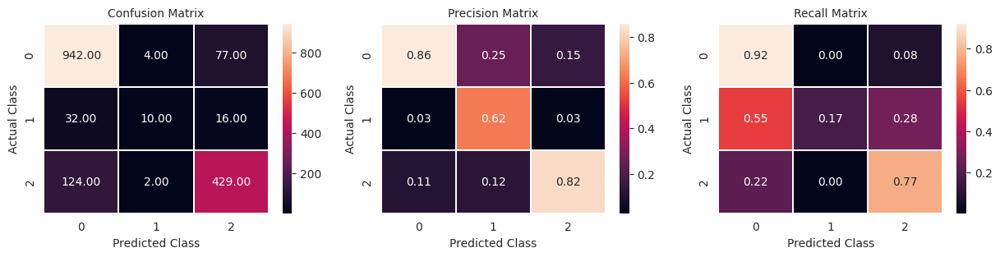


               precision    recall  f1-score   support

           0       0.86      0.92      0.89      1023
           1       0.62      0.17      0.27        58
           2       0.82      0.77      0.80       555

    accuracy                           0.84      1636
   macro avg       0.77      0.62      0.65      1636
weighted avg       0.84      0.84      0.84      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/ already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/cv_6/ already exists
Test log_loss: 0.45%

Running CV 7

Start training the model...
0:	learn: 1.0681506	test: 1.0691113	best: 1.0691113 (0)	total: 4.09ms	remaining: 3.94s
1:	learn: 1.0407804	test: 1.0423461	best: 1.0423461 (1)	total: 7.77ms	remaining: 3.74s
2:	learn: 1.0145051	te

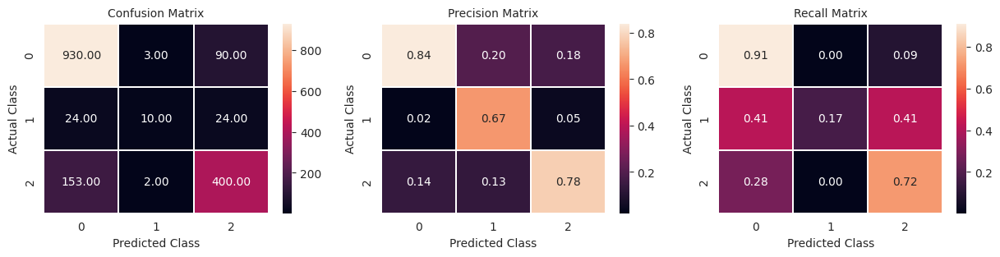


               precision    recall  f1-score   support

           0       0.84      0.91      0.87      1023
           1       0.67      0.17      0.27        58
           2       0.78      0.72      0.75       555

    accuracy                           0.82      1636
   macro avg       0.76      0.60      0.63      1636
weighted avg       0.81      0.82      0.81      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/ already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/cv_7/ already exists
Test log_loss: 0.47%

Running CV 8

Start training the model...
0:	learn: 1.0684826	test: 1.0685429	best: 1.0685429 (0)	total: 5.14ms	remaining: 4.95s
1:	learn: 1.0412508	test: 1.0412453	best: 1.0412453 (1)	total: 9.53ms	remaining: 4.58s
2:	learn: 1.0161875	te

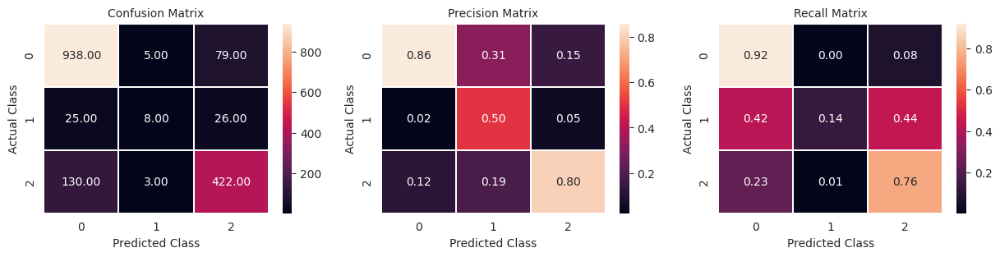


               precision    recall  f1-score   support

           0       0.86      0.92      0.89      1022
           1       0.50      0.14      0.21        59
           2       0.80      0.76      0.78       555

    accuracy                           0.84      1636
   macro avg       0.72      0.60      0.63      1636
weighted avg       0.83      0.84      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/ already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/cv_8/ already exists
Test log_loss: 0.45%

Running CV 9

Start training the model...
0:	learn: 1.0686708	test: 1.0684577	best: 1.0684577 (0)	total: 4.49ms	remaining: 4.32s
1:	learn: 1.0412906	test: 1.0414705	best: 1.0414705 (1)	total: 8.47ms	remaining: 4.08s
2:	learn: 1.0164495	te

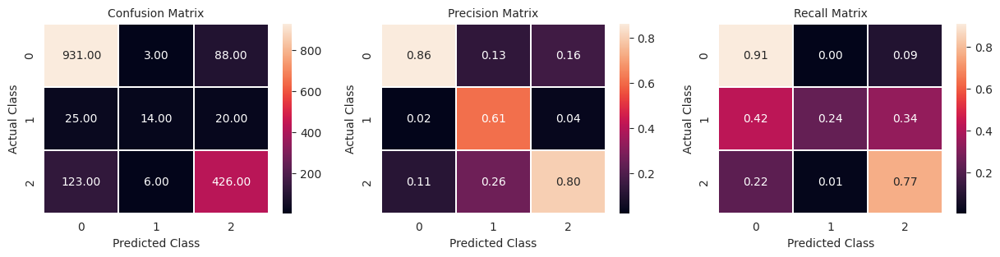


               precision    recall  f1-score   support

           0       0.86      0.91      0.89      1022
           1       0.61      0.24      0.34        59
           2       0.80      0.77      0.78       555

    accuracy                           0.84      1636
   macro avg       0.76      0.64      0.67      1636
weighted avg       0.83      0.84      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/ already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/cv_9/ already exists
Test log_loss: 0.44%

Running CV 10

Start training the model...
0:	learn: 1.0695609	test: 1.0702910	best: 1.0702910 (0)	total: 6.47ms	remaining: 6.23s
1:	learn: 1.0423661	test: 1.0432861	best: 1.0432861 (1)	total: 12ms	remaining: 5.76s
2:	learn: 1.0151649	tes

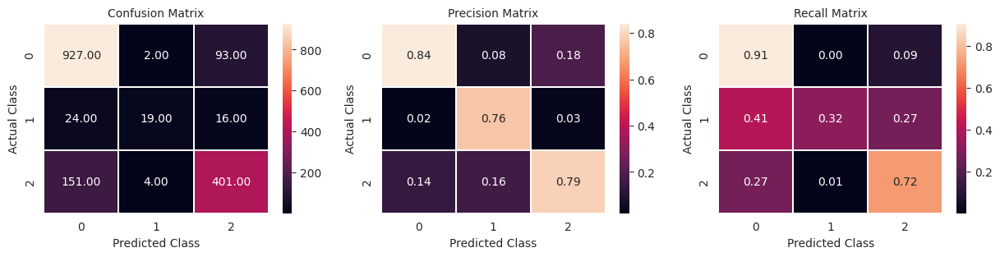


               precision    recall  f1-score   support

           0       0.84      0.91      0.87      1022
           1       0.76      0.32      0.45        59
           2       0.79      0.72      0.75       556

    accuracy                           0.82      1637
   macro avg       0.80      0.65      0.69      1637
weighted avg       0.82      0.82      0.82      1637

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/ already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/cv_10/ already exists
Test log_loss: 0.47%

Running CV 11

Start training the model...
0:	learn: 1.0681227	test: 1.0690069	best: 1.0690069 (0)	total: 4.55ms	remaining: 4.38s
1:	learn: 1.0406419	test: 1.0420000	best: 1.0420000 (1)	total: 9.07ms	remaining: 4.36s
2:	learn: 1.0143751	

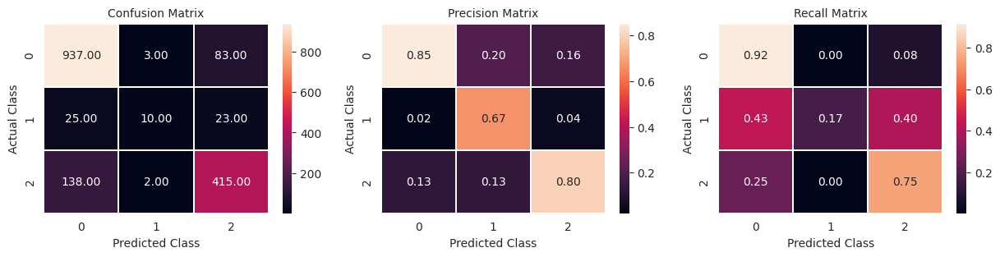


               precision    recall  f1-score   support

           0       0.85      0.92      0.88      1023
           1       0.67      0.17      0.27        58
           2       0.80      0.75      0.77       555

    accuracy                           0.83      1636
   macro avg       0.77      0.61      0.64      1636
weighted avg       0.83      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/ already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/cv_11/ already exists
Test log_loss: 0.46%

Running CV 12

Start training the model...
0:	learn: 1.0694164	test: 1.0693225	best: 1.0693225 (0)	total: 4.47ms	remaining: 4.3s
1:	learn: 1.0423898	test: 1.0418276	best: 1.0418276 (1)	total: 9.27ms	remaining: 4.46s
2:	learn: 1.0165486	t

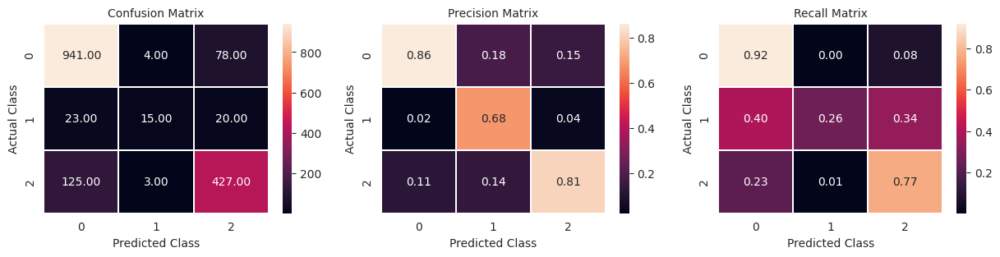


               precision    recall  f1-score   support

           0       0.86      0.92      0.89      1023
           1       0.68      0.26      0.38        58
           2       0.81      0.77      0.79       555

    accuracy                           0.85      1636
   macro avg       0.79      0.65      0.69      1636
weighted avg       0.84      0.85      0.84      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/ already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/cv_12/ already exists
Test log_loss: 0.43%

Running CV 13

Start training the model...
0:	learn: 1.0692075	test: 1.0694474	best: 1.0694474 (0)	total: 4.2ms	remaining: 4.04s
1:	learn: 1.0419132	test: 1.0419476	best: 1.0419476 (1)	total: 8.86ms	remaining: 4.26s
2:	learn: 1.0158452	t

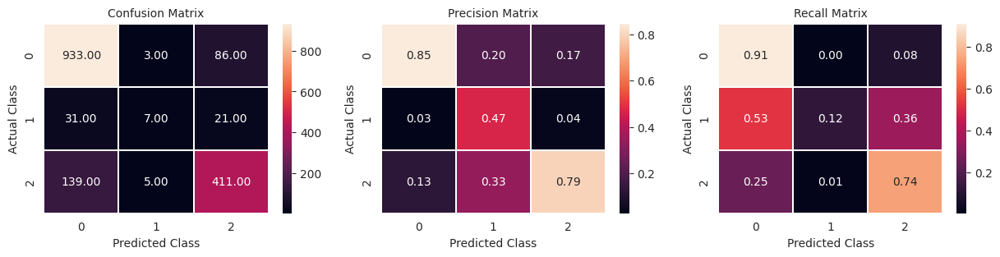


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1022
           1       0.47      0.12      0.19        59
           2       0.79      0.74      0.77       555

    accuracy                           0.83      1636
   macro avg       0.70      0.59      0.61      1636
weighted avg       0.81      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/ already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/cv_13/ already exists
Test log_loss: 0.46%

Running CV 14

Start training the model...
0:	learn: 1.0684352	test: 1.0687037	best: 1.0687037 (0)	total: 3.85ms	remaining: 3.7s
1:	learn: 1.0410505	test: 1.0421312	best: 1.0421312 (1)	total: 7.95ms	remaining: 3.83s
2:	learn: 1.0147568	t

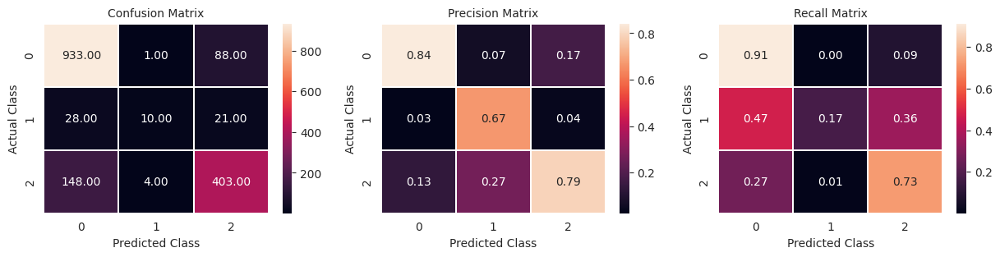


               precision    recall  f1-score   support

           0       0.84      0.91      0.88      1022
           1       0.67      0.17      0.27        59
           2       0.79      0.73      0.76       555

    accuracy                           0.82      1636
   macro avg       0.77      0.60      0.63      1636
weighted avg       0.82      0.82      0.81      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/ already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/cv_14/ already exists
Test log_loss: 0.47%

Running CV 15

Start training the model...
0:	learn: 1.0697294	test: 1.0700954	best: 1.0700954 (0)	total: 4.43ms	remaining: 4.26s
1:	learn: 1.0424094	test: 1.0435311	best: 1.0435311 (1)	total: 8.56ms	remaining: 4.12s
2:	learn: 1.0152270	

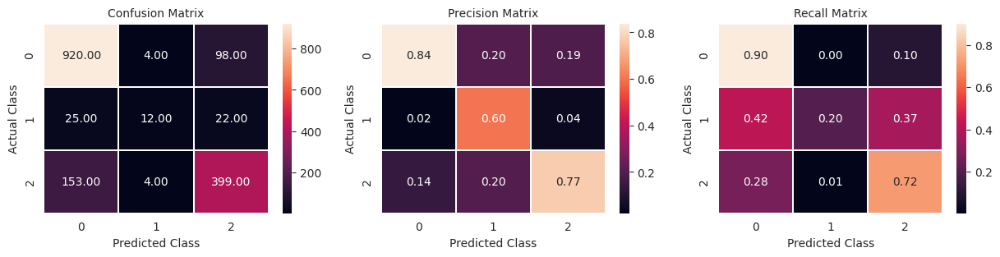


               precision    recall  f1-score   support

           0       0.84      0.90      0.87      1022
           1       0.60      0.20      0.30        59
           2       0.77      0.72      0.74       556

    accuracy                           0.81      1637
   macro avg       0.74      0.61      0.64      1637
weighted avg       0.81      0.81      0.80      1637

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/ already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/cv_15/ already exists
Test log_loss: 0.48%

Running CV 16

Start training the model...
0:	learn: 1.0686123	test: 1.0680367	best: 1.0680367 (0)	total: 5.06ms	remaining: 4.87s
1:	learn: 1.0416883	test: 1.0402924	best: 1.0402924 (1)	total: 9.14ms	remaining: 4.4s
2:	learn: 1.0157804	t

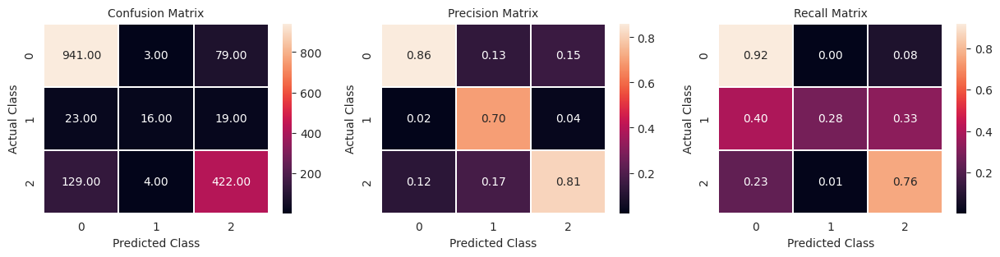


               precision    recall  f1-score   support

           0       0.86      0.92      0.89      1023
           1       0.70      0.28      0.40        58
           2       0.81      0.76      0.79       555

    accuracy                           0.84      1636
   macro avg       0.79      0.65      0.69      1636
weighted avg       0.84      0.84      0.84      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/ already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/cv_16/ already exists
Test log_loss: 0.42%

Running CV 17

Start training the model...
0:	learn: 1.0682366	test: 1.0687965	best: 1.0687965 (0)	total: 4.51ms	remaining: 4.34s
1:	learn: 1.0407133	test: 1.0422420	best: 1.0422420 (1)	total: 8.85ms	remaining: 4.25s
2:	learn: 1.0154824	

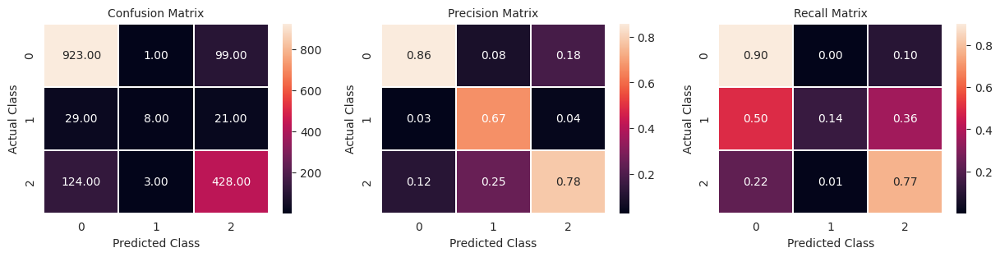


               precision    recall  f1-score   support

           0       0.86      0.90      0.88      1023
           1       0.67      0.14      0.23        58
           2       0.78      0.77      0.78       555

    accuracy                           0.83      1636
   macro avg       0.77      0.60      0.63      1636
weighted avg       0.82      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/ already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/cv_17/ already exists
Test log_loss: 0.46%

Running CV 18

Start training the model...
0:	learn: 1.0691834	test: 1.0696923	best: 1.0696923 (0)	total: 4.4ms	remaining: 4.23s
1:	learn: 1.0419438	test: 1.0426610	best: 1.0426610 (1)	total: 8.04ms	remaining: 3.87s
2:	learn: 1.0167947	t

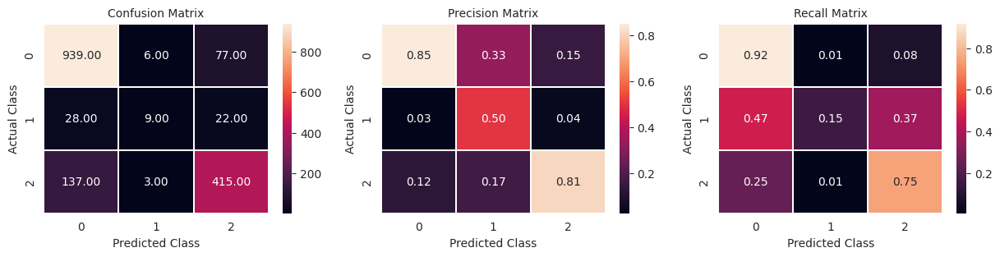


               precision    recall  f1-score   support

           0       0.85      0.92      0.88      1022
           1       0.50      0.15      0.23        59
           2       0.81      0.75      0.78       555

    accuracy                           0.83      1636
   macro avg       0.72      0.61      0.63      1636
weighted avg       0.82      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/ already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/cv_18/ already exists
Test log_loss: 0.46%

Running CV 19

Start training the model...
0:	learn: 1.0681549	test: 1.0688713	best: 1.0688713 (0)	total: 4.2ms	remaining: 4.04s
1:	learn: 1.0410435	test: 1.0417998	best: 1.0417998 (1)	total: 7.92ms	remaining: 3.81s
2:	learn: 1.0148429	t

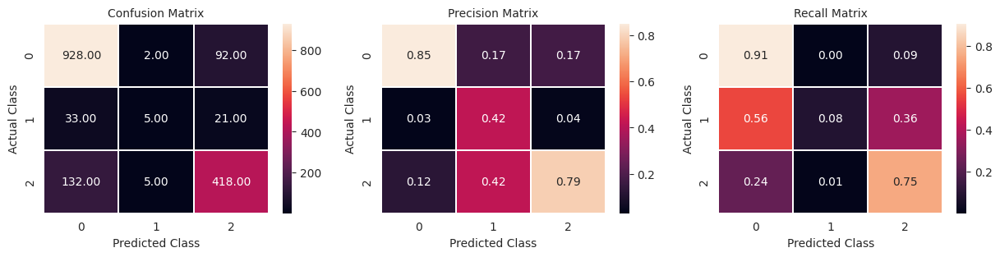


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1022
           1       0.42      0.08      0.14        59
           2       0.79      0.75      0.77       555

    accuracy                           0.83      1636
   macro avg       0.68      0.58      0.60      1636
weighted avg       0.81      0.83      0.81      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/ already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/cv_19/ already exists
Test log_loss: 0.48%

Running CV 20

Start training the model...
0:	learn: 1.0696698	test: 1.0701874	best: 1.0701874 (0)	total: 4.46ms	remaining: 4.29s
1:	learn: 1.0423403	test: 1.0436818	best: 1.0436818 (1)	total: 9.2ms	remaining: 4.43s
2:	learn: 1.0148008	t

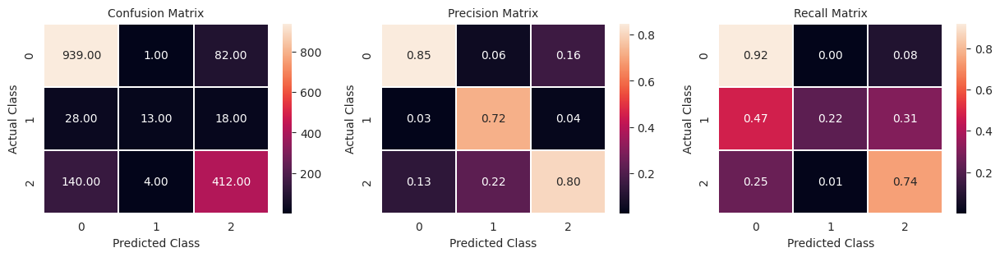


               precision    recall  f1-score   support

           0       0.85      0.92      0.88      1022
           1       0.72      0.22      0.34        59
           2       0.80      0.74      0.77       556

    accuracy                           0.83      1637
   macro avg       0.79      0.63      0.66      1637
weighted avg       0.83      0.83      0.82      1637

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/ already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/cv_20/ already exists
Test log_loss: 0.47%

Running CV 21

Start training the model...
0:	learn: 1.0685829	test: 1.0682587	best: 1.0682587 (0)	total: 3.86ms	remaining: 3.71s
1:	learn: 1.0414949	test: 1.0407533	best: 1.0407533 (1)	total: 7.86ms	remaining: 3.78s
2:	learn: 1.0154836	

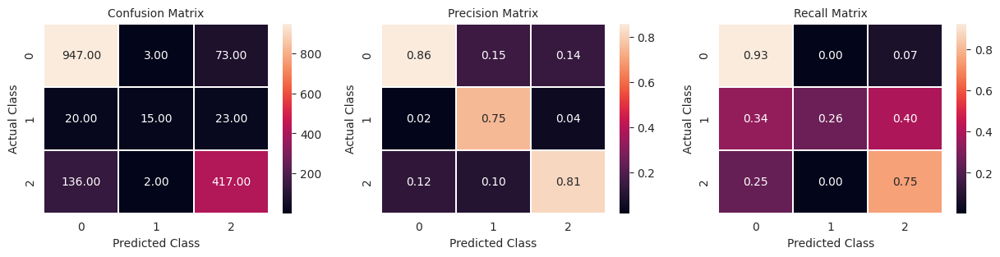


               precision    recall  f1-score   support

           0       0.86      0.93      0.89      1023
           1       0.75      0.26      0.38        58
           2       0.81      0.75      0.78       555

    accuracy                           0.84      1636
   macro avg       0.81      0.65      0.69      1636
weighted avg       0.84      0.84      0.84      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/ already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/cv_21/ already exists
Test log_loss: 0.43%

Running CV 22

Start training the model...
0:	learn: 1.0691427	test: 1.0696036	best: 1.0696036 (0)	total: 4.34ms	remaining: 4.18s
1:	learn: 1.0420358	test: 1.0423633	best: 1.0423633 (1)	total: 8.59ms	remaining: 4.13s
2:	learn: 1.0160434	

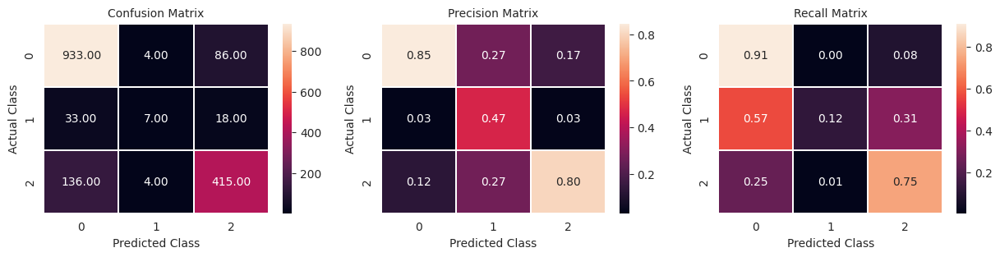


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1023
           1       0.47      0.12      0.19        58
           2       0.80      0.75      0.77       555

    accuracy                           0.83      1636
   macro avg       0.70      0.59      0.61      1636
weighted avg       0.82      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/ already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/cv_22/ already exists
Test log_loss: 0.46%

Running CV 23

Start training the model...
0:	learn: 1.0684553	test: 1.0688750	best: 1.0688750 (0)	total: 4.38ms	remaining: 4.22s
1:	learn: 1.0411220	test: 1.0422103	best: 1.0422103 (1)	total: 8.2ms	remaining: 3.94s
2:	learn: 1.0148198	t

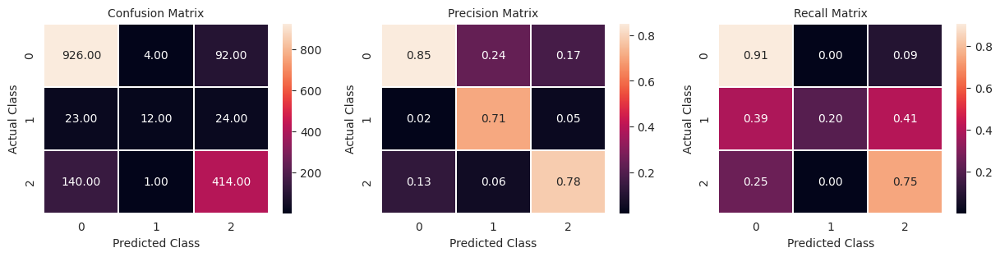


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1022
           1       0.71      0.20      0.32        59
           2       0.78      0.75      0.76       555

    accuracy                           0.83      1636
   macro avg       0.78      0.62      0.65      1636
weighted avg       0.82      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/ already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/cv_23/ already exists
Test log_loss: 0.47%

Running CV 24

Start training the model...
0:	learn: 1.0683705	test: 1.0684406	best: 1.0684406 (0)	total: 5.63ms	remaining: 5.43s
1:	learn: 1.0412989	test: 1.0411547	best: 1.0411547 (1)	total: 10.7ms	remaining: 5.13s
2:	learn: 1.0152138	

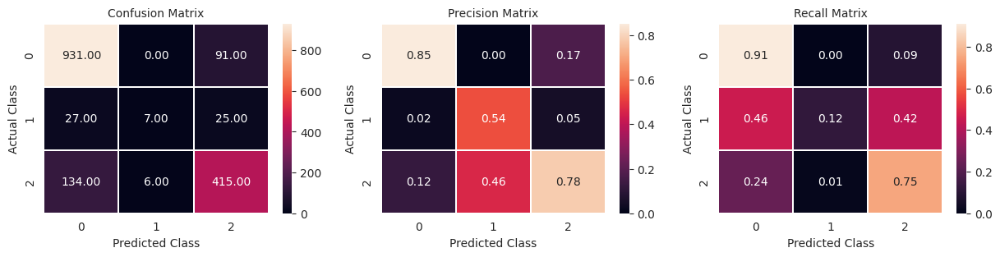


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1022
           1       0.54      0.12      0.19        59
           2       0.78      0.75      0.76       555

    accuracy                           0.83      1636
   macro avg       0.72      0.59      0.61      1636
weighted avg       0.82      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/ already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/cv_24/ already exists
Test log_loss: 0.47%

Running CV 25

Start training the model...
0:	learn: 1.0697987	test: 1.0702007	best: 1.0702007 (0)	total: 4.43ms	remaining: 4.26s
1:	learn: 1.0426057	test: 1.0435743	best: 1.0435743 (1)	total: 8.53ms	remaining: 4.1s
2:	learn: 1.0152437	t

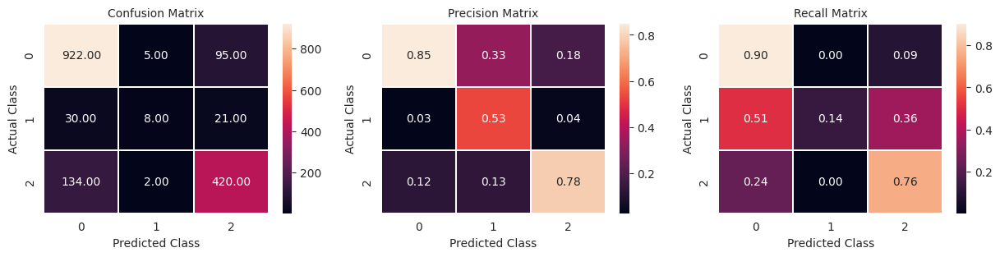


               precision    recall  f1-score   support

           0       0.85      0.90      0.87      1022
           1       0.53      0.14      0.22        59
           2       0.78      0.76      0.77       556

    accuracy                           0.82      1637
   macro avg       0.72      0.60      0.62      1637
weighted avg       0.82      0.82      0.82      1637

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/ already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/cv_25/ already exists
Test log_loss: 0.47%

Running CV 26

Start training the model...
0:	learn: 1.0694677	test: 1.0690309	best: 1.0690309 (0)	total: 4.44ms	remaining: 4.27s
1:	learn: 1.0422744	test: 1.0415261	best: 1.0415261 (1)	total: 8.92ms	remaining: 4.29s
2:	learn: 1.0161260	

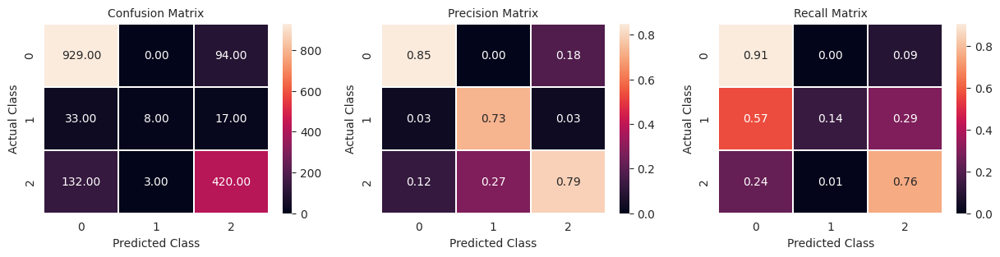


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1023
           1       0.73      0.14      0.23        58
           2       0.79      0.76      0.77       555

    accuracy                           0.83      1636
   macro avg       0.79      0.60      0.63      1636
weighted avg       0.83      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/ already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/cv_26/ already exists
Test log_loss: 0.46%

Running CV 27

Start training the model...
0:	learn: 1.0683255	test: 1.0689322	best: 1.0689322 (0)	total: 4.34ms	remaining: 4.18s
1:	learn: 1.0411748	test: 1.0419471	best: 1.0419471 (1)	total: 8.64ms	remaining: 4.16s
2:	learn: 1.0149049	

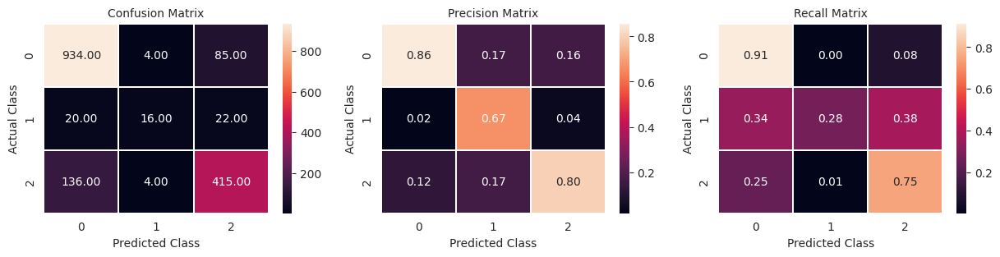


               precision    recall  f1-score   support

           0       0.86      0.91      0.88      1023
           1       0.67      0.28      0.39        58
           2       0.80      0.75      0.77       555

    accuracy                           0.83      1636
   macro avg       0.77      0.65      0.68      1636
weighted avg       0.83      0.83      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/ already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/cv_27/ already exists
Test log_loss: 0.44%

Running CV 28

Start training the model...
0:	learn: 1.0682918	test: 1.0687380	best: 1.0687380 (0)	total: 4.79ms	remaining: 4.62s
1:	learn: 1.0407329	test: 1.0419216	best: 1.0419216 (1)	total: 8.81ms	remaining: 4.24s
2:	learn: 1.0155136	

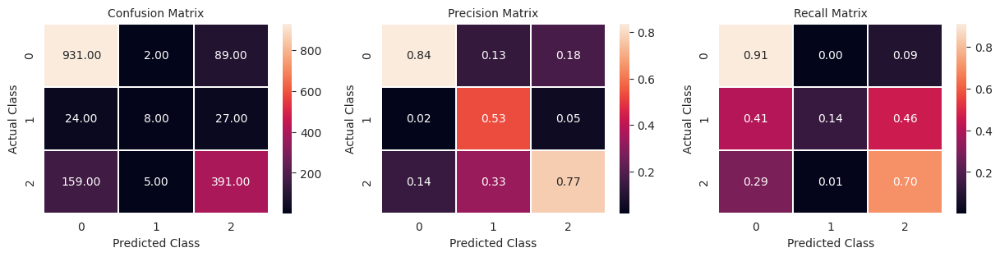


               precision    recall  f1-score   support

           0       0.84      0.91      0.87      1022
           1       0.53      0.14      0.22        59
           2       0.77      0.70      0.74       555

    accuracy                           0.81      1636
   macro avg       0.71      0.58      0.61      1636
weighted avg       0.80      0.81      0.80      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/ already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/cv_28/ already exists
Test log_loss: 0.49%

Running CV 29

Start training the model...
0:	learn: 1.0693204	test: 1.0689757	best: 1.0689757 (0)	total: 3.77ms	remaining: 3.63s
1:	learn: 1.0422861	test: 1.0414783	best: 1.0414783 (1)	total: 7.84ms	remaining: 3.77s
2:	learn: 1.0161906	

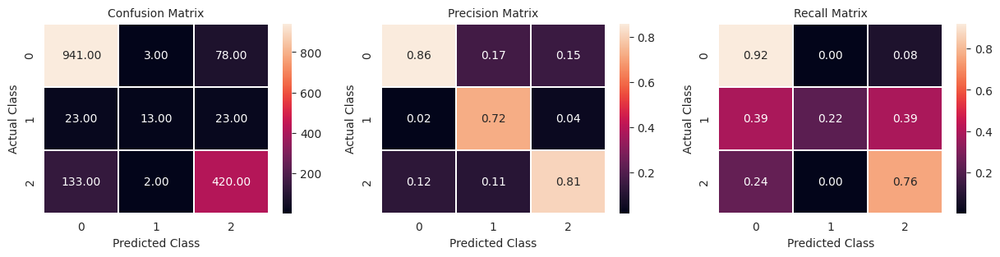


               precision    recall  f1-score   support

           0       0.86      0.92      0.89      1022
           1       0.72      0.22      0.34        59
           2       0.81      0.76      0.78       555

    accuracy                           0.84      1636
   macro avg       0.80      0.63      0.67      1636
weighted avg       0.84      0.84      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/ already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/cv_29/ already exists
Test log_loss: 0.45%

Running CV 30

Start training the model...
0:	learn: 1.0699639	test: 1.0697207	best: 1.0697207 (0)	total: 4.91ms	remaining: 4.73s
1:	learn: 1.0429042	test: 1.0427468	best: 1.0427468 (1)	total: 9.28ms	remaining: 4.46s
2:	learn: 1.0157971	

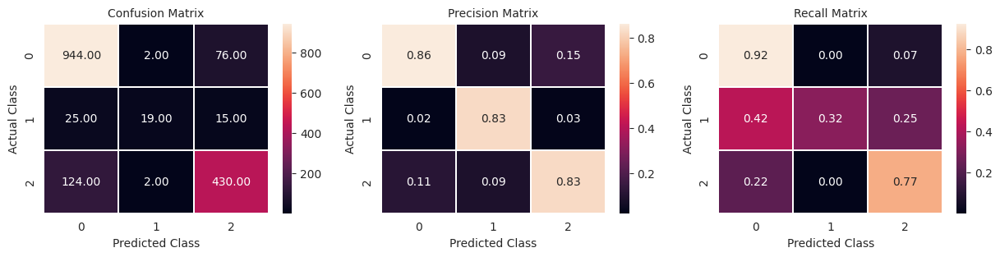


               precision    recall  f1-score   support

           0       0.86      0.92      0.89      1022
           1       0.83      0.32      0.46        59
           2       0.83      0.77      0.80       556

    accuracy                           0.85      1637
   macro avg       0.84      0.67      0.72      1637
weighted avg       0.85      0.85      0.85      1637

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/ already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/cv_30/ already exists
Test log_loss: 0.41%

Running CV 31

Start training the model...
0:	learn: 1.0685427	test: 1.0683433	best: 1.0683433 (0)	total: 5.06ms	remaining: 4.87s
1:	learn: 1.0410055	test: 1.0416153	best: 1.0416153 (1)	total: 9.38ms	remaining: 4.51s
2:	learn: 1.0159846	

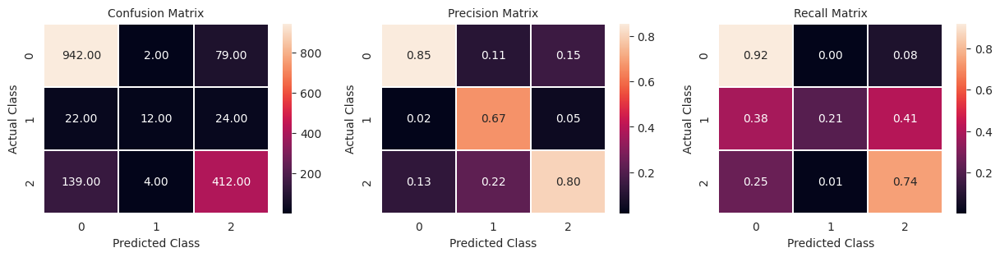


               precision    recall  f1-score   support

           0       0.85      0.92      0.89      1023
           1       0.67      0.21      0.32        58
           2       0.80      0.74      0.77       555

    accuracy                           0.83      1636
   macro avg       0.77      0.62      0.66      1636
weighted avg       0.83      0.83      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/ already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/cv_31/ already exists
Test log_loss: 0.46%

Running CV 32

Start training the model...
0:	learn: 1.0683791	test: 1.0689428	best: 1.0689428 (0)	total: 4.6ms	remaining: 4.43s
1:	learn: 1.0409181	test: 1.0416899	best: 1.0416899 (1)	total: 9.2ms	remaining: 4.42s
2:	learn: 1.0149062	te

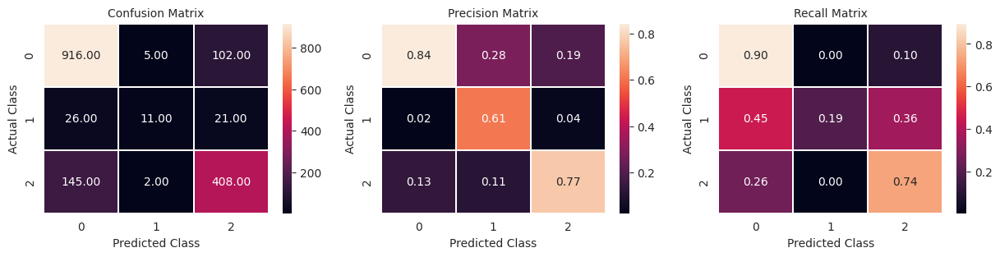


               precision    recall  f1-score   support

           0       0.84      0.90      0.87      1023
           1       0.61      0.19      0.29        58
           2       0.77      0.74      0.75       555

    accuracy                           0.82      1636
   macro avg       0.74      0.61      0.64      1636
weighted avg       0.81      0.82      0.81      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/ already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/cv_32/ already exists
Test log_loss: 0.48%

Running CV 33

Start training the model...
0:	learn: 1.0691037	test: 1.0697660	best: 1.0697660 (0)	total: 4.34ms	remaining: 4.18s
1:	learn: 1.0416777	test: 1.0423799	best: 1.0423799 (1)	total: 8.34ms	remaining: 4.01s
2:	learn: 1.0153447	

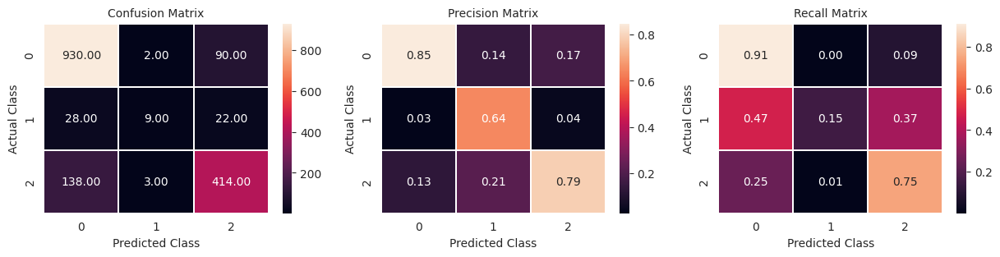


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1022
           1       0.64      0.15      0.25        59
           2       0.79      0.75      0.77       555

    accuracy                           0.83      1636
   macro avg       0.76      0.60      0.63      1636
weighted avg       0.82      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/ already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/cv_33/ already exists
Test log_loss: 0.47%

Running CV 34

Start training the model...
0:	learn: 1.0690759	test: 1.0692865	best: 1.0692865 (0)	total: 4.16ms	remaining: 4s
1:	learn: 1.0415348	test: 1.0419573	best: 1.0419573 (1)	total: 8.16ms	remaining: 3.93s
2:	learn: 1.0164744	tes

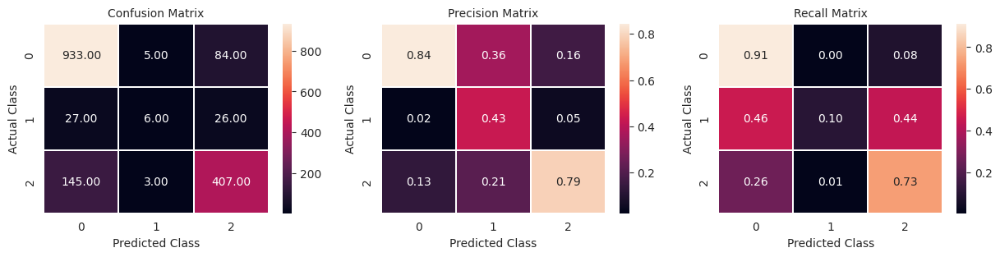


               precision    recall  f1-score   support

           0       0.84      0.91      0.88      1022
           1       0.43      0.10      0.16        59
           2       0.79      0.73      0.76       555

    accuracy                           0.82      1636
   macro avg       0.69      0.58      0.60      1636
weighted avg       0.81      0.82      0.81      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/ already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/cv_34/ already exists
Test log_loss: 0.47%

Running CV 35

Start training the model...
0:	learn: 1.0699235	test: 1.0698200	best: 1.0698200 (0)	total: 4.48ms	remaining: 4.32s
1:	learn: 1.0428129	test: 1.0428709	best: 1.0428709 (1)	total: 8.57ms	remaining: 4.12s
2:	learn: 1.0156968	

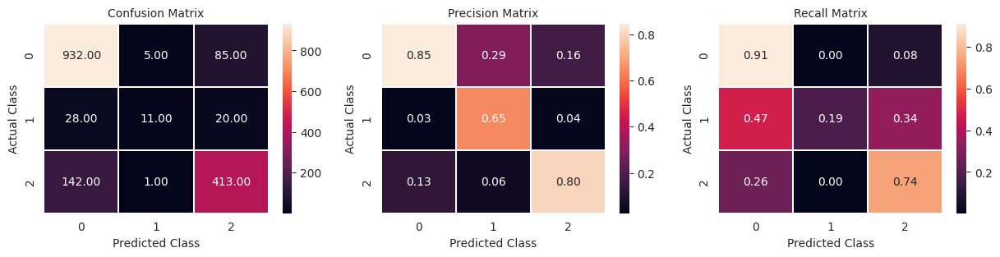


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1022
           1       0.65      0.19      0.29        59
           2       0.80      0.74      0.77       556

    accuracy                           0.83      1637
   macro avg       0.76      0.61      0.65      1637
weighted avg       0.82      0.83      0.82      1637

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/ already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/cv_35/ already exists
Test log_loss: 0.46%

Running CV 36

Start training the model...
0:	learn: 1.0687274	test: 1.0678728	best: 1.0678728 (0)	total: 4.8ms	remaining: 4.62s
1:	learn: 1.0417903	test: 1.0406356	best: 1.0406356 (1)	total: 9.06ms	remaining: 4.36s
2:	learn: 1.0167509	t

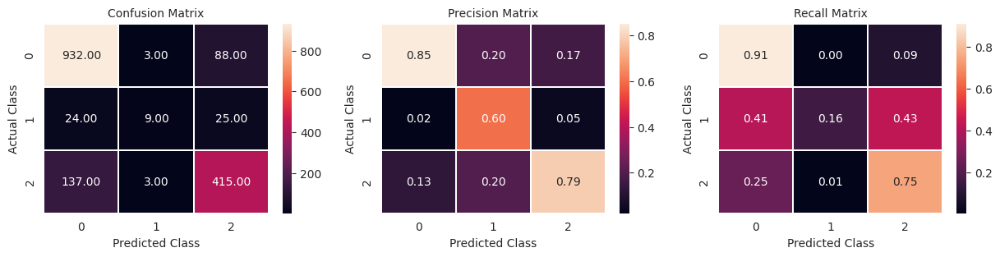


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1023
           1       0.60      0.16      0.25        58
           2       0.79      0.75      0.77       555

    accuracy                           0.83      1636
   macro avg       0.75      0.60      0.63      1636
weighted avg       0.82      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/ already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/cv_36/ already exists
Test log_loss: 0.46%

Running CV 37

Start training the model...
0:	learn: 1.0683659	test: 1.0685879	best: 1.0685879 (0)	total: 4.43ms	remaining: 4.27s
1:	learn: 1.0411282	test: 1.0410283	best: 1.0410283 (1)	total: 8.32ms	remaining: 4s
2:	learn: 1.0161554	tes

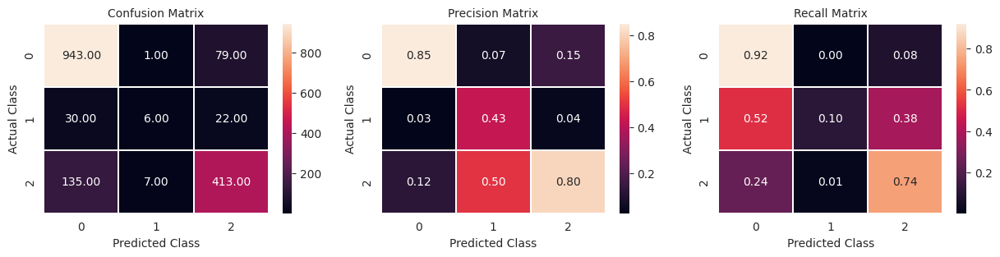


               precision    recall  f1-score   support

           0       0.85      0.92      0.89      1023
           1       0.43      0.10      0.17        58
           2       0.80      0.74      0.77       555

    accuracy                           0.83      1636
   macro avg       0.69      0.59      0.61      1636
weighted avg       0.82      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/ already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/cv_37/ already exists
Test log_loss: 0.46%

Running CV 38

Start training the model...
0:	learn: 1.0683054	test: 1.0689652	best: 1.0689652 (0)	total: 4.26ms	remaining: 4.1s
1:	learn: 1.0408818	test: 1.0427419	best: 1.0427419 (1)	total: 8.46ms	remaining: 4.07s
2:	learn: 1.0154280	t

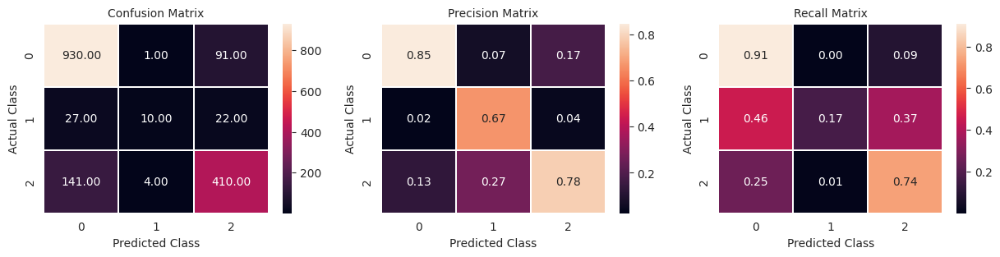


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1022
           1       0.67      0.17      0.27        59
           2       0.78      0.74      0.76       555

    accuracy                           0.83      1636
   macro avg       0.77      0.61      0.64      1636
weighted avg       0.82      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/ already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/cv_38/ already exists
Test log_loss: 0.47%

Running CV 39

Start training the model...
0:	learn: 1.0684081	test: 1.0687372	best: 1.0687372 (0)	total: 4.74ms	remaining: 4.56s
1:	learn: 1.0411083	test: 1.0415447	best: 1.0415447 (1)	total: 9.65ms	remaining: 4.64s
2:	learn: 1.0150431	

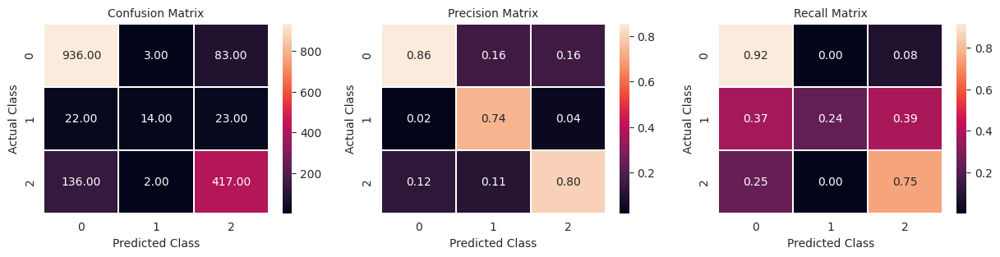


               precision    recall  f1-score   support

           0       0.86      0.92      0.88      1022
           1       0.74      0.24      0.36        59
           2       0.80      0.75      0.77       555

    accuracy                           0.84      1636
   macro avg       0.80      0.63      0.67      1636
weighted avg       0.83      0.84      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/ already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_catboost_v0_cal/cv_39/ already exists
Test log_loss: 0.46%
All Valuation lOGlOSS: [0.457, 0.483, 0.473, 0.448, 0.422, 0.473, 0.446, 0.474, 0.452, 0.437, 0.467, 0.463, 0.432, 0.462, 0.473, 0.484, 0.422, 0.464, 0.455, 0.481, 0.474, 0.43, 0.46, 0.468, 0.469, 0.469, 0.456, 0.437, 0.492, 0.447, 0.412,

In [ ]:
test_results_df_C,test_results_df_CL,test_results_df_D, test_results_df = run_experiment(X_train,
                                                                                         X_test,
                                                                                         best_params=best_par,
                                                                                         experiment_name="model_catboost_v0_cal",
                                                                                         splits=5,
                                                                                         n_repeats=8,
                                                                                         rs=42,
                                                                                         calibrate=True)

In [ ]:
res_cal = [0.467, 0.487, 0.467, 0.461, 0.431, 0.474, 0.447, 0.479, 0.456, 0.445, 0.472, 0.472, 0.434, 0.464, 0.468, 0.483, 0.433, 0.474, 0.445, 0.478,
           0.471, 0.437, 0.466, 0.462, 0.472, 0.466, 0.456, 0.443, 0.492, 0.455, 0.423, 0.467, 0.484, 0.47, 0.468, 0.464, 0.452, 0.453, 0.475, 0.469]

res_unc = [0.465, 0.486, 0.462, 0.458, 0.439, 0.469, 0.451, 0.477, 0.46, 0.446, 0.478, 0.463, 0.439, 0.457, 0.469, 0.476, 0.437, 0.476, 0.449, 0.479,
          0.475, 0.439, 0.458, 0.468, 0.471, 0.467, 0.466, 0.447, 0.486, 0.451, 0.432, 0.471, 0.477, 0.469, 0.466, 0.463, 0.447, 0.452, 0.477, 0.472]

res_lgbm = [0.463, 0.486, 0.463, 0.454, 0.427, 0.475, 0.447, 0.475, 0.452, 0.428, 0.468, 0.458, 0.434, 0.456, 0.468, 0.484, 0.418, 0.462, 0.447, 0.482,
            0.478, 0.437, 0.462, 0.457, 0.469, 0.465, 0.466, 0.431, 0.49, 0.448, 0.411, 0.458, 0.486, 0.468, 0.469, 0.468, 0.455, 0.444, 0.466, 0.461]

res_lgbm_v2_cal = [0.46, 0.491, 0.466, 0.453, 0.423, 0.478, 0.449, 0.478, 0.456, 0.434, 0.476, 0.454, 0.434, 0.463, 0.466, 0.491, 0.424, 0.465, 0.444,
                   0.48, 0.474, 0.439, 0.46, 0.457, 0.465, 0.467, 0.469, 0.434, 0.495, 0.451, 0.422, 0.459, 0.494, 0.475, 0.47, 0.468, 0.454, 0.449, 0.473, 0.459]

res_lgbm_v1_unc = [0.456, 0.475, 0.449, 0.451, 0.416, 0.459, 0.447, 0.468, 0.455, 0.424, 0.469, 0.444, 0.424, 0.45, 0.463, 0.474, 0.413, 0.463, 0.442, 0.47, 0.47,
                   0.432, 0.443, 0.454, 0.454, 0.456, 0.462, 0.424, 0.484, 0.441, 0.41, 0.455, 0.48, 0.467, 0.459, 0.455, 0.434, 0.436, 0.465, 0.457]

res_xgb_v0_unc = [0.447, 0.463, 0.437, 0.436, 0.408, 0.452, 0.431, 0.452, 0.44, 0.416, 0.455, 0.437, 0.416, 0.434, 0.453, 0.463, 0.405, 0.448, 0.432,
                  0.459, 0.458, 0.418, 0.432, 0.446, 0.448, 0.443, 0.446, 0.413, 0.473, 0.428, 0.396, 0.443, 0.458, 0.451, 0.447, 0.444, 0.425, 0.428, 0.456, 0.446]

res_xgb_v1_cal = [0.458, 0.482, 0.456, 0.442, 0.416, 0.471, 0.442, 0.467, 0.447, 0.426, 0.463, 0.454, 0.425, 0.455, 0.464, 0.483, 0.416, 0.452,
                 0.441, 0.472, 0.467, 0.427, 0.454, 0.457, 0.461, 0.454, 0.457, 0.424, 0.488, 0.442, 0.402, 0.451, 0.477, 0.463, 0.461, 0.458, 0.449, 0.439, 0.468, 0.454]

model_catboost_v0_unc = [0.452, 0.468, 0.455, 0.444, 0.416, 0.457, 0.438, 0.465, 0.451, 0.431, 0.464, 0.445, 0.423, 0.449, 0.466, 0.467, 0.415, 0.465, 0.444, 0.471, 0.467, 0.425, 0.44,
                           0.462, 0.463, 0.458, 0.449, 0.431, 0.481, 0.438, 0.405, 0.449, 0.47, 0.466, 0.461, 0.45, 0.439, 0.446, 0.463, 0.458]

model_catboost_v0_unc = [0.452, 0.468, 0.455, 0.444, 0.416, 0.457, 0.438, 0.465, 0.451, 0.431, 0.464, 0.445, 0.423, 0.449, 0.466, 0.467, 0.415, 0.465, 0.444, 0.471, 0.467, 0.425, 0.44,
                         0.462, 0.463, 0.458, 0.449, 0.431, 0.481, 0.438, 0.405, 0.449, 0.47, 0.466, 0.461, 0.45, 0.439, 0.446, 0.463, 0.458]

np.mean(res_cal),np.mean(res_unc),np.mean(res_lgbm),np.mean(res_lgbm_v2_cal), np.mean(res_lgbm_v1_unc), np.mean(res_xgb_v0_unc), np.mean(res_xgb_v1_cal), np.mean(model_catboost_v0_unc)

(0.46204999999999996,
 0.46225000000000005,
 0.4584,
 0.460475,
 0.45124999999999993,
 0.43957499999999994,
 0.452125,
 0.45017500000000005)

In [ ]:
test_results_df

,Status_C,Status_CL,Status_D
0,0.732833,0.020189,0.246977
1,0.731462,0.096294,0.172243
2,0.037882,0.014844,0.947274
3,0.934685,0.004404,0.060911
4,0.814680,0.038588,0.146732
...,...,...,...
5266,0.846393,0.035599,0.118008
5267,0.949893,0.002127,0.047980
5268,0.885480,0.005311,0.109209
5269,0.977451,0.012779,0.009770


In [ ]:
experiment_name="model_catboost_v0_unc"

sub = pd.read_csv("sample_submission.csv", index_col=0)
sub.iloc[:,:] = test_results_df.values
sub.to_csv(f"Results/{experiment_name}.csv")

In [ ]:
sub

,Status_C,Status_CL,Status_D
id,,,
7905,0.732833,0.020189,0.246977
7906,0.731462,0.096294,0.172243
7907,0.037882,0.014844,0.947274
7908,0.934685,0.004404,0.060911
7909,0.814680,0.038588,0.146732
...,...,...,...
13171,0.846393,0.035599,0.118008
13172,0.949893,0.002127,0.047980
13173,0.885480,0.005311,0.109209


### 6.7 Voting Classifier

In [ ]:
best_par_rf = {'n_estimators': 530, 'max_depth': 16, 'min_samples_split': 2, 'min_samples_leaf': 2, 'max_samples': 0.8691077199062475, 'max_features': 6}
best_par_lgb = {'num_leaves': 58, 'subsample': 0.6824880137754312, 'colsample_bytree': 0.8553788777382636, 'min_child_samples': 32, 'min_child_weight': 0.16200403161409616,
                'reg_alpha': 0.09786765613808512, 'reg_lambda': 0.03489729616997099, 'n_estimators': 280, 'max_depth': 7, 'learning_rate': 0.05500614673556781}
best_par_xgb =  {'objective': 'multi_logloss','num_leaves': 65, 'subsample': 0.5270534160517968, 'colsample_bytree': 0.5984679413500695, 'min_child_samples': 35, 'min_child_weight': 0.017566939676964665,
                 'reg_alpha': 0.002847504385636832, 'reg_lambda': 0.3902105729942543, 'n_estimators': 593, 'max_depth': 5, 'learning_rate': 0.018353098931699}
best_par_cat = {'loss_function': 'MultiClass','early_stopping_rounds':51, 'l2_leaf_reg': 0.00012778855734723414, 'model_size_reg': 0.0007227220762895177, 'n_estimators': 964, 'depth': 6,
                'learning_rate': 0.029736117595598605, 'random_strength': 4.862917969265431, 'subsample': 0.4784765189410421,'loss_function': 'MultiClass', 'early_stopping_rounds':51,
                 "bootstrap_type": "Bernoulli","eval_metric": "MultiClass",}

rs=42

rf_clf = RandomForestClassifier(random_state=rs, **best_par_rf)
lgb_clf = LGBMClassifier(random_state = rs, force_row_wise=True, **best_par_lgb)
xgb_clf = XGBClassifier(random_state = rs, **best_par_xgb)
cat_clf = CatBoostClassifier(random_state = rs, **best_par_cat)

models_vc =VotingClassifier(estimators=[("xgb", xgb_clf),
                                     ("lgb", lgb_clf),
                                     ("cat", cat_clf),
                                     ("rf", rf_clf)],
                                      voting="soft",
                                      weights=[1/0.4395,1/0.4512,1/0.4502,1/0.4623])

In [ ]:
np.mean(res_cal),np.mean(res_unc),np.mean(res_lgbm),np.mean(res_lgbm_v2_cal), np.mean(res_lgbm_v1_unc), np.mean(res_xgb_v0_unc), np.mean(res_xgb_v1_cal), np.mean(model_catboost_v0_unc)
#np.mean(res_xgb_v0_unc)

(0.46204999999999996,
 0.46225000000000005,
 0.4584,
 0.460475,
 0.45124999999999993,
 0.43957499999999994,
 0.452125,
 0.45017500000000005)

**Check Unconstrained Model**

In [ ]:
X = X_train.drop(columns=["Status"]).copy()
y = X_train["Status"].copy()

In [ ]:
%%time
skf = RepeatedStratifiedKFold(n_splits=5, n_repeats=5, random_state=48)
clf = models_vc
cross_val_score(clf, X, y, n_jobs=-1, cv=skf, scoring="neg_log_loss").mean()

#### 6.5.2 Fit the Model

In [ ]:
def run_experiment(train, test_data_file, best_params=best_par, experiment_name="model_voting", splits=5, n_repeats=8, rs=42, calibrate=True):

  skf = RepeatedStratifiedKFold(n_splits=splits, n_repeats=n_repeats, random_state=rs)

  test_results_df_C = pd.DataFrame(index=test_data_file.index, columns=list(range(splits*n_repeats)))
  test_results_df_CL = pd.DataFrame(index=test_data_file.index, columns=list(range(splits*n_repeats)))
  test_results_df_D = pd.DataFrame(index=test_data_file.index, columns=list(range(splits*n_repeats)))

  test_results_df = pd.DataFrame(index=test_data_file.index, columns=["Status_C","Status_CL","Status_D"])

  all_logloss = []
  all_AUC_pr = []

  for i, (train_index, valid_index) in enumerate(skf.split(X_train,strat_feature)):

    print(f"\nRunning CV {i}\n")
    ########################################################################## Prepare the Dataset:
    X_trn = train.iloc[train_index,:]
    X_val = train.iloc[valid_index,:]

    X = X_trn.drop(columns=["Status"]).copy()
    y = X_trn["Status"].copy()

    val_X = X_val.drop(columns=["Status"]).copy()
    val_y = X_val["Status"].copy()

    test_X = test_data_file.drop(columns=["Status"]).copy()
    #################################################################### End of Dataset Preparation

    ##################################################################### Generate and Fit Model
    rf_clf = RandomForestClassifier(random_state=rs, **best_par_rf)
    lgb_clf = LGBMClassifier(random_state = rs, force_row_wise=True, verbose =0, **best_par_lgb)
    xgb_clf = XGBClassifier(random_state = rs, **best_par_xgb)
    cat_clf = CatBoostClassifier(random_state = rs, **best_par_cat)

    model =VotingClassifier(estimators=[("xgb", xgb_clf),
                                        ("lgb", lgb_clf),
                                        ("cat", cat_clf),
                                        ("rf", rf_clf)],
                                          voting="soft",
                                          weights=[1/0.4395,1/0.4512,1/0.4502,1/0.4623])
    print("Start training the model...")
    model.fit(X,y)
    if calibrate:
      print("Model Calibration")
      cal_model = CalibratedClassifierCV(model, method="sigmoid", cv="prefit")
      cal_model.fit(val_X, val_y)
      model = cal_model
    print("Model training finished")

    val_probs = model.predict_proba(val_X)
    test_prob = model.predict_proba(test_X)

    logloss = log_loss(val_y, val_probs)

    y_hat_val = model.predict(val_X)

    plot_confusion_matrix(val_y, y_hat_val, labels=[0,1,2])

    print("\n",classification_report(y_true=val_y, y_pred=y_hat_val))

    test_results_df_C.iloc[:,i] = test_prob[:,0]
    test_results_df_CL.iloc[:,i] = test_prob[:,1]
    test_results_df_D.iloc[:,i] = test_prob[:,2]

    ##################################################################### Save the Model
    folders_experiment = f"/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/{experiment_name}/"
    folders_experiment_cv = f"/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/{experiment_name}/cv_{i}/"

    list_directories = [folder_data,folders_experiment,folders_experiment_cv]

    for path in list_directories:
      try:
          os.mkdir(path)
      except OSError as error:
          print(f"{path} already exists")

    os.chdir(folders_experiment_cv)
    dump(clf, f'{experiment_name}.joblib')
    os.chdir(folder_data)

    print(f"Test log_loss: {round(logloss, 2)}%")
    all_logloss.append(round(logloss, 3))

  ##################################################################### Create Model Output
  test_results_df_C["Mean"] = test_results_df_C.mean(axis=1)
  test_results_df_CL["Mean"] = test_results_df_CL.mean(axis=1)
  test_results_df_D["Mean"] = test_results_df_D.mean(axis=1)

  test_results_df.loc[:,"Status_C"] = test_results_df_C["Mean"].values
  test_results_df.loc[:,"Status_CL"] = test_results_df_CL["Mean"].values
  test_results_df.loc[:,"Status_D"] = test_results_df_D["Mean"].values

  print(f"All Valuation lOGlOSS: {all_logloss}")

  return test_results_df_C,test_results_df_CL,test_results_df_D, test_results_df


Running CV 0

Start training the model...
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain

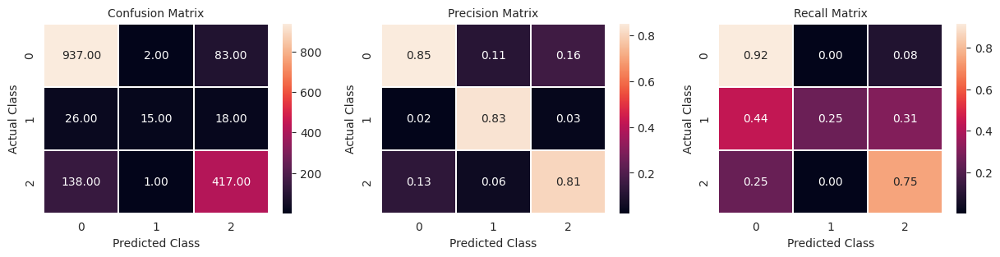


               precision    recall  f1-score   support

           0       0.85      0.92      0.88      1022
           1       0.83      0.25      0.39        59
           2       0.81      0.75      0.78       556

    accuracy                           0.84      1637
   macro avg       0.83      0.64      0.68      1637
weighted avg       0.83      0.84      0.83      1637

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
Test log_loss: 0.45%

Running CV 1

Start training the model...
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

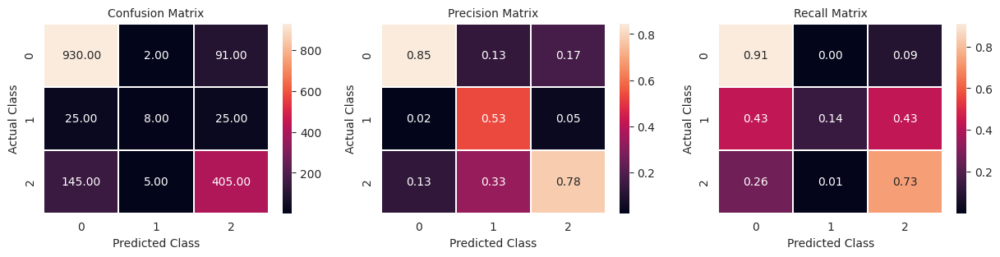


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1023
           1       0.53      0.14      0.22        58
           2       0.78      0.73      0.75       555

    accuracy                           0.82      1636
   macro avg       0.72      0.59      0.62      1636
weighted avg       0.81      0.82      0.81      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_voting_v0_cal/ already exists
Test log_loss: 0.48%

Running CV 2

Start training the model...
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further s

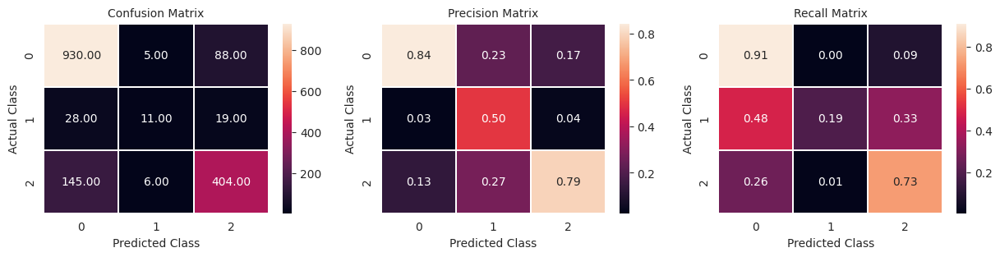


               precision    recall  f1-score   support

           0       0.84      0.91      0.87      1023
           1       0.50      0.19      0.27        58
           2       0.79      0.73      0.76       555

    accuracy                           0.82      1636
   macro avg       0.71      0.61      0.64      1636
weighted avg       0.81      0.82      0.81      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_voting_v0_cal/ already exists
Test log_loss: 0.46%

Running CV 3

Start training the model...
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further s

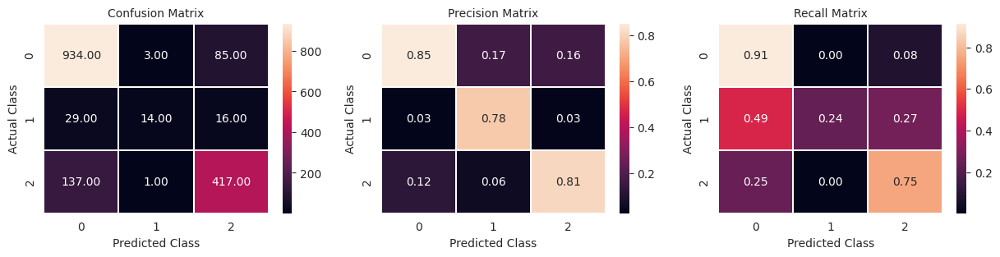


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1022
           1       0.78      0.24      0.36        59
           2       0.81      0.75      0.78       555

    accuracy                           0.83      1636
   macro avg       0.81      0.63      0.67      1636
weighted avg       0.83      0.83      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_voting_v0_cal/ already exists
Test log_loss: 0.44%

Running CV 4

Start training the model...
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further s

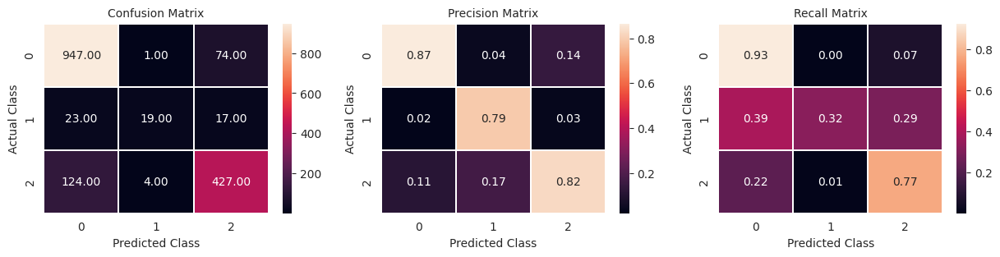


               precision    recall  f1-score   support

           0       0.87      0.93      0.90      1022
           1       0.79      0.32      0.46        59
           2       0.82      0.77      0.80       555

    accuracy                           0.85      1636
   macro avg       0.83      0.67      0.72      1636
weighted avg       0.85      0.85      0.85      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_voting_v0_cal/ already exists
Test log_loss: 0.42%

Running CV 5

Start training the model...
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further s

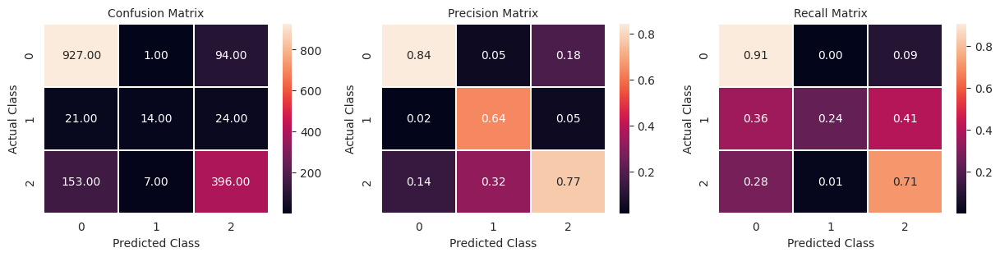


               precision    recall  f1-score   support

           0       0.84      0.91      0.87      1022
           1       0.64      0.24      0.35        59
           2       0.77      0.71      0.74       556

    accuracy                           0.82      1637
   macro avg       0.75      0.62      0.65      1637
weighted avg       0.81      0.82      0.81      1637

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_voting_v0_cal/ already exists
Test log_loss: 0.47%

Running CV 6

Start training the model...
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further s

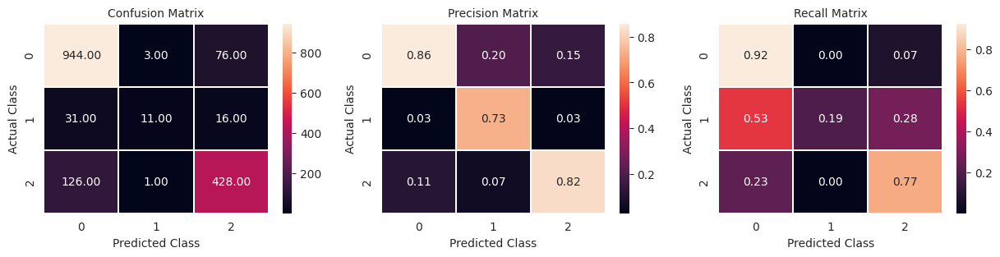


               precision    recall  f1-score   support

           0       0.86      0.92      0.89      1023
           1       0.73      0.19      0.30        58
           2       0.82      0.77      0.80       555

    accuracy                           0.85      1636
   macro avg       0.80      0.63      0.66      1636
weighted avg       0.84      0.85      0.84      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_voting_v0_cal/ already exists
Test log_loss: 0.44%

Running CV 7

Start training the model...
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further s

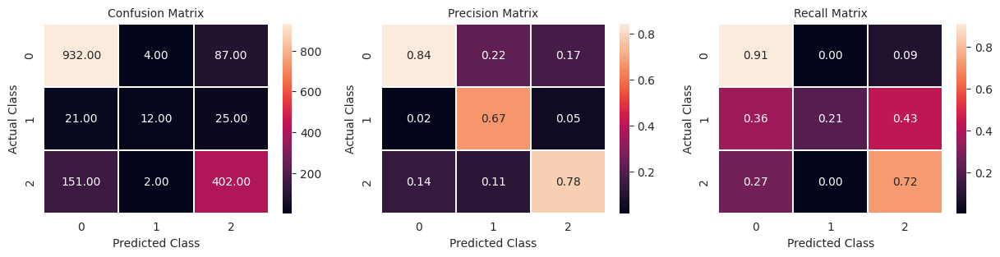


               precision    recall  f1-score   support

           0       0.84      0.91      0.88      1023
           1       0.67      0.21      0.32        58
           2       0.78      0.72      0.75       555

    accuracy                           0.82      1636
   macro avg       0.76      0.61      0.65      1636
weighted avg       0.82      0.82      0.81      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_voting_v0_cal/ already exists
Test log_loss: 0.47%

Running CV 8

Start training the model...
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further s

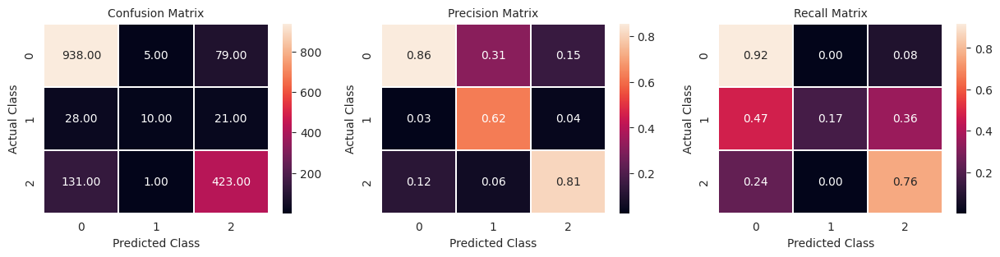


               precision    recall  f1-score   support

           0       0.86      0.92      0.89      1022
           1       0.62      0.17      0.27        59
           2       0.81      0.76      0.78       555

    accuracy                           0.84      1636
   macro avg       0.76      0.62      0.65      1636
weighted avg       0.83      0.84      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_voting_v0_cal/ already exists
Test log_loss: 0.45%

Running CV 9

Start training the model...
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further s

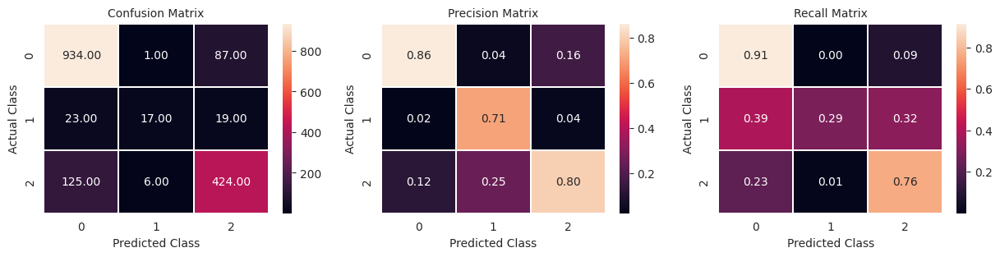


               precision    recall  f1-score   support

           0       0.86      0.91      0.89      1022
           1       0.71      0.29      0.41        59
           2       0.80      0.76      0.78       555

    accuracy                           0.84      1636
   macro avg       0.79      0.66      0.69      1636
weighted avg       0.84      0.84      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_voting_v0_cal/ already exists
Test log_loss: 0.43%

Running CV 10

Start training the model...
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

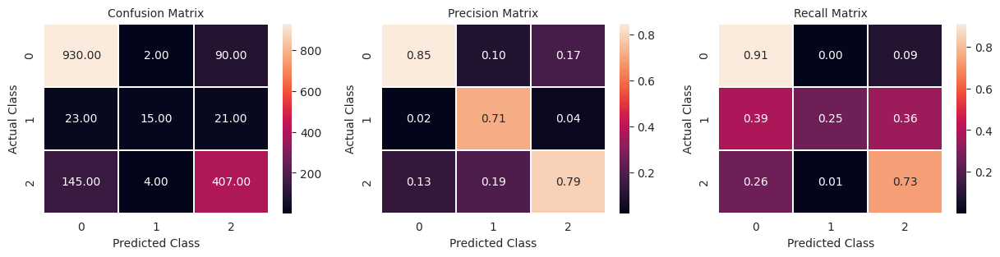


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1022
           1       0.71      0.25      0.38        59
           2       0.79      0.73      0.76       556

    accuracy                           0.83      1637
   macro avg       0.78      0.63      0.67      1637
weighted avg       0.82      0.83      0.82      1637

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_voting_v0_cal/ already exists
Test log_loss: 0.46%

Running CV 11

Start training the model...
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

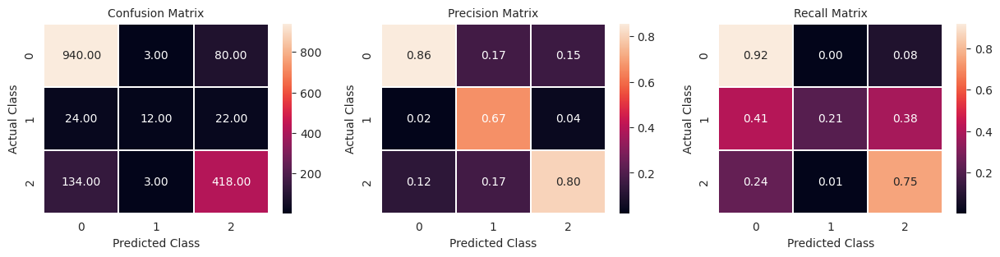


               precision    recall  f1-score   support

           0       0.86      0.92      0.89      1023
           1       0.67      0.21      0.32        58
           2       0.80      0.75      0.78       555

    accuracy                           0.84      1636
   macro avg       0.78      0.63      0.66      1636
weighted avg       0.83      0.84      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_voting_v0_cal/ already exists
Test log_loss: 0.45%

Running CV 12

Start training the model...
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

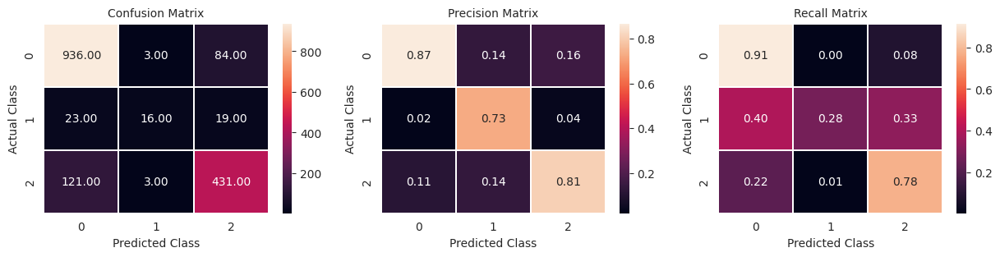


               precision    recall  f1-score   support

           0       0.87      0.91      0.89      1023
           1       0.73      0.28      0.40        58
           2       0.81      0.78      0.79       555

    accuracy                           0.85      1636
   macro avg       0.80      0.66      0.69      1636
weighted avg       0.84      0.85      0.84      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_voting_v0_cal/ already exists
Test log_loss: 0.43%

Running CV 13

Start training the model...
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

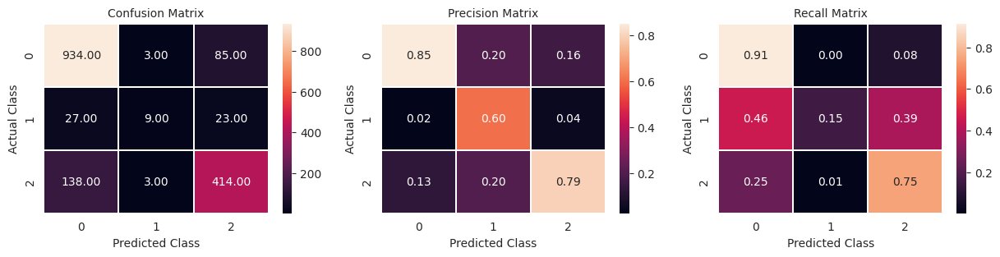


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1022
           1       0.60      0.15      0.24        59
           2       0.79      0.75      0.77       555

    accuracy                           0.83      1636
   macro avg       0.75      0.60      0.63      1636
weighted avg       0.82      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_voting_v0_cal/ already exists
Test log_loss: 0.45%

Running CV 14

Start training the model...
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

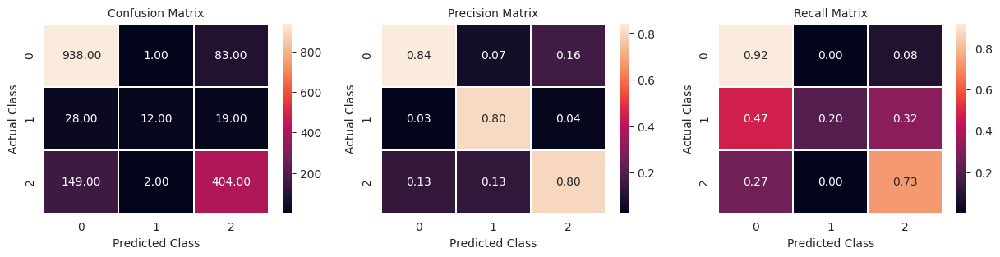


               precision    recall  f1-score   support

           0       0.84      0.92      0.88      1022
           1       0.80      0.20      0.32        59
           2       0.80      0.73      0.76       555

    accuracy                           0.83      1636
   macro avg       0.81      0.62      0.65      1636
weighted avg       0.83      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_voting_v0_cal/ already exists
Test log_loss: 0.46%

Running CV 15

Start training the model...
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

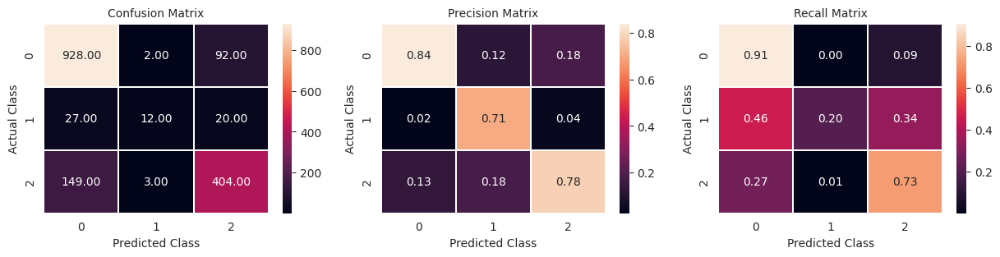


               precision    recall  f1-score   support

           0       0.84      0.91      0.87      1022
           1       0.71      0.20      0.32        59
           2       0.78      0.73      0.75       556

    accuracy                           0.82      1637
   macro avg       0.78      0.61      0.65      1637
weighted avg       0.82      0.82      0.81      1637

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_voting_v0_cal/ already exists
Test log_loss: 0.48%

Running CV 16

Start training the model...
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

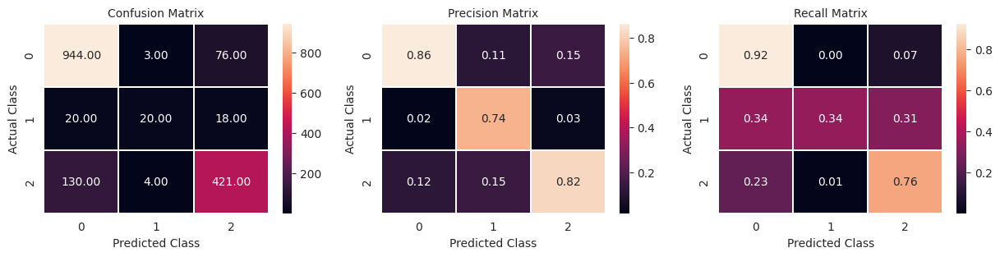


               precision    recall  f1-score   support

           0       0.86      0.92      0.89      1023
           1       0.74      0.34      0.47        58
           2       0.82      0.76      0.79       555

    accuracy                           0.85      1636
   macro avg       0.81      0.68      0.72      1636
weighted avg       0.84      0.85      0.84      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_voting_v0_cal/ already exists
Test log_loss: 0.42%

Running CV 17

Start training the model...
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

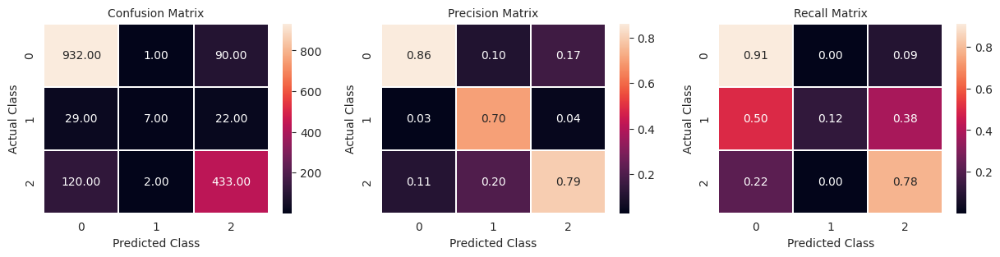


               precision    recall  f1-score   support

           0       0.86      0.91      0.89      1023
           1       0.70      0.12      0.21        58
           2       0.79      0.78      0.79       555

    accuracy                           0.84      1636
   macro avg       0.79      0.60      0.63      1636
weighted avg       0.83      0.84      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_voting_v0_cal/ already exists
Test log_loss: 0.45%

Running CV 18

Start training the model...
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

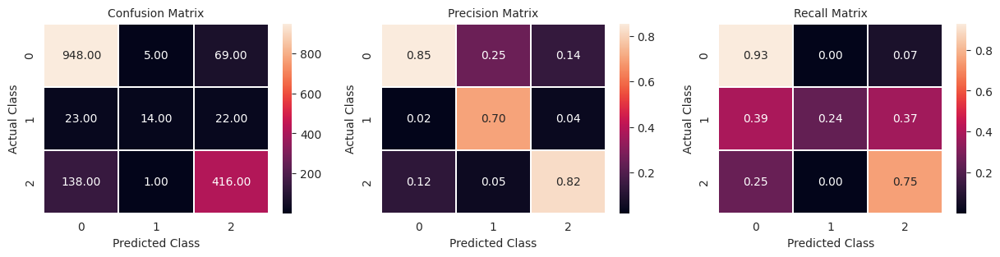


               precision    recall  f1-score   support

           0       0.85      0.93      0.89      1022
           1       0.70      0.24      0.35        59
           2       0.82      0.75      0.78       555

    accuracy                           0.84      1636
   macro avg       0.79      0.64      0.68      1636
weighted avg       0.84      0.84      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_voting_v0_cal/ already exists
Test log_loss: 0.44%

Running CV 19

Start training the model...
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

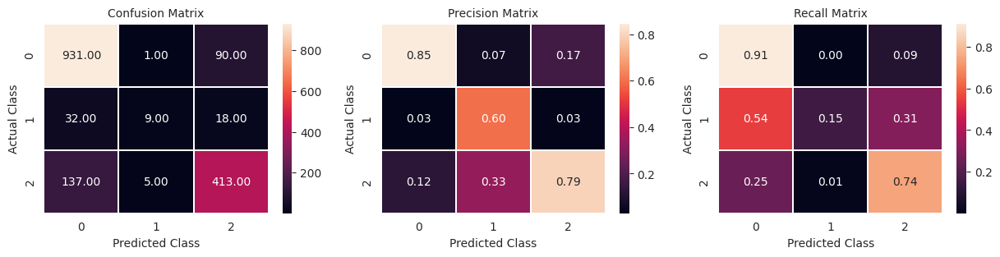


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1022
           1       0.60      0.15      0.24        59
           2       0.79      0.74      0.77       555

    accuracy                           0.83      1636
   macro avg       0.75      0.60      0.63      1636
weighted avg       0.82      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_voting_v0_cal/ already exists
Test log_loss: 0.47%

Running CV 20

Start training the model...
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

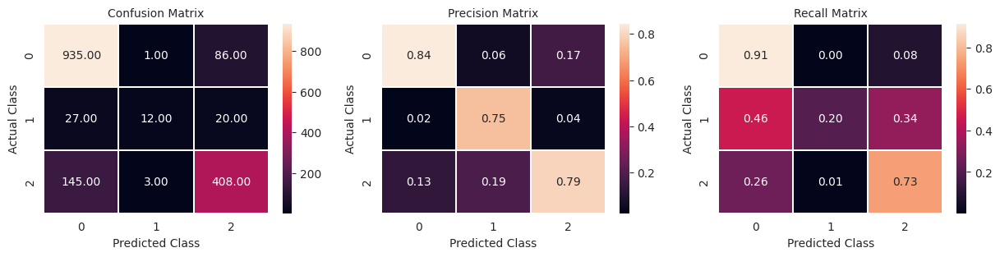


               precision    recall  f1-score   support

           0       0.84      0.91      0.88      1022
           1       0.75      0.20      0.32        59
           2       0.79      0.73      0.76       556

    accuracy                           0.83      1637
   macro avg       0.80      0.62      0.65      1637
weighted avg       0.82      0.83      0.82      1637

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_voting_v0_cal/ already exists
Test log_loss: 0.47%

Running CV 21

Start training the model...
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

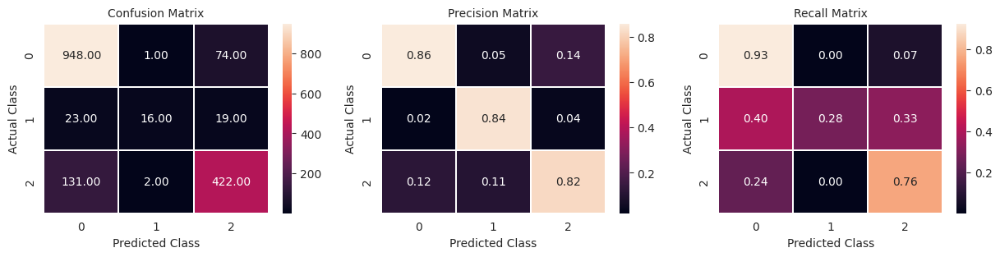


               precision    recall  f1-score   support

           0       0.86      0.93      0.89      1023
           1       0.84      0.28      0.42        58
           2       0.82      0.76      0.79       555

    accuracy                           0.85      1636
   macro avg       0.84      0.65      0.70      1636
weighted avg       0.85      0.85      0.84      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_voting_v0_cal/ already exists
Test log_loss: 0.43%

Running CV 22

Start training the model...
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

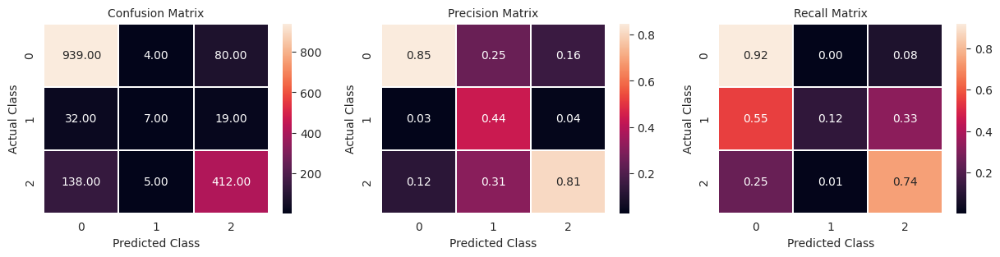


               precision    recall  f1-score   support

           0       0.85      0.92      0.88      1023
           1       0.44      0.12      0.19        58
           2       0.81      0.74      0.77       555

    accuracy                           0.83      1636
   macro avg       0.70      0.59      0.61      1636
weighted avg       0.82      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_voting_v0_cal/ already exists
Test log_loss: 0.46%

Running CV 23

Start training the model...
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

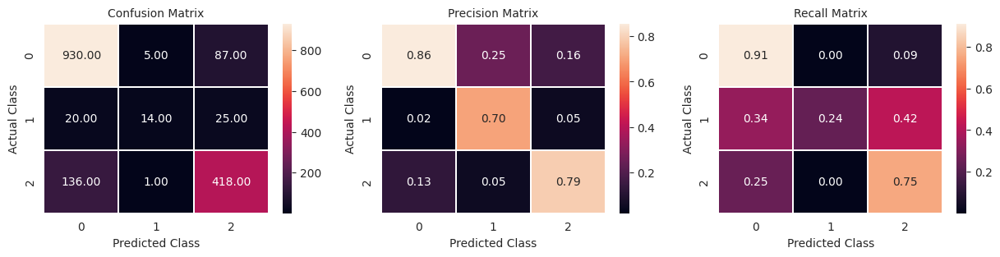


               precision    recall  f1-score   support

           0       0.86      0.91      0.88      1022
           1       0.70      0.24      0.35        59
           2       0.79      0.75      0.77       555

    accuracy                           0.83      1636
   macro avg       0.78      0.63      0.67      1636
weighted avg       0.83      0.83      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_voting_v0_cal/ already exists
Test log_loss: 0.45%

Running CV 24

Start training the model...
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

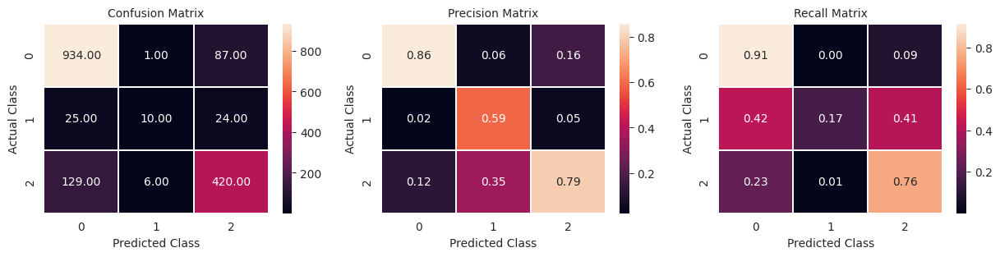


               precision    recall  f1-score   support

           0       0.86      0.91      0.89      1022
           1       0.59      0.17      0.26        59
           2       0.79      0.76      0.77       555

    accuracy                           0.83      1636
   macro avg       0.75      0.61      0.64      1636
weighted avg       0.83      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_voting_v0_cal/ already exists
Test log_loss: 0.46%

Running CV 25

Start training the model...
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

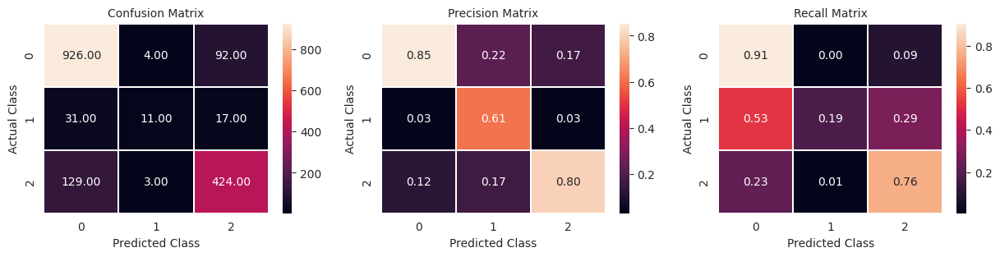


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1022
           1       0.61      0.19      0.29        59
           2       0.80      0.76      0.78       556

    accuracy                           0.83      1637
   macro avg       0.75      0.62      0.65      1637
weighted avg       0.82      0.83      0.82      1637

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_voting_v0_cal/ already exists
Test log_loss: 0.46%

Running CV 26

Start training the model...
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

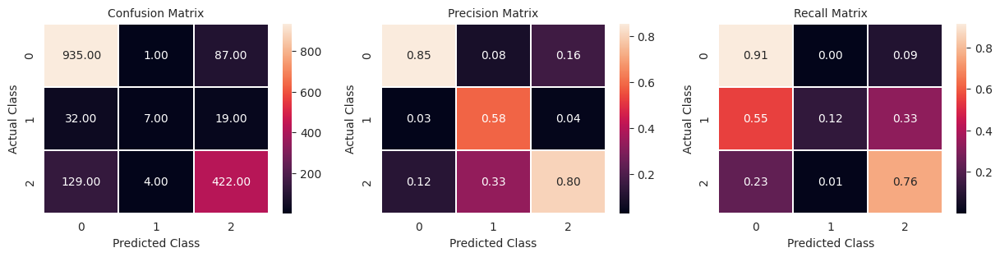


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1023
           1       0.58      0.12      0.20        58
           2       0.80      0.76      0.78       555

    accuracy                           0.83      1636
   macro avg       0.75      0.60      0.62      1636
weighted avg       0.83      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_voting_v0_cal/ already exists
Test log_loss: 0.45%

Running CV 27

Start training the model...
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

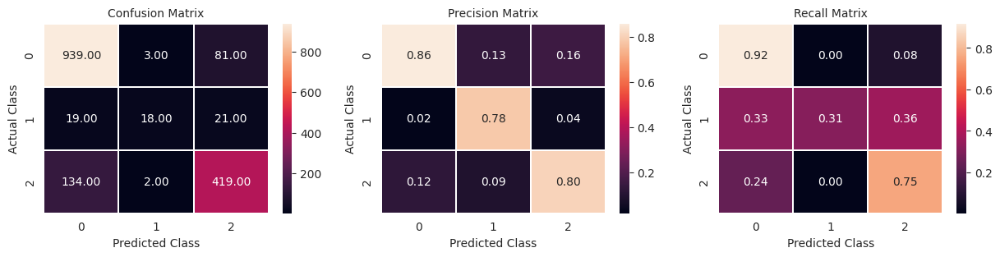


               precision    recall  f1-score   support

           0       0.86      0.92      0.89      1023
           1       0.78      0.31      0.44        58
           2       0.80      0.75      0.78       555

    accuracy                           0.84      1636
   macro avg       0.82      0.66      0.70      1636
weighted avg       0.84      0.84      0.84      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_voting_v0_cal/ already exists
Test log_loss: 0.43%

Running CV 28

Start training the model...
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

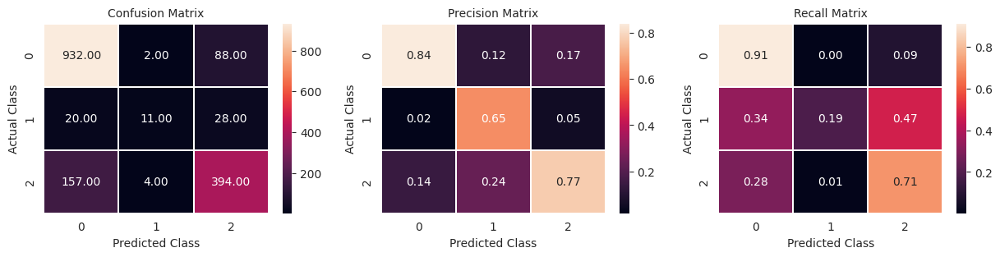


               precision    recall  f1-score   support

           0       0.84      0.91      0.87      1022
           1       0.65      0.19      0.29        59
           2       0.77      0.71      0.74       555

    accuracy                           0.82      1636
   macro avg       0.75      0.60      0.63      1636
weighted avg       0.81      0.82      0.81      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_voting_v0_cal/ already exists
Test log_loss: 0.49%

Running CV 29

Start training the model...
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

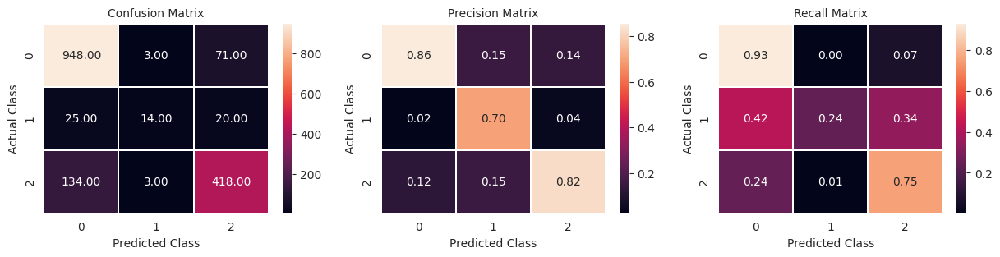


               precision    recall  f1-score   support

           0       0.86      0.93      0.89      1022
           1       0.70      0.24      0.35        59
           2       0.82      0.75      0.79       555

    accuracy                           0.84      1636
   macro avg       0.79      0.64      0.68      1636
weighted avg       0.84      0.84      0.84      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_voting_v0_cal/ already exists
Test log_loss: 0.44%

Running CV 30

Start training the model...
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

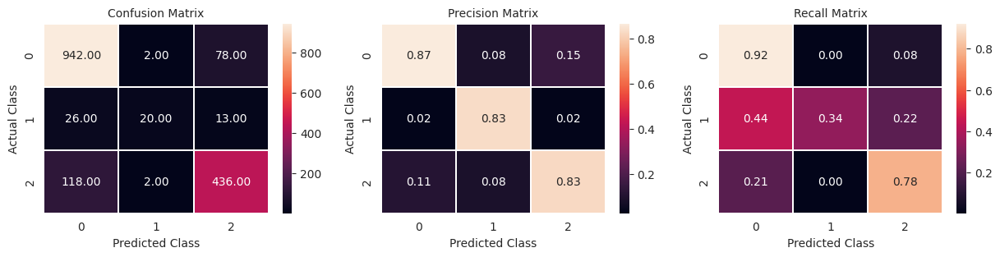


               precision    recall  f1-score   support

           0       0.87      0.92      0.89      1022
           1       0.83      0.34      0.48        59
           2       0.83      0.78      0.81       556

    accuracy                           0.85      1637
   macro avg       0.84      0.68      0.73      1637
weighted avg       0.85      0.85      0.85      1637

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_voting_v0_cal/ already exists
Test log_loss: 0.4%

Running CV 31

Start training the model...
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further s

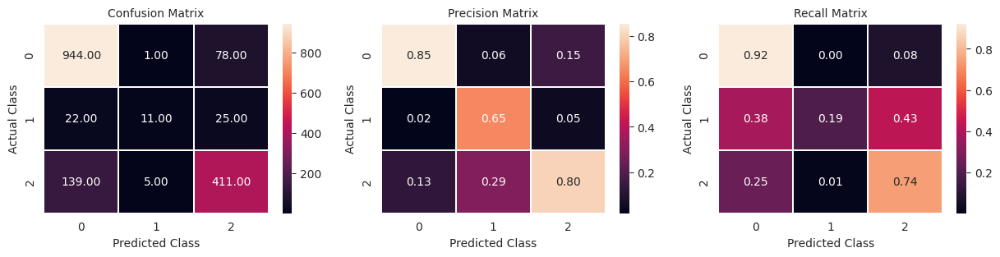


               precision    recall  f1-score   support

           0       0.85      0.92      0.89      1023
           1       0.65      0.19      0.29        58
           2       0.80      0.74      0.77       555

    accuracy                           0.83      1636
   macro avg       0.77      0.62      0.65      1636
weighted avg       0.83      0.83      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_voting_v0_cal/ already exists
Test log_loss: 0.45%

Running CV 32

Start training the model...
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

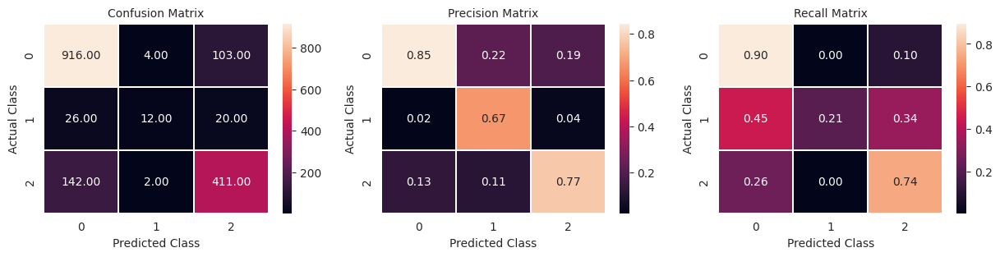


               precision    recall  f1-score   support

           0       0.85      0.90      0.87      1023
           1       0.67      0.21      0.32        58
           2       0.77      0.74      0.75       555

    accuracy                           0.82      1636
   macro avg       0.76      0.61      0.65      1636
weighted avg       0.81      0.82      0.81      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_voting_v0_cal/ already exists
Test log_loss: 0.48%

Running CV 33

Start training the model...
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

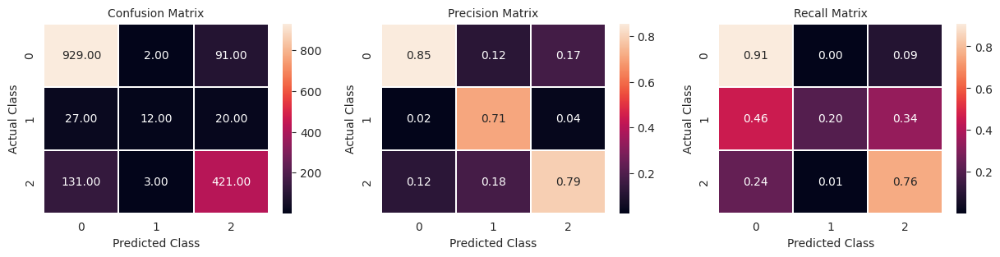


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1022
           1       0.71      0.20      0.32        59
           2       0.79      0.76      0.77       555

    accuracy                           0.83      1636
   macro avg       0.78      0.62      0.66      1636
weighted avg       0.83      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_voting_v0_cal/ already exists
Test log_loss: 0.46%

Running CV 34

Start training the model...
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

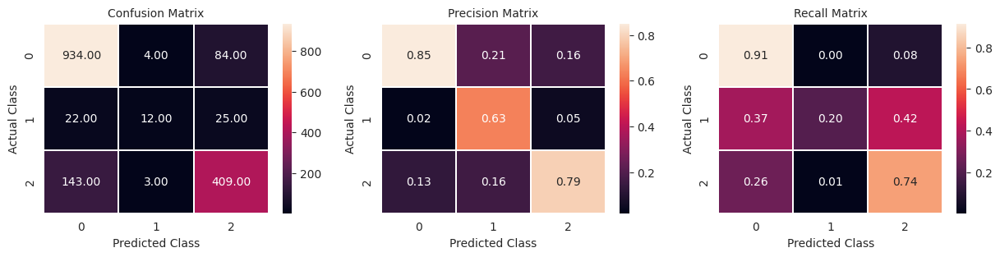


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1022
           1       0.63      0.20      0.31        59
           2       0.79      0.74      0.76       555

    accuracy                           0.83      1636
   macro avg       0.76      0.62      0.65      1636
weighted avg       0.82      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_voting_v0_cal/ already exists
Test log_loss: 0.46%

Running CV 35

Start training the model...
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

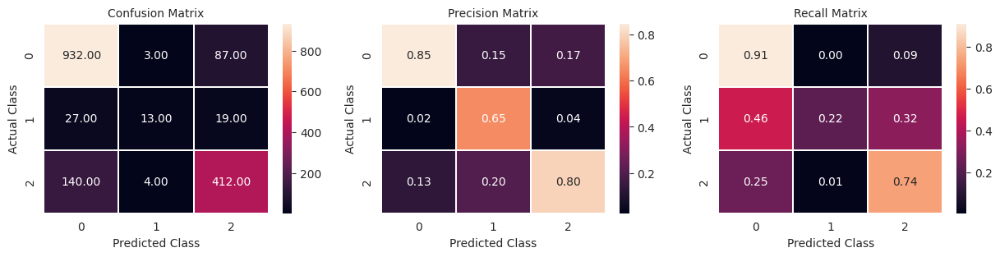


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1022
           1       0.65      0.22      0.33        59
           2       0.80      0.74      0.77       556

    accuracy                           0.83      1637
   macro avg       0.76      0.62      0.66      1637
weighted avg       0.82      0.83      0.82      1637

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_voting_v0_cal/ already exists
Test log_loss: 0.46%

Running CV 36

Start training the model...
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

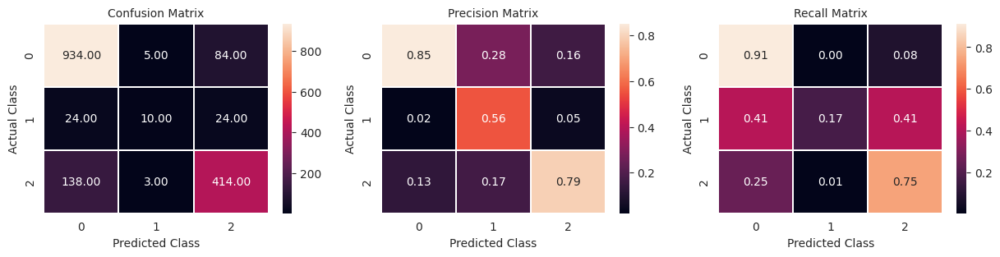


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1023
           1       0.56      0.17      0.26        58
           2       0.79      0.75      0.77       555

    accuracy                           0.83      1636
   macro avg       0.73      0.61      0.64      1636
weighted avg       0.82      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_voting_v0_cal/ already exists
Test log_loss: 0.45%

Running CV 37

Start training the model...
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

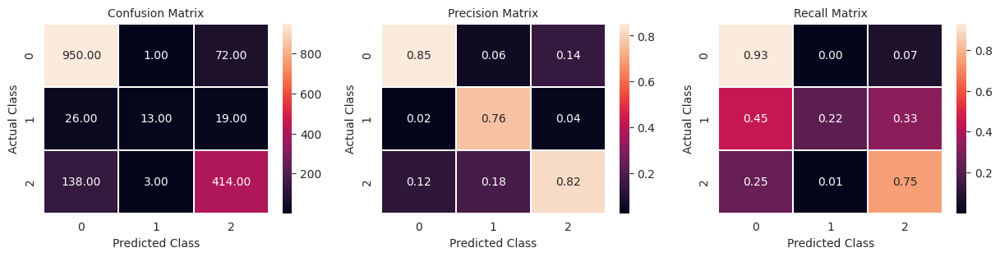


               precision    recall  f1-score   support

           0       0.85      0.93      0.89      1023
           1       0.76      0.22      0.35        58
           2       0.82      0.75      0.78       555

    accuracy                           0.84      1636
   macro avg       0.81      0.63      0.67      1636
weighted avg       0.84      0.84      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_voting_v0_cal/ already exists
Test log_loss: 0.44%

Running CV 38

Start training the model...
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

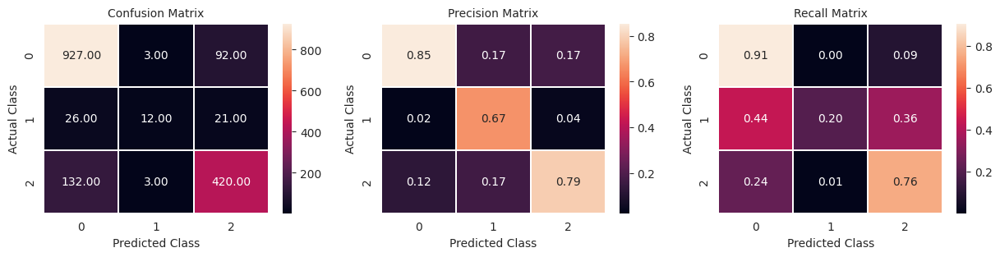


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1022
           1       0.67      0.20      0.31        59
           2       0.79      0.76      0.77       555

    accuracy                           0.83      1636
   macro avg       0.77      0.62      0.65      1636
weighted avg       0.83      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_voting_v0_cal/ already exists
Test log_loss: 0.47%

Running CV 39

Start training the model...
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

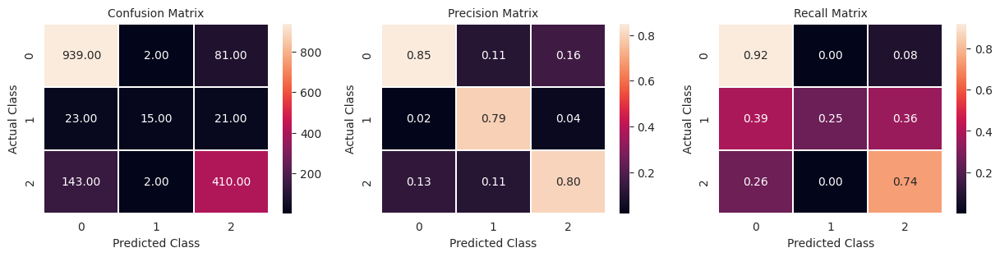


               precision    recall  f1-score   support

           0       0.85      0.92      0.88      1022
           1       0.79      0.25      0.38        59
           2       0.80      0.74      0.77       555

    accuracy                           0.83      1636
   macro avg       0.81      0.64      0.68      1636
weighted avg       0.83      0.83      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_voting_v0_cal/ already exists
Test log_loss: 0.45%
All Valuation lOGlOSS: [0.454, 0.48, 0.458, 0.443, 0.415, 0.468, 0.44, 0.468, 0.447, 0.429, 0.463, 0.455, 0.425, 0.454, 0.462, 0.482, 0.417, 0.454, 0.439, 0.472, 0.468, 0.425, 0.456, 0.454, 0.46, 0.46, 0.455, 0.426, 0.486, 0.442, 0.404, 0.451, 0.481, 0.464, 0.462, 0.456, 0.449, 0.44, 0.466, 0.452]


In [ ]:
test_results_df_C,test_results_df_CL,test_results_df_D, test_results_df = run_experiment(X_train,
                                                                                         X_test,
                                                                                         best_params=best_par,
                                                                                         experiment_name="model_voting_v0_cal",
                                                                                         splits=5,
                                                                                         n_repeats=8,
                                                                                         rs=42,
                                                                                         calibrate=True)

In [ ]:
test_results_df, np.mean([0.444, 0.465, 0.44, 0.436, 0.41, 0.449, 0.432, 0.457, 0.442, 0.417, 0.458, 0.437, 0.416, 0.436, 0.453, 0.463, 0.406, 0.451, 0.431, 0.463, 0.461, 0.416, 0.436, 0.447, 0.449, 0.448, 0.448, 0.418, 0.473, 0.428, 0.4, 0.443, 0.463, 0.454, 0.45, 0.443, 0.427, 0.43, 0.457, 0.446])

(      Status_C  Status_CL  Status_D
 0     0.720142   0.030817  0.249041
 1     0.686731   0.081751  0.231518
 2     0.045253   0.030080  0.924667
 3     0.950076   0.004317  0.045607
 4     0.833609   0.040452  0.125939
 ...        ...        ...       ...
 5266  0.860670   0.040478  0.098851
 5267  0.941927   0.005409  0.052663
 5268  0.916889   0.005984  0.077127
 5269  0.985438   0.006903  0.007659
 5270  0.243126   0.016364  0.740510
 
 [5271 rows x 3 columns],
 0.441075)

In [ ]:
experiment_name="model_voting_v0_cal"

sub = pd.read_csv("sample_submission.csv", index_col=0)
sub.iloc[:,:] = test_results_df.values
sub.to_csv(f"Results/{experiment_name}.csv")

In [ ]:
sub

,Status_C,Status_CL,Status_D
id,,,
7905,0.782748,0.026422,0.190830
7906,0.768841,0.048939,0.182220
7907,0.064101,0.025500,0.910399
7908,0.916543,0.019021,0.064436
7909,0.870367,0.028907,0.100726
...,...,...,...
13171,0.884083,0.029004,0.086913
13172,0.913755,0.019268,0.066977
13173,0.903581,0.019420,0.076999


### 6.8 HistGradientBoostingClassifier

In [84]:
X_train = pd.read_csv("new_train.csv", index_col=0)
X_test = pd.read_csv("new_test.csv", index_col=0)

experiment_name="model_DW_v0_upsampling"

add_feat_train = pd.read_csv(f"Results/{experiment_name}_add_features.csv", index_col=0)
add_feat_test = pd.read_csv(f"Results/{experiment_name}.csv", index_col=0)

#X_train["weights"] = X_train["Status"]
#X_test["weights"] = 1.0

strat_feature = X_train["Status"]

X_train.drop(columns=["id","Status_C","Status_CL","Status_D","min_class_feat_RF"],inplace=True)
X_test.drop(columns=["id","Status_C","Status_CL","Status_D","min_class_feat_RF"],inplace=True)

num_var = X_train.select_dtypes("float").columns
cat_var = X_train.select_dtypes("int").columns

X_train[num_var]=X_train[num_var].astype("float32")
X_train[cat_var]=X_train[cat_var].astype("int32")

X_test[num_var]=X_test[num_var].astype("float32")
X_test[cat_var]=X_test[cat_var].astype("int32")

X_train.Status = X_train.Status.replace({"C":0,"CL":1,"D":2})

#X_train.reset_index(drop=True, inplace=True)
#X_train = pd.concat([X_train,add_feat_train],axis=1)
#X_test = pd.concat([X_test,add_feat_test],axis=1)

X_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8181 entries, 0 to 311
Data columns (total 37 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Drug                            8181 non-null   int32  
 1   Sex                             8181 non-null   int32  
 2   Ascites                         8181 non-null   int32  
 3   Hepatomegaly                    8181 non-null   int32  
 4   Spiders                         8181 non-null   int32  
 5   Edema                           8181 non-null   int32  
 6   Bilirubin                       8181 non-null   float32
 7   Cholesterol                     8181 non-null   float32
 8   Albumin                         8181 non-null   float32
 9   Copper                          8181 non-null   float32
 10  Alk_Phos                        8181 non-null   float32
 11  SGOT                            8181 non-null   float32
 12  Tryglicerides                   818

In [86]:
#sns.countplot(X_train[["prob_Status_C","prob_Status_CL","prob_Status_D"]], hue=X_train.Status)
#fig, axs = plt.subplots(1,3,figsize=(15,5))
#sns.boxplot(data=X_train, x="Status", y="prob_Status_C", ax=axs[0])
#sns.boxplot(data=X_train, x="Status", y="prob_Status_CL", ax=axs[1])
#sns.boxplot(data=X_train, x="Status", y="prob_Status_D", ax=axs[2])

**Check Unconstrained Model**

In [87]:
X = X_train.drop(columns=["Status"]).copy()
y = X_train["Status"].copy()

In [90]:
from sklearn.ensemble import GradientBoostingClassifier

skf = RepeatedStratifiedKFold(n_splits=5, n_repeats=5, random_state=35)
clf = GradientBoostingClassifier()
cross_val_score(clf, X, y, n_jobs=-1, cv=skf, scoring="neg_log_loss").mean()

-0.4534739355871374

#### 6.3.1 **Optuna Optimization**

In [94]:
36*0.2

7.2

In [112]:
skf = RepeatedStratifiedKFold(n_splits=5, n_repeats=5, random_state=48)

def objective(trial):

      n_estimators = trial.suggest_int('n_estimators', 100, 1000)
      max_depth = trial.suggest_int('max_depth', 3, 20)
      learning_rate : trial.suggest_float("learning_rate", 1e-3, 1e-1, log=True)
      subsample = trial.suggest_uniform("subsample", 0.4, 1.0)
      min_samples_split = trial.suggest_int("min_samples_split", 2, 25)
      min_samples_leaf = trial.suggest_int("min_samples_leaf", 2, 10)
      max_features = trial.suggest_uniform("max_features", 0.2, 1.0)

      clf = GradientBoostingClassifier(validation_fraction=0.15,
                                       learning_rate=0.05,
                                       n_iter_no_change=21,
                                       n_estimators=n_estimators,
                                       max_depth=max_depth,
                                       min_samples_split=min_samples_split,
                                       min_samples_leaf=min_samples_leaf,
                                       max_features=max_features,
                                       subsample=subsample)

      score = cross_val_score(clf, X, y, n_jobs=-1, cv=skf, scoring="neg_log_loss").mean()

      return score

In [113]:
# Create study object
study = optuna.create_study(direction="maximize")

# Run optimization process
study.optimize(objective, n_trials=40, show_progress_bar=True)

[I 2023-12-18 17:10:54,478] A new study created in memory with name: no-name-a809f1c2-2cc0-4165-8ffc-dd3cf4c31018


  0%|          | 0/40 [00:00<?, ?it/s]

[I 2023-12-18 17:11:22,860] Trial 0 finished with value: -0.45593156227688125 and parameters: {'n_estimators': 399, 'max_depth': 7, 'subsample': 0.46949382970989445, 'min_samples_split': 9, 'min_samples_leaf': 8, 'max_features': 0.727889162408162}. Best is trial 0 with value: -0.45593156227688125.
[I 2023-12-18 17:11:58,436] Trial 1 finished with value: -0.46502509585216145 and parameters: {'n_estimators': 262, 'max_depth': 20, 'subsample': 0.5945961624294431, 'min_samples_split': 21, 'min_samples_leaf': 9, 'max_features': 0.709123989024369}. Best is trial 0 with value: -0.45593156227688125.
[I 2023-12-18 17:12:32,091] Trial 2 finished with value: -0.4666558068165114 and parameters: {'n_estimators': 854, 'max_depth': 19, 'subsample': 0.7878572671614014, 'min_samples_split': 21, 'min_samples_leaf': 10, 'max_features': 0.4734978278780033}. Best is trial 0 with value: -0.45593156227688125.
[I 2023-12-18 17:13:15,736] Trial 3 finished with value: -0.4527713283237327 and parameters: {'n_est

In [114]:
trial = study.best_trial
print('LogLoss: {}'.format(trial.value))
print("Best hyperparameters: {}".format(trial.params))

LogLoss: -0.44607403476806406
Best hyperparameters: {'n_estimators': 553, 'max_depth': 3, 'subsample': 0.7102270301617016, 'min_samples_split': 17, 'min_samples_leaf': 7, 'max_features': 0.9280917167661759}


In [ ]:
trial = study.best_trial
print('LogLoss: {}'.format(trial.value))
print("Best hyperparameters: {}".format(trial.params))

LogLoss: -0.4618806081560918
Best hyperparameters: {'n_estimators': 539, 'max_depth': 17, 'min_samples_split': 2, 'min_samples_leaf': 2, 'max_samples': 0.8249441730824305}


In [117]:
# Print best trial and best hyperparameters
print("Best trial:", study.best_trial)
print("Best hyperparameters:", study.best_params)

Best trial: FrozenTrial(number=21, state=TrialState.COMPLETE, values=[-0.44607403476806406], datetime_start=datetime.datetime(2023, 12, 18, 17, 24, 24, 669424), datetime_complete=datetime.datetime(2023, 12, 18, 17, 25, 25, 709082), params={'n_estimators': 553, 'max_depth': 3, 'subsample': 0.7102270301617016, 'min_samples_split': 17, 'min_samples_leaf': 7, 'max_features': 0.9280917167661759}, user_attrs={}, system_attrs={}, intermediate_values={}, distributions={'n_estimators': IntDistribution(high=1000, log=False, low=100, step=1), 'max_depth': IntDistribution(high=20, log=False, low=3, step=1), 'subsample': FloatDistribution(high=1.0, log=False, low=0.4, step=None), 'min_samples_split': IntDistribution(high=25, log=False, low=2, step=1), 'min_samples_leaf': IntDistribution(high=10, log=False, low=2, step=1), 'max_features': FloatDistribution(high=1.0, log=False, low=0.2, step=None)}, trial_id=21, value=None)
Best hyperparameters: {'n_estimators': 553, 'max_depth': 3, 'subsample': 0.71

In [ ]:
fig = optuna.visualization.plot_optimization_history(study)
fig.show()

In [116]:
fig = optuna.visualization.plot_param_importances(study)
fig.show()

In [ ]:
fig = optuna.visualization.plot_rank(study, params=["min_samples_split", "min_samples_leaf"])
fig.show()

In [ ]:
fig = optuna.visualization.plot_rank(study, params=["min_samples_split", "max_samples"])
fig.show()

In [118]:
best_par = {'n_estimators': 553, 'max_depth': 3, 'subsample': 0.7102270301617016, 'min_samples_split': 17, 'min_samples_leaf': 7,
            'max_features': 0.9280917167661759,"validation_fraction":0.15,"learning_rate":0.05,"n_iter_no_change":21}
clf = GradientBoostingClassifier(**best_par)
cross_val_score(clf, X, y, n_jobs=-1, cv=skf, scoring="neg_log_loss").mean()
#clf.fit( X, y)

-0.44794328517656334

#### 6.3.2 Fit the Model

In [120]:
def run_experiment(train, test_data_file, best_params=best_par, experiment_name="model_gbc", splits=5, n_repeats=8, rs=42, calibrate=True):

  skf = RepeatedStratifiedKFold(n_splits=splits, n_repeats=n_repeats, random_state=rs)

  test_results_df_C = pd.DataFrame(index=test_data_file.index, columns=list(range(splits*n_repeats)))
  test_results_df_CL = pd.DataFrame(index=test_data_file.index, columns=list(range(splits*n_repeats)))
  test_results_df_D = pd.DataFrame(index=test_data_file.index, columns=list(range(splits*n_repeats)))

  test_results_df = pd.DataFrame(index=test_data_file.index, columns=["Status_C","Status_CL","Status_D"])

  all_logloss = []
  all_AUC_pr = []

  for i, (train_index, valid_index) in enumerate(skf.split(X_train,strat_feature)):

    print(f"\nRunning CV {i}\n")
    ########################################################################## Prepare the Dataset:
    X_trn = train.iloc[train_index,:]
    X_val = train.iloc[valid_index,:]

    X = X_trn.drop(columns=["Status"]).copy()
    y = X_trn["Status"].copy()

    val_X = X_val.drop(columns=["Status"]).copy()
    val_y = X_val["Status"].copy()

    test_X = test_data_file.drop(columns=["Status"]).copy()
    #################################################################### End of Dataset Preparation

    ##################################################################### Generate and Fit Model
    model = GradientBoostingClassifier(random_state=rs, **best_params)
    print("Start training the model...")
    history = model.fit(X,y)
    if calibrate:
      print("Model Calibration")
      cal_model = CalibratedClassifierCV(model, method="sigmoid", cv="prefit")
      cal_model.fit(val_X, val_y)
      model = cal_model
    print("Model training finished")

    val_probs = model.predict_proba(val_X)
    test_prob = model.predict_proba(test_X)

    logloss = log_loss(val_y, val_probs)

    y_hat_val = model.predict(val_X)

    plot_confusion_matrix(val_y, y_hat_val, labels=[0,1,2])

    print("\n",classification_report(y_true=val_y, y_pred=y_hat_val))

    test_results_df_C.iloc[:,i] = test_prob[:,0]
    test_results_df_CL.iloc[:,i] = test_prob[:,1]
    test_results_df_D.iloc[:,i] = test_prob[:,2]

    ##################################################################### Save the Model
    folders_experiment = f"/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/{experiment_name}/"
    folders_experiment_cv = f"/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/{experiment_name}/cv_{i}/"

    list_directories = [folder_data,folders_experiment,folders_experiment_cv]

    for path in list_directories:
      try:
          os.mkdir(path)
      except OSError as error:
          print(f"{path} already exists")

    os.chdir(folders_experiment_cv)
    dump(clf, f'{experiment_name}.joblib')
    os.chdir(folder_data)

    print(f"Test log_loss: {round(logloss, 2)}%")
    all_logloss.append(round(logloss, 3))

  ##################################################################### Create Model Output
  test_results_df_C["Mean"] = test_results_df_C.mean(axis=1)
  test_results_df_CL["Mean"] = test_results_df_CL.mean(axis=1)
  test_results_df_D["Mean"] = test_results_df_D.mean(axis=1)

  test_results_df.loc[:,"Status_C"] = test_results_df_C["Mean"].values
  test_results_df.loc[:,"Status_CL"] = test_results_df_CL["Mean"].values
  test_results_df.loc[:,"Status_D"] = test_results_df_D["Mean"].values

  print(f"All Valuation lOGlOSS: {all_logloss}")

  return test_results_df_C,test_results_df_CL,test_results_df_D, test_results_df


Running CV 0

Start training the model...
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


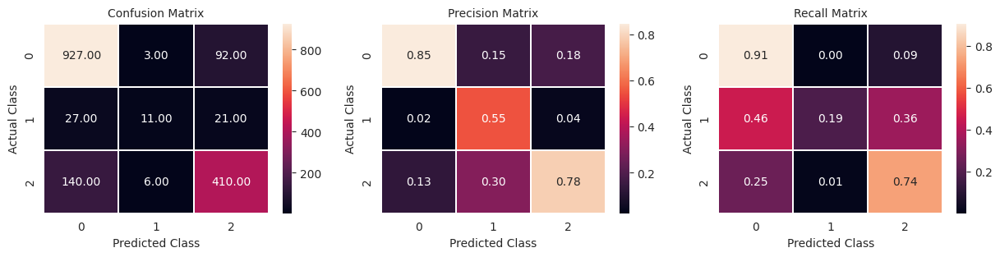


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1022
           1       0.55      0.19      0.28        59
           2       0.78      0.74      0.76       556

    accuracy                           0.82      1637
   macro avg       0.73      0.61      0.64      1637
weighted avg       0.82      0.82      0.82      1637

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_gbc_v0_unc/ already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_gbc_v0_unc/cv_0/ already exists
Test log_loss: 0.46%

Running CV 1

Start training the model...
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


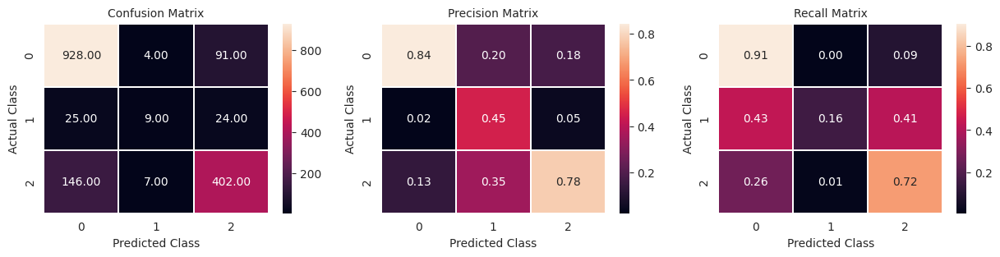


               precision    recall  f1-score   support

           0       0.84      0.91      0.87      1023
           1       0.45      0.16      0.23        58
           2       0.78      0.72      0.75       555

    accuracy                           0.82      1636
   macro avg       0.69      0.60      0.62      1636
weighted avg       0.81      0.82      0.81      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_gbc_v0_unc/ already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_gbc_v0_unc/cv_1/ already exists
Test log_loss: 0.47%

Running CV 2

Start training the model...
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


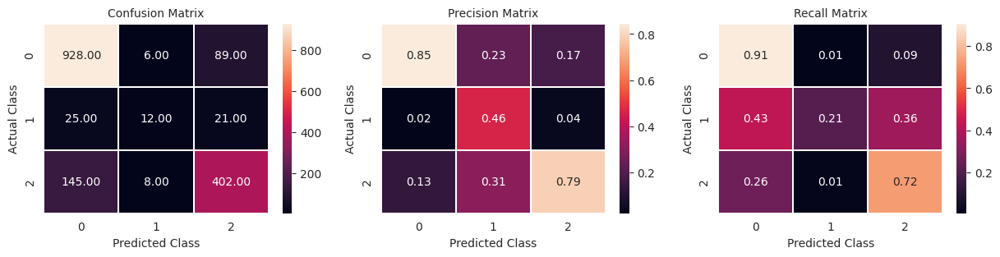


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1023
           1       0.46      0.21      0.29        58
           2       0.79      0.72      0.75       555

    accuracy                           0.82      1636
   macro avg       0.70      0.61      0.64      1636
weighted avg       0.81      0.82      0.81      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_gbc_v0_unc/ already exists
Test log_loss: 0.46%

Running CV 3

Start training the model...
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


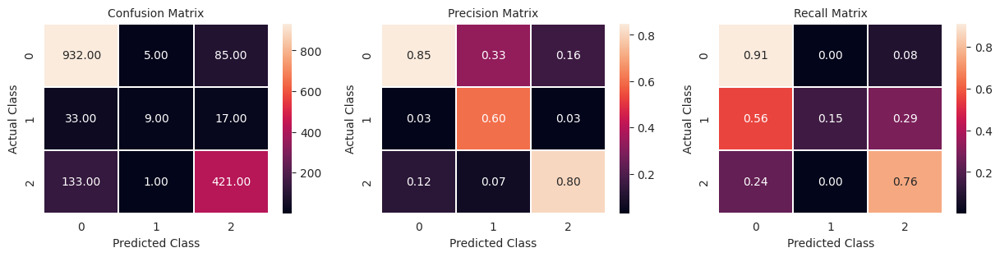


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1022
           1       0.60      0.15      0.24        59
           2       0.80      0.76      0.78       555

    accuracy                           0.83      1636
   macro avg       0.75      0.61      0.63      1636
weighted avg       0.82      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_gbc_v0_unc/ already exists
Test log_loss: 0.44%

Running CV 4

Start training the model...
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


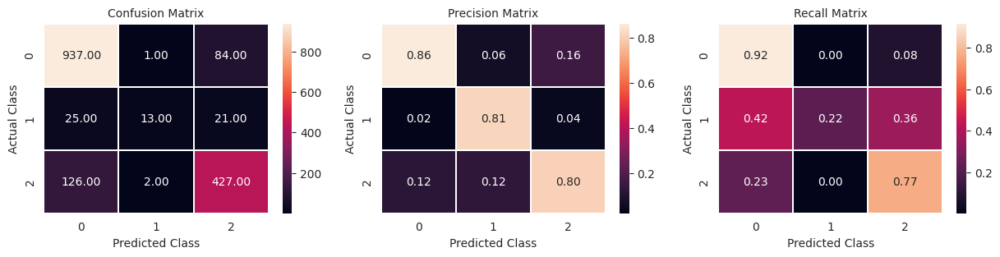


               precision    recall  f1-score   support

           0       0.86      0.92      0.89      1022
           1       0.81      0.22      0.35        59
           2       0.80      0.77      0.79       555

    accuracy                           0.84      1636
   macro avg       0.83      0.64      0.67      1636
weighted avg       0.84      0.84      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_gbc_v0_unc/ already exists
Test log_loss: 0.42%

Running CV 5

Start training the model...
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


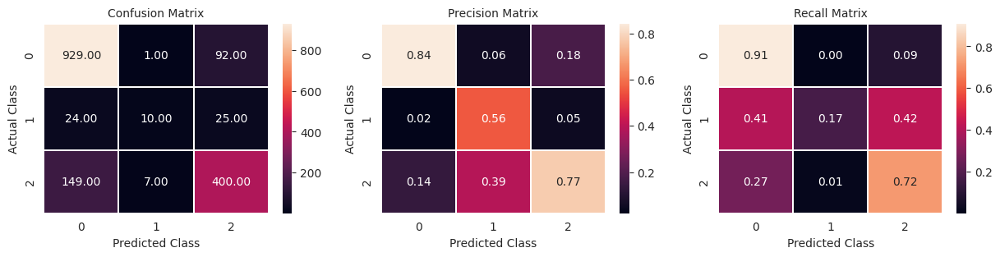


               precision    recall  f1-score   support

           0       0.84      0.91      0.87      1022
           1       0.56      0.17      0.26        59
           2       0.77      0.72      0.75       556

    accuracy                           0.82      1637
   macro avg       0.72      0.60      0.63      1637
weighted avg       0.81      0.82      0.81      1637

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_gbc_v0_unc/ already exists
Test log_loss: 0.46%

Running CV 6

Start training the model...
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


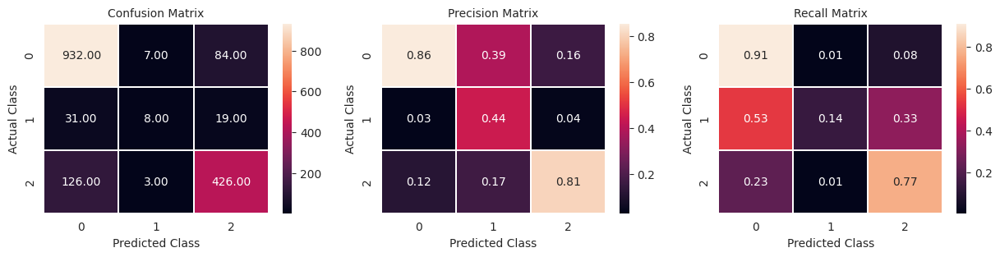


               precision    recall  f1-score   support

           0       0.86      0.91      0.88      1023
           1       0.44      0.14      0.21        58
           2       0.81      0.77      0.79       555

    accuracy                           0.83      1636
   macro avg       0.70      0.61      0.63      1636
weighted avg       0.82      0.83      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_gbc_v0_unc/ already exists
Test log_loss: 0.44%

Running CV 7

Start training the model...
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


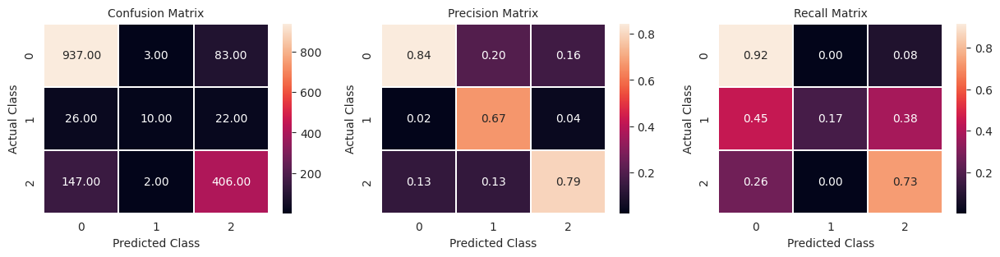


               precision    recall  f1-score   support

           0       0.84      0.92      0.88      1023
           1       0.67      0.17      0.27        58
           2       0.79      0.73      0.76       555

    accuracy                           0.83      1636
   macro avg       0.77      0.61      0.64      1636
weighted avg       0.82      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_gbc_v0_unc/ already exists
Test log_loss: 0.46%

Running CV 8

Start training the model...
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


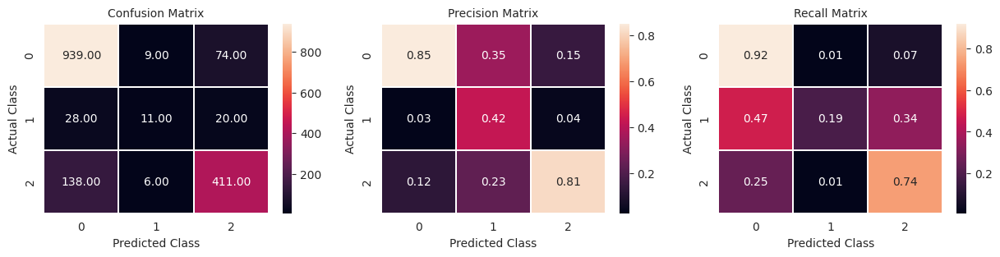


               precision    recall  f1-score   support

           0       0.85      0.92      0.88      1022
           1       0.42      0.19      0.26        59
           2       0.81      0.74      0.78       555

    accuracy                           0.83      1636
   macro avg       0.70      0.62      0.64      1636
weighted avg       0.82      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_gbc_v0_unc/ already exists
Test log_loss: 0.46%

Running CV 9

Start training the model...
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


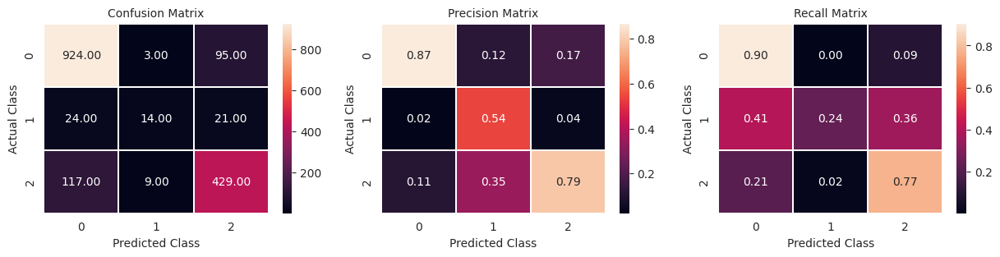


               precision    recall  f1-score   support

           0       0.87      0.90      0.89      1022
           1       0.54      0.24      0.33        59
           2       0.79      0.77      0.78       555

    accuracy                           0.84      1636
   macro avg       0.73      0.64      0.66      1636
weighted avg       0.83      0.84      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_gbc_v0_unc/ already exists
Test log_loss: 0.43%

Running CV 10

Start training the model...
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


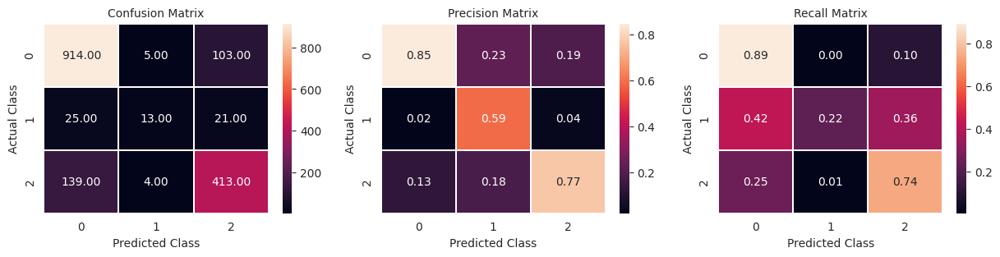


               precision    recall  f1-score   support

           0       0.85      0.89      0.87      1022
           1       0.59      0.22      0.32        59
           2       0.77      0.74      0.76       556

    accuracy                           0.82      1637
   macro avg       0.74      0.62      0.65      1637
weighted avg       0.81      0.82      0.81      1637

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_gbc_v0_unc/ already exists
Test log_loss: 0.46%

Running CV 11

Start training the model...
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


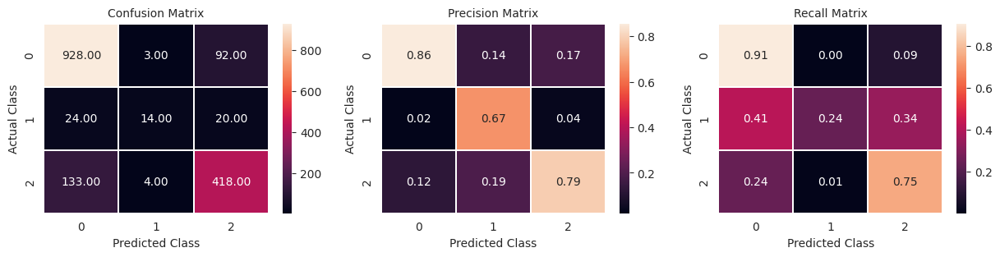


               precision    recall  f1-score   support

           0       0.86      0.91      0.88      1023
           1       0.67      0.24      0.35        58
           2       0.79      0.75      0.77       555

    accuracy                           0.83      1636
   macro avg       0.77      0.63      0.67      1636
weighted avg       0.83      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_gbc_v0_unc/ already exists
Test log_loss: 0.44%

Running CV 12

Start training the model...
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


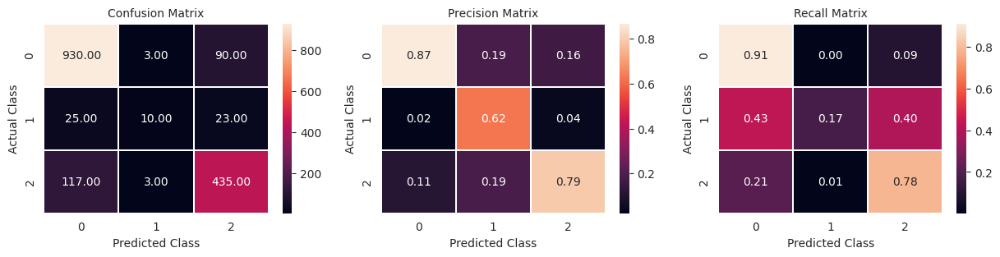


               precision    recall  f1-score   support

           0       0.87      0.91      0.89      1023
           1       0.62      0.17      0.27        58
           2       0.79      0.78      0.79       555

    accuracy                           0.84      1636
   macro avg       0.76      0.62      0.65      1636
weighted avg       0.83      0.84      0.83      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_gbc_v0_unc/ already exists
Test log_loss: 0.43%

Running CV 13

Start training the model...
Model training finished
Column sum of precision matrix: [1. 1. 1.]
Row sum of recall matrix:       [1. 1. 1.]


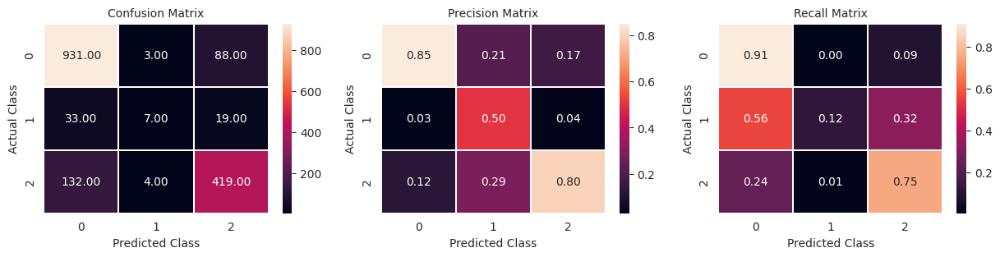


               precision    recall  f1-score   support

           0       0.85      0.91      0.88      1022
           1       0.50      0.12      0.19        59
           2       0.80      0.75      0.78       555

    accuracy                           0.83      1636
   macro avg       0.72      0.59      0.62      1636
weighted avg       0.82      0.83      0.82      1636

/content/drive/MyDrive/Exercises/Studies_Structured_Data/Data/S3E26_Cyrrosis already exists
/content/drive/MyDrive/Exercises/Studies_Structured_Data/Models/S3E26_Cyrrosis/trees_models/model_gbc_v0_unc/ already exists
Test log_loss: 0.44%

Running CV 14

Start training the model...


In [ ]:
test_results_df_C,test_results_df_CL,test_results_df_D, test_results_df = run_experiment(X_train,
                                                                                         X_test,
                                                                                         best_params=best_par,
                                                                                         experiment_name="model_gbc_v0_unc",
                                                                                         splits=5,
                                                                                         n_repeats=8,
                                                                                         rs=42,
                                                                                         calibrate=False)

In [ ]:
res_cal = [0.467, 0.487, 0.467, 0.461, 0.431, 0.474, 0.447, 0.479, 0.456, 0.445, 0.472, 0.472, 0.434, 0.464, 0.468, 0.483, 0.433, 0.474, 0.445, 0.478,
           0.471, 0.437, 0.466, 0.462, 0.472, 0.466, 0.456, 0.443, 0.492, 0.455, 0.423, 0.467, 0.484, 0.47, 0.468, 0.464, 0.452, 0.453, 0.475, 0.469]

res_unc = [0.465, 0.486, 0.462, 0.458, 0.439, 0.469, 0.451, 0.477, 0.46, 0.446, 0.478, 0.463, 0.439, 0.457, 0.469, 0.476, 0.437, 0.476, 0.449, 0.479,
          0.475, 0.439, 0.458, 0.468, 0.471, 0.467, 0.466, 0.447, 0.486, 0.451, 0.432, 0.471, 0.477, 0.469, 0.466, 0.463, 0.447, 0.452, 0.477, 0.472]

np.mean(res_cal),np.mean(res_unc),

(0.46204999999999996, 0.46225000000000005)

In [ ]:
test_results_df

,Status_C,Status_CL,Status_D
0,0.817539,0.029856,0.152605
1,0.819182,0.047731,0.133087
2,0.083021,0.060995,0.855984
3,0.926430,0.014901,0.058668
4,0.807327,0.043389,0.149284
...,...,...,...
5266,0.860294,0.039961,0.099746
5267,0.888645,0.017259,0.094096
5268,0.913122,0.016252,0.070626
5269,0.939147,0.014592,0.046261


In [ ]:
experiment_name="model_rf_v0_cal"

sub = pd.read_csv("sample_submission.csv", index_col=0)
sub.iloc[:,:] = test_results_df.values
sub.to_csv(f"Results/{experiment_name}.csv")

In [ ]:
sub

,Status_C,Status_CL,Status_D
id,,,
7905,0.817539,0.029856,0.152605
7906,0.819182,0.047731,0.133087
7907,0.083021,0.060995,0.855984
7908,0.926430,0.014901,0.058668
7909,0.807327,0.043389,0.149284
...,...,...,...
13171,0.860294,0.039961,0.099746
13172,0.888645,0.017259,0.094096
13173,0.913122,0.016252,0.070626


## Final Ensemble:

In [ ]:
Models_csv_list = [
#                  "Results/model_rf_v0_uncalibrated.csv",
                  "Results/model_DW_v0.csv",
                  "Results/model_rf_v0_cal.csv",
                  "Results/model_lgbm_v1_unc.csv",
                  "Results/model_xgb_v0_unc.csv"
                  ]

dict_results = {}

for num,tab in enumerate(Models_csv_list):
  dict_results[num] = pd.read_csv(tab, index_col=0)

In [ ]:
ensemble_array = np.zeros(shape=(dict_results[0].shape[0],dict_results[0].shape[1],len(dict_results.keys())))

for key in dict_results.keys():
  ensemble_array[:,:,key] = dict_results[key].values

ensemble_mean = ensemble_array.mean(axis=-1)

experiment_name="ensemble_v5"

sub = pd.read_csv("sample_submission.csv", index_col=0)
sub.iloc[:,:] = ensemble_mean
sub.to_csv(f"Results/{experiment_name}.csv")

In [ ]:
sub

,Status_C,Status_CL,Status_D
id,,,
7905,0.747511,0.032976,0.219513
7906,0.769171,0.068875,0.161954
7907,0.045896,0.027878,0.926226
7908,0.941776,0.007649,0.050574
7909,0.795697,0.037800,0.166503
...,...,...,...
13171,0.856876,0.036288,0.106836
13172,0.932906,0.008771,0.058323
13173,0.887778,0.009847,0.102375
